In [1]:
%load_ext autoreload
%autoreload 2
def loadDfs():
  dfs_to_load = [
      "~/OneDrive/Aggregates/AllAnimals__2022_01_16.pkl",
    # "~/OneDrive/Aggregates/AllAnimals__2021_07_30.pkl",
    # "~/OneDrive/Aggregates/AllAnimals__2021_07_26.pkl",
    # "~/OneDrive/Aggregates/AllAnimals__2021_03_31.pkl",
    # "~/OneDrive/Mouse2AFC_live/report/aggregates/all_Rbp4_M2.dump",
    # "~/OneDrive/Mouse2AFC_live/report/aggregates/all_vgat.dump",
    # "~/OneDrive/Mouse2AFC_live/report/aggregates/all_animals_oeig.pkl"
  ]
  import pandas as pd
  dfs = []
  for fp in dfs_to_load:
        dfs.append(pd.read_pickle(fp))
  return pd.concat(dfs)

def setup():
  import os
  from pathlib import Path
  #print(os.path.dirname(os.getcwd()))
  cur_dir = Path(os.getcwd())
  if cur_dir.name == "report":
    os.chdir(cur_dir.parent)
    print("Changing directories")
  from report import analysis
  analysis.setMatplotlibParams(silent=True)
setup()

Changing directories


In [2]:
def filterOptoInvalidSessions(df):
  df = df.copy() # Make a copy to avoid the warning
  from datetime import date
  ALL_TRIALS=0, 10000
  ALL_SESSIONS = -1
  animals = [
    # ("vgat2.1", [date(year=2020,month=8,day=12)], ALL_SESSIONS, ALL_TRIALS),
    ("vgat2.1", [date(year=2020,month=10,day=13)],           2, ALL_TRIALS),
    ("vgat2.1", [date(year=2020,month=10,day=16)],           1, ALL_TRIALS),
    ("vgat2.1", [date(year=2020,month=10,day=21)],           3, ALL_TRIALS),
    ("vgat2.1", [date(year=2020,month=10,day=22)],           1, ALL_TRIALS),
    ("vgat2.1", [date(year=2020,month=10,day=22)],           2, ALL_TRIALS),
    ("vgat2.1", [date(year=2020,month=10,day=26)],ALL_SESSIONS, ALL_TRIALS),
    ("vgat2.1", [date(year=2020,month=10,day=27)],ALL_SESSIONS, ALL_TRIALS),
    ("vgat2.1", [date(year=2020,month=11,day=4)],            1, ALL_TRIALS),
    # ("vgat2.3", [date(year=2020,month=9, day=7)], ALL_SESSIONS, ALL_TRIALS),
    # ("vgat2.3", [date(year=2020,month=8, day=28)],ALL_SESSIONS, (0, 140)),
    ("vgat2.4", [date(year=2020,month=10,day=15)],ALL_SESSIONS, ALL_TRIALS),
    ("vgat2.4", [date(year=2020,month=10,day=26)],ALL_SESSIONS, ALL_TRIALS),
    # ("vgat2.4", [date(year=2020,month=11,day=22)],           1, ALL_TRIALS),
    # ("vgat2.4", [date(year=2020,month=11,day=22)],           2, ALL_TRIALS),
    # ("vgat2.5", [date(year=2020,month=10,day=20)],ALL_SESSIONS, ALL_TRIALS),
    ("vgat2.5", [date(year=2020,month=10,day=26)],ALL_SESSIONS, ALL_TRIALS),
    ("vgat2.5", [date(year=2021,month=2, day=2)],            1, ALL_TRIALS),
    # ("vgat2.5", [date(year=2021,month=2, day=2)],            2, ALL_TRIALS),
    # ("vgat2.5", [date(year=2021,month=2, day=2)],            4, ALL_TRIALS),
    ("vgat2.5", [date(year=2021,month=2, day=3)], ALL_SESSIONS, ALL_TRIALS),
    ("vgat2.5", [date(year=2021,month=2, day=19)],           1, ALL_TRIALS),
    # ("vgat2.5", [date(year=2021,month=2, day=19)],           2, ALL_TRIALS),
    ("vgat2.6", [date(year=2020,month=10,day=5)], ALL_SESSIONS, ALL_TRIALS),
    ("vgat2.6", [date(year=2020,month=10,day=15)],           2, ALL_TRIALS),
    ("vgat2.6", [date(year=2020,month=10,day=26)],ALL_SESSIONS, ALL_TRIALS),
    ("vgat2.6", [date(year=2020,month=10,day=27)],ALL_SESSIONS, ALL_TRIALS),
    ("vgat2.6", [date(year=2020,month=11,day=4)], ALL_SESSIONS, ALL_TRIALS),
    ("vgat2.6", [date(year=2021,month=2, day=2)], ALL_SESSIONS, ALL_TRIALS),

    ("Avgat1",  [date(year=2021,month=6, day=17)],ALL_SESSIONS, (201,1000)),
    ("Avgat3",  [date(year=2021,month=6, day=18)],ALL_SESSIONS, (201,1000)),
    # SESSION 22/6: For AVGAT 4, please remove all VI_BI trials for today, 
    # which happens after trial no. 240. Dots were not showing on the screen
    # after trial 270. 
    ("Avgat4",  [date(year=2021,month=6, day=22)],ALL_SESSIONS, (240,1000)),
    # SESSION 06/07: For AVGAT 2: Please delete all PPC sessions as they were
    # done until non optimal conditions (bpod kept crashing) 
    ("Avgat2",  [date(year=2021,month=7, day=6)], ALL_SESSIONS, ALL_TRIALS),

    # Bad performance:
    ("vgat2.1", [date(year=2020,month=10,day=9)],            1, ALL_TRIALS),
    ("vgat2.1", [date(year=2020,month=10,day=13)],           1, ALL_TRIALS),
    ("vgat2.1", [date(year=2020,month=11,day=13)],           1, ALL_TRIALS),
    ("vgat2.4", [date(year=2020,month=11,day=12)],           1, ALL_TRIALS),
    ("vgat2.4", [date(year=2020,month=11,day=14)],           1, ALL_TRIALS),
    ("vgat2.4", [date(year=2020,month=12,day=23)],           1, ALL_TRIALS),
    ("vgat2.5", [date(year=2020,month=10,day=3)],            1, ALL_TRIALS),
    ("vgat2.5", [date(year=2020,month=10,day=14)],           3, ALL_TRIALS),
    ("vgat2.5", [date(year=2020,month=10,day=15)],           1, ALL_TRIALS),
    ("vgat2.5", [date(year=2020,month=11,day=9)],            1, ALL_TRIALS),
    ("vgat2.5", [date(year=2020,month=12,day=16)],           2, ALL_TRIALS),
    ("vgat2.5", [date(year=2020,month=12,day=18)],           1, ALL_TRIALS),
    ("vgat2.5", [date(year=2021,month=2, day=1)],            2, ALL_TRIALS),
    ("vgat2.5", [date(year=2021,month=2, day=24)],           1, ALL_TRIALS),
    ("vgat2.6", [date(year=2020,month=10,day=9)],            1, ALL_TRIALS),
    ("vgat2.6", [date(year=2021,month=2, day=8)],            2, ALL_TRIALS),
    ("vgat2.6", [date(year=2021,month=2, day=8)],            4, ALL_TRIALS),
    ("vgat2.6", [date(year=2021,month=2, day=9)],            1, ALL_TRIALS),
    ("vgat2.6", [date(year=2021,month=2, day=9)],            3, ALL_TRIALS),
    ("vgat2.6", [date(year=2021,month=2,day=10)],            1, ALL_TRIALS),
    ("vgat2.6", [date(year=2021,month=2,day=18)],            1, ALL_TRIALS),

    ("Avgat1",  [date(year=2021,month=7, day=20)],           1, ALL_TRIALS),
    ("Avgat2",  [date(year=2021,month=7, day=21)],           1, ALL_TRIALS),
    ("Avgat2",  [date(year=2021,month=7, day=26)],           1, ALL_TRIALS),
    ("Avgat3",  [date(year=2021,month=6, day=21)],           1, ALL_TRIALS),
    ("Avgat3",  [date(year=2021,month=6, day=23)],           1, ALL_TRIALS),
    # TODO: Remove M2 and keep PPC >> Avgat4 - 2021-07-06 - Sess:1 - Region: PPC_BiState: 8
    ("Avgat4",  [date(year=2021,month=7, day=6)],            1,   (0, 211)),
  ]
  for animal_name, invalid_dates, sess_num, (start_trial, end_trial) in animals:
    sess_cond = True if sess_num == ALL_SESSIONS else df.SessionNum == sess_num
    trgt_df = df[((df.Name == animal_name) & (df.Date.isin(invalid_dates)) &
                  (start_trial <= df.TrialNumber) & (df.TrialNumber <= end_trial) &
                  sess_cond)]
    assert len(trgt_df), (f"Empty target df: {animal_name} - {invalid_dates} - {sess_num} - "
                          f"({start_trial}:{end_trial})")
    df = df[~df.index.isin(trgt_df.index)]
  # print("Trial number: ", 
  #       df[(df.Name == "vgat2.3") & (df.Date == datetime.date(year=2020,month=8,day=28)) &
  #          (df.OptoEnabled == True)].TrialNumber)
  from definitions import BrainRegion, MatrixState
  # In early sessions, we didn't have V1_Bi added to the list, so we had to use V1_L
  df.loc[(df.Name.isin(["vgat2.1", "vgat2.5", "vgat2.6"])) & 
         (df.GUI_OptoBrainRegion == int(BrainRegion.V1_L)), "GUI_OptoBrainRegion"] = int(BrainRegion.V1_Bi)
  # Switch result vgat2.5 and vgat2.6 on date 2021-02-12 I confused the animal and used the wrong animal protocol 
  v25_idx = df[(df.Date == date(year=2021,month=2,day=12)) & (df.Name == "vgat2.5")].index
  v26_idx = df[(df.Date == date(year=2021,month=2,day=12)) & (df.Name == "vgat2.6")].index
  df.loc[v25_idx, "Name"] = "vgat2.6"
  df.loc[v26_idx, "Name"] = "vgat2.5"
  df.loc[df.GUI_OptoStartState1 ==
         int(MatrixState.WaitCenterPortOut), "GUI_OptoStartState1"] = int(MatrixState.CenterPortRewardDelivery)

  def updateArea(name, y, d, m, trials_rng, new_area, session_num=list(range(1,10)),
                 old_area=None):
    if isinstance(session_num, int):
      session_num = [session_num]
    target_rows = df[(df.Name == name) & 
                     (df.Date == date(year=y,day=d,month=m)) &
                     (trials_rng[0] < df.TrialNumber) & (df.TrialNumber < trials_rng[1]) &
                     df.SessionNum.isin(session_num)]
    assert len(target_rows), "Didn't find any trials for the requested conditions"
    if old_area is not None:
       old_area_li = list(target_rows.GUI_OptoBrainRegion.unique()) # List simplifies removing items
       assert len(old_area_li) <= 2, f"Found multiple areas (>2): {[BrainRegion(ar) for ar in old_area_li]}"
       if len(old_area_li) == 2:
         print(f"New area {new_area} and old area {old_area} found together")
         assert int(new_area) in old_area_li,  (
                f"2 areas found ({[BrainRegion(ar) for ar in old_area_li]}) but new area "
                f"{new_area} is not one of them")
         old_area_li.remove(int(new_area)) # Remove so next assert is easier
       assert int(old_area) == old_area_li[0], (
              f"Area {old_area} was not found, found instead {BrainRegion(old_area_li[0])}")
    df.loc[target_rows.index, "GUI_OptoBrainRegion"] = int(new_area)

  END=10000
  BR=BrainRegion
  # Hatem: This was already M2_Bi
  # updateArea("PV-2", y=2021,  m=3, d=29, trials_rng=ALL_TRIALS,  new_area=BR.M2_Bi, old_area=BR.ALM_Bi)
  # Can't find the source of this one. It was first entry generated in the table.
  updateArea("vgat2.4", y=2020,  m=10, d=21, trials_rng=ALL_TRIALS,  new_area=BR.M2_Bi)
  # For vgat2.4, on date: 2020-11-22, use data from 3rd session brain regions are PPC and (realm2 instead of m2)
  updateArea("vgat2.4", y=2020,  m=11, d=12, trials_rng=(283,END),  new_area=BR.M2_Bi, old_area=BR.ALM_Bi, session_num=3)
  # For vgat2.4, on date: 2020-12-22, change the brain region from realm2 to m2_bi.
  updateArea("vgat2.4", y=2020,  m=12, d=24, trials_rng=ALL_TRIALS,  new_area=BR.ALM_Bi, old_area=BR.ALM_Bi)
  # Mostafa: this was M2
  updateArea("vgat2.4", y=2020,  m=12, d=24, trials_rng=ALL_TRIALS,  new_area=BR.M2_Bi, old_area=BR.ALM_Bi, session_num=2)
  # Mostafa: this was M2
  updateArea("vgat2.4", y=2020,  m=12, d=24, trials_rng=ALL_TRIALS,  new_area=BR.M2_Bi, old_area=BR.ALM_Bi, session_num=3)
  # For vgat2.6, on date 2021-02-16, all session is realm2..there is no ppc trials that was a mistake. 
  updateArea("vgat2.6", y=2021,  m=2, d=16, trials_rng=ALL_TRIALS,  new_area=BR.M2_Bi, old_area=BR.PPC_Bi)
  # Mostafa: this was M2
  updateArea("vgat2.6", y=2020,  m=12, d=24, trials_rng=ALL_TRIALS,  new_area=BR.M2_Bi, old_area=BR.ALM_Bi, session_num=1)

  # SESSION 21/6:
  # For AVGAT 1, please change area to v1_bi after trial 250 (instead of m2_bi)
  updateArea("Avgat1", y=2021,  m=6, d=21, trials_rng=(250,END),  new_area=BR.V1_Bi,  old_area=BR.M2_Bi)
  # For AVGAT 2, Please change area to ppc_bi after trial 220 (instead of alm_bi)
  updateArea("Avgat2", y=2021,  m=6, d=21, trials_rng=(220,END),  new_area=BR.PPC_Bi, old_area=BR.ALM_Bi)
  # SESSION 23/6: For AVGAT 2, trials 200-230 are vi_bi and not m2_bi
  updateArea("Avgat2", y=2021,  m=6, d=23, trials_rng=(200,230),  new_area=BR.V1_Bi,  old_area=BR.M2_Bi)
  # SESSION 18/6: For AVGAT 4, please note that OPTO trialS no300 onwards are for ALM-BI and NOT V1-BI.
  # Hatem: Found ALM_R instead of ALM_Bi, so we will update first ALM_R to ALM_Bi
  df.loc[(df.Name == "Avgat4") & (df.Date == date(year=2021, month=6, day=18)) &
         (df.GUI_OptoBrainRegion == int(BrainRegion.ALM_R)), "GUI_OptoBrainRegion"] = int(BrainRegion.ALM_Bi)
  updateArea("Avgat4", y=2021,  m=6, d=18, trials_rng=(300,END),  new_area=BR.ALM_Bi, old_area=BR.V1_Bi)
  # For AVGAT 4, trial 1-200 are for M2_BI instead of ppc_bi. 
  # Hatem: It's already as such.
  # updateArea("Avgat4", y=2021,  m=6, d=21, trials_rng=(0  ,201),  new_area=BR.M2_Bi,  old_area=BR.PPC_Bi)
  # SESSION 16/07: for AVGAT4 : please change all ppc_bi to alm_bi. trials from 30 to 180 are alm_bi. 
  # Trials 200 onwards are vi_bi. Python figures did not show alm , I must have clicked wrongly. 
  # Hatem: PPC only exists form trials 1->38, then followed by ALM from 39->167.
  updateArea("Avgat4", y=2021,  m=7, d=16, trials_rng=(0  , 40),  new_area=BR.ALM_Bi, old_area=BR.PPC_Bi)
  # I did V1 and M2. But for M2, while choosing the parameters, instead of selecting “Real M2 Bi” I selected
  # “M2 Bi”. So when you check the python figures, you will see 4 sessions of ALM Bi which all are the data for M2
  df.loc[(df.Name == "PV-2") & 
         (df.GUI_OptoBrainRegion == int(BrainRegion.ALM_Bi)), "GUI_OptoBrainRegion"] = int(BrainRegion.M2_Bi)
  return df

def obtainOptoTrials(df):
  #print(raw_df.Name.unique())
  #print(raw_df.GUI_OptoBrainRegion.unique())
  import datetime
  # TODO: Re-enable this. Disabled for Sandra
  df = df[df.Date >= datetime.date(year=2020,month=10,day=2)]
  df = df.groupby(df.Name).filter(
              lambda animal_df:len(animal_df[animal_df.OptoEnabled == 1]) > 100)
  # opto_mice = ["vgat1", "vgat2", "vgat2.1", "vgat2.3", "vgat2.4", # "vgat2.2",
  #             "vgat2.5", "vgat2.6", "vgat3", "vgat4", "vgat5", "vgat6"]
  # df = df[df.Name.isin(opto_mice)]
  import warnings
  with warnings.catch_warnings():
    warnings.simplefilter('error')
    df = df[df.TrialNumber > 20] # Ignore early trieals as setup might be happening
    df = filterOptoInvalidSessions(df)
    # Filter on number of difficulties
    df = df[df.Difficulty2.notnull()]
    from opto import optoutil
    # Drop configurations that doesn't have an equivalent opto trials
    df = optoutil.filterNoOptoConfigs(df)
    # Drop uncommon combincations as they are most likely a mistake
    df = optoutil.filterFewTrialsCombinations(df, config_min_num_trials=100)
    df = optoutil.filterNonOptoSessions(df)
    # df_full_sampling, df_partial_sampling = optoutil.splitByOptoTiming(df)
    # print("Partial sampling df:")
    # display(optoutil.optoCOnfigsCounts(df_partial_sampling))
    # print("Full sampling df:")
    # display(optoutil.optoCOnfigsCounts(df_full_sampling))
    # print(f"All count: {len(df):,} -Partial Sampling: {len(df_partial_sampling):,} - "
    #       f"Full Sampling df: {len(df_full_sampling):,}")
    # print(f"Mismatch: {len(df)-len(df_partial_sampling)-len(df_full_sampling):,}")
    return df


#print(raw_df.Name.unique())
#print(raw_df.GUI_OptoBrainRegion.unique())
opto_df = obtainOptoTrials(loadDfs())
print("Done")

New area M2_Bi and old area PPC_Bi found together
New area ALM_Bi and old area V1_Bi found together
New area ALM_Bi and old area PPC_Bi found together
Done


In [60]:
def view(df):
  from datetime import date
  df = df[(df.Name == "Avgat1") & (df.Date == date(year=2021,month=6,day=22))]
  print(len(df))
  print(df.GUI_OptoBrainRegion.value_counts())
view(opto_df)

355
6.0    192
9.0    163
Name: GUI_OptoBrainRegion, dtype: int64


Index(['BlockId', 'BlockNum', 'BlocksInfo', 'CatchTrial',
       'CenterPortRewAmount', 'ChoiceCorrect', 'ChoiceLeft', 'DV',
       'DVsAlreadyGenerated', 'DotsCoherence', 'EarlyWithdrawal', 'Feedback',
       'FeedbackDelay', 'FeedbackTime', 'FixBroke', 'FixDur', 'ForcedLEDTrial',
       'GratingOrientation', 'IsHomeCage', 'LastSuccessCatchTial',
       'LeftClickTrain', 'LeftRewarded', 'LightIntensityLeft',
       'LightIntensityRight', 'MT', 'MinSample', 'MissedChoice', 'OptoEnabled',
       'PreStimCntrReward', 'ReactionTime', 'RewardAfterMinSampling',
       'RewardReceivedTotal', 'Rewarded', 'Rig', 'RightClickTrain', 'ST',
       'SecDV', 'SoundIntensityLeft', 'SoundIntensityRight', 'StimDelay',
       'StimulusOmega', 'TrialNumber', 'TrialStartSysTime', 'Trials',
       'TrialStartTimestamp', 'GUI_CalcLeftBias', 'GUI_CatchError',
       'GUI_ExperimentType', 'GUI_FeedbackDelayMax',
       'GUI_FeedbackDelaySelection', 'GUI_FeedbackDelayTau', 'GUI_MinSample',
       'GUI_MinSampl

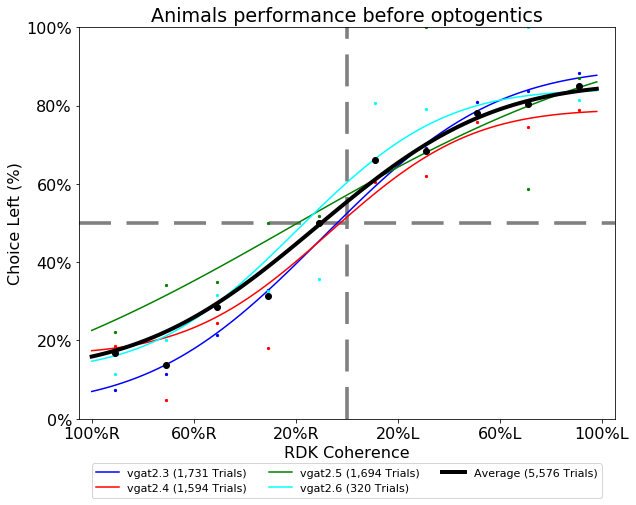

In [64]:
def temp(df):
  import datetime as dt
  names = ["vgat2.1","vgat2.5","vgat2.6"]
  names2 = ["vgat2.4"]
  df = df[((df.Name == "vgat2.1") & (df.Date < dt.date(year=2020, month=7, day=29))) |
          ((df.Name == "vgat2.3") & (df.Date < dt.date(year=2020, month=8, day=10))) |
          ((df.Name == "vgat2.4") & (df.Date < dt.date(year=2020, month=10, day=7))) |
          ((df.Name == "vgat2.5") & (df.Date < dt.date(year=2020, month=10, day=6))) |
          ((df.Name == "vgat2.6") & (df.Date < dt.date(year=2020, month=9, day=26))) ]
  import definitions
  print(df.columns)
  df = df[df.GUI_ExperimentType == definitions.ExpType.RDK]
  from report import analysis
  axes = analysis.psychAxes("Animals performance before optogentics",
                            combine_sides=False)
  clrs=['b','r','g','cyan','brown']
  analysis.psychByAnimal(df, use_chosen_days=None, PsycStim_axes=axes,
                         min_session_len=150,color_rdk=clrs,color_lc='yellow',
                         list_animals_individually=True, list_animals_in_legend=True)
  analysis.psychAll(df, PsycStim_axes=axes, color='k', legend_name="Average", linestyle="-")
  axes.set_title("Animals performance before optogentics")
  axes.legend(loc="upper center", bbox_to_anchor=(0.5, -0.1), ncol=3, fontsize="x-small")
  import matplotlib.pyplot as plt
  analysis.savePlot("proto/optogenetics/psych_all_animals_before_opto")
  plt.show()

temp(opto_df)

# Optogenetics Psychometric

brain_region: V1_L - Opto config: (<MatrixState.stimulus_delivery: 8>, 0, -1)
No valid sessions found for V1_L - . Returning
brain_region: V1_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.35)
No valid sessions found for V1_Bi - . Returning
brain_region: V1_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.3)
nfits for len: 615 = 81


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.3964105690204221 - β: 1.4843080341441672 - λ1: 0.06529068138363925 - λ2: 2.234539386202971e-07
nfits for len: 370 = 135


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.25588420733793504 - β: 0.7489109562811462 - λ1: 6.557526651707901e-07 - λ2: 0.27495643972920836
nfits for len: 8 = 200
α: 0.009723413783063498 - β: 1.1150579480221532 - λ1: 2.0215979203326028e-08 - λ2: 0.15636652971726073
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'green', 'marker': None, 'markersize': 5}
nfits for len: 106 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.01577656024705648 - β: 0.3988833823619086 - λ1: 0.21237283783859512 - λ2: 0.09033748334859025
nfits for len: 93 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.5719922171381049 - β: 0.06821639906319803 - λ1: 0.045454545384266354 - λ2: 0.3225806437017962
nfits for len: 8 = 200
α: 0.3842151530308865 - β: 0.17222812405231958 - λ1: 0.1235154031043155 - λ2: 0.204142165764512
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'green', 'marker': None, 'markersize': 5}


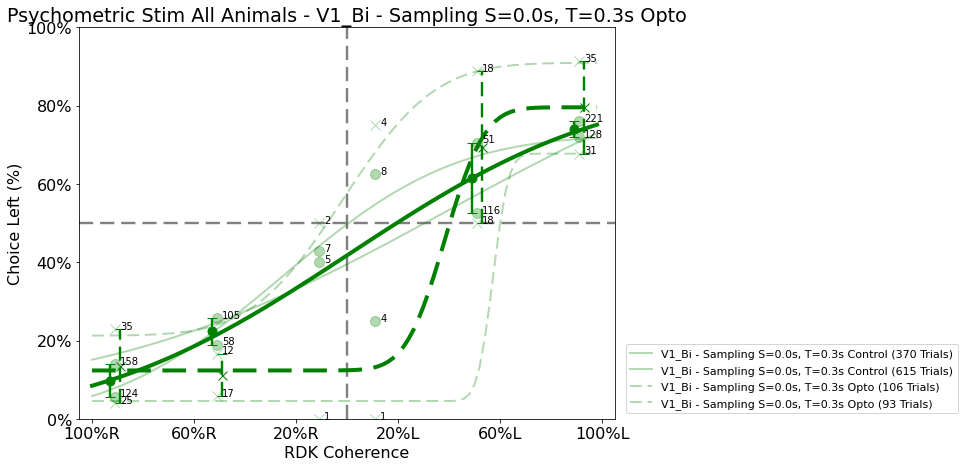

brain_region: V1_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0, -1)
nfits for len: 390 = 128


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.30025764310702935 - β: 1.1746799044746092 - λ1: 7.87807075157168e-08 - λ2: 0.11584575105556698
nfits for len: 447 = 111


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.2202100278501351 - β: 1.4014430451295914 - λ1: 0.18222983875445375 - λ2: 2.2073835531382705e-09
nfits for len: 471 = 106


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.007986289307551443 - β: 1.3457403205469705 - λ1: 6.01233255247069e-06 - λ2: 1.2878606227633932e-06
nfits for len: 1610 = 31


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.4110558884998571 - β: 1.3253687549196478 - λ1: 0.09308322258702234 - λ2: 1.687464849121446e-08
nfits for len: 397 = 125


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.3466592616117192 - β: 0.33817116065547326 - λ1: 0.22234767689228066 - λ2: 0.2160554725777569
nfits for len: 949 = 52


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.2321908465072655 - β: 0.9900954694567853 - λ1: 2.522821251974933e-07 - λ2: 0.08215181322576556
nfits for len: 598 = 83


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.3253152130315773 - β: 1.0546797745384953 - λ1: 4.612063533061539e-06 - λ2: 0.003111456332807078
nfits for len: 363 = 137


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.06510861146361692 - β: 0.8526937310585729 - λ1: 0.1729632278637842 - λ2: 0.19203527556338934
nfits for len: 52 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.17026465603503133 - β: 1.2019544115093226 - λ1: 4.591095118369184e-07 - λ2: 0.07831777200815464
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'green', 'marker': None, 'markersize': 5}
nfits for len: 58 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.21964526613508942 - β: 0.07006797860704488 - λ1: 0.49999999167188336 - λ2: 0.1724137900131149
nfits for len: 95 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.2641388610099048 - β: 1.335621891865852 - λ1: 0.20116842614886962 - λ2: 0.041297887975276386
nfits for len: 110 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.6589794191347873 - β: 2.1634426765586685 - λ1: 1.3221270348507769e-06 - λ2: 9.252692063339114e-07
nfits for len: 323 = 154


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.8452625466352066 - β: 0.02725250423401471 - λ1: 0.5102880723353447 - λ2: 0.37499999652706406
nfits for len: 156 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.44156574901609835 - β: 0.978689018781616 - λ1: 0.1633815212539605 - λ2: 0.024308453505600548
nfits for len: 232 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.008700231162341508 - β: 0.4191804328478613 - λ1: 0.3179220210533572 - λ2: 0.1219368100380862
nfits for len: 284 = 176


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.07002938320921617 - β: 0.981182168390299 - λ1: 0.1554575436715933 - λ2: 1.1555262431769341e-07
nfits for len: 90 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.39533819591924196 - β: 0.8766436760031115 - λ1: 0.0878265461726317 - λ2: 5.893750546263988e-07
nfits for len: 45 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.3579139297784608 - β: 1.09695004032096 - λ1: 0.31369059364111085 - λ2: 8.214924172689813e-07
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'green', 'marker': None, 'markersize': 5}


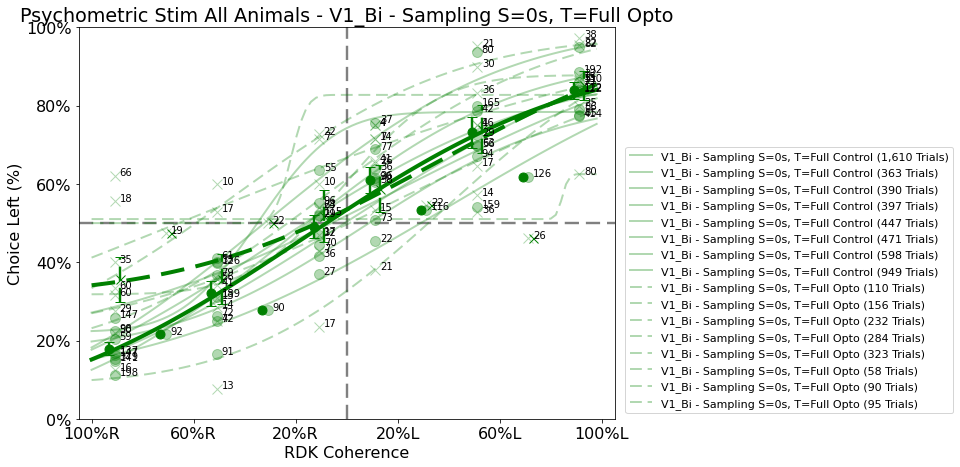

brain_region: V1_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.2, 3.0)
No valid sessions found for V1_Bi - . Returning
brain_region: V1_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.3, 0.3)
nfits for len: 612 = 81


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.016533599600988227 - β: 1.158156175784662 - λ1: 0.04094552165254304 - λ2: 0.045852501835570145
nfits for len: 268 = 186


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.1381650793871653 - β: 0.5551913186956887 - λ1: 0.023025456022536854 - λ2: 0.21540979396260612
nfits for len: 12 = 200
α: 0.10504228517225431 - β: 0.7528263051385085 - λ1: 0.05847649613286569 - λ2: 0.13536312882403254
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'green', 'marker': None, 'markersize': 5}
nfits for len: 98 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.17447022472112134 - β: 0.9535758968353365 - λ1: 2.317210447087919e-09 - λ2: 0.001244111469083875
nfits for len: 61 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.6154497644502619 - β: 0.573522142982611 - λ1: 0.12889765051137997 - λ2: 5.565085308380029e-06
nfits for len: 8 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.1640806081906187 - β: 0.9652144380703668 - λ1: 1.982932515863861e-05 - λ2: 3.5981235625429355e-07
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'green', 'marker': None, 'markersize': 5}


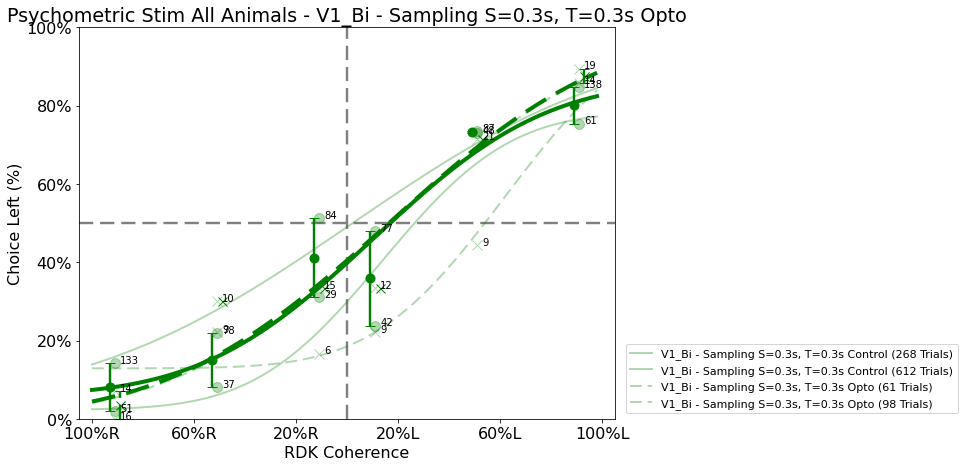

brain_region: V1_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.6, 1.0)
nfits for len: 487 = 102


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.2493086637897191 - β: 1.2143384784965616 - λ1: 2.8813634008471896e-09 - λ2: 0.131410018051419
nfits for len: 324 = 154


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.2704667382665218 - β: 0.8437624958572599 - λ1: 7.651121712448813e-07 - λ2: 0.22088663506439915
nfits for len: 11 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.11407494284276398 - β: 1.073949959599282 - λ1: 2.1801638909590945e-08 - λ2: 0.12965621469338254
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'green', 'marker': None, 'markersize': 5}
nfits for len: 105 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.10622541677590924 - β: 1.1307638450190622 - λ1: 0.003147285059164697 - λ2: 3.7951883565811136e-05
nfits for len: 90 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.4164665772736095 - β: 0.18126077419344272 - λ1: 0.11566913767542422 - λ2: 0.43800276842602925
nfits for len: 8 = 200
α: 0.0851404686261627 - β: 1.1847557551805306 - λ1: 6.637052490063265e-07 - λ2: 0.1007070791067817
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'green', 'marker': None, 'markersize': 5}


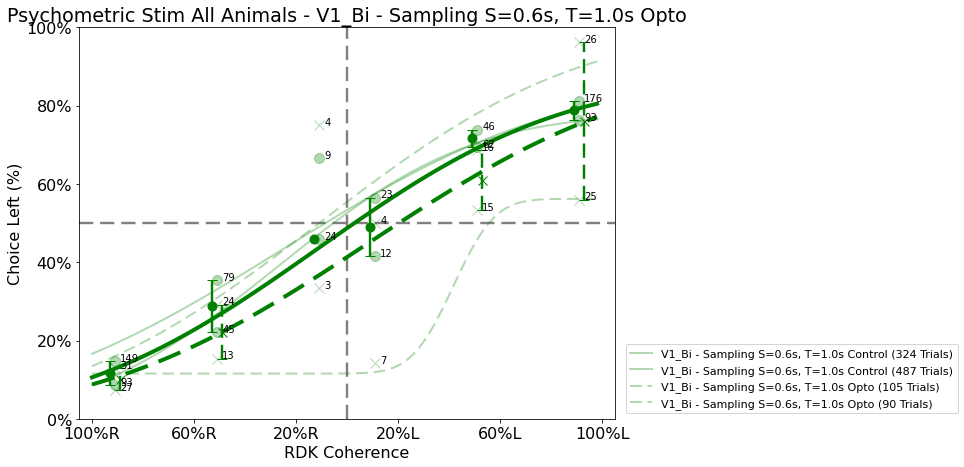

brain_region: V1_Bi - Opto config: (<MatrixState.CenterPortRewardDelivery: 11>, 0, -1)
nfits for len: 138 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.13168288731542352 - β: 0.01316462891723973 - λ1: 0.3077041054635891 - λ2: 0.11940329698304224
nfits for len: 598 = 83


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.028471061400432054 - β: 1.2471094270388035 - λ1: 2.8228290637227518e-08 - λ2: 0.14912127099981443
nfits for len: 482 = 103


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.011798598325018509 - β: 1.5680645622427534 - λ1: 1.3305535101499648e-07 - λ2: 0.10486214527589893
nfits for len: 22 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.005499874733696453 - β: 0.9137482442226696 - λ1: 0.11987682811157523 - λ2: 0.148649985456223
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'green', 'marker': None, 'markersize': 5}
nfits for len: 169 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.07956211425326801 - β: 0.5235095638425116 - λ1: 1.2316233400976014e-09 - λ2: 0.052181931475702215
nfits for len: 222 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.06803593991000013 - β: 0.7182126021050939 - λ1: 0.17245519143494187 - λ2: 0.18990651972776337
nfits for len: 205 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.49000462084655816 - β: 0.024278973831799645 - λ1: 0.3826001193920303 - λ2: 0.2500002761367104
nfits for len: 20 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.1132284394003194 - β: 0.6025104156037754 - λ1: 0.1982953627862342 - λ2: 0.14582257249417713
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'green', 'marker': None, 'markersize': 5}


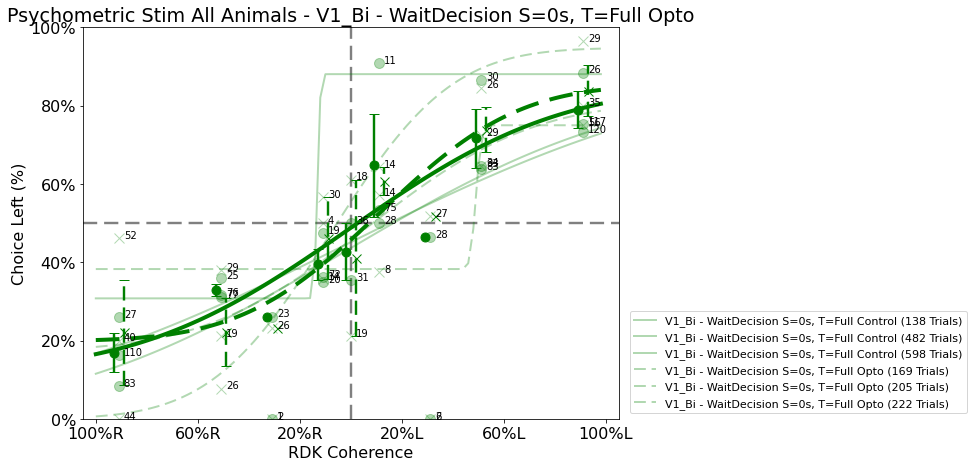

brain_region: ALM_R - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.3, 0.3)
No valid sessions found for ALM_R - . Returning
brain_region: ALM_R - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.65, 1.0)
No valid sessions found for ALM_R - . Returning
brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.35)
nfits for len: 277 = 180


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.06692946668787571 - β: 0.70200500565578 - λ1: 0.17770189405716869 - λ2: 0.04874257614311529
nfits for len: 695 = 71


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.05484037368261355 - β: 1.6002657926913013 - λ1: 0.010767230724646637 - λ2: 4.585461591554341e-07
nfits for len: 569 = 87


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.20851109737361911 - β: 1.0193336973697251 - λ1: 0.1451464200482625 - λ2: 0.06025066122254039
nfits for len: 176 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.055829930262076895 - β: 0.7359464170014953 - λ1: 0.04954993815323837 - λ2: 0.10875881974087126
nfits for len: 1090 = 45


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.014132971176506486 - β: 0.7297601183950967 - λ1: 0.10246319299218565 - λ2: 0.10361413077939363
nfits for len: 462 = 108


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.027829952069751453 - β: 0.49640904907840655 - λ1: 0.14394711222517975 - λ2: 0.20629380371635408
nfits for len: 37 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.05768285608227003 - β: 0.4315168564364935 - λ1: 0.19284164940445475 - λ2: 0.16778593875952832
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}
nfits for len: 67 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.23938471990948912 - β: 0.0024909165192804105 - λ1: 2.5953221331599663e-08 - λ2: 0.7999680148305762
nfits for len: 91 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.39195234732585205 - β: 2.301795320065371 - λ1: 3.3692226724581663e-09 - λ2: 0.192439716809795
nfits for len: 41 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.1601877032393619 - β: 0.006315991271990696 - λ1: 0.20000747111641667 - λ2: 0.19230612243603978
nfits for len: 88 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.012574920641842296 - β: 1.0963436566051505 - λ1: 1.1917256732029136e-08 - λ2: 0.03810856979550581
nfits for len: 433 = 115


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.14228432108036404 - β: 1.0134789223834968 - λ1: 0.11725590559224289 - λ2: 0.09788219252355485
nfits for len: 231 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.4842666048470654 - β: 0.07023328604683485 - λ1: 0.17647058445467811 - λ2: 0.26950354773334007
nfits for len: 24 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.3237686688287581 - β: 0.575450631087471 - λ1: 0.11247255742882986 - λ2: 0.2986363028928753
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}


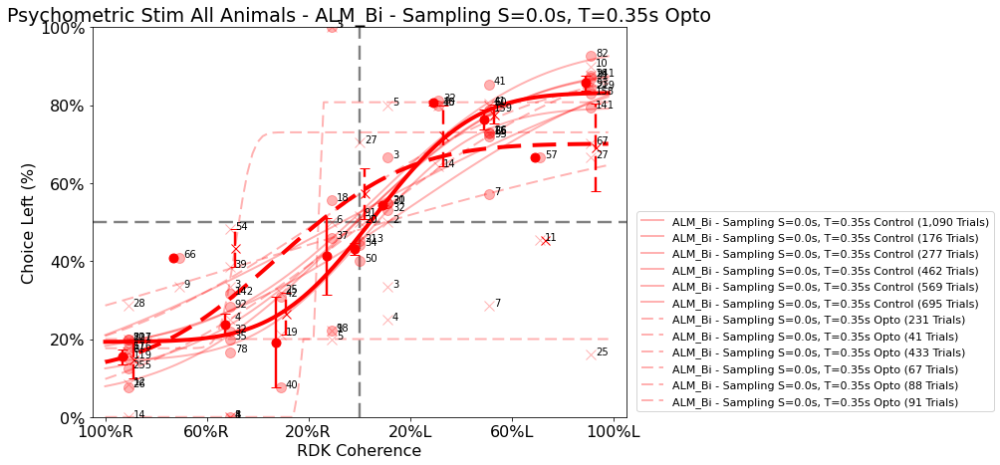

brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.3)
nfits for len: 215 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.2180321631217914 - β: 1.8717668339046631 - λ1: 0.015709745537132086 - λ2: 2.8636028454530123e-08
nfits for len: 267 = 187


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.44901256889975905 - β: 0.7946452682056456 - λ1: 0.11645244360835187 - λ2: 0.12478997261040457
nfits for len: 9 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.47153366988743506 - β: 0.1086573962652104 - λ1: 0.23224667725613896 - λ2: 0.20388655723619906
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}
nfits for len: 53 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.5920289301040589 - β: 0.07219419959564186 - λ1: 0.172413790858244 - λ2: 0.1176470612208001
nfits for len: 54 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.5497016656082072 - β: 0.18830676664444201 - λ1: 0.0009148545627178646 - λ2: 0.25735866790352424
nfits for len: 4 = 200
α: -0.2832392861801892 - β: 0.26848315981219656 - λ1: 0.0710777421456641 - λ2: 0.20168007142481817
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}


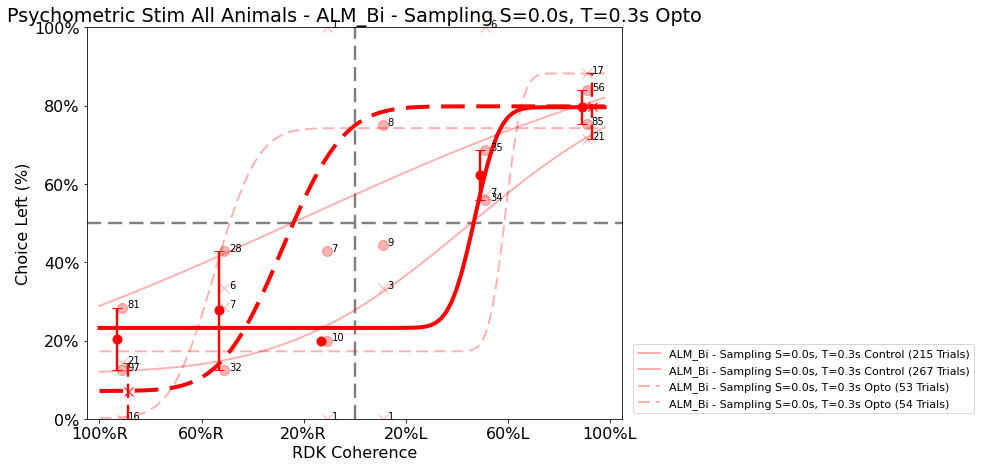

brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0, -1)
nfits for len: 1198 = 41


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.014449286293130893 - β: 0.9985848869655145 - λ1: 0.16945349292822 - λ2: 0.0832135948473669
nfits for len: 463 = 107


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.17345748526873914 - β: 1.2766278016957293 - λ1: 0.10293464644897488 - λ2: 0.17319567320215812
nfits for len: 694 = 72


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.01944725952188458 - β: 0.7345757627104492 - λ1: 0.17548687033657448 - λ2: 0.29722711497830606
nfits for len: 1079 = 46


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.19431520882819714 - β: 0.6805864234508955 - λ1: 0.17291973157899598 - λ2: 0.20085279593963412
nfits for len: 562 = 88


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.1392307539106033 - β: 0.8539443067304495 - λ1: 0.05074458690255945 - λ2: 7.211308752761611e-09
nfits for len: 369 = 135


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.20607235818153147 - β: 1.024465312411971 - λ1: 0.028787215257647242 - λ2: 2.495597374721649e-08
nfits for len: 645 = 77


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.08512143257926275 - β: 0.9162236214191904 - λ1: 0.015974802333562826 - λ2: 0.11235627356778753
nfits for len: 42 = 200
α: -0.014617320069972217 - β: 0.9873432988268435 - λ1: 0.0692067282570012 - λ2: 0.09908424863326101
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}
nfits for len: 142 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.5175970493261792 - β: 0.06041005572616884 - λ1: 0.6436781607156093 - λ2: 0.44736841406130995
nfits for len: 22 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.5213965444681057 - β: 0.28838945738593724 - λ1: 0.8601181150512052 - λ2: 0.4545475761447234
nfits for len: 307 = 162


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.42785885759953224 - β: 1.5366663175291886 - λ1: 0.10339504462907864 - λ2: 4.29701221311728e-07
nfits for len: 164 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.8223639019257214 - β: 0.6755413841206406 - λ1: 1.0614170604691372e-05 - λ2: 0.29272069589898664
nfits for len: 159 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.07889992859624644 - β: 0.005161814506581567 - λ1: 0.4605256860797636 - λ2: 0.28915592605532436
nfits for len: 145 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.718195996544973 - β: 1.3477488946394147 - λ1: 0.182389279669764 - λ2: 3.310407200962155e-08
nfits for len: 174 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.3036254099625585 - β: 1.6587347540833308 - λ1: 0.07356238730584466 - λ2: 9.530645865461172e-09
nfits for len: 36 = 200
α: -0.35916943778741695 - β: 2.33664367627331 - λ1: 6.593928341533177e-08 - λ2: 0.11021389817214587
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}


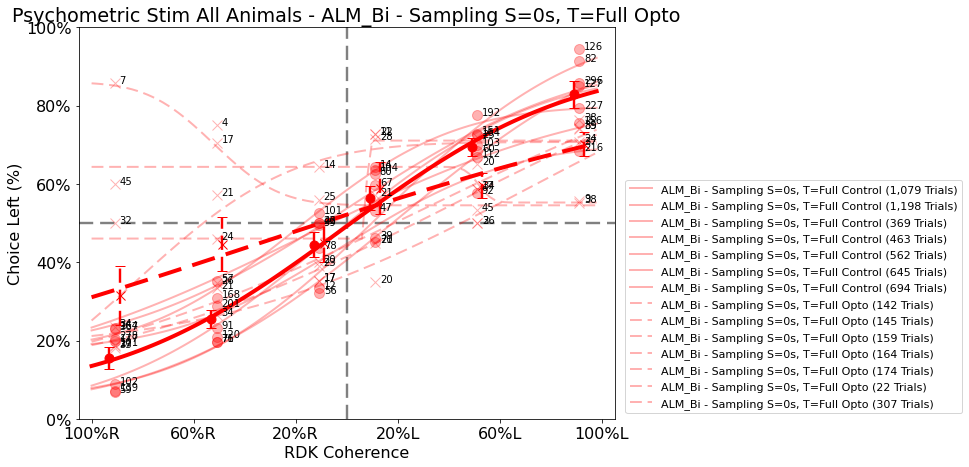

brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.3, 0.3)
nfits for len: 283 = 176


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.06176418572452866 - β: 1.1362009311166115 - λ1: 0.14868308018021598 - λ2: 1.4473388104036388e-06
nfits for len: 451 = 110


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.002066895666558816 - β: 0.7167901729641966 - λ1: 0.02461312378815693 - λ2: 0.17948668529625267
nfits for len: 12 = 200
α: 0.023652467622636036 - β: 0.9002547258505557 - λ1: 0.07649799504294168 - λ2: 0.08191387904407615
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}
nfits for len: 74 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.9161442524368482 - β: 0.12303557310200569 - λ1: 0.4062794646081268 - λ2: 0.0006724747132920339
nfits for len: 77 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.11257543889397573 - β: 0.8275713939357325 - λ1: 1.0588963400841945e-09 - λ2: 0.1443649236363116
nfits for len: 10 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.15126728361182573 - β: 1.160609795497638 - λ1: 0.04695151306713796 - λ2: 2.910668893902462e-07
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}


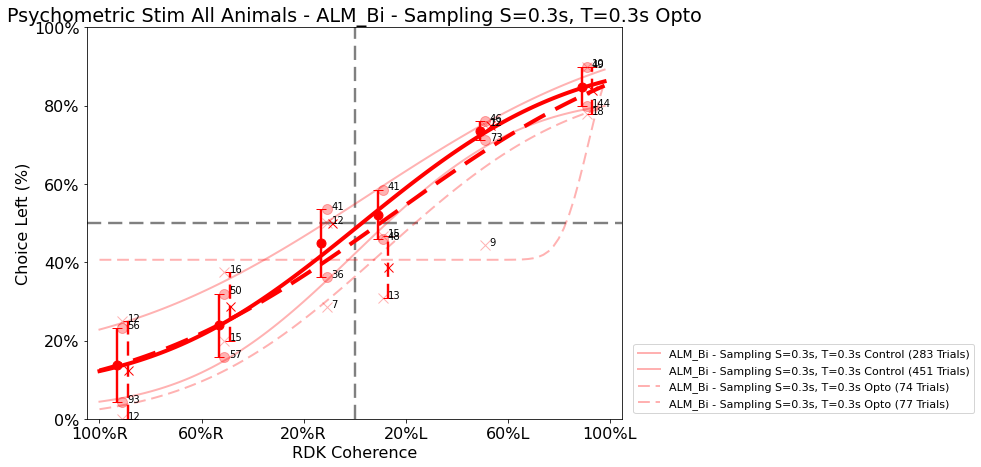

brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.35, 1.0)
No valid sessions found for ALM_Bi - . Returning
brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.6, 1.0)
nfits for len: 603 = 82


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.15368259528667771 - β: 1.5410805741298943 - λ1: 1.393504081928156e-07 - λ2: 5.657440254972703e-07
nfits for len: 134 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.21707873402843442 - β: 0.01721165428959094 - λ1: 0.2031244870646209 - λ2: 0.21211653376859724


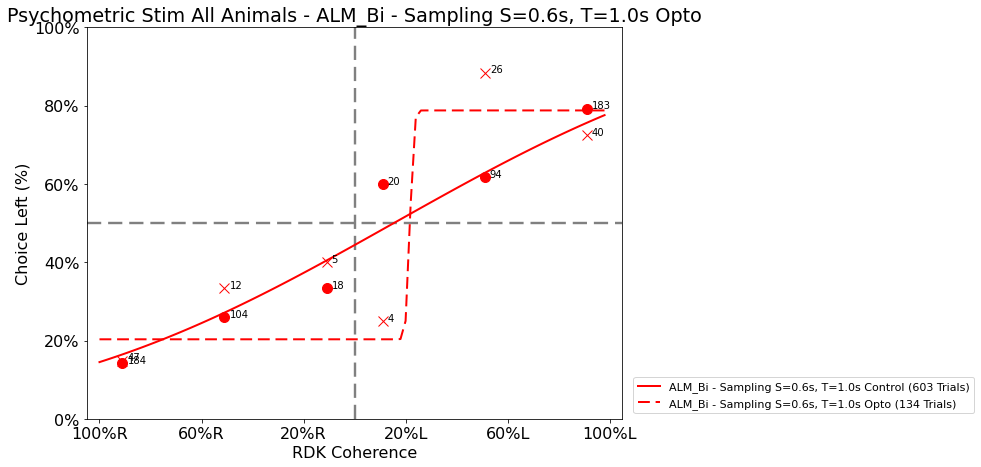

brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.65, 1.0)
nfits for len: 566 = 88


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.328501535384363 - β: 1.3572014437799185 - λ1: 0.17886460372976642 - λ2: 0.05729761719658865
nfits for len: 454 = 110


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.007950866672640056 - β: 0.6375158357376787 - λ1: 0.06835808505934146 - λ2: 0.21599701715825997
nfits for len: 1156 = 43


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.05451607102307801 - β: 1.115257656757447 - λ1: 0.1904934524206987 - λ2: 0.1161742872648765
nfits for len: 902 = 55


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.10325773641858418 - β: 0.5521716045341327 - λ1: 0.30333122898738774 - λ2: 0.20152524923159346
nfits for len: 635 = 78


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.23474972855517784 - β: 0.7380688381476721 - λ1: 0.06469252633948419 - λ2: 0.12575171670557717
nfits for len: 437 = 114


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.045045142747215536 - β: 0.5967254992078408 - λ1: 0.10581823486544858 - λ2: 0.2570420704209064
nfits for len: 987 = 50


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.21155268283720258 - β: 0.8414916444025169 - λ1: 0.1081280464730964 - λ2: 0.06571040532323702
nfits for len: 1228 = 40


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.3392867327127931 - β: 1.2925766019337068 - λ1: 4.9719320761829075e-08 - λ2: 0.1430770017794203
nfits for len: 49 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.013977235593550404 - β: 0.9442896231967042 - λ1: 0.11860752504902022 - λ2: 0.1287150519813015
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}
nfits for len: 125 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.08414880017949816 - β: 0.5175590109512481 - λ1: 0.24463391936657303 - λ2: 0.17899490743145713
nfits for len: 77 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.5462186861206793 - β: 0.8614446359429084 - λ1: 8.425348617480346e-07 - λ2: 0.3363079479528499
nfits for len: 89 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.49868587750669346 - β: 0.018234017170032986 - λ1: 0.5128205069936314 - λ2: 0.2599999983222907
nfits for len: 73 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.13373721988162277 - β: 0.06498646123179619 - λ1: 0.5116278971545459 - λ2: 0.230769218301698
nfits for len: 154 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.10659692930407691 - β: 0.01747928573336753 - λ1: 0.45054945122336476 - λ2: 0.3174603147457936
nfits for len: 118 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.5253804652790848 - β: 0.21340990731445608 - λ1: 0.19969555112628065 - λ2: 0.46438003455640164
nfits for len: 182 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.3674177740179578 - β: 1.571584612414155 - λ1: 0.010161489555450032 - λ2: 0.19691682356900325
nfits for len: 279 = 179


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.7613536749351371 - β: 2.0350624416608705 - λ1: 2.7318141549962917e-08 - λ2: 0.2719243052138115
nfits for len: 35 = 200
α: -0.31246362675840933 - β: 1.0910425647974493 - λ1: 0.21965878416440707 - λ2: 0.289296814218322
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}


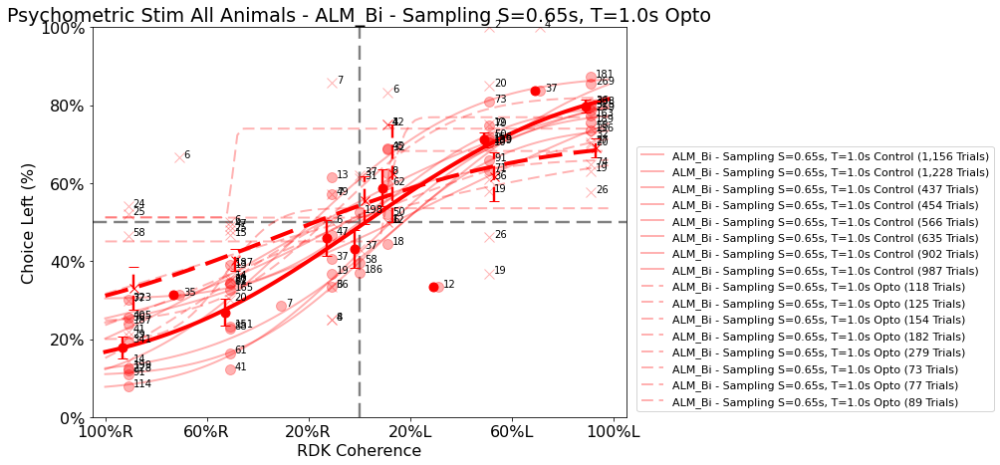

brain_region: ALM_Bi - Opto config: (<MatrixState.CenterPortRewardDelivery: 11>, 0, -1)
nfits for len: 545 = 91


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.40663667328591724 - β: 0.999081695245764 - λ1: 1.6902776120843978e-08 - λ2: 0.11785361476488726
nfits for len: 538 = 92


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.06563808972045304 - β: 0.7041555138902711 - λ1: 0.18811017551794668 - λ2: 0.22700508503971095
nfits for len: 919 = 54


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.4923494355814363 - β: 1.1711602808095187 - λ1: 4.594271531879328e-07 - λ2: 0.1608480991481348
nfits for len: 199 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.07665778311369612 - β: 0.7242353747838433 - λ1: 0.05009780941964689 - λ2: 1.6462204236702263e-08
nfits for len: 409 = 122


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.18012032460002853 - β: 1.0092122789960292 - λ1: 0.05612141376368418 - λ2: 0.047842833977839866
nfits for len: 251 = 199


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.22631332066131715 - β: 0.9439095556396704 - λ1: 4.6717637168700206e-08 - λ2: 0.014203934529133645
nfits for len: 36 = 200
α: -0.0571829057827945 - β: 1.0187522306537051 - λ1: 0.028405177036721505 - λ2: 0.06214009553552834
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}
nfits for len: 98 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.4692398296430209 - β: 0.021402676569921744 - λ1: 0.10345145005525161 - λ2: 0.7250006261582533
nfits for len: 86 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.26584864485207105 - β: 0.013649348854044488 - λ1: 0.732142827383929 - λ2: 0.16666669389500582
nfits for len: 133 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.8961533667741781 - β: 0.012504760228299416 - λ1: 3.6692039869771154e-08 - λ2: 0.9258969943313016
nfits for len: 98 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.025180438365789766 - β: 0.1127401579424144 - λ1: 0.40915834678480534 - λ2: 0.06920843593742096
nfits for len: 197 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.40815617727098896 - β: 2.006632849004708 - λ1: 0.4114694261899179 - λ2: 1.719278311149854e-08
nfits for len: 122 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.703000406458573 - β: 0.17455102667385747 - λ1: 0.4186391575019235 - λ2: 0.32388121667188075
nfits for len: 29 = 200
α: -0.39523631037270845 - β: 0.3336329335347972 - λ1: 0.3450666438148845 - λ2: 0.39536267140482095
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}


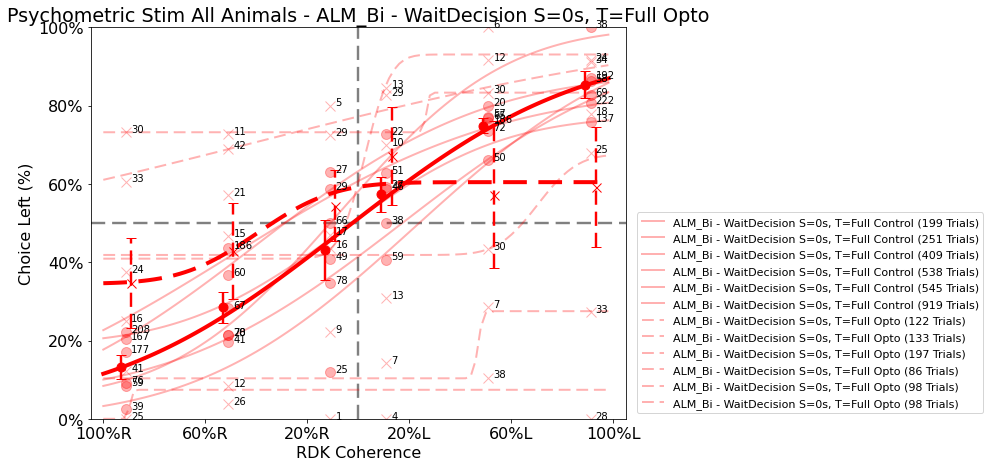

brain_region: PPC_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.35)
nfits for len: 357 = 140


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.08787896907748291 - β: 0.965637523017742 - λ1: 5.54936983417262e-08 - λ2: 0.08066919642242668
nfits for len: 54 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.17647252793431906 - β: 1.0572248069362056 - λ1: 4.1075334949856615e-08 - λ2: 0.29365364942355626
nfits for len: 443 = 112


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.024378783240905033 - β: 0.8833180881743582 - λ1: 0.264801695255579 - λ2: 0.07891631056792142
nfits for len: 435 = 114


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.08556555847973946 - β: 1.2231352403572413 - λ1: 0.2215020324238099 - λ2: 0.14366367294274163
nfits for len: 21 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.02954159251473742 - β: 1.0300800935528103 - λ1: 0.0867888567413534 - λ2: 0.12052537045261474
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}
nfits for len: 94 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.16057717014356443 - β: 0.4986459971328795 - λ1: 0.13792439673742166 - λ2: 0.2233373659283183
nfits for len: 33 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.4576879483615935 - β: 0.0832395844046766 - λ1: 0.2352941116370369 - λ2: 0.19999999610386718
nfits for len: 183 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.27240422257271046 - β: 1.8240958828281961 - λ1: 0.021315273970929402 - λ2: 3.7537870139972466e-08
nfits for len: 180 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.3752550012953466 - β: 0.24316581272952126 - λ1: 0.21049416896550358 - λ2: 0.4432707362971705
nfits for len: 17 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.29000038139758183 - β: 1.5861622962160205 - λ1: 0.04599650192362324 - λ2: 2.389269781461231e-08
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}


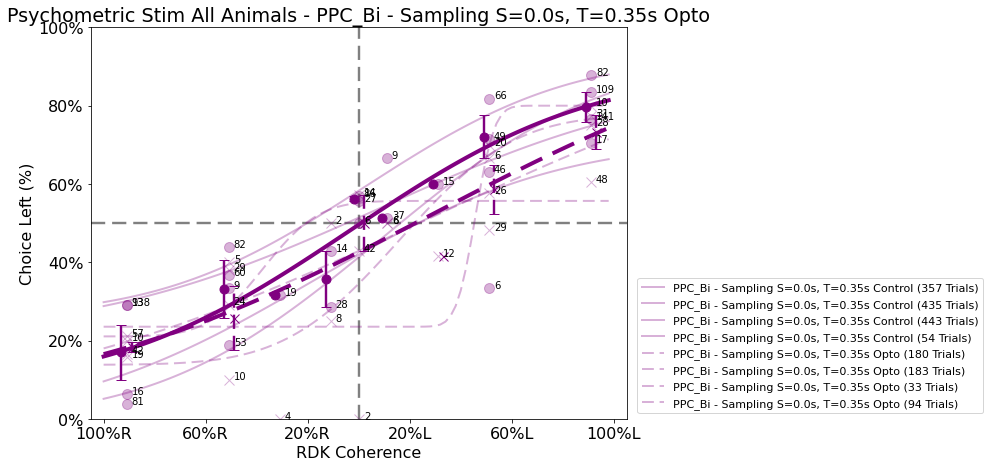

brain_region: PPC_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.3)
nfits for len: 739 = 67


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.40024311840031906 - β: 1.0419891434246402 - λ1: 0.13688193694310952 - λ2: 6.445012020649915e-09
nfits for len: 390 = 128


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.24214236124934962 - β: 1.15531243185997 - λ1: 4.0371466840080614e-08 - λ2: 0.21678536269598125
nfits for len: 11 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.33856083873029363 - β: 1.1506132054578664 - λ1: 0.0968972055759934 - λ2: 3.500518115582077e-07
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}
nfits for len: 97 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.48079414731603154 - β: 0.23656676702628723 - λ1: 0.3043005252803408 - λ2: 0.06390620039895752
nfits for len: 111 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.39664727493270313 - β: 0.050714241081568426 - λ1: 0.20754719067922764 - λ2: 0.4137931331978766
nfits for len: 8 = 200
α: 0.2717247344171591 - β: 0.4723363602223488 - λ1: 0.23843024247447092 - λ2: 0.2091002982468107
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}


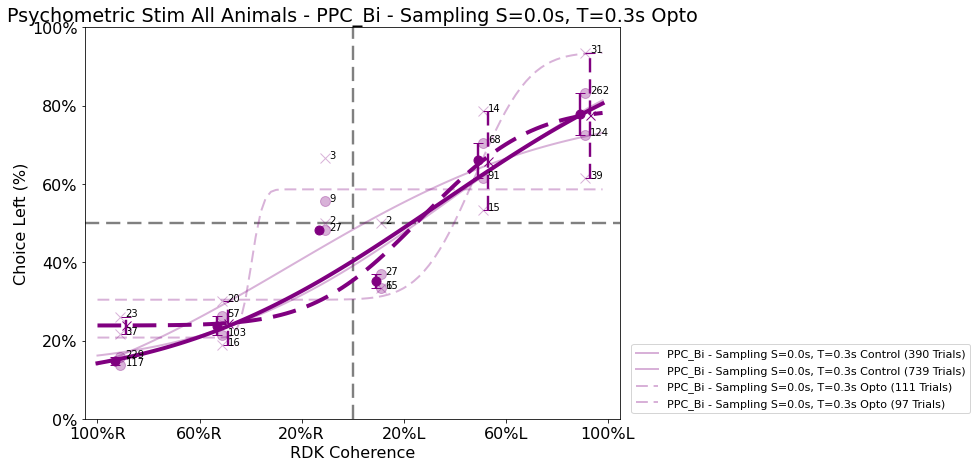

brain_region: PPC_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0, -1)
nfits for len: 269 = 185


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.2330250529255316 - β: 0.6989897681665398 - λ1: 0.14836845914970803 - λ2: 0.15187379192841088
nfits for len: 273 = 183


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.13299555840090166 - β: 0.8077258015235789 - λ1: 0.09416441083712052 - λ2: 0.18009541441759358
nfits for len: 931 = 53


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.12571560801645942 - β: 0.5322714402463795 - λ1: 0.29458839934277237 - λ2: 0.20700535628472178
nfits for len: 200 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.0011550421352897744 - β: 0.902095826071564 - λ1: 4.811573158095811e-09 - λ2: 0.18910829546052854
nfits for len: 388 = 128


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.18707307072281823 - β: 1.1588854701060203 - λ1: 0.03572668369531127 - λ2: 4.1250315480739104e-07
nfits for len: 152 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.006806461274057457 - β: 0.6653205685967272 - λ1: 0.055098838220801194 - λ2: 0.11803843610934954
nfits for len: 253 = 197


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.1704922642940827 - β: 0.9966368761680306 - λ1: 2.2932075098762598e-07 - λ2: 0.12299155137964946
nfits for len: 40 = 200
α: -0.06086443819346976 - β: 0.9469615138136767 - λ1: 0.045303873362659945 - λ2: 0.11546357597115765
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}
nfits for len: 52 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.5906500990503205 - β: 0.5579665330010406 - λ1: 0.3573846924050271 - λ2: 4.787334463764161e-07
nfits for len: 66 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.5989900298128796 - β: 0.9881568370498339 - λ1: 0.24542067837316245 - λ2: 4.0231657734260263e-08
nfits for len: 161 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.5754370699212346 - β: 0.0675646957916643 - λ1: 0.15053858478814292 - λ2: 0.5434794152638286
nfits for len: 113 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.47557368166405795 - β: 0.004570307804358315 - λ1: 0.3555555507402568 - λ2: 0.23529411285939716
nfits for len: 114 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.44657304146551213 - β: 0.07193301101207192 - λ1: 0.5081888635396339 - λ2: 0.13514142715013108
nfits for len: 62 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.0026140363327149477 - β: 0.02225357006794159 - λ1: 0.28571040777020756 - λ2: 0.11111320167960306
nfits for len: 113 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.537382794847465 - β: 0.0069510548247599755 - λ1: 0.1641791029983253 - λ2: 0.4999999993645714
nfits for len: 29 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.5074636479874036 - β: 1.6625484179052967 - λ1: 0.19869817338699333 - λ2: 3.0179176733776647e-08
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}


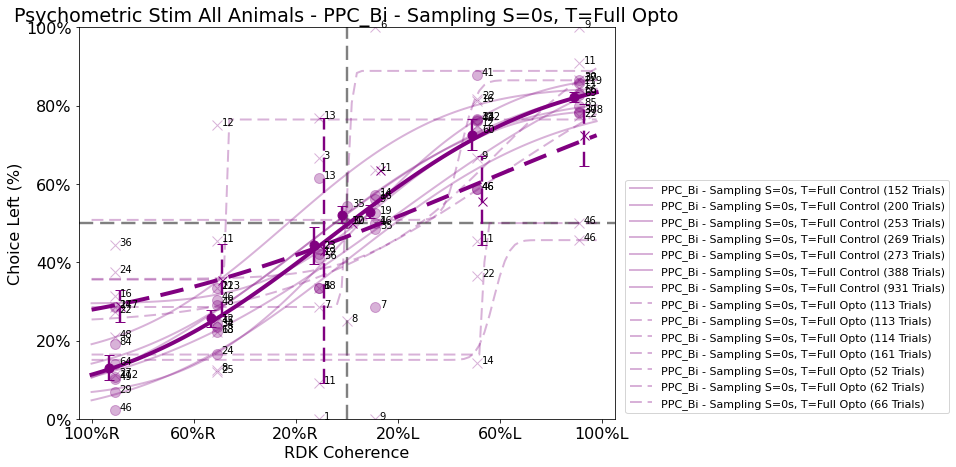

brain_region: PPC_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.3, 0.3)
nfits for len: 291 = 171


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.4024847346439657 - β: 0.8547535340169565 - λ1: 9.373719273777945e-07 - λ2: 0.16969395772504622
nfits for len: 656 = 76


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.1354998634013182 - β: 1.0342009419343152 - λ1: 0.2713108185689931 - λ2: 0.01780379702385517
nfits for len: 482 = 103


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.18093780845908214 - β: 0.9616813841618019 - λ1: 0.0042699155484241 - λ2: 0.06610872050759803
nfits for len: 18 = 200
α: 0.0011752165337512816 - β: 0.92264414094369 - λ1: 0.09934393517244634 - λ2: 0.0825329230756516
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}
nfits for len: 52 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.18623293995228973 - β: 0.08850568117078988 - λ1: 0.3684160704750737 - λ2: 0.11110573916947525
nfits for len: 60 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.10254305998984801 - β: 0.5870731280126658 - λ1: 0.3877362561375289 - λ2: 0.07103788480617279
nfits for len: 127 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.2562448211537481 - β: 1.145091400246591 - λ1: 0.029306066317077672 - λ2: 5.6557713330315996e-08
nfits for len: 11 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.050738652804680456 - β: 1.0963629034985294 - λ1: 0.11782456616664938 - λ2: 3.8009304643073864e-07
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}


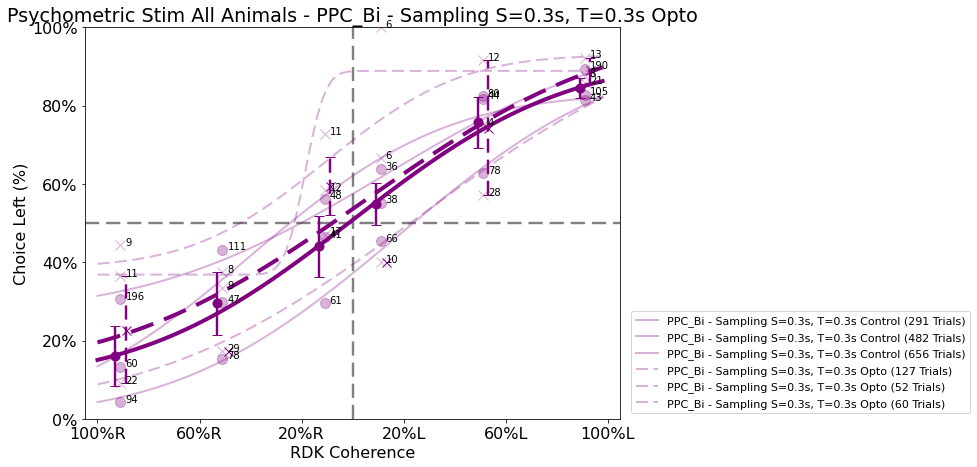

brain_region: PPC_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.35, 1.0)
No valid sessions found for PPC_Bi - . Returning
brain_region: PPC_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.35, 0.0)
No valid sessions found for PPC_Bi - . Returning
brain_region: PPC_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.6, 1.0)
nfits for len: 394 = 126


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.34773668415415243 - β: 0.4248361279681692 - λ1: 0.17449899181544926 - λ2: 0.1737344809153031
nfits for len: 656 = 76


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.44940230140647275 - β: 1.1176138679328642 - λ1: 0.04660300433897162 - λ2: 0.04587061861877389
nfits for len: 12 = 200
α: 0.2278842024140862 - β: 0.5009818845807064 - λ1: 0.1336106202284367 - λ2: 0.21274010281877057
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}
nfits for len: 94 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.42679285680146806 - β: 0.5169154258834463 - λ1: 0.17502748906712728 - λ2: 0.0993446548411638
nfits for len: 141 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.40766612095524657 - β: 0.8330605902918878 - λ1: 1.1086140827256319e-08 - λ2: 0.2544383615192783
nfits for len: 8 = 200
α: -0.02692892882375466 - β: 0.7921282489885879 - λ1: 0.09582273607113445 - λ2: 0.16786737577368294
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}


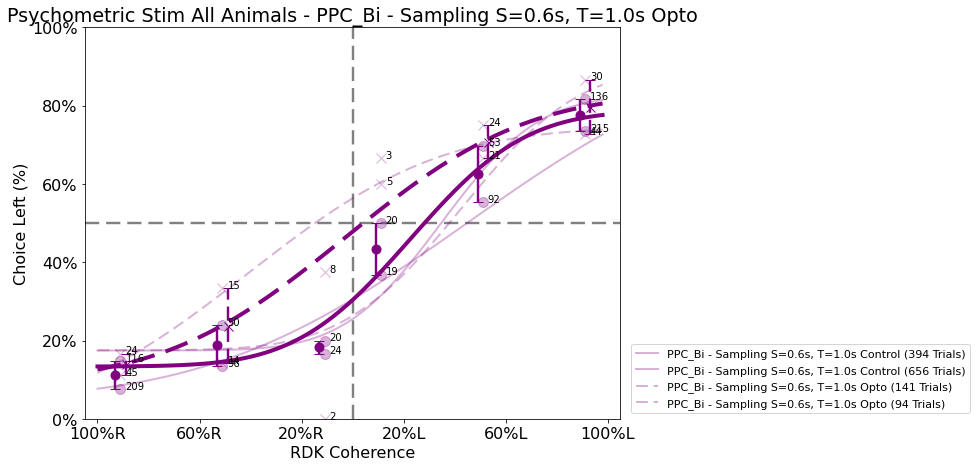

brain_region: PPC_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.65, 1.0)
nfits for len: 236 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.3533680627171707 - β: 1.0725012313518993 - λ1: 0.22270534359674615 - λ2: 0.05603966331857423
nfits for len: 291 = 171


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.10099557219339667 - β: 0.9578885094692279 - λ1: 1.0678246957243197e-05 - λ2: 0.10564341900291419
nfits for len: 1297 = 38


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.22662109867388547 - β: 1.204865254078912 - λ1: 0.04089862499590795 - λ2: 1.228277787240339e-07
nfits for len: 1065 = 46


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.2169158016619553 - β: 0.6005120311550347 - λ1: 0.22651235775277456 - λ2: 0.26546747667807885
nfits for len: 26 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.2856994098401875 - β: 1.1731010389840788 - λ1: 0.10543248411386408 - λ2: 1.6609375866653065e-07
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}
nfits for len: 73 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.020500676016225385 - β: 1.0687024258572937 - λ1: 0.3311550651714305 - λ2: 0.325037237543058
nfits for len: 140 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.6450618894934503 - β: 1.4562449308124035 - λ1: 4.5087532207265875e-08 - λ2: 0.062447543912178244
nfits for len: 618 = 80


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.2143395310689531 - β: 1.8699356869688002 - λ1: 7.711833808178052e-07 - λ2: 0.009649329766766798
nfits for len: 491 = 101


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.9832586116641242 - β: 1.2610313369962447 - λ1: 0.34867836819364484 - λ2: 2.891991985750951e-07
nfits for len: 21 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.6044992010769594 - β: 1.4339833917022715 - λ1: 0.2707457122611798 - λ2: 2.914373387487333e-08
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}


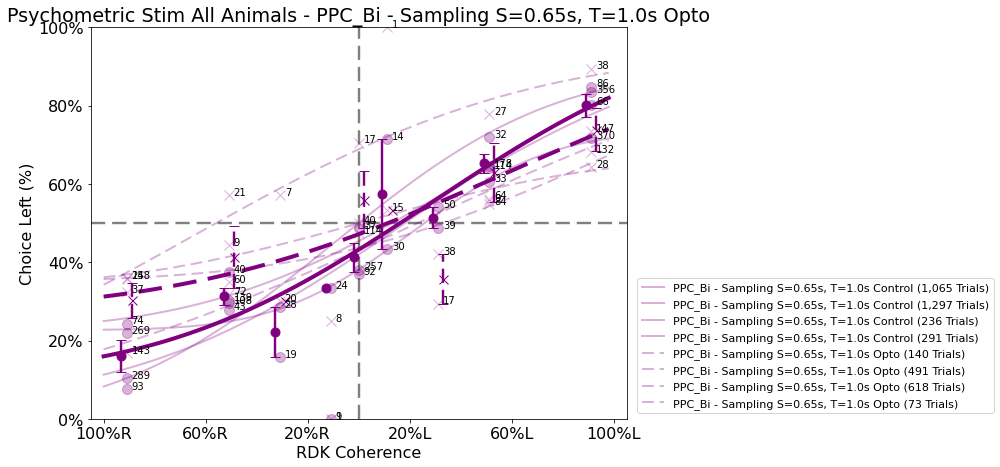

brain_region: PPC_Bi - Opto config: (<MatrixState.CenterPortRewardDelivery: 11>, 0, -1)
nfits for len: 157 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.21484708902179597 - β: 0.036620801172710604 - λ1: 0.29310697364432076 - λ2: 0.13923972498550802
nfits for len: 561 = 89


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.1678620624220582 - β: 0.5551633439356116 - λ1: 0.07980452681976402 - λ2: 0.1927388556933044
nfits for len: 165 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.015302475229671509 - β: 0.4843462377641393 - λ1: 0.12479155866029065 - λ2: 0.12674299860146787
nfits for len: 19 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.12747760942936273 - β: 0.3421194739959109 - λ1: 0.1757419731673355 - λ2: 0.169746739993029
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}
nfits for len: 128 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.8441990287077403 - β: 1.4750251766271707 - λ1: 0.07457133533507598 - λ2: 0.04987169698400794
nfits for len: 182 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.15534862768488203 - β: 0.6655191246444888 - λ1: 0.28073764366782633 - λ2: 0.23361568102316513
nfits for len: 175 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.12797537140717125 - β: 1.2347849017430423 - λ1: 4.1219484603452635e-05 - λ2: 0.009012590627149224
nfits for len: 17 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.462084719976198 - β: 1.2266538379416876 - λ1: 0.14098468904476502 - λ2: 3.7252261052054907e-07
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}


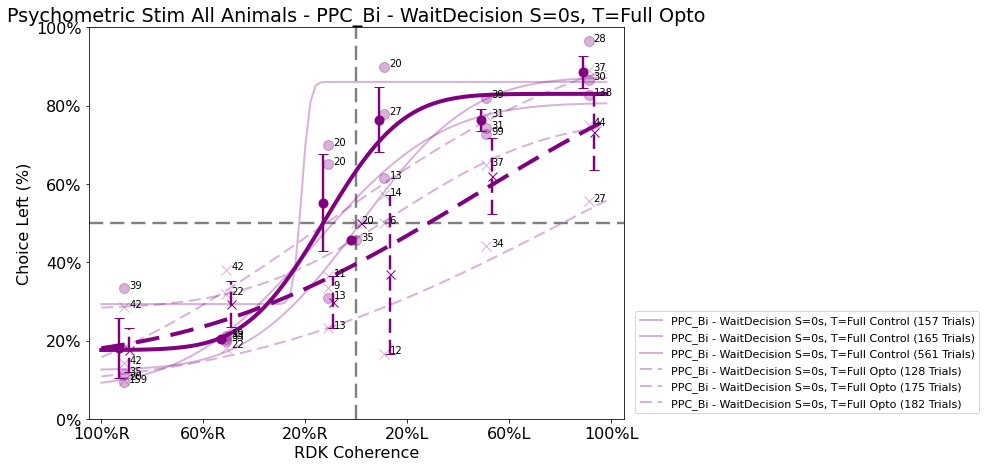

brain_region: POR_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0, -1)
nfits for len: 318 = 157


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.39489136219440746 - β: 1.1030231332407023 - λ1: 3.508694117791636e-08 - λ2: 0.05078940105199862
nfits for len: 296 = 168


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.3075144537319343 - β: 0.6210281619277263 - λ1: 0.15203259163660465 - λ2: 4.122797552579493e-08
nfits for len: 220 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.43988707240311076 - β: 1.0059199522138402 - λ1: 0.058784555157839175 - λ2: 5.258744715002417e-08
nfits for len: 18 = 200
α: 0.19617692914182172 - β: 0.9537596354899849 - λ1: 0.10222051256588582 - λ2: 2.393059500373462e-06
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'cyan', 'marker': None, 'markersize': 5}
nfits for len: 177 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.2841446593955401 - β: 0.37604256835985383 - λ1: 0.35167230140367084 - λ2: 0.13955828694990152
nfits for len: 186 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.14622803894244127 - β: 0.7516717506184482 - λ1: 0.03842121711831379 - λ2: 0.07106034396855297
nfits for len: 96 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.043260396527501674 - β: 1.2574440452667384 - λ1: 0.003769215024857036 - λ2: 7.65452068625723e-09
nfits for len: 17 = 200
α: -0.06698125233397842 - β: 1.2053250188070481 - λ1: 0.0123504561233773 - λ2: 6.055936991310477e-05
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'cyan', 'marker': None, 'markersize': 5}


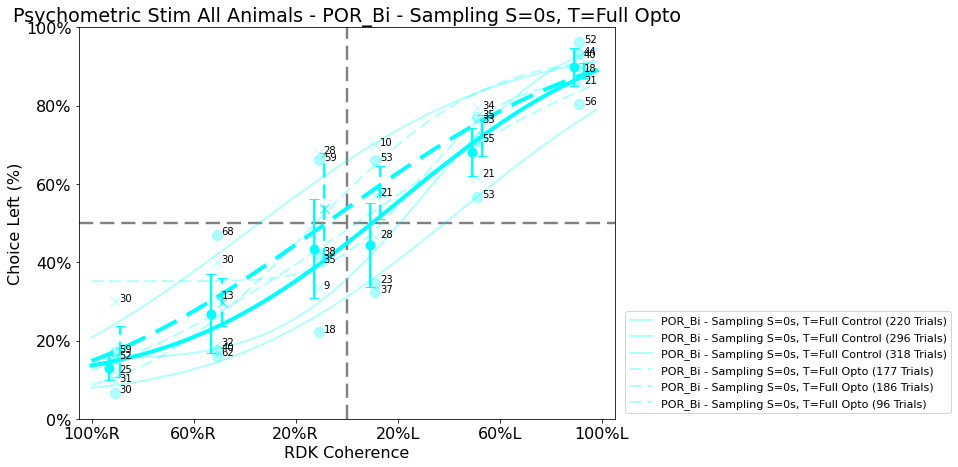

brain_region: POR_Bi - Opto config: (<MatrixState.CenterPortRewardDelivery: 11>, 0, -1)
nfits for len: 104 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.10845070187151813 - β: 0.5026266875015389 - λ1: 6.018268748964905e-08 - λ2: 0.050571375441366084
nfits for len: 233 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.24959508514563783 - β: 0.9075272300063584 - λ1: 3.410224043844111e-08 - λ2: 0.057801973420498504
nfits for len: 112 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.1958687137106785 - β: 1.0606995249127515 - λ1: 1.4613792677275327e-07 - λ2: 1.2775112605618581e-08
nfits for len: 16 = 200
α: -0.15425878917106228 - β: 0.8167483234191764 - λ1: 3.244874694468704e-08 - λ2: 0.030970733229504305
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'cyan', 'marker': None, 'markersize': 5}
nfits for len: 75 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.030988695854027064 - β: 0.6370897664006603 - λ1: 1.7473382070993348e-09 - λ2: 0.12234099526661191
nfits for len: 134 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.011933044947603617 - β: 0.13348267665504954 - λ1: 0.2548626600977578 - λ2: 0.09759933126068987
nfits for len: 108 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.2285772385440327 - β: 0.6170498048423616 - λ1: 0.19807858689112015 - λ2: 0.15996851468074058
nfits for len: 16 = 200
α: -0.04058077874635216 - β: 0.24110841514763903 - λ1: 0.16551895537054065 - λ2: 0.16277727403925765
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'cyan', 'marker': None, 'markersize': 5}


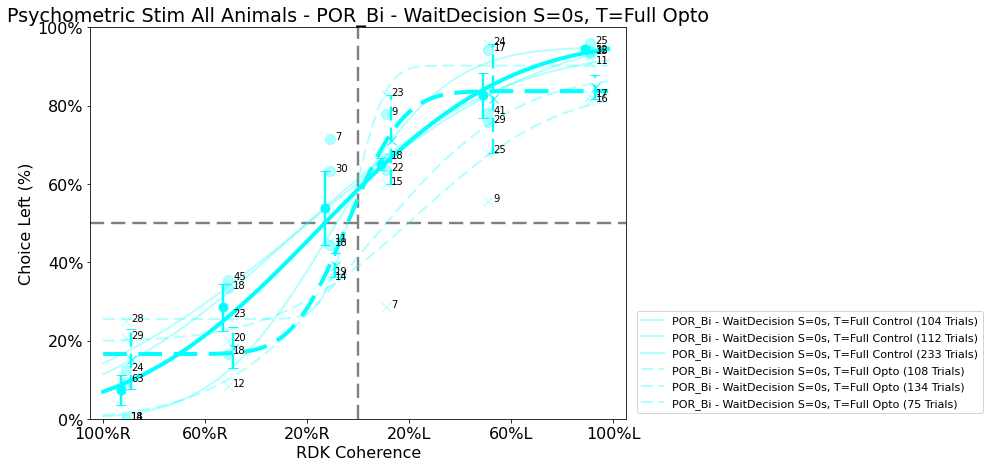

brain_region: M2_R - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.3)
No valid sessions found for M2_R - . Returning
brain_region: M2_R - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.6, 1.0)
No valid sessions found for M2_R - . Returning
brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.5)
No valid sessions found for M2_Bi - . Returning
brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.35)
nfits for len: 339 = 147


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.03161965947274137 - β: 0.41533386523981697 - λ1: 0.17310849320981941 - λ2: 0.15902515817227103
nfits for len: 689 = 72


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.24822769324474825 - β: 1.194647319088273 - λ1: 0.01930887602431617 - λ2: 6.628151206059829e-08
nfits for len: 861 = 58


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.1930904873559987 - β: 1.396225279371571 - λ1: 5.775060180109615e-06 - λ2: 5.225117693347545e-08
nfits for len: 361 = 138


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.40707987429528014 - β: 0.5514091061108319 - λ1: 0.13898609560322425 - λ2: 0.27927665675794866
nfits for len: 358 = 139


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.43455895400563005 - β: 1.0939219931383652 - λ1: 1.4761949781150581e-07 - λ2: 0.24661161613322202
nfits for len: 455 = 109


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.07450944824519629 - β: 0.6161965784830612 - λ1: 0.0911029235629274 - λ2: 0.29878794530608577
nfits for len: 574 = 87


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.14385043946971868 - β: 0.7536089625153415 - λ1: 0.11038802757958546 - λ2: 0.17145258993970902
nfits for len: 1250 = 40


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.21968682429314176 - β: 0.8851406073811283 - λ1: 0.160673402178648 - λ2: 0.1207534147017237
nfits for len: 49 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.0848991485166111 - β: 0.5427382945645989 - λ1: 0.17327811828875586 - λ2: 0.21391703301719872
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}
nfits for len: 74 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.5744987376735375 - β: 1.7697524960010593 - λ1: 8.802098162619518e-08 - λ2: 0.15673550539139428
nfits for len: 145 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.2730840641462414 - β: 0.06094318007794043 - λ1: 0.31325300850344606 - λ2: 0.23999999896038143
nfits for len: 112 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.9461484077756364 - β: 0.38661593912412956 - λ1: 0.3096898067465411 - λ2: 0.049849989247403796
nfits for len: 101 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.9565258477053394 - β: 0.04818001397087627 - λ1: 0.20881098113670818 - λ2: 0.3835728362759003
nfits for len: 56 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.21202887359648775 - β: 0.08768050280269107 - λ1: 0.5909033690144033 - λ2: 0.13333273961553482
nfits for len: 77 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.49260864050182307 - β: 1.7105423136553535 - λ1: 7.974049195777662e-07 - λ2: 4.879446862478449e-05
nfits for len: 149 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.4343299656539932 - β: 0.6264106617961576 - λ1: 0.2216964120692396 - λ2: 0.2672251388635595
nfits for len: 273 = 183


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.009375021619007003 - β: 0.03939862495011734 - λ1: 0.30926503040490283 - λ2: 0.3888885787322732
nfits for len: 37 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.48724987043818974 - β: 1.1570961398301614 - λ1: 0.3247372151261706 - λ2: 0.11375474405150421
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}


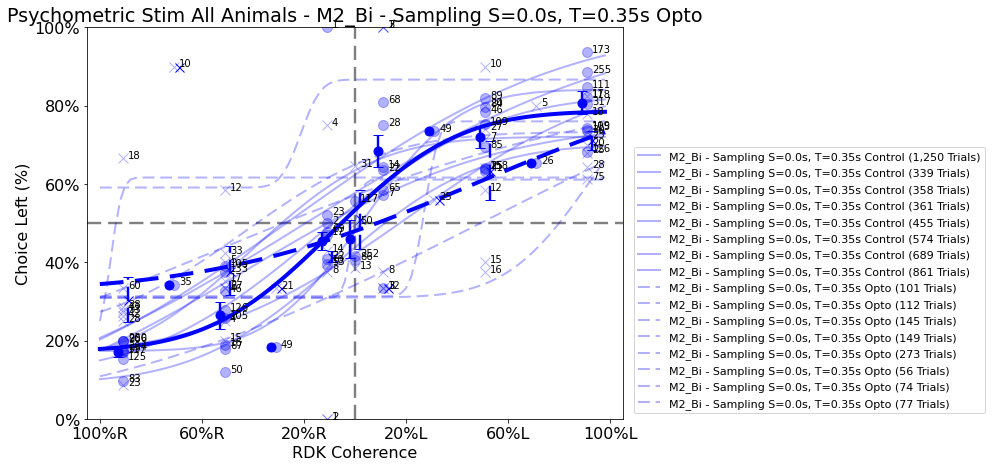

brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.3)
No valid sessions found for M2_Bi - . Returning
brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0, -1)
nfits for len: 1492 = 33


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.03152991707582507 - β: 0.8448069133082319 - λ1: 0.1469986418576021 - λ2: 0.13760314338808938
nfits for len: 277 = 180


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.60178628337534 - β: 1.6790110891668406 - λ1: 0.15669265200346338 - λ2: 2.093604323069757e-08
nfits for len: 339 = 147


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.26618490483524837 - β: 0.454574203094675 - λ1: 0.19499768579309026 - λ2: 0.251212786186106
nfits for len: 1471 = 33


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.4395642008249645 - β: 1.3159319719121865 - λ1: 0.23819302706711176 - λ2: 4.278597597172227e-08
nfits for len: 278 = 179


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.43196804226268903 - β: 1.5928130628114467 - λ1: 2.9478620537737448e-06 - λ2: 3.516373290762583e-07
nfits for len: 196 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.07126956424492967 - β: 0.7967438009100827 - λ1: 0.025159016155498204 - λ2: 0.11651184582698537
nfits for len: 342 = 146


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.08668228305477392 - β: 0.586070121931618 - λ1: 0.06440628973290605 - λ2: 0.14198569578796127
nfits for len: 797 = 62


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.07393858818558668 - β: 0.9034496043105271 - λ1: 1.3179259022803182e-07 - λ2: 0.0962166092279479
nfits for len: 47 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.11577448068708918 - β: 1.2732175499355518 - λ1: 0.04985113251817276 - λ2: 1.3856908129820452e-07
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}
nfits for len: 223 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.37857454012701275 - β: 0.03236172711053659 - λ1: 0.5071428584245219 - λ2: 0.22891566491628101
nfits for len: 18 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.19110904706658552 - β: 0.06484878870549156 - λ1: 0.9999999999896568 - λ2: 0.600000214724294
nfits for len: 45 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.8296580590437954 - β: 0.04186603999449086 - λ1: 0.33333333199763515 - λ2: 0.48484848219373267
nfits for len: 209 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.14985955296942763 - β: 0.06321114288311645 - λ1: 0.13483146012095362 - λ2: 0.6701030814520175
nfits for len: 120 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.014566479579856496 - β: 0.004349378530271633 - λ1: 0.11681757482102184 - λ2: 0.8332231439978008
nfits for len: 74 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.45207793758200643 - β: 0.0653896635365026 - λ1: 0.3333333338469962 - λ2: 0.2500000033299232
nfits for len: 106 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.4890505938282683 - β: 0.0729260665934438 - λ1: 0.6615384600413972 - λ2: 0.07999999988753552
nfits for len: 173 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.5127458738921429 - β: 0.0729469965330319 - λ1: 0.7676767656375327 - λ2: 0.18749999686726587
nfits for len: 34 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.21702837561690058 - β: 0.18874163024618718 - λ1: 0.4015474269991841 - λ2: 0.4071737262972627
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}


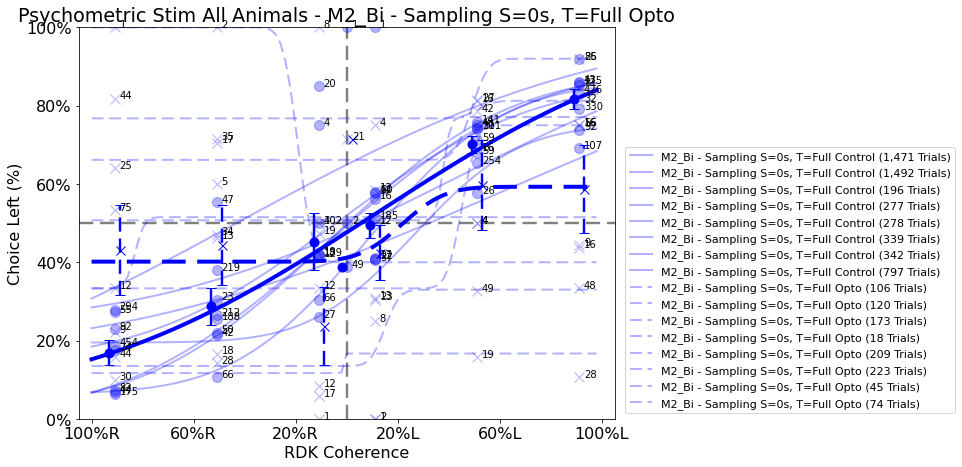

brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.3, 0.3)
nfits for len: 861 = 58


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.12313928443318056 - β: 1.1890356075470545 - λ1: 0.06642685161720442 - λ2: 1.6179040492104584e-08
nfits for len: 271 = 184


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.32002381849129047 - β: 0.96546638418697 - λ1: 1.6956030261542151e-06 - λ2: 0.09412432343228988
nfits for len: 364 = 137


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.25670428376510357 - β: 1.171660127357955 - λ1: 5.033376568771163e-07 - λ2: 0.030163814468422062
nfits for len: 18 = 200
α: -0.2133844835015647 - β: 1.0935441585401744 - λ1: 9.40099348184926e-08 - λ2: 0.024450773156513214
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}
nfits for len: 167 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.016522530232223206 - β: 1.0947097966764732 - λ1: 3.2252162150829935e-09 - λ2: 0.01904500553263727
nfits for len: 90 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.6238883337589919 - β: 0.08119676466526782 - λ1: 0.4210526304056005 - λ2: 0.20754717482500953
nfits for len: 79 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.19796930235544172 - β: 1.1236937631695922 - λ1: 1.5854077873725522e-05 - λ2: 4.581350679433668e-06
nfits for len: 14 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.22528088859751982 - β: 1.3787029341925288 - λ1: 6.645616470520416e-07 - λ2: 1.506849296615264e-06
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}


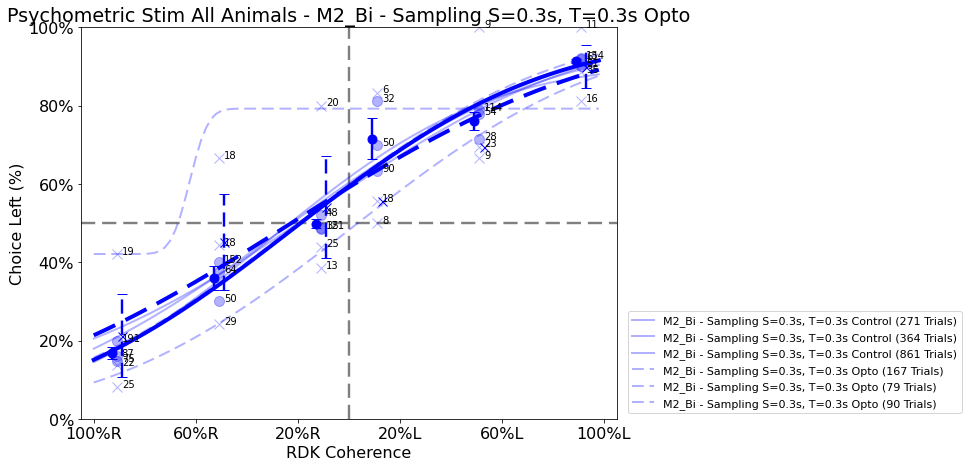

brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.35, 1.0)
nfits for len: 184 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.40431786655429813 - β: 1.1821207016942443 - λ1: 0.07625183911809581 - λ2: 0.20240545183927072
nfits for len: 53 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.07185298556875547 - β: 0.01609103744109467 - λ1: 0.39393458741308024 - λ2: 0.2999933635889207


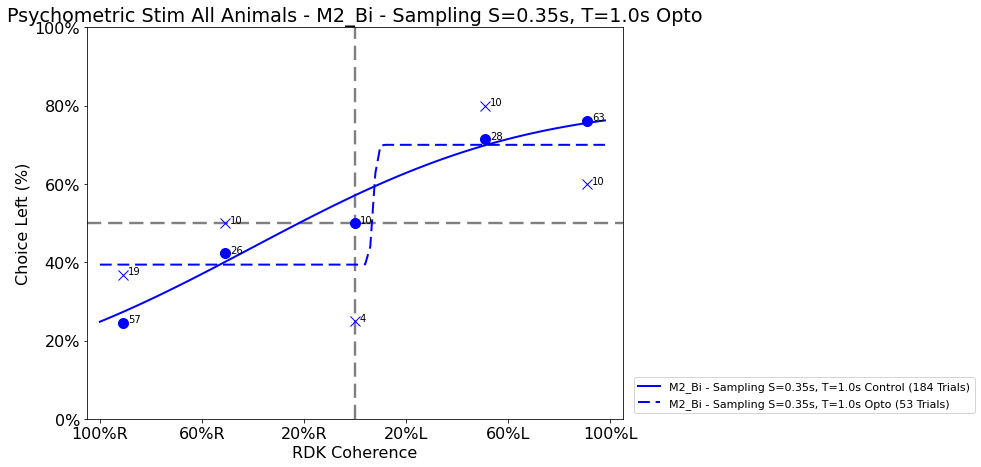

brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.35, 0.0)
No valid sessions found for M2_Bi - . Returning
brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.6, 1.0)
No valid sessions found for M2_Bi - . Returning
brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.65, 1.0)
nfits for len: 580 = 86


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.023913298767975613 - β: 0.8793368558700401 - λ1: 2.699536800827641e-07 - λ2: 0.040391640996918915
nfits for len: 313 = 159


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.5886336789888889 - β: 0.02104999954524664 - λ1: 0.24409449415254825 - λ2: 0.2051282033043973
nfits for len: 355 = 140


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.2995601092411656 - β: 1.2454996649409402 - λ1: 0.08508928647439475 - λ2: 2.8638262115793975e-08
nfits for len: 612 = 81


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.0030084606950682878 - β: 0.9255204481312778 - λ1: 0.041781832022448076 - λ2: 0.20164250122510424
nfits for len: 1365 = 36


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.09708208822344906 - β: 0.846847550256562 - λ1: 0.15706928767692868 - λ2: 0.07191186747402196
nfits for len: 1353 = 36


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.05371488010499407 - β: 0.8626678901561667 - λ1: 0.08914519320818856 - λ2: 0.19315125448967202
nfits for len: 34 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.04733968012306727 - β: 0.7682891750614385 - λ1: 0.09450978700953153 - λ2: 0.15875221314351476
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}
nfits for len: 162 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.4982039921252389 - β: 1.2052670659527882 - λ1: 1.126942270618131e-07 - λ2: 0.08670413782735431
nfits for len: 52 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.8714512656879356 - β: 0.032249379593254475 - λ1: 0.449999992603899 - λ2: 0.3749999970859925
nfits for len: 59 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.9890972944773955 - β: 7.067606248656645 - λ1: 0.2066949009561706 - λ2: 0.00036998784400477217
nfits for len: 122 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.017670042653462427 - β: 0.11104725737012283 - λ1: 0.18000004963311467 - λ2: 0.26666658668440457
nfits for len: 445 = 112


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.5410835430834613 - β: 1.868622207350604 - λ1: 0.25077936883836954 - λ2: 8.938493798836348e-09
nfits for len: 439 = 113


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.7381618780017429 - β: 1.320229933650709 - λ1: 0.37271606671532564 - λ2: 1.3763166388902328e-06
nfits for len: 26 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.05004755751353356 - β: 0.8929094829570698 - λ1: 0.33747369873816035 - λ2: 0.21357545475851775
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}


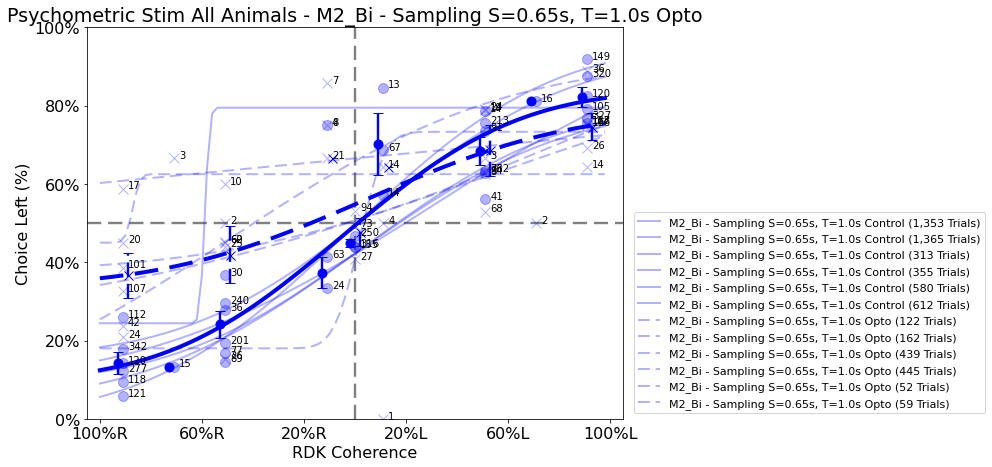

brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.85, 1.0)
nfits for len: 555 = 90


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.39473223400182733 - β: 0.17929193942113356 - λ1: 0.18160745574251075 - λ2: 0.3555119074437966
nfits for len: 92 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.9915756247999389 - β: 0.04973772572819822 - λ1: 0.3818153395769659 - λ2: 0.26040348454591894


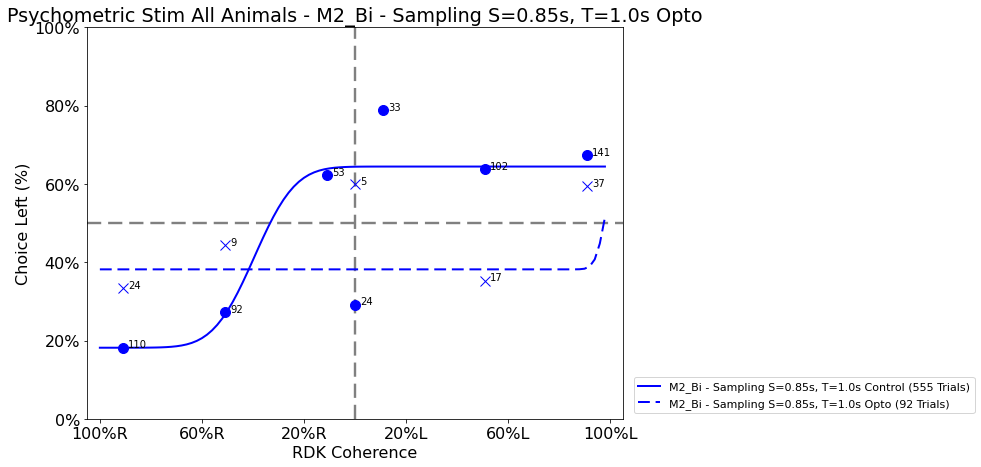

brain_region: M2_Bi - Opto config: (<MatrixState.CenterPortRewardDelivery: 11>, 0, -1)
nfits for len: 425 = 117


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.20940207049475892 - β: 1.6513807733296575 - λ1: 8.565883787967697e-09 - λ2: 0.0494570256358577
nfits for len: 1409 = 35


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.3474484747118399 - β: 1.9681129598092708 - λ1: 2.519447304829692e-09 - λ2: 0.006353774082858733
nfits for len: 377 = 132


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.08749293804022829 - β: 0.8188418444030106 - λ1: 0.09746261881213195 - λ2: 4.868764024487607e-08
nfits for len: 534 = 93


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.2996338088802394 - β: 0.7293978761295168 - λ1: 0.236137364611329 - λ2: 0.19524208298091228
nfits for len: 485 = 103


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.008114748174075329 - β: 0.8515319365432046 - λ1: 6.7338796374651745e-09 - λ2: 0.09262702034543156
nfits for len: 784 = 63


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.1703407601556874 - β: 0.9701945268925571 - λ1: 0.021590151492954467 - λ2: 1.819123206476759e-06
nfits for len: 273 = 183


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.12921882233043425 - β: 0.749415074588586 - λ1: 0.05670344545319131 - λ2: 0.1482530993136026
nfits for len: 45 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.007378145756326478 - β: 1.2321140833717577 - λ1: 0.0211652287644591 - λ2: 1.2212185955654353e-07
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}
nfits for len: 47 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.4192788531399437 - β: 0.0400127217643797 - λ1: 0.2162162159139141 - λ2: 0.5999999949344035
nfits for len: 87 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.8663033489879122 - β: 0.1868524530139566 - λ1: 0.020206548538037297 - λ2: 0.7083367814669923
nfits for len: 55 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.8530885042112892 - β: 0.40416078880675865 - λ1: 0.09945901436053617 - λ2: 0.3705536125866753
nfits for len: 120 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.048331182278071434 - β: 0.2798038351761939 - λ1: 1.5906034303259446e-06 - λ2: 0.8190789235553388
nfits for len: 169 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.9964885633515267 - β: 0.09479699852072573 - λ1: 0.20327429710423311 - λ2: 0.3165467623562388
nfits for len: 306 = 163


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.4300782436807856 - β: 0.06622772889235673 - λ1: 0.8734177395873319 - λ2: 0.07792207711550977
nfits for len: 94 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.9591523548101448 - β: 0.09925790633258236 - λ1: 0.27095490493874785 - λ2: 0.32352934375712417
nfits for len: 29 = 200
α: -0.8532601485343976 - β: 0.07650604843810821 - λ1: 0.2915012862898629 - λ2: 0.4481005894077443
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}


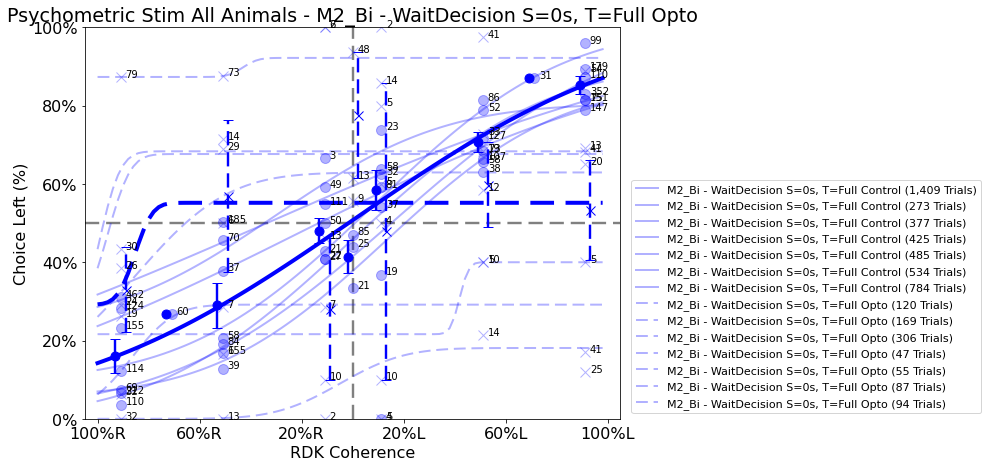

brain_region: RSP_L - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.6, 1.0)
No valid sessions found for RSP_L - . Returning
brain_region: RSP_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0, -1)
nfits for len: 669 = 74


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.6911345712539938 - β: 0.489299378678483 - λ1: 0.1950890281297942 - λ2: 0.35715424758812586
nfits for len: 886 = 56


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.09406337114271196 - β: 0.9880244980364457 - λ1: 0.11779556402996424 - λ2: 0.004615694175120756
nfits for len: 649 = 77


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.42143044795208895 - β: 0.7910205687757947 - λ1: 0.05915310734057725 - λ2: 0.2575117022729053
nfits for len: 16 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.4933981807964188 - β: 0.9747877472964935 - λ1: 2.3220003993452098e-08 - λ2: 0.22982903072211125
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'brown', 'marker': None, 'markersize': 5}
nfits for len: 159 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.16524747907324938 - β: 0.012872092944618989 - λ1: 0.5157894722623741 - λ2: 0.2656249915700794
nfits for len: 409 = 122


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.03783483455804461 - β: 0.7414613901045428 - λ1: 0.21514934712955916 - λ2: 0.0477654302148825
nfits for len: 71 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.15311653487777416 - β: 0.0283372624465022 - λ1: 0.10344827816723792 - λ2: 0.5714285732540282
nfits for len: 13 = 200
α: -0.00042915493872288063 - β: 0.09564697070109782 - λ1: 0.31022859972090333 - λ2: 0.26107936678878685
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'brown', 'marker': None, 'markersize': 5}


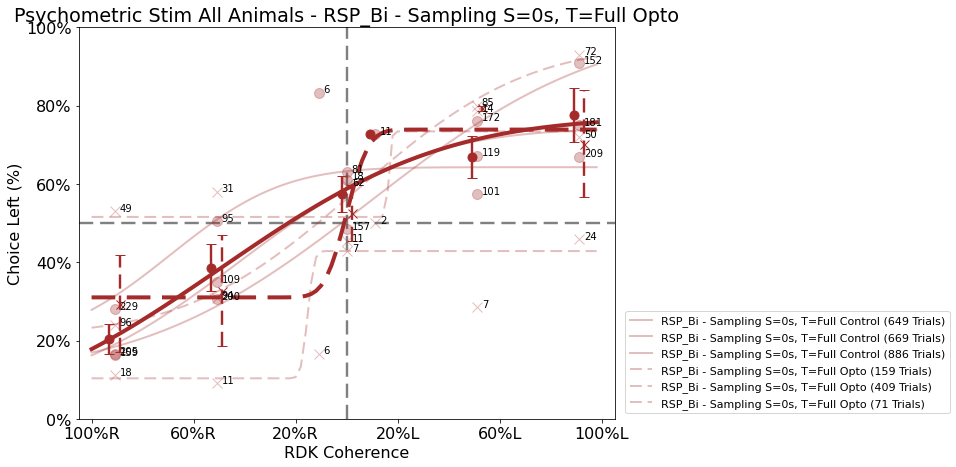

brain_region: RSP_Bi - Opto config: (<MatrixState.CenterPortRewardDelivery: 11>, 0, -1)
nfits for len: 1003 = 49


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.7395312160167279 - β: 0.9082575957502391 - λ1: 5.08988282898797e-07 - λ2: 0.24290354383547522
nfits for len: 375 = 133


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.0018781644209787396 - β: 0.615772008307932 - λ1: 0.053227988807604376 - λ2: 0.05672214192753715
nfits for len: 116 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.8311541750733424 - β: 0.6005918714236239 - λ1: 4.672775416293492e-07 - λ2: 0.15268339493435962
nfits for len: 15 = 200
α: -0.4068529046895427 - β: 1.09113305829504 - λ1: 2.3787296407638506e-07 - λ2: 0.10016946306699068
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'brown', 'marker': None, 'markersize': 5}
nfits for len: 101 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.8357405338256654 - β: 0.38735715935755627 - λ1: 0.3499965645605575 - λ2: 0.00480131737522671
nfits for len: 187 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.06541357622874576 - β: 0.48991368652918804 - λ1: 0.14918381946507323 - λ2: 0.0811271718707037
nfits for len: 45 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.2150419369210834 - β: 0.35872140672001773 - λ1: 0.2513413072348678 - λ2: 0.22419878812611496
nfits for len: 12 = 200
α: 0.17584363141174397 - β: 1.352191147349759 - λ1: 0.12421089705164699 - λ2: 8.161861001509153e-08
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'brown', 'marker': None, 'markersize': 5}


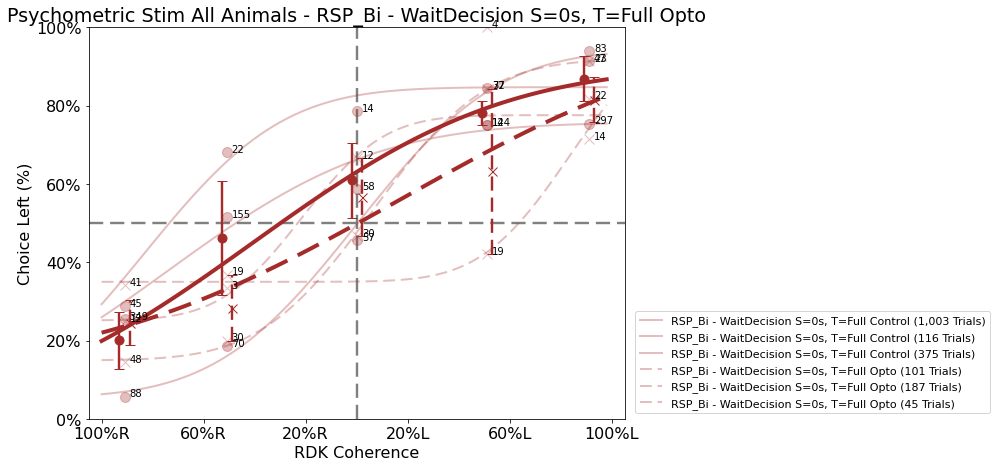

brain_region: S1_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0, -1)
nfits for len: 469 = 106


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.050819663710517396 - β: 0.20683754995763415 - λ1: 0.36390752997333153 - λ2: 0.2091243087846223
nfits for len: 57 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.3261560252152457 - β: 2.0550383669806465 - λ1: 6.290320599787623e-08 - λ2: 0.19049619923496083


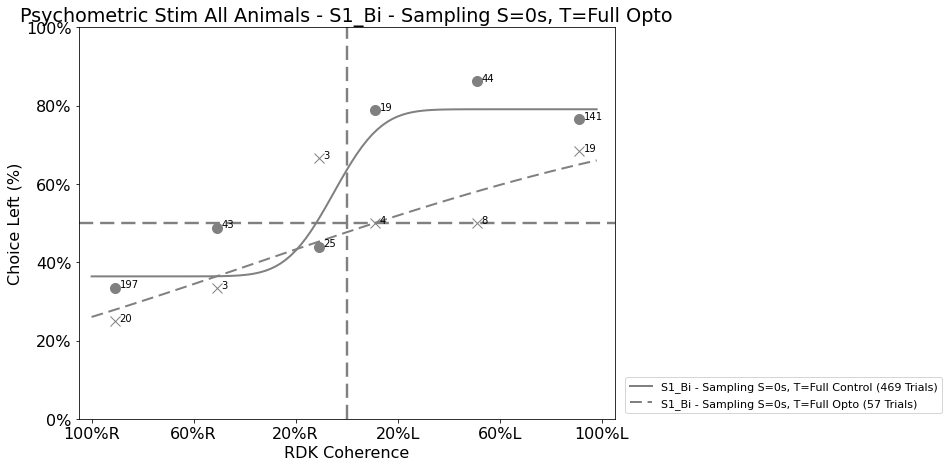

brain_region: S1_Bi - Opto config: (<MatrixState.CenterPortRewardDelivery: 11>, 0, -1)
No valid sessions found for S1_Bi - . Returning
brain_region: V1_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.3)
nfits for len: 131 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.12074685793236647 - β: 1.5532669259370406 - λ1: 5.336669990211169e-06 - λ2: 1.971208971875762e-06
nfits for len: 76 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.49979419004240266 - β: 0.20208964454702813 - λ1: 0.13774199231562445 - λ2: 0.05263119426196962
nfits for len: 168 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.48618421627150754 - β: 1.1469135499383696 - λ1: 0.09391999264055484 - λ2: 2.4510062695926813e-06
nfits for len: 10 = 200
α: 0.5371588556836137 - β: 0.5295211558908393 - λ1: 0.20489217523652997 - λ2: 6.635142779521367e-08
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'green', 'marker': None, 'markersize': 5}
nfits for len: 20 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.39422746975707096 - β: 0.043032410397522876 - λ1: 0.3076966155223088 - λ2: 0.14285006163062625
nfits for len: 45 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.5528024157566603 - β: 0.06197152670252755 - λ1: 0.17647833617471315 - λ2: 0.04760762907091114
nfits for len: 41 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.1563182323388507 - β: 0.06463660519766892 - λ1: 0.09090909125689219 - λ2: 0.11538461542857625
nfits for len: 5 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.18162795688235478 - β: 0.6926172669655157 - λ1: 0.2453397029066396 - λ2: 0.013854728088268273
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'green', 'marker': None, 'markersize': 5}


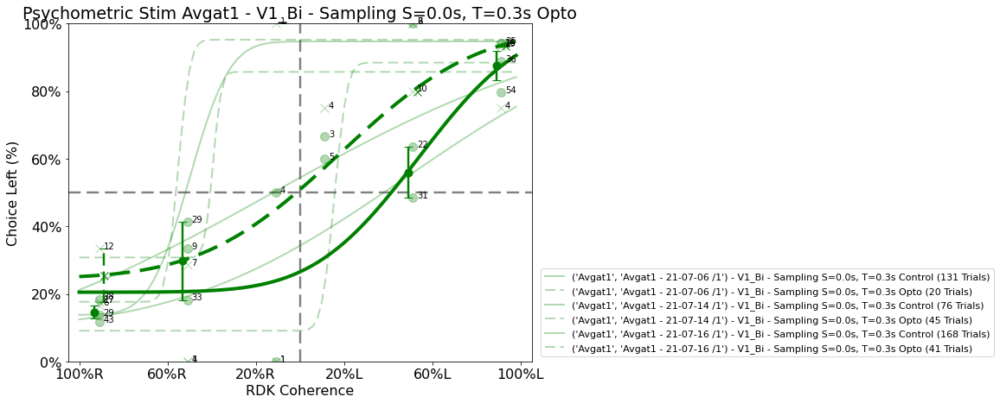

brain_region: V1_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.3, 0.3)
nfits for len: 158 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.29572356873800265 - β: 0.8241672047957089 - λ1: 2.4985790627807574e-08 - λ2: 0.09966994670991491
nfits for len: 179 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.1793123787153689 - β: 0.8858429492136468 - λ1: 0.003359091029154399 - λ2: 0.1830112631128067
nfits for len: 269 = 185


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.38893373320845387 - β: 0.8592229282678194 - λ1: 0.19786838532009765 - λ2: 3.933847723333006e-08
nfits for len: 18 = 200
α: -0.07943161976160387 - β: 1.0703129367798718 - λ1: 1.4399622335332826e-05 - λ2: 0.053023677364110094
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'green', 'marker': None, 'markersize': 5}
nfits for len: 27 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.21296916683726463 - β: 0.0723080812377106 - λ1: 0.1666701488743046 - λ2: 1.787803190811366e-09
nfits for len: 49 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.2903241362719521 - β: 1.1329447935462769 - λ1: 0.001448662002500614 - λ2: 0.00752023770714894
nfits for len: 22 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.07834433854555634 - β: 0.7267377717473351 - λ1: 8.462570887635355e-09 - λ2: 0.003808676129110451
nfits for len: 2 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.5412307574990673 - β: 0.8957363202396691 - λ1: 0.32762239630095735 - λ2: 0.01610569570768347
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'green', 'marker': None, 'markersize': 5}


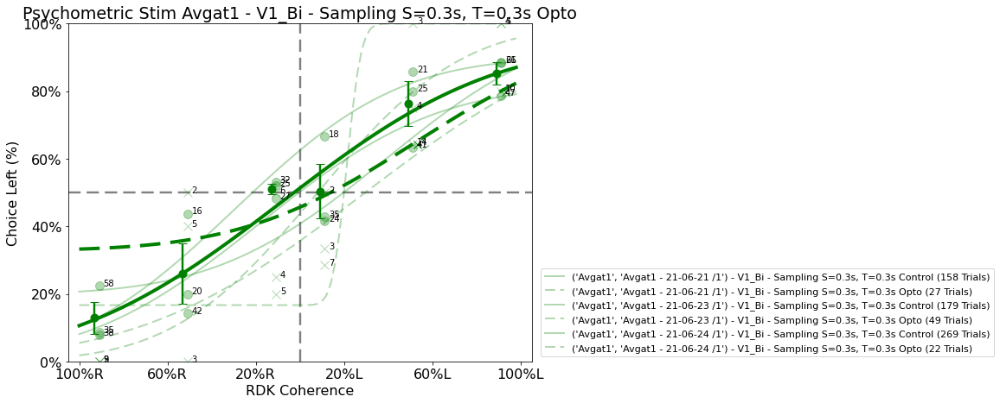

brain_region: V1_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.6, 1.0)
nfits for len: 113 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.24465457472409075 - β: 0.0069755300339993664 - λ1: 0.1111139358936424 - λ2: 0.29412298736796416
nfits for len: 154 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.062260563510187175 - β: 1.729755483945536 - λ1: 0.0006969865226592721 - λ2: 0.006194320529843726
nfits for len: 212 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.40685911011842946 - β: 0.9609201001539905 - λ1: 6.854696360581719e-08 - λ2: 0.14037606409369774
nfits for len: 12 = 200
α: -0.1365587921806976 - β: 1.1782156343627672 - λ1: 0.0005071681231722146 - λ2: 0.10383242069269182
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'green', 'marker': None, 'markersize': 5}
nfits for len: 40 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.4710752793919433 - β: 0.23083166674904634 - λ1: 2.064562948641209e-07 - λ2: 0.21339699186704483
nfits for len: 32 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.4815667964093102 - β: 0.6738739044818859 - λ1: 8.67575773288352e-08 - λ2: 0.022770417877446304
nfits for len: 33 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.5331445583702948 - β: 0.16739235844941827 - λ1: 0.17760916362161122 - λ2: 1.159418003045932e-09
nfits for len: 3 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.39772743493302576 - β: 0.4712854747808384 - λ1: 0.1853362532980169 - λ2: 0.08329980791909739
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'green', 'marker': None, 'markersize': 5}


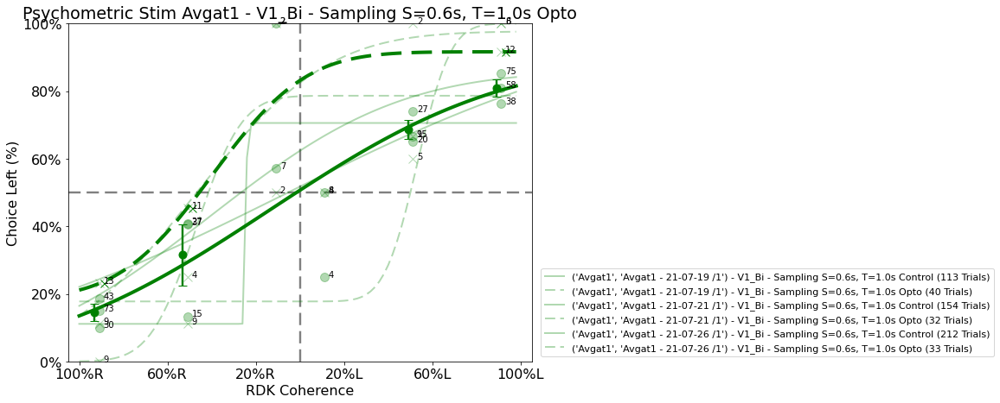

brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.35)
nfits for len: 123 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.10156884326378529 - β: 1.394963407293044 - λ1: 2.0912433454688217e-07 - λ2: 2.0531526558956857e-07
nfits for len: 32 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.21389671371545835 - β: 1.0854378825036899 - λ1: 4.9507131865569357e-08 - λ2: 0.020263093928437437


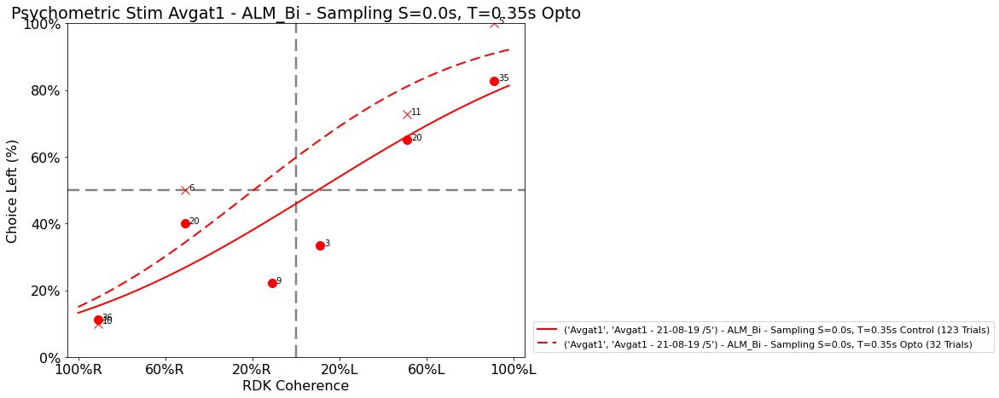

brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.3)
No valid sessions found for ALM_Bi - . Returning
brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.3, 0.3)
nfits for len: 152 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.48931245834001763 - β: 1.2284074571974617 - λ1: 1.0480924262472325e-08 - λ2: 0.12371259792506661
nfits for len: 131 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.2406905106969955 - β: 0.5896492594865375 - λ1: 0.2266431978371403 - λ2: 0.02334043451810768
nfits for len: 12 = 200
α: 0.088426273712 - β: 0.99843325238495 - λ1: 0.16698196202591087 - λ2: 1.4356999496753226e-07
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}
nfits for len: 35 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.9999999991892499 - β: 1.0773176264546285 - λ1: 0.08546685077221906 - λ2: 0.3108304448037104
nfits for len: 39 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.6043108904200221 - β: 0.19088032886097508 - λ1: 0.24939048305853007 - λ2: 0.0011667451330370498


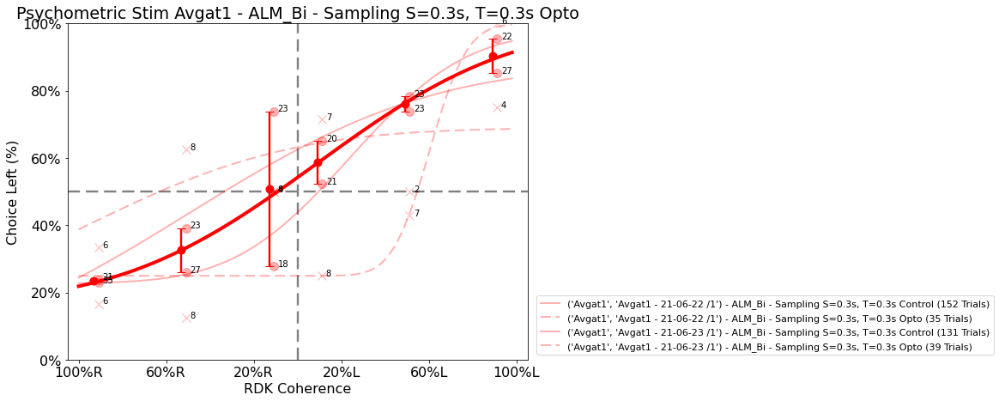

brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.6, 1.0)
nfits for len: 225 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.46660942162885866 - β: 0.7325512463148012 - λ1: 0.08310111334849292 - λ2: 1.0424313292610746e-08
nfits for len: 40 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.3993231808494354 - β: 0.6795908120664842 - λ1: 0.1051804795357836 - λ2: 1.1409036343529974e-07


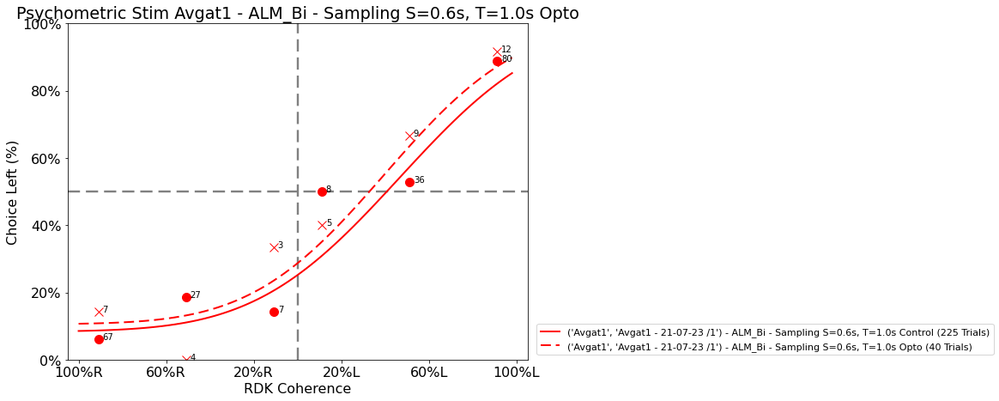

brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.65, 1.0)
nfits for len: 250 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.13362965860328746 - β: 0.7086691977960758 - λ1: 0.053712349764533 - λ2: 0.2582647493711282
nfits for len: 258 = 193


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.13418940343869493 - β: 2.2669426791447314 - λ1: 0.040929292540429776 - λ2: 0.0008486410418070742
nfits for len: 58 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.4978977670655545 - β: 0.0038057746441173845 - λ1: 0.4250160506344747 - λ2: 3.7001683399063418e-09
nfits for len: 13 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.5676928187789576 - β: 0.7242062838670724 - λ1: 0.3022613920025261 - λ2: 2.044570949753719e-07
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}
nfits for len: 58 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.030121454089653575 - β: 0.5276189352547566 - λ1: 0.24634031864088318 - λ2: 0.10153282973687613
nfits for len: 59 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.2044151300978449 - β: 0.05377465683271197 - λ1: 0.30000000285742345 - λ2: 0.2592592582301547
nfits for len: 8 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.4327811450402275 - β: 0.22491523131735963 - λ1: 0.000578126298590477 - λ2: 3.4987591776064535e-07
nfits for len: 6 = 200
α: -0.18457161236051042 - β: 0.12502285034524557 - λ1: 0.28039215553901653 - λ2: 0.17630719094728337
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}


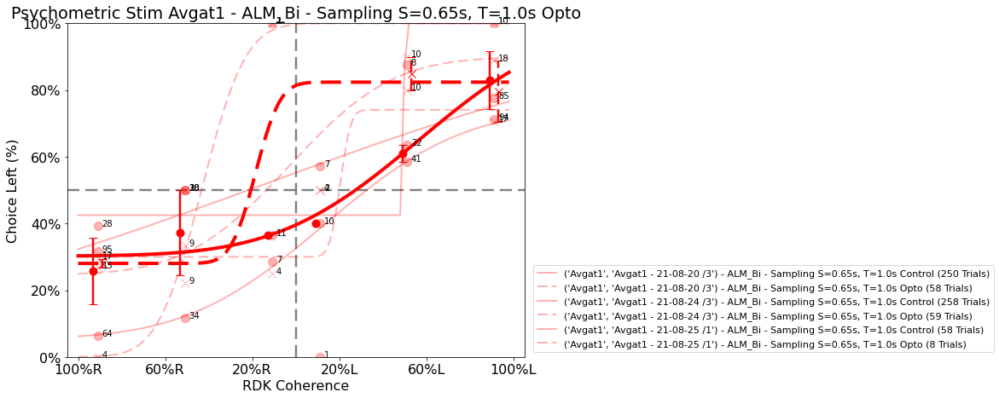

brain_region: PPC_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.35)
No valid sessions found for PPC_Bi - . Returning
brain_region: PPC_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.3)
nfits for len: 251 = 199


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.27948015855771247 - β: 0.9986344156231262 - λ1: 0.0515830480021892 - λ2: 5.306858821261879e-07
nfits for len: 200 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.18785751179791976 - β: 1.1715899305159752 - λ1: 6.719197515369309e-05 - λ2: 1.166190992495122e-07
nfits for len: 11 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.04945444736102195 - β: 1.0681276970266858 - λ1: 2.6086714600324154e-08 - λ2: 0.008824178153880077
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}
nfits for len: 50 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.2969235754484002 - β: 0.19220216879568852 - λ1: 0.24992625764422616 - λ2: 0.11741356174195121
nfits for len: 42 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.6396168992808443 - β: 0.1568191601109441 - λ1: 0.32438378966269904 - λ2: 2.1229373900681765e-09
nfits for len: 4 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.10004741266746048 - β: 0.5694017005800679 - λ1: 0.25750665359126856 - λ2: 0.054655440094609486
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}


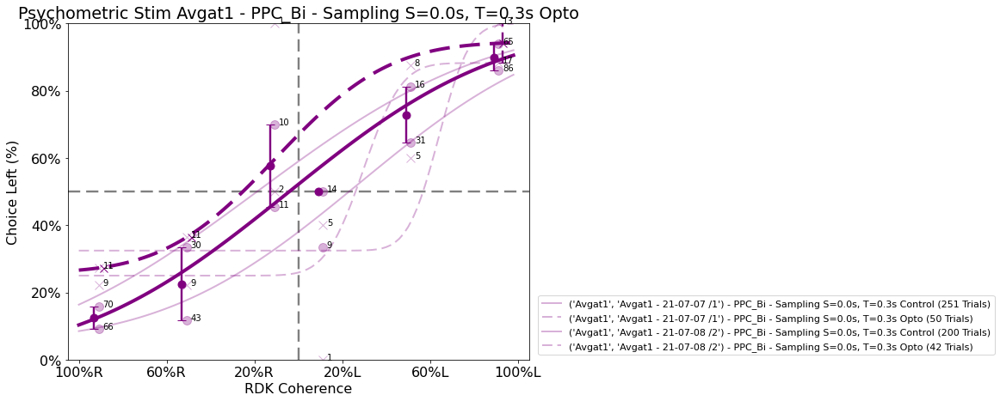

brain_region: PPC_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.3, 0.3)
nfits for len: 135 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.3129934078398963 - β: 1.094081010462078 - λ1: 2.0256251178941907e-07 - λ2: 0.06641802789015319
nfits for len: 27 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.30500173739215874 - β: 0.020343736835054207 - λ1: 0.0909103731529918 - λ2: 0.43750449863382834


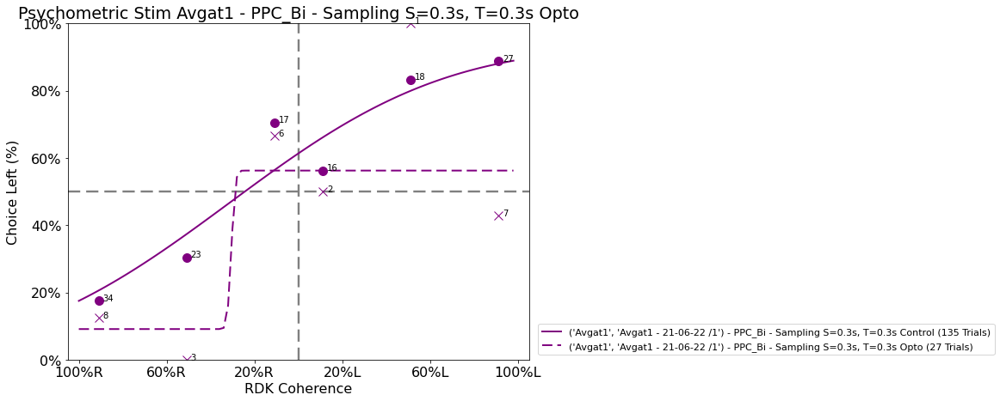

brain_region: PPC_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.6, 1.0)
nfits for len: 171 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.4193069248770125 - β: 1.224147582090841 - λ1: 0.15442111670168515 - λ2: 3.5946586315399763e-07
nfits for len: 223 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.29596236556192046 - β: 0.3519126350365409 - λ1: 0.12838861789832834 - λ2: 0.1700847956859215
nfits for len: 10 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.30171062546219934 - β: 0.34038962002053785 - λ1: 0.20000311489512757 - λ2: 0.18450970027990338
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}
nfits for len: 42 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.5920623469496022 - β: 0.5422597331616759 - λ1: 0.3366078123170041 - λ2: 0.07182576230246188
nfits for len: 52 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.20768442328998413 - β: 0.7862280284660625 - λ1: 2.1362595617886994e-08 - λ2: 0.031642527732909084
nfits for len: 5 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.2107693605244712 - β: 0.7186182297819077 - λ1: 2.0742104607103293e-06 - λ2: 0.04836523342552984
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}


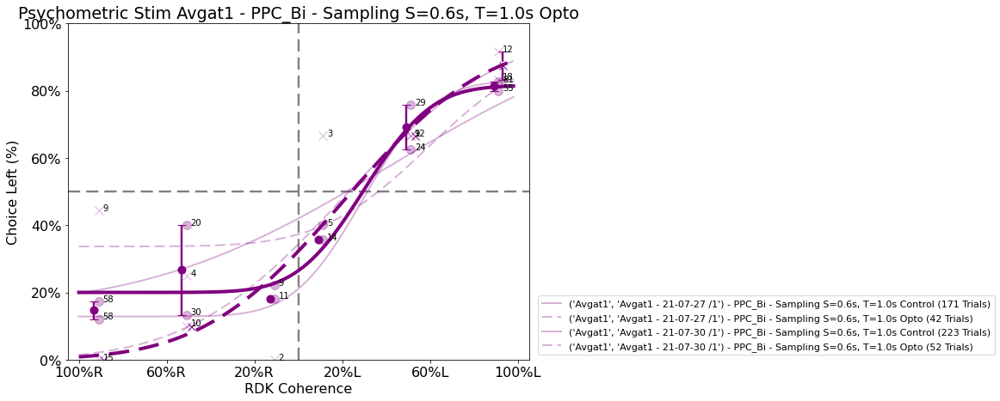

brain_region: PPC_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.65, 1.0)
nfits for len: 236 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.3528049441243072 - β: 1.0791961314756393 - λ1: 0.2215084338761475 - λ2: 0.054683621095176785
nfits for len: 73 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.020509371884623213 - β: 1.0686611889342692 - λ1: 0.33115996580764395 - λ2: 0.3250405872719353


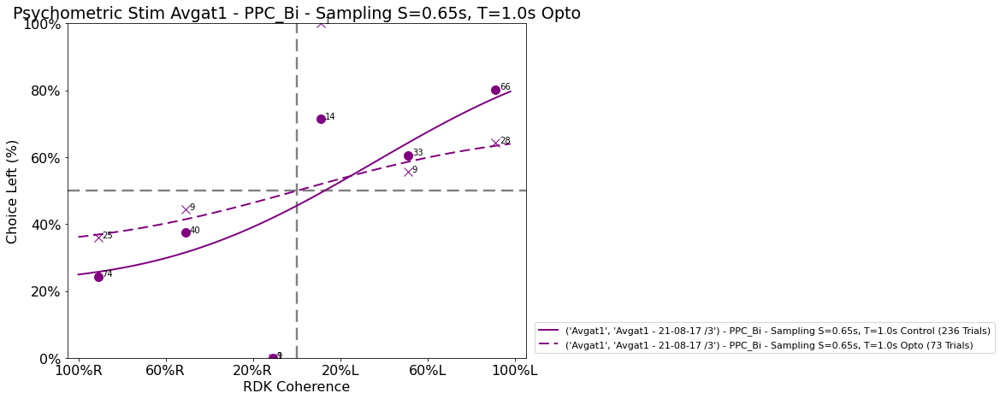

brain_region: M2_R - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.3)
No valid sessions found for M2_R - . Returning
brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.35)
nfits for len: 249 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.05790493362769493 - β: 0.3413398753862355 - λ1: 0.19178866378165763 - λ2: 0.1788035605022782
nfits for len: 69 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.8278095213112144 - β: 0.9504074938589065 - λ1: 0.07648824072566715 - λ2: 0.283702371735401


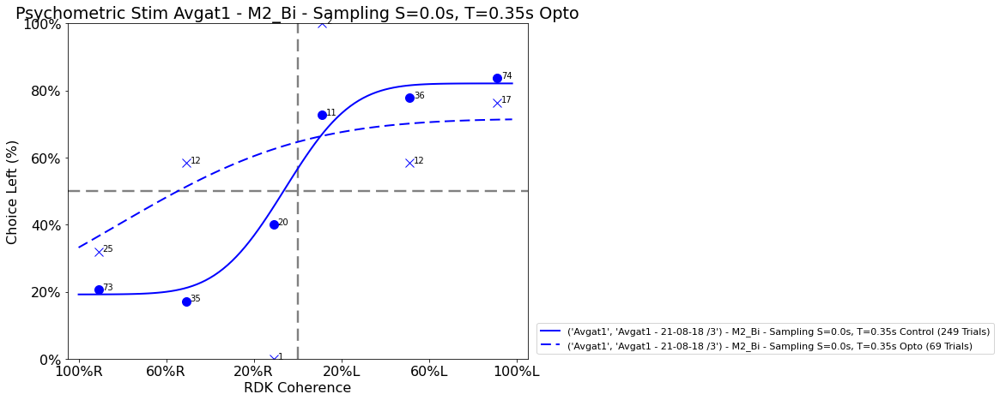

brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.3)
No valid sessions found for M2_Bi - . Returning
brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.3, 0.3)
nfits for len: 127 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.004995348889762876 - β: 0.65025992891979 - λ1: 0.15332311692248748 - λ2: 0.14293223963438412
nfits for len: 308 = 162


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.027711864088867305 - β: 0.8574942692975742 - λ1: 0.15179768157573792 - λ2: 1.9268295898014045e-06
nfits for len: 185 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.4856955314181295 - β: 1.2942169552181975 - λ1: 1.3021701389100235e-07 - λ2: 0.032963907000780925
nfits for len: 18 = 200
α: -0.04951821127726748 - β: 0.992133250851014 - λ1: 0.11120949741192242 - λ2: 0.014805984955254606
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}
nfits for len: 52 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.37781403255804163 - β: 0.6693245603055963 - λ1: 0.25156800022612325 - λ2: 0.0011520882115727622
nfits for len: 64 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.06999288690732225 - β: 0.9491444899815333 - λ1: 6.598158868607453e-11 - λ2: 0.007173019785518011
nfits for len: 42 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.4383118597330037 - β: 0.22470018532097724 - λ1: 4.861596925963287e-09 - λ2: 0.2742546013847992
nfits for len: 6 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.07621804093641008 - β: 0.8525815648585362 - λ1: 3.0118290551069576e-08 - λ2: 2.979158027947836e-07
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}


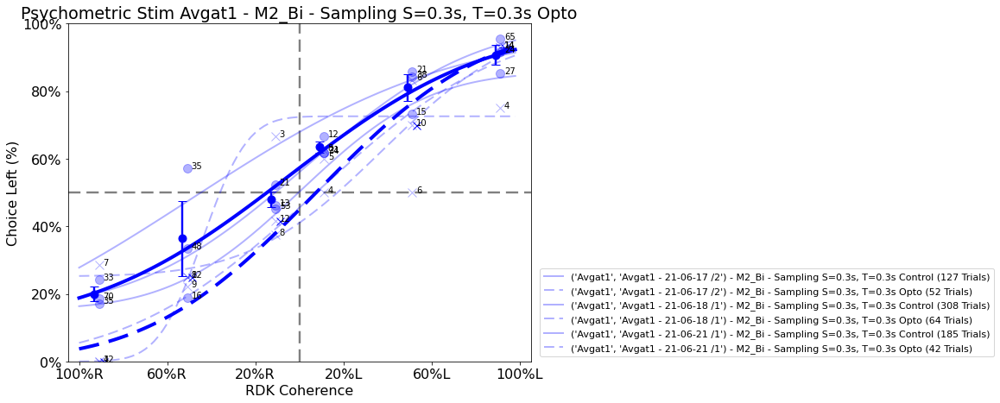

brain_region: V1_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0, -1)
No valid sessions found for V1_Bi - . Returning
brain_region: V1_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.3, 0.3)
nfits for len: 162 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.5334030756090047 - β: 0.17264165183171643 - λ1: 0.13631999144694235 - λ2: 0.23611267997140556
nfits for len: 38 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.4668654580390813 - β: 0.034379487228454145 - λ1: 0.24999999644758475 - λ2: 0.36363636352384643


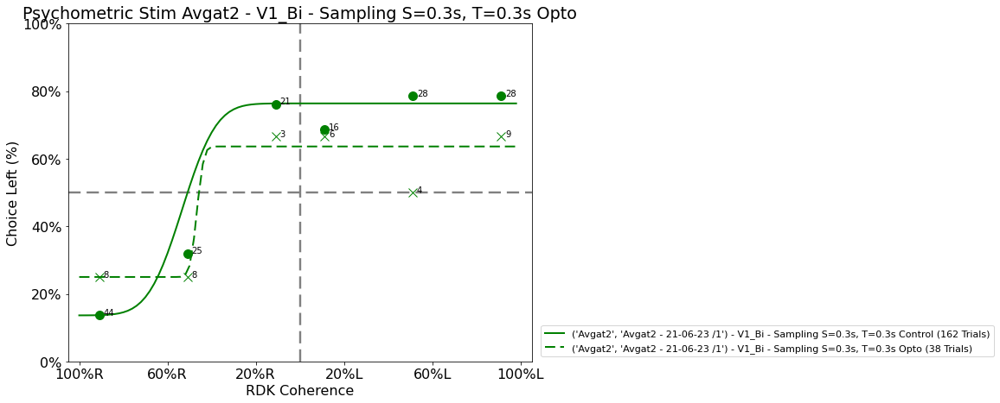

brain_region: V1_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.6, 1.0)
No valid sessions found for V1_Bi - . Returning
brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.3)
nfits for len: 202 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.15565769435801757 - β: 1.7367985291700987 - λ1: 0.01701461409650823 - λ2: 0.000503593980321286
nfits for len: 53 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.5825407314612439 - β: 0.16199877084000208 - λ1: 0.17254024293440345 - λ2: 0.11812643862259808


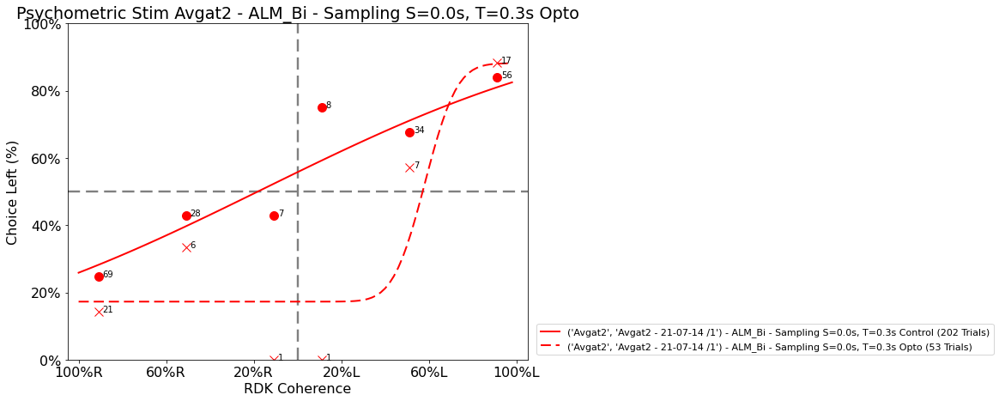

brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.3, 0.3)
nfits for len: 156 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.1965400692040586 - β: 0.5442911459391154 - λ1: 0.2423289148693002 - λ2: 0.3078710902054028
nfits for len: 41 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.7694287062718292 - β: 0.03654655592305095 - λ1: 0.5357143951254707 - λ2: 1.9432437944488554e-14


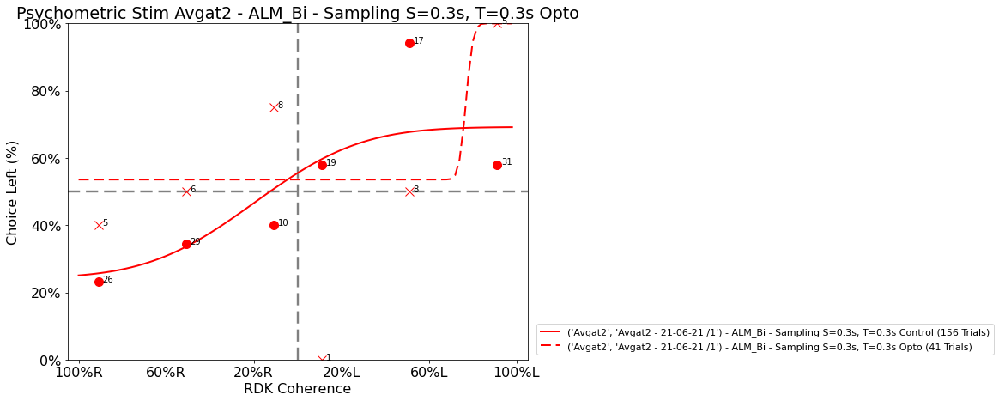

brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.6, 1.0)
No valid sessions found for ALM_Bi - . Returning
brain_region: PPC_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.3)
No valid sessions found for PPC_Bi - . Returning
brain_region: PPC_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.3, 0.3)
nfits for len: 139 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.3495944817393864 - β: 0.7044669933304767 - λ1: 9.910406372161919e-08 - λ2: 0.2530375876207335
nfits for len: 152 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.30081610007657 - β: 1.2174111657188396 - λ1: 4.736314511783567e-08 - λ2: 0.004356700927754209
nfits for len: 12 = 200
α: -0.2905346839430603 - β: 0.772356838740031 - λ1: 0.020224727792767988 - λ2: 0.15076227353557936
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}
nfits for len: 26 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.08125837480786903 - β: 0.023660685490225007 - λ1: 0.49999855001434146 - λ2: 2.4287660004479216e-12
nfits for len: 26 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.39204399202921236 - β: 0.037504728600018813 - λ1: 0.25000000093033636 - λ2: 0.2857142848676143


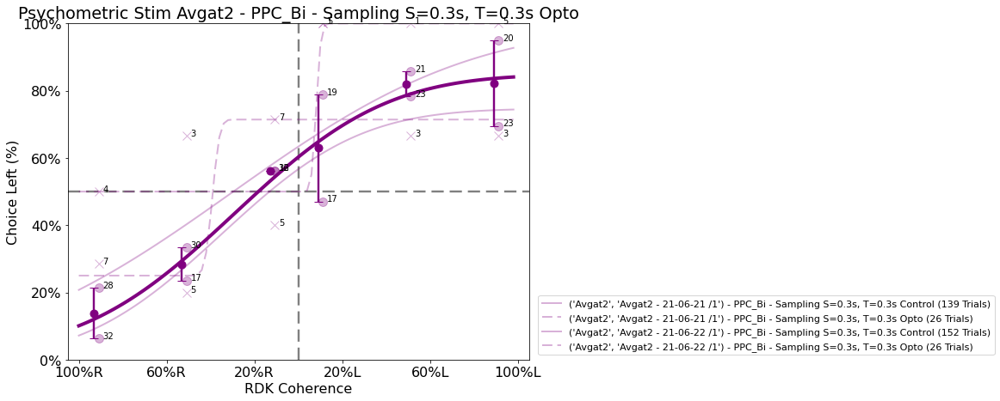

brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.3)
nfits for len: 147 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.5265502419999679 - β: 0.2576460026178913 - λ1: 0.08620705851536165 - λ2: 0.35972732326181367
nfits for len: 24 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.21272409363244937 - β: 1.8360589312756712 - λ1: 7.1157584473271735e-06 - λ2: 1.4437575314690587e-06


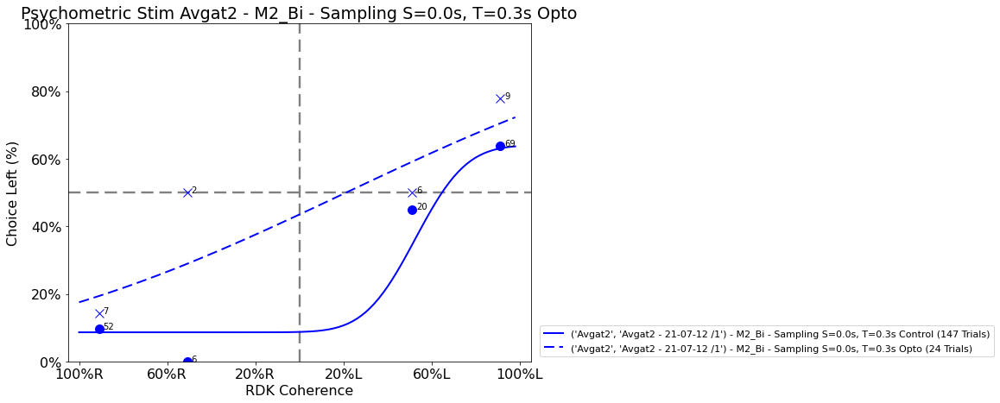

brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.3, 0.3)
nfits for len: 150 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.13346568218252358 - β: 1.1548861796304979 - λ1: 0.00016060333370243552 - λ2: 0.00019167906948934743
nfits for len: 121 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.38100466323707993 - β: 0.6692929419691536 - λ1: 0.0770150346704164 - λ2: 0.16291322847850437
nfits for len: 12 = 200
α: -0.2533962965117546 - β: 0.6368782649444831 - λ1: 0.09053185333392232 - λ2: 0.15135785365421967
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}
nfits for len: 26 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.3563603222068671 - β: 0.02912215739267758 - λ1: 0.5882352926657306 - λ2: 0.222222220666269
nfits for len: 64 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.6069673852096407 - β: 0.0779972952977658 - λ1: 0.4117647135761304 - λ2: 0.1250000047817038
nfits for len: 3 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.521582670708833 - β: 0.39397939530255016 - λ1: 0.3639251638889433 - λ2: 0.050007895035844394
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}


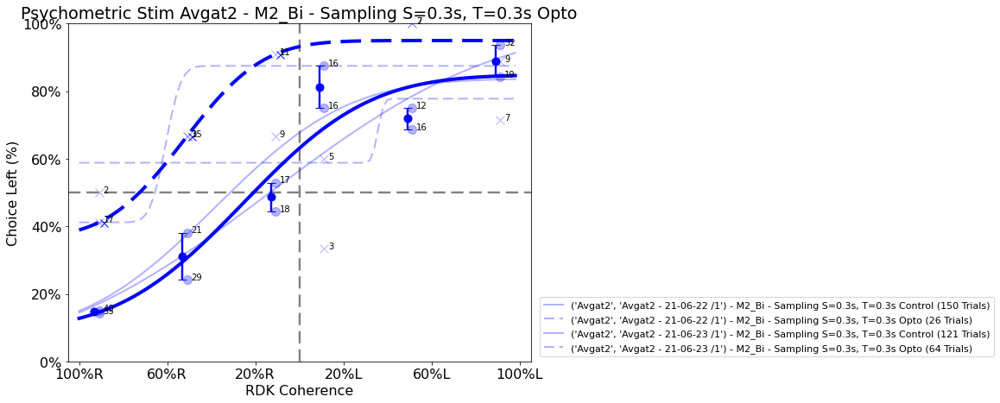

brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.6, 1.0)
No valid sessions found for M2_Bi - . Returning
brain_region: V1_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.3)
No valid sessions found for V1_Bi - . Returning
brain_region: V1_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.3, 0.3)
No valid sessions found for V1_Bi - . Returning
brain_region: PPC_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.3, 0.3)
nfits for len: 176 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.023912905381096312 - β: 1.2290194071239893 - λ1: 3.5588388961110733e-07 - λ2: 1.1439500195296387e-06
nfits for len: 43 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.21473807325758631 - β: 0.054339225594700724 - λ1: 0.41666668046216504 - λ2: 0.12500000009913054


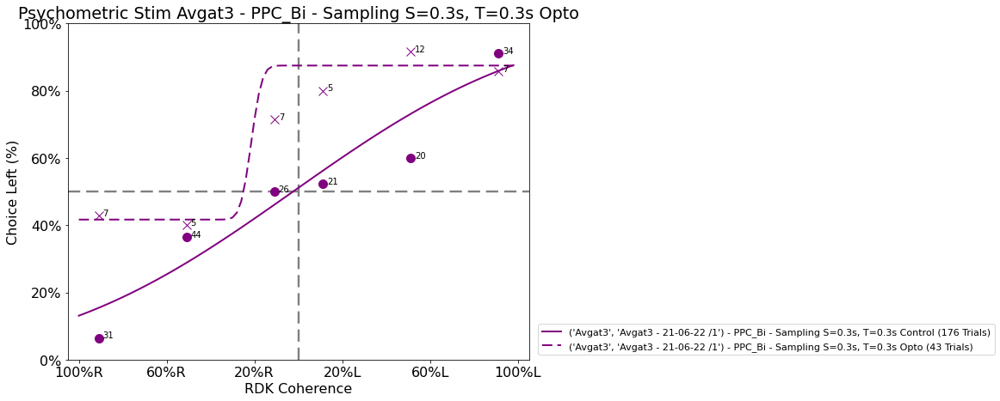

brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.5)
No valid sessions found for M2_Bi - . Returning
brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.3)
No valid sessions found for M2_Bi - . Returning
brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.3, 0.3)
nfits for len: 207 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.38261191037938036 - β: 0.9551761630876425 - λ1: 3.17106330190867e-08 - λ2: 0.13709785058688648
nfits for len: 120 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.024890632876607133 - β: 0.7064228554336351 - λ1: 0.24698655651525583 - λ2: 2.5178960475088237e-09
nfits for len: 12 = 200
α: -0.21461090408878927 - β: 1.1303180238150112 - λ1: 0.006552422905710187 - λ2: 7.857221707282127e-08
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}
nfits for len: 41 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.04167261698253495 - β: 1.2163299362030622 - λ1: 0.00024292401768338773 - λ2: 1.776697831460167e-05
nfits for len: 38 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.004581940790322529 - β: 0.06299225082121217 - λ1: 0.3571137767146548 - λ2: 6.506251078587501e-10
nfits for len: 2 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.5037228622484322 - β: 0.1808220660922596 - λ1: 0.07633752754275416 - λ2: 0.13642900990513282
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}


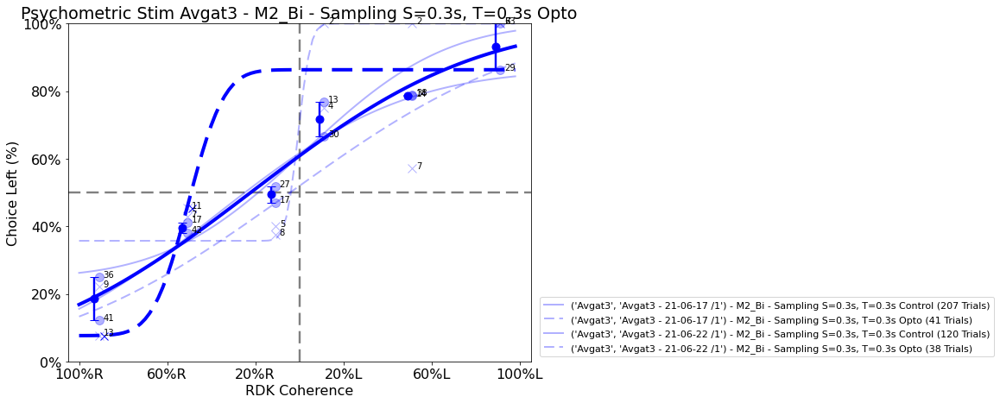

brain_region: V1_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.3)
nfits for len: 197 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.05155359599483654 - β: 1.095969927951372 - λ1: 0.0001950477447636259 - λ2: 0.06114353269972801
nfits for len: 146 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.4192287724371542 - β: 0.21573438643522547 - λ1: 0.05996128122288623 - λ2: 0.38888890424537126
nfits for len: 8 = 200
α: -0.18791167760584665 - β: 0.6592614348415518 - λ1: 0.01830440843448334 - λ2: 0.27409903306808536
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'green', 'marker': None, 'markersize': 5}
nfits for len: 50 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.5545998397335443 - β: 0.06519017083884401 - λ1: 0.07999999982731668 - λ2: 0.33333333138308596
nfits for len: 43 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.4890700635697356 - β: 0.4280568627930271 - λ1: 5.928059715673788e-11 - λ2: 0.27819592489612405
nfits for len: 6 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.5728973666556334 - β: 1.0920755297849678 - λ1: 0.01266166678963107 - λ2: 6.860790351998502e-07
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'green', 'marker': None, 'markersize': 5}


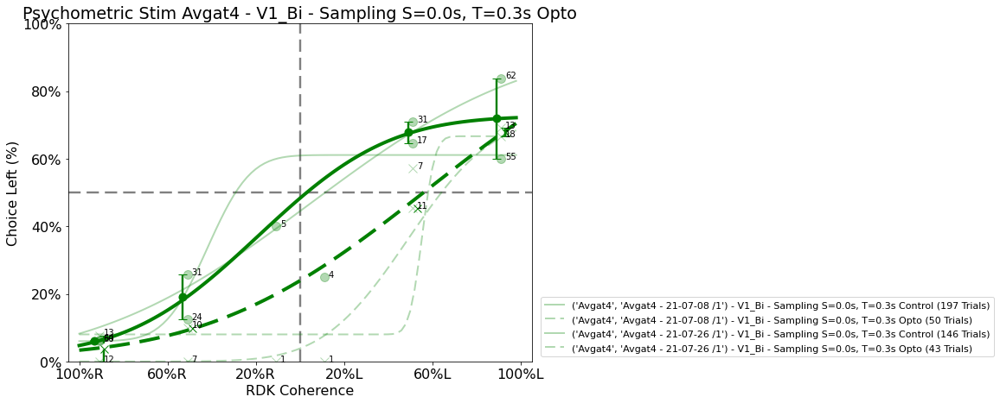

brain_region: V1_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0, -1)
No valid sessions found for V1_Bi - . Returning
brain_region: V1_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.3, 0.3)
nfits for len: 214 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.13096481455102443 - β: 0.6015521055675432 - λ1: 6.645088978267195e-06 - λ2: 0.251442445747887
nfits for len: 61 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.6157656551384647 - β: 0.5727941002266463 - λ1: 0.12895048009303103 - λ2: 4.5548651075749956e-08


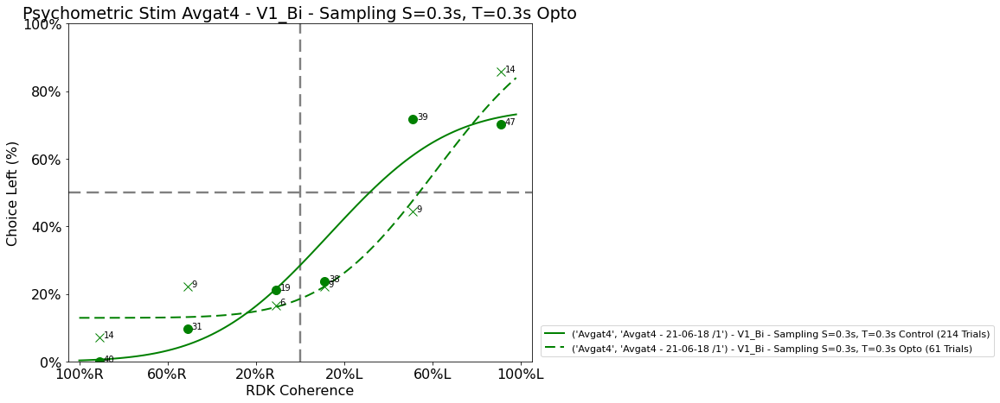

brain_region: V1_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.6, 1.0)
nfits for len: 181 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.20870107256703613 - β: 0.722603008063986 - λ1: 0.07729277308021706 - λ2: 0.23813251090329657
nfits for len: 139 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.26012492578425683 - β: 0.725247924125862 - λ1: 3.953749442062074e-08 - λ2: 0.23171596731528188
nfits for len: 11 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.17646396844447865 - β: 0.6959792820579436 - λ1: 0.034935972243003245 - λ2: 0.22124385996596774
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'green', 'marker': None, 'markersize': 5}
nfits for len: 60 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.5997892609678457 - β: 6.648301614413217e-05 - λ1: 0.10399473475184065 - λ2: 0.4643459431992757
nfits for len: 30 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.23268076987339814 - β: 0.031799593535802244 - λ1: 0.07694887022049694 - λ2: 0.4666341599031695
nfits for len: 3 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.11178743469186567 - β: 0.07206261864925462 - λ1: 0.050000001027339085 - λ2: 0.4583333324860227
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'green', 'marker': None, 'markersize': 5}


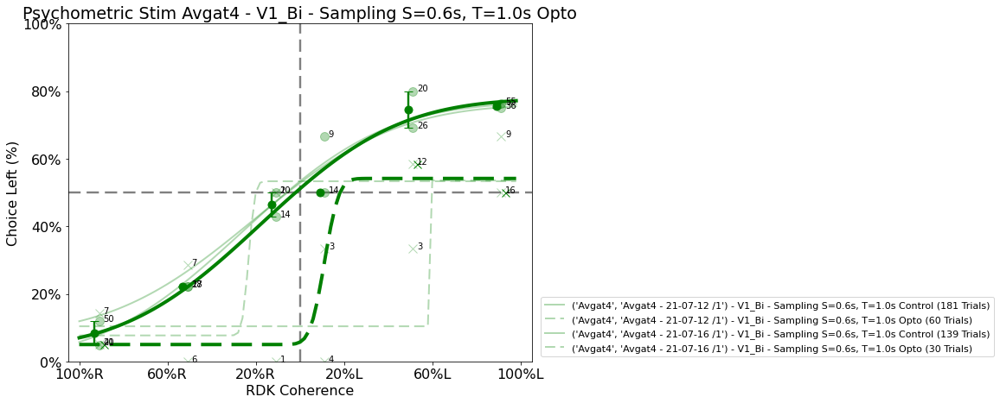

brain_region: ALM_R - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.3, 0.3)
No valid sessions found for ALM_R - . Returning
brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.3)
nfits for len: 173 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.20696256181117112 - β: 1.045723836651347 - λ1: 5.895494439759598e-07 - λ2: 0.05390827980301614
nfits for len: 38 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.10363913384736523 - β: 0.637067208065859 - λ1: 6.82264607448602e-09 - λ2: 0.22029553558278264


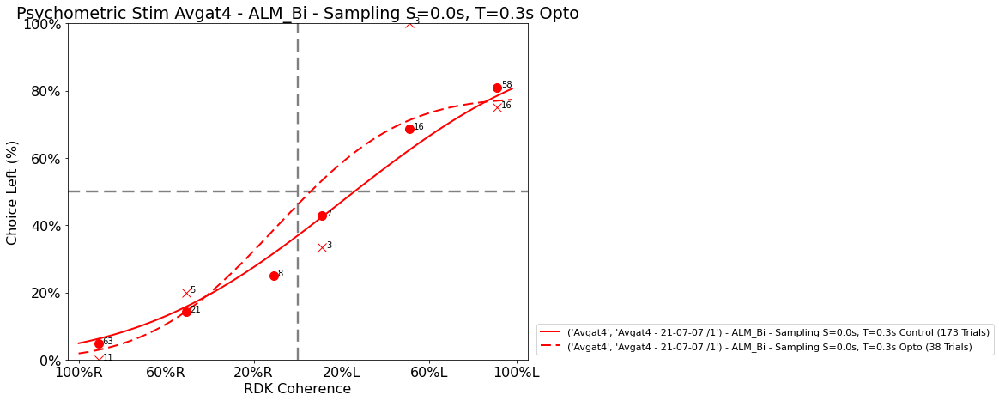

brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0, -1)
No valid sessions found for ALM_Bi - . Returning
brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.3, 0.3)
nfits for len: 106 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.3248491681496074 - β: 0.41544404604461127 - λ1: 1.4068530870518873e-06 - λ2: 0.08650036940853562
nfits for len: 138 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.03522112074151595 - β: 0.46791708930851006 - λ1: 6.409001791986518e-09 - λ2: 0.19981607069858923
nfits for len: 107 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.13576225798034125 - β: 0.7663339259957577 - λ1: 0.00042387919661881156 - λ2: 1.2159707376647646e-08
nfits for len: 17 = 200
α: 0.15643258460305964 - β: 0.7531207007708296 - λ1: 3.5891382828383104e-08 - λ2: 0.01791231688885673
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}
nfits for len: 23 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.10002126367995454 - β: 1.2607769028335509e-06 - λ1: 0.22345897035482018 - λ2: 0.14174417597468897
nfits for len: 26 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.6262803826863874 - β: 0.24519918455083983 - λ1: 0.17634115424201363 - λ2: 0.156483257174528
nfits for len: 28 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.06708202860469993 - β: 0.06045436813708117 - λ1: 2.389655097744966e-09 - λ2: 0.22991202947430744


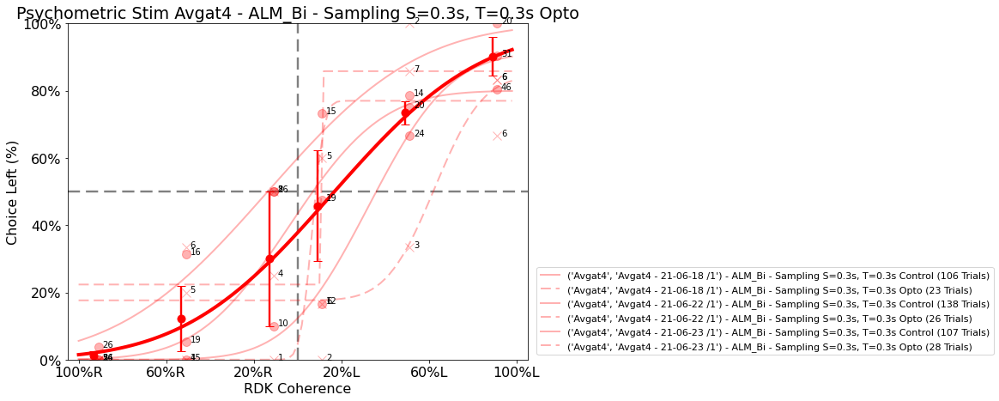

brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.6, 1.0)
nfits for len: 234 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.15582632862054685 - β: 0.9876441052140361 - λ1: 0.019148283926656306 - λ2: 0.14904935309909542
nfits for len: 126 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.19359081175762238 - β: 1.1358366220809326 - λ1: 4.9934115305980475e-05 - λ2: 6.411235740874505e-08
nfits for len: 62 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.07342880674169659 - β: 1.5049732893720174 - λ1: 3.3454052486394986e-07 - λ2: 0.26565684883246166
nfits for len: 13 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.2656037728994828 - β: 1.3211026902398846 - λ1: 7.282747600391278e-07 - λ2: 5.261679617024993e-06
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}
nfits for len: 71 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.3529893669307105 - β: 0.1134361363457087 - λ1: 0.20799354828693029 - λ2: 0.1607728749720333
nfits for len: 20 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.1319140497546647 - β: 0.08563976703142565 - λ1: 0.25000000461647054 - λ2: 0.11111111427970112
nfits for len: 24 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.6020299988720739 - β: 0.35409201476794894 - λ1: 0.1624350617833885 - λ2: 0.16658176055290352
nfits for len: 4 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.31756916918473094 - β: 0.03307055405697809 - λ1: 0.1576923088439646 - λ2: 0.14166666828074564
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}


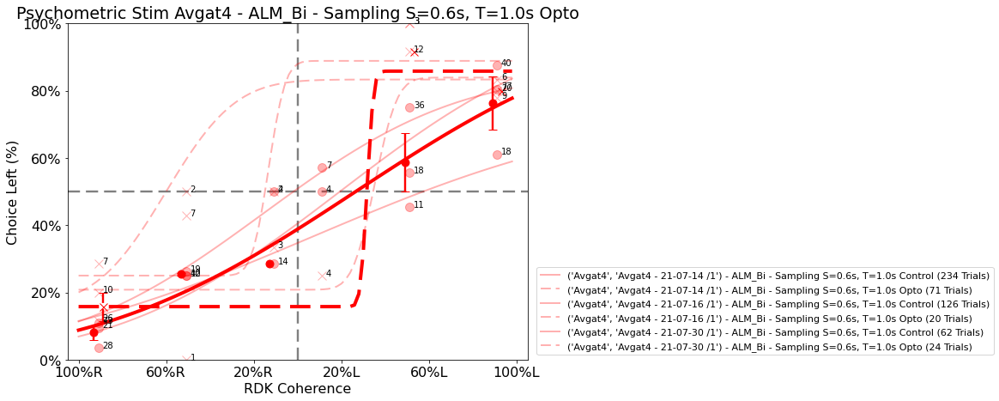

brain_region: PPC_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.3)
nfits for len: 176 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.5203393156393349 - β: 0.14439336739598113 - λ1: 0.1871354790506497 - λ2: 0.2954367762796434
nfits for len: 98 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.07069782572573965 - β: 1.4805320813689882 - λ1: 8.011097225245702e-07 - λ2: 0.08200219578075876
nfits for len: 116 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.5274921105077217 - β: 0.05944510435571708 - λ1: 0.12068965325258649 - λ2: 0.2682926818464656
nfits for len: 11 = 200
α: -0.21321941576651604 - β: 0.6616301407066407 - λ1: 0.08392263090684185 - λ2: 0.2643880569397159
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}
nfits for len: 46 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.8804464876829844 - β: 0.4520380355833803 - λ1: 0.3000007976182747 - λ2: 0.023544201154486542
nfits for len: 28 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.5703057624326333 - β: 0.06889491455092335 - λ1: 0.13333332973014525 - λ2: 0.36363636855334813
nfits for len: 37 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.5313282727783606 - β: 0.004360446485448118 - λ1: 0.15789516462000747 - λ2: 0.49999971843218366
nfits for len: 4 = 200
α: -0.14460229475824282 - β: 0.13560894935218004 - λ1: 0.20833322623454126 - λ2: 0.3133971452218158
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}


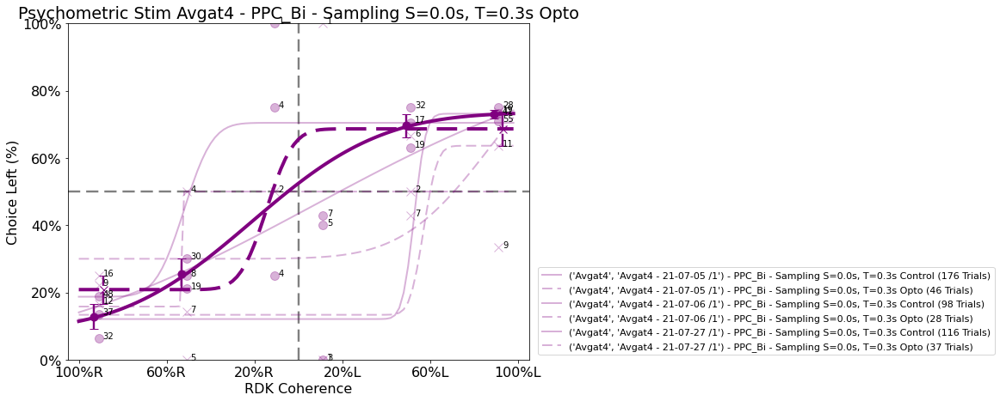

brain_region: PPC_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.3, 0.3)
nfits for len: 220 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.47631464847546906 - β: 0.8571316952828001 - λ1: 0.021485406398212642 - λ2: 0.0035745435281097564
nfits for len: 86 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.20006697873193557 - β: 0.22340047662948423 - λ1: 0.05898691921528411 - λ2: 0.30246073165747733
nfits for len: 176 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.03689903846252991 - β: 0.8987624541968271 - λ1: 5.551520417051051e-07 - λ2: 0.05493261689771338
nfits for len: 18 = 200
α: 0.05243208357497925 - β: 0.8492630166366855 - λ1: 2.3413660581444052e-07 - λ2: 0.12601690190230375
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}
nfits for len: 62 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.2665315857692909 - β: 0.790706101197413 - λ1: 0.10497282331473547 - λ2: 0.10210730570551318
nfits for len: 21 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.4709642639051374 - β: 0.08408592767391512 - λ1: 2.245453137385381e-08 - λ2: 0.507723347116397
nfits for len: 44 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.4666928104654721 - β: 0.29863487767405417 - λ1: 0.24861053140312556 - λ2: 2.2374247104389666e-09
nfits for len: 5 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.4750898529510761 - β: 0.7529272184338656 - λ1: 0.15227263915310466 - λ2: 3.2996647528139097e-07
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}


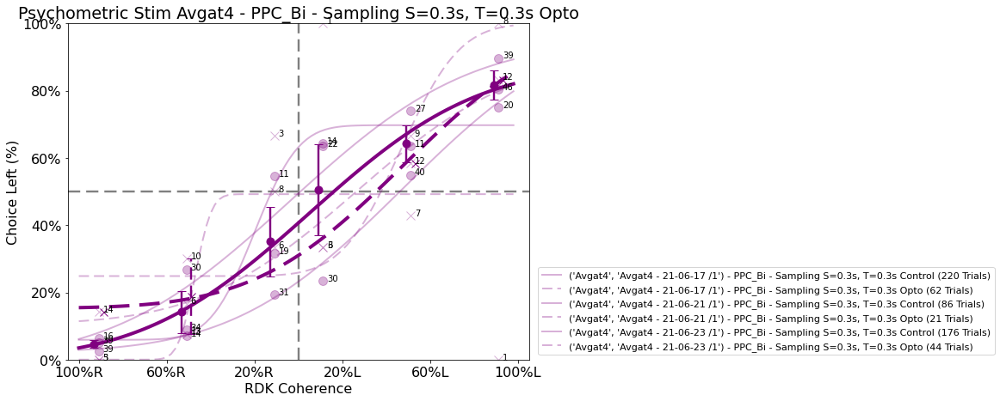

brain_region: PPC_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.6, 1.0)
nfits for len: 202 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.7813674549011882 - β: 1.32392657809247 - λ1: 5.645834611507936e-07 - λ2: 6.437609047059631e-07
nfits for len: 85 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.17529909950699896 - β: 0.06452205457313948 - λ1: 0.138877526972797 - λ2: 0.19997669745975047
nfits for len: 219 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.5423860247464762 - β: 0.06346844157572804 - λ1: 0.08108108272012676 - λ2: 0.22077922342979373
nfits for len: 13 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.5202239954487287 - β: 0.8510499247354395 - λ1: 0.07643514384208261 - λ2: 6.846082433169063e-09
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}
nfits for len: 41 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.4720142292658391 - β: 0.02319979931471081 - λ1: 0.09523809719780121 - λ2: 0.35000000175029505
nfits for len: 36 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.11534812773429051 - β: 0.1053088859237514 - λ1: 0.24945416465530246 - λ2: 0.09524136273582115
nfits for len: 48 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.09353434728469633 - β: 1.3338224521642057 - λ1: 3.748131830585e-08 - λ2: 0.03651460293133215
nfits for len: 6 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.16177750202198676 - β: 0.8208499317955241 - λ1: 0.048429591275040054 - λ2: 0.20814266128348674
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}


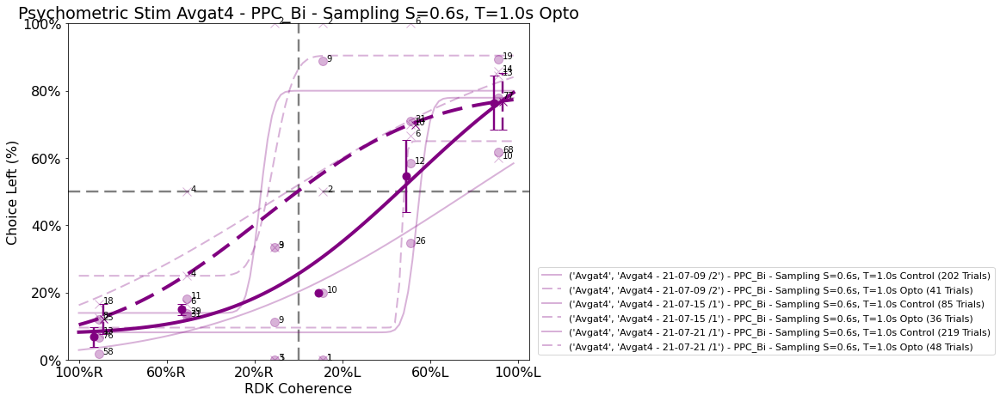

brain_region: M2_R - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.6, 1.0)
nfits for len: 121 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.3747773518969751 - β: 0.6298804181995216 - λ1: 0.20164162218264095 - λ2: 0.09430513989459405
nfits for len: 20 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.4873601447927496 - β: 0.24399251283167717 - λ1: 0.18181817272841577 - λ2: 0.16569978377487354


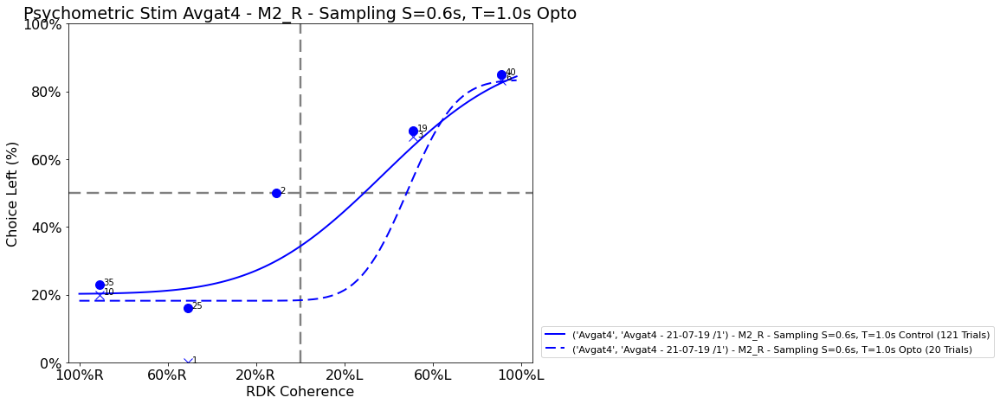

brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.3, 0.3)
No valid sessions found for M2_Bi - . Returning
brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.6, 1.0)
nfits for len: 145 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.17169926705875765 - β: 0.13788759328277383 - λ1: 0.18516885979745878 - λ2: 0.21131748605447934
nfits for len: 31 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.5999801600653587 - β: 9.016273280407536e-05 - λ1: 0.11065059285126394 - λ2: 0.29989882437267346


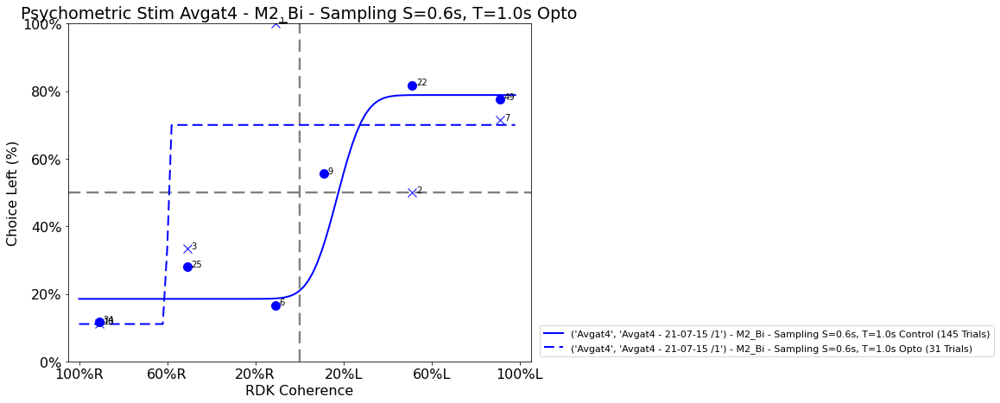

brain_region: RSP_L - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.6, 1.0)
No valid sessions found for RSP_L - . Returning
brain_region: V1_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0, -1)
nfits for len: 182 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.25052477754235114 - β: 0.6051417108208967 - λ1: 0.10926048748727787 - λ2: 4.181201612585468e-05
nfits for len: 29 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.25734422852870864 - β: 0.7214201585726345 - λ1: 0.0005482823966500622 - λ2: 3.85361221054711e-09


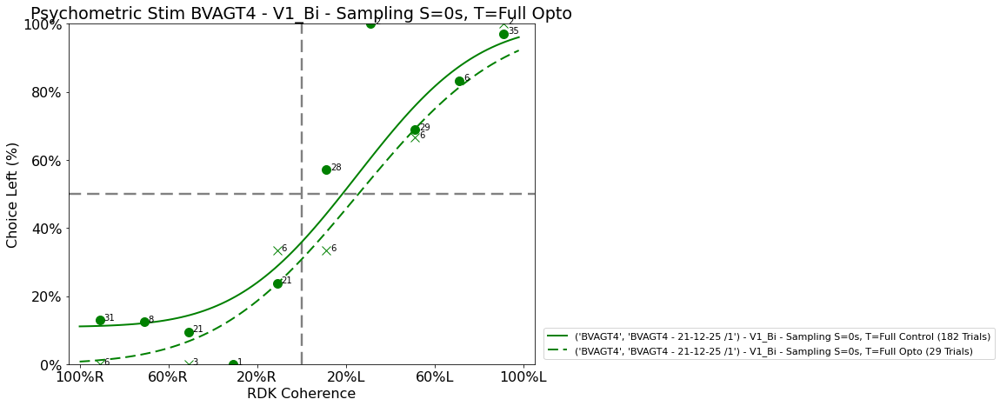

brain_region: ALM_R - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.65, 1.0)
No valid sessions found for ALM_R - . Returning
brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.35)
nfits for len: 188 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.06737195993172357 - β: 0.650090184283373 - λ1: 0.17997652367543296 - λ2: 0.05124433849973304
nfits for len: 57 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.310442718222842 - β: 0.03352271772702936 - λ1: 0.002744027454747156 - λ2: 0.9256227153518246


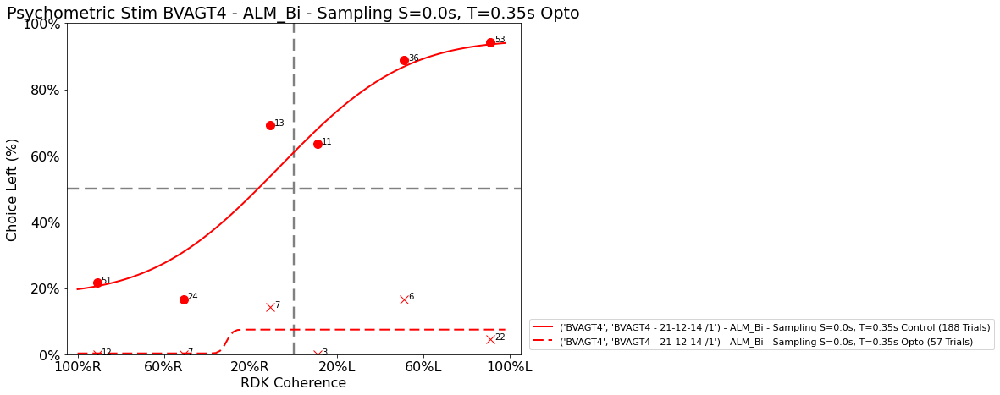

brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0, -1)
nfits for len: 285 = 175


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.08867373783848115 - β: 0.7916778013283733 - λ1: 0.19775781909487372 - λ2: 0.09929365054521955
nfits for len: 154 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.46484131532825046 - β: 0.06832279186624055 - λ1: 0.26085131794419797 - λ2: 0.2499964332726683
nfits for len: 281 = 177


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.16144027806089645 - β: 0.8810154031788893 - λ1: 0.19933330512670006 - λ2: 1.385255159621237e-07
nfits for len: 161 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.19112861882159368 - β: 0.0684423835702671 - λ1: 0.24095850206830244 - λ2: 0.15277964491981438
nfits for len: 287 = 174


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.009248383494518462 - β: 0.7877818946324462 - λ1: 0.13443095521968607 - λ2: 0.17614889866045041
nfits for len: 28 = 200
α: -0.043348023823819415 - β: 0.9762253593039953 - λ1: 0.13572083049371697 - λ2: 0.07432342676097528
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}
nfits for len: 27 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.7710564444824466 - β: 0.5199259654350494 - λ1: 0.6060230790672858 - λ2: 0.08438447919927385
nfits for len: 4 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.5085724524355041 - β: 0.20188017771016736 - λ1: 0.9999993811070206 - λ2: 0.997988545483673
nfits for len: 37 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.581997644384386 - β: 0.002924915928331262 - λ1: 0.7333302643609245 - λ2: 0.18181754001660932
nfits for len: 32 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.9478471489120852 - β: 0.10221609505035212 - λ1: 0.8260868935448893 - λ2: 0.5276793314521389
nfits for len: 38 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.9993841987431535 - β: 0.005164799839669016 - λ1: 0.029565703314655543 - λ2: 0.6538456584026204
nfits for len: 4 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.3239330893360376 - β: 4.1316816301597115 - λ1: 0.9702573921401862 - λ2: 0.9895182511323046
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}


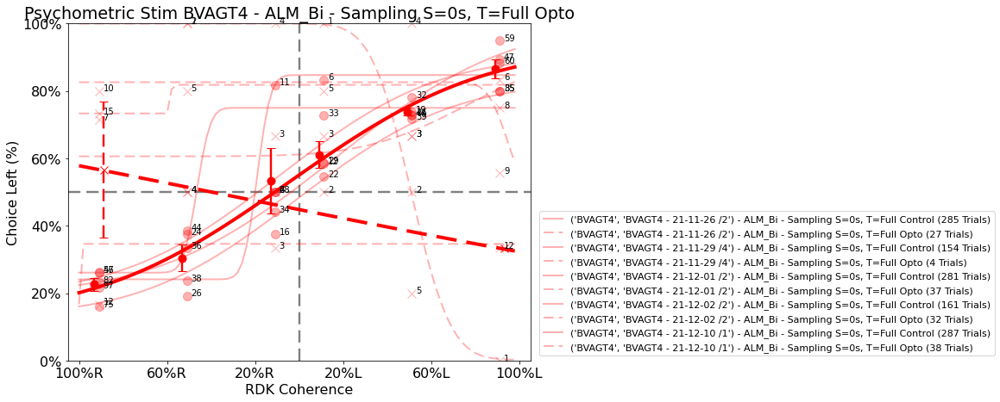

brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.65, 1.0)
nfits for len: 312 = 160


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.02234465225485765 - β: 0.734195962086043 - λ1: 0.08063903491808022 - λ2: 0.2416679815649128
nfits for len: 109 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.004438211448989593 - β: 0.45320665314480035 - λ1: 5.188972340660967e-09 - λ2: 0.17821037527952902
nfits for len: 11 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.01055565838212016 - β: 0.4907759983089196 - λ1: 0.043572488995410844 - λ2: 0.21485340824725313
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}
nfits for len: 51 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.6336676836178915 - β: 0.14641250381588106 - λ1: 0.08337367416797631 - λ2: 0.41200603184035656
nfits for len: 26 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.3659626957908084 - β: 0.3141331276039936 - λ1: 0.31241761145202357 - λ2: 8.718529509139809e-08
nfits for len: 2 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.14137837746272436 - β: 0.5720012471450788 - λ1: 0.06997536786751068 - λ2: 0.46449276278432033
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}


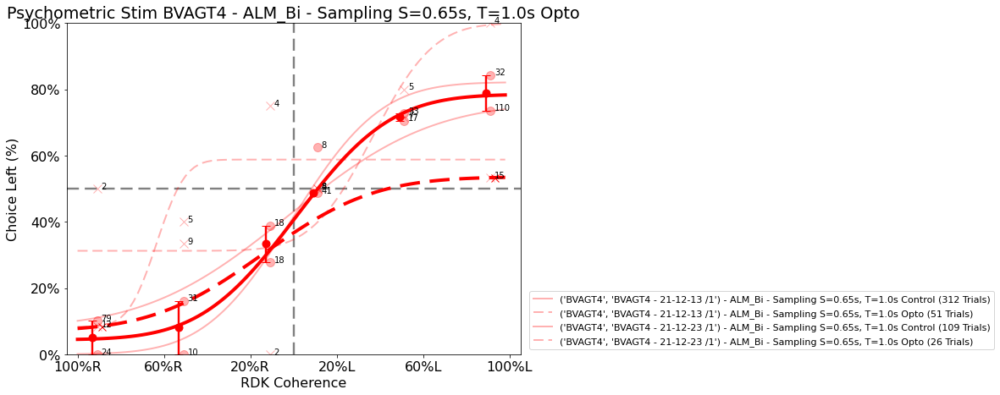

brain_region: PPC_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0, -1)
nfits for len: 269 = 185


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.23306987427903092 - β: 0.6989781490467192 - λ1: 0.148358195523612 - λ2: 0.15188426713927217
nfits for len: 52 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.5906115295801522 - β: 0.5579206491025503 - λ1: 0.357446137948507 - λ2: 1.9375388701593128e-07


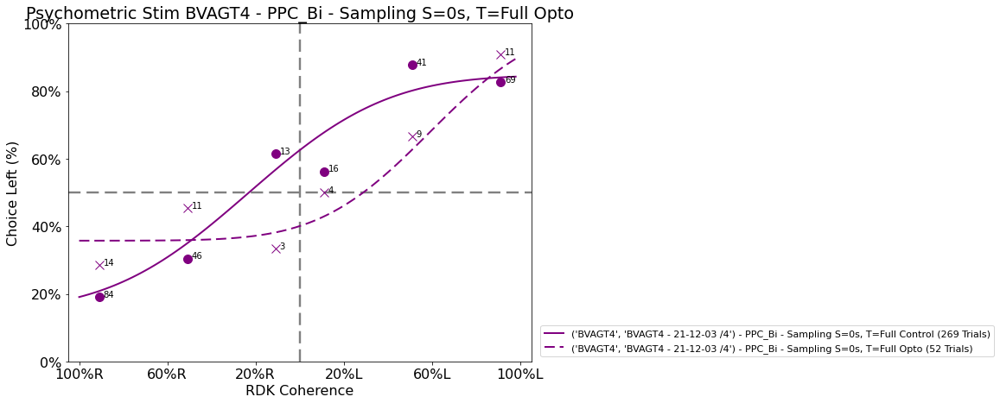

brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.35)
nfits for len: 213 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.47295566875791195 - β: 0.9662147722415009 - λ1: 0.028174140720044417 - λ2: 0.0024433031510305014
nfits for len: 177 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.46338678971470537 - β: 0.9034479258517425 - λ1: 0.11252645238225173 - λ2: 0.04287361101965269
nfits for len: 199 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.06922580428826403 - β: 0.9004510621012703 - λ1: 0.0296468977016719 - λ2: 4.2789363006494936e-08
nfits for len: 18 = 200
α: -0.20185786543571235 - β: 0.9116650576435823 - λ1: 0.07114628927070688 - λ2: 0.0009203592192502292
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}
nfits for len: 50 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.016212327043071233 - β: 0.6057099609627118 - λ1: 0.1507200489199181 - λ2: 0.39232080989226736
nfits for len: 40 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.37046837607744193 - β: 0.035550982868626915 - λ1: 0.21739240101232205 - λ2: 0.29411848188516776
nfits for len: 49 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.5802218471507087 - β: 1.6867111379733999 - λ1: 0.05711041425990732 - λ2: 2.971725656404427e-09
nfits for len: 5 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.08644128309900728 - β: 0.10685313434015863 - λ1: 0.23057359426372237 - λ2: 0.07692307544743132
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}


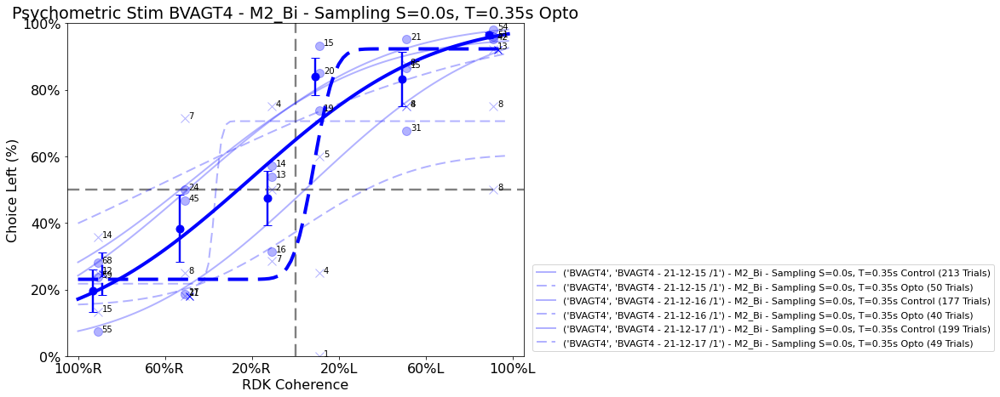

brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0, -1)
nfits for len: 189 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.10082817645167785 - β: 0.564339778274236 - λ1: 0.10099775583403636 - λ2: 0.1047339744071038
nfits for len: 193 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.2611678345381456 - β: 0.9915596296952391 - λ1: 2.3974255174600224e-08 - λ2: 0.08001609800166717
nfits for len: 232 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.19583983473867897 - β: 0.1221625651243051 - λ1: 0.23889901588002288 - λ2: 0.156862623619198
nfits for len: 208 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.526777286864475 - β: 0.36476817095852265 - λ1: 0.3536060334888128 - λ2: 4.6813284847642634e-08
nfits for len: 225 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.2747849763292013 - β: 1.2058620931118211 - λ1: 0.12279986255059233 - λ2: 2.3114342150048102e-08
nfits for len: 271 = 184


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.2624097718071363 - β: 0.5530312250537397 - λ1: 0.1701800491639049 - λ2: 0.33699221258354917
nfits for len: 35 = 200
α: -0.0710377604423794 - β: 0.85181165905166 - λ1: 0.11671539455878721 - λ2: 0.11762317059327106
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}
nfits for len: 20 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.2155561089325802 - β: 0.06904252212926856 - λ1: 0.2222222232845971 - λ2: 0.33333332945418387
nfits for len: 42 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.7480966803606834 - β: 0.5654524371001066 - λ1: 0.39504886840320963 - λ2: 0.06822592373497818
nfits for len: 38 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.20390402778142458 - β: 0.0008942399940378425 - λ1: 0.24998609397394728 - λ2: 0.31820414484619597
nfits for len: 16 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.6525526003008213 - β: 0.21906890948504293 - λ1: 0.4321361456946975 - λ2: 0.19533995117797204
nfits for len: 38 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.5999643913786545 - β: 5.414232546513149e-05 - λ1: 0.8667076834487561 - λ2: 0.18745257670294996
nfits for len: 61 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.237255812168878 - β: 0.06709626302751528 - λ1: 0.39393938794087857 - λ2: 0.11538461396188911
nfits for len: 5 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.14695514932425743 - β: 1.6800812265988694 - λ1: 0.36494970471162347 - λ2: 0.038567739254236975
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}


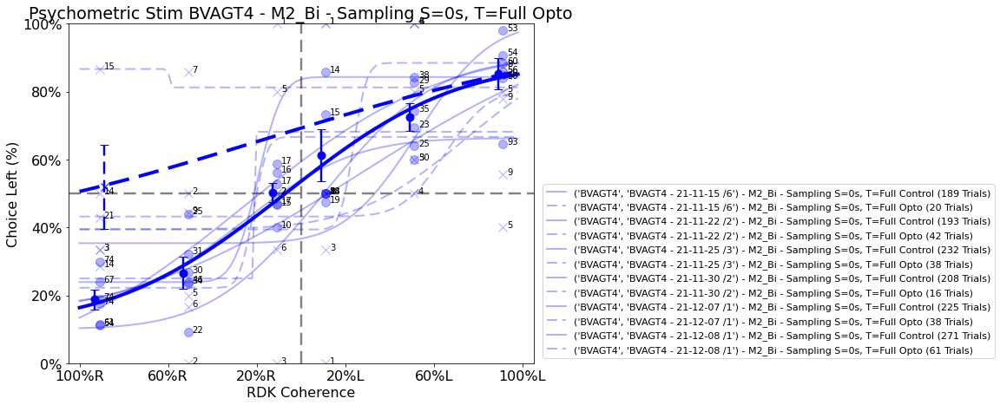

brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.65, 1.0)
nfits for len: 175 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.05974507614471987 - β: 0.8255586899580374 - λ1: 4.0172285914466986e-08 - λ2: 0.054279302689736575
nfits for len: 248 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.17864301507074248 - β: 0.6517415033223773 - λ1: 0.021458921385292012 - λ2: 0.1025427608782701
nfits for len: 79 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.0013532032838328104 - β: 0.9453343086346815 - λ1: 4.336320069087702e-09 - λ2: 2.7075482880960316e-05
nfits for len: 16 = 200
α: -0.06202751540202819 - β: 0.6581643202318662 - λ1: 2.047193299770607e-08 - λ2: 0.08814708961850215
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}
nfits for len: 42 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.3324098655460345 - β: 0.027439472804497454 - λ1: 0.5806476893631511 - λ2: 0.18182038772083386
nfits for len: 83 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.34401848489761533 - β: 0.28960704796284653 - λ1: 0.16724281135032923 - λ2: 0.12266562247754323
nfits for len: 27 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.4263439549832532 - β: 0.4167799207488565 - λ1: 2.3442677166614147e-09 - λ2: 0.22597001529556882
nfits for len: 5 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.3555705229887989 - β: 1.4375761555920246 - λ1: 0.09723113196664179 - λ2: 5.60074806107146e-10
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}


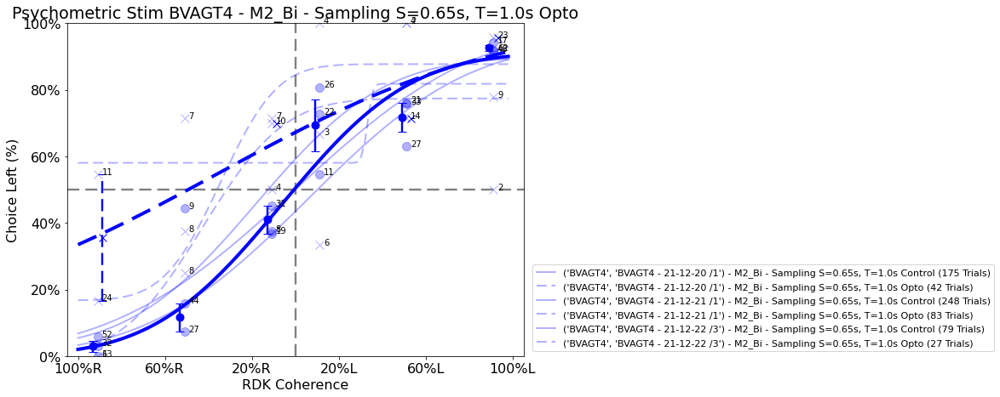

brain_region: V1_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.35)
No valid sessions found for V1_Bi - . Returning
brain_region: V1_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0, -1)
nfits for len: 169 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.08248769793766522 - β: 1.4841062469592332 - λ1: 4.322147512797666e-07 - λ2: 1.615931817712557e-07
nfits for len: 217 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.4274349456369133 - β: 0.9601423009873893 - λ1: 1.2432752268087532e-07 - λ2: 0.17315541451098893
nfits for len: 12 = 200
α: -0.22561175842098347 - β: 1.2526691771577572 - λ1: 3.039929520684348e-08 - λ2: 0.07836904878291007
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'green', 'marker': None, 'markersize': 5}
nfits for len: 18 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.007679670477467078 - β: 0.037919650370573356 - λ1: 0.4999999991202945 - λ2: 0.24999999819382474
nfits for len: 40 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.2621800498585558 - β: 0.008874567478750456 - λ1: 0.4666729247442424 - λ2: 0.11999599583578532
nfits for len: 2 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.17765333439102102 - β: 0.5489561421908378 - λ1: 0.4868920389471926 - λ2: 0.07030416276160102
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'green', 'marker': None, 'markersize': 5}


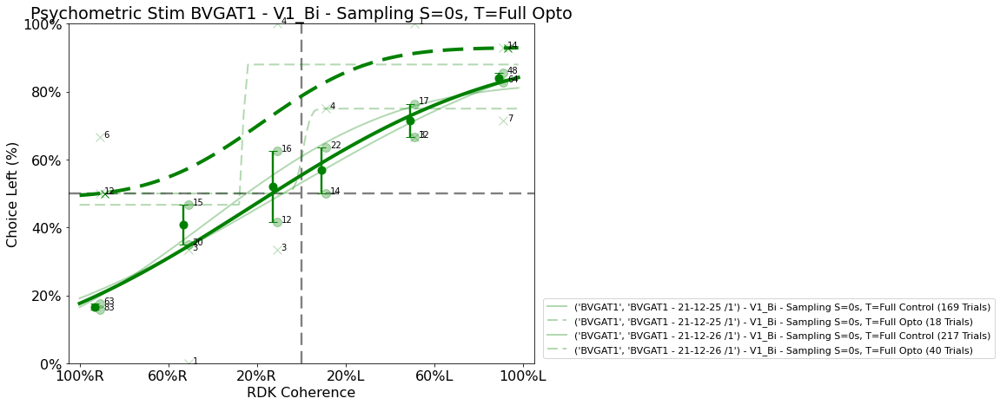

brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.35)
nfits for len: 124 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.005436722897964932 - β: 1.0565941518241997 - λ1: 0.12440650476368983 - λ2: 0.1248588015769717
nfits for len: 31 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.5261602790332212 - β: 0.013513488651571206 - λ1: 0.18749999886042054 - λ2: 0.2666666798179307


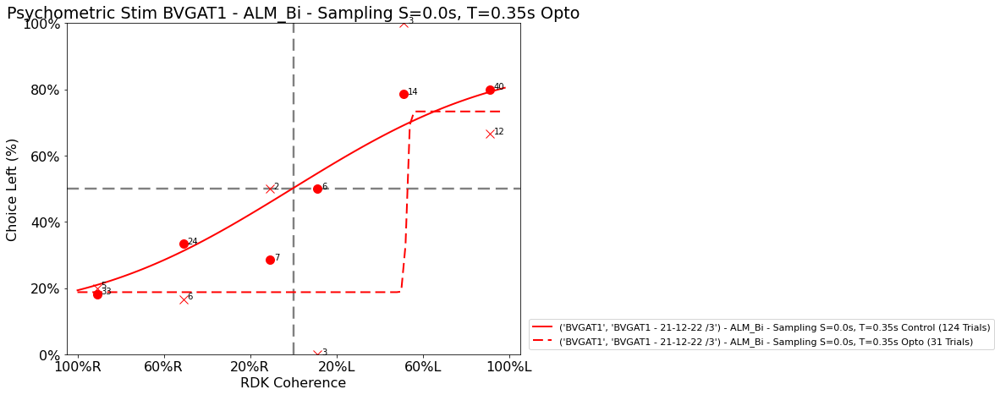

brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0, -1)
nfits for len: 177 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.1766424342210126 - β: 0.06953188547107284 - λ1: 0.19512195213748101 - λ2: 0.21176471308756925
nfits for len: 17 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.039309703981761535 - β: 0.04265119972418965 - λ1: 0.4285706571996416 - λ2: 0.3999988094549344


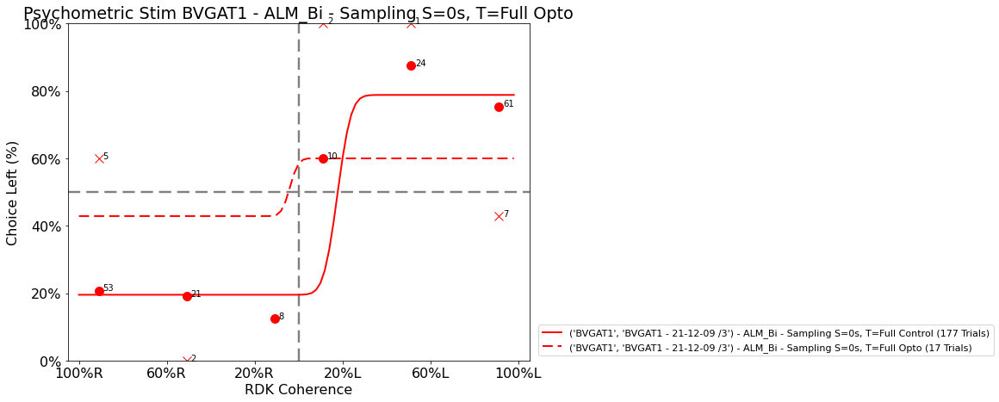

brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.65, 1.0)
nfits for len: 118 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.3512218813917204 - β: 0.813292740710819 - λ1: 0.0916174038481026 - λ2: 0.14775061572193582
nfits for len: 136 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.41173321179568156 - β: 0.31907760018786335 - λ1: 0.20660583838796912 - λ2: 0.1116289871849787
nfits for len: 165 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.22005773842977222 - β: 1.0401256578776532 - λ1: 4.322482874900257e-08 - λ2: 0.3019245918135837
nfits for len: 15 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.19494385862235114 - β: 1.1238655502005028 - λ1: 2.928518891843885e-07 - λ2: 0.10921259372705272
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}
nfits for len: 21 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.8232250442098401 - β: 0.06278366246473954 - λ1: 0.4999999831047516 - λ2: 0.11109782098194688
nfits for len: 22 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.02704971631957185 - β: 0.03332249045383863 - λ1: 0.33333332822672423 - λ2: 0.5000000106563667
nfits for len: 44 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.7816009664970199 - β: 0.2101270576448927 - λ1: 0.43190095251325333 - λ2: 0.15386674158741193
nfits for len: 2 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.7495912500386326 - β: 3.221168692918205 - λ1: 4.92468881406255e-06 - λ2: 0.022019617164420795
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}


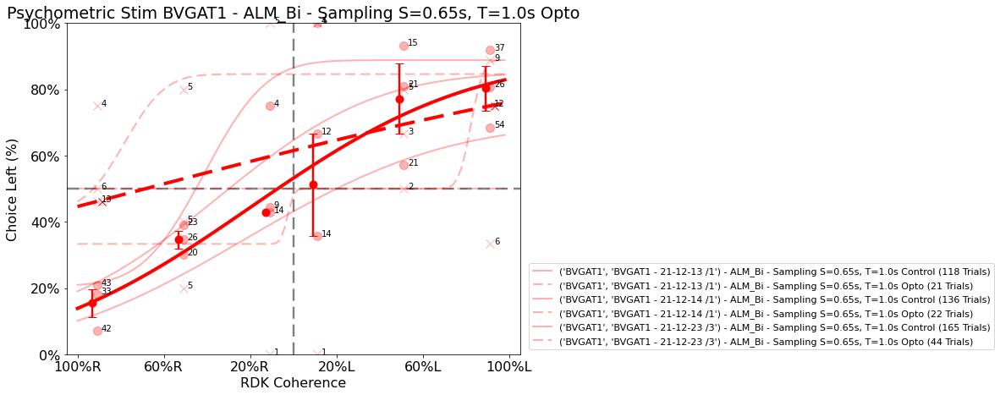

brain_region: ALM_Bi - Opto config: (<MatrixState.CenterPortRewardDelivery: 11>, 0, -1)
nfits for len: 272 = 183


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.3925018482079101 - β: 0.7452218804343049 - λ1: 0.07962288919831884 - λ2: 0.16853214192109006
nfits for len: 273 = 183


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.3179038510072865 - β: 1.1172587883279506 - λ1: 8.550473098444845e-09 - λ2: 0.06333753484615615
nfits for len: 11 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.41213237181593193 - β: 0.8454660156855704 - λ1: 2.0471840047644096e-07 - λ2: 0.13753334115281066
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}
nfits for len: 55 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.8582670465639853 - β: 0.4297562174429058 - λ1: 0.09351860925328903 - λ2: 0.5219789215418975
nfits for len: 43 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.20006281504013954 - β: 7.753147881654356e-06 - λ1: 0.117976850904443 - λ2: 0.7867933948267167
nfits for len: 4 = 200
α: -0.21386054941581825 - β: 2.0840614410617033 - λ1: 0.020217955099801413 - λ2: 0.6580927860164474
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}


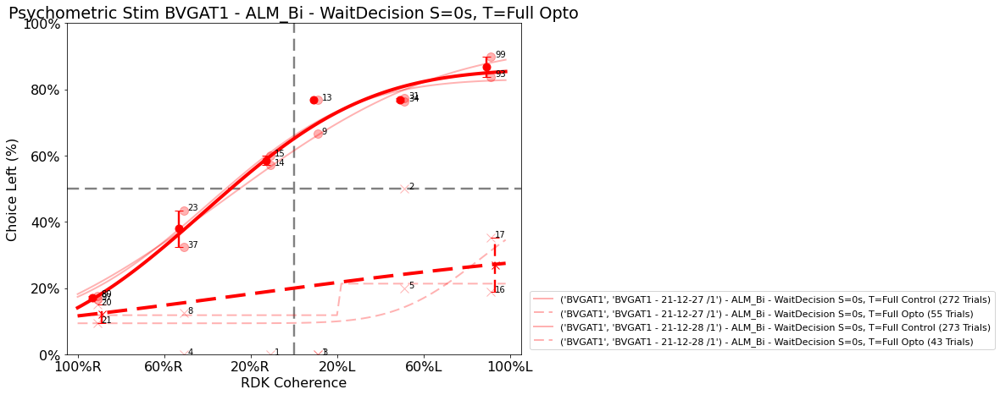

brain_region: PPC_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.35)
nfits for len: 114 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.13005640381472733 - β: 0.26079406781764636 - λ1: 0.09379918307705395 - λ2: 0.08442670878576805
nfits for len: 35 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.16169036922330632 - β: 0.13093015194839544 - λ1: 0.2349273863487656 - λ2: 4.5981748365084554e-09


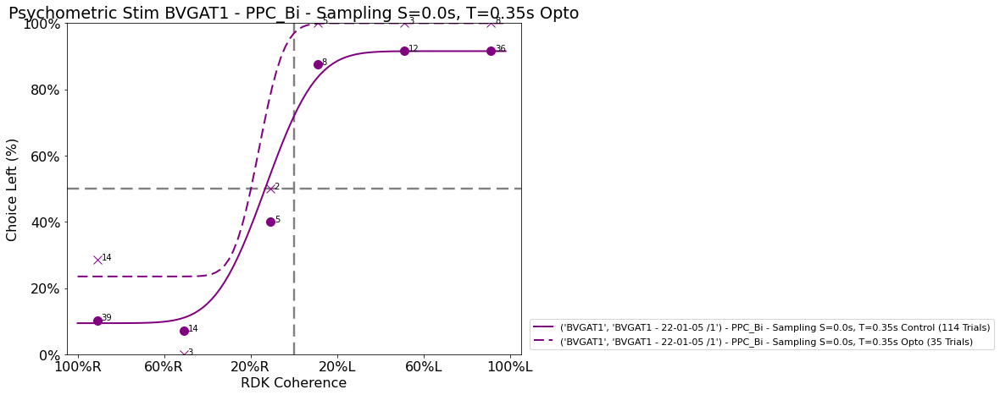

brain_region: PPC_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0, -1)
nfits for len: 94 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.20591440641944242 - β: 0.5252520739836042 - λ1: 4.434766973031071e-09 - λ2: 0.27926931619625694
nfits for len: 177 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.0913444247668224 - β: 0.9497964509030699 - λ1: 0.12521641719731924 - λ2: 0.10334242436042651
nfits for len: 10 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.17877389840708513 - β: 0.6439550409052506 - λ1: 0.05598795594874085 - λ2: 0.20500867279576832
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}
nfits for len: 35 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.41188836206055585 - β: 1.0763774930252243 - λ1: 4.7407633171625196e-08 - λ2: 0.3019257468456714
nfits for len: 31 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.6208598747845094 - β: 0.019468579431734523 - λ1: 0.3889797729298579 - λ2: 1.5462661290439523e-09
nfits for len: 1 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.6013803741097428 - β: 191.57844287660214 - λ1: 0.29503381912770066 - λ2: 0.9898777098913686
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'purple', 'marker': None, 'markersize': 5}


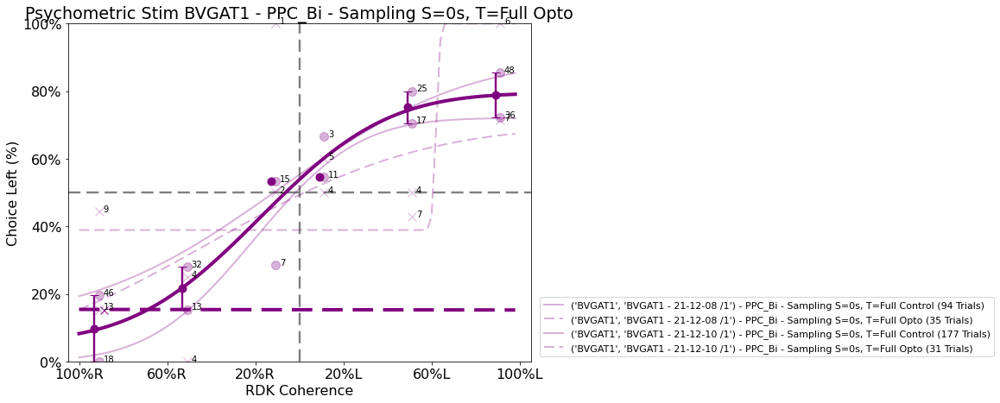

brain_region: PPC_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.65, 1.0)
nfits for len: 142 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.1291714457680969 - β: 0.6850483638205251 - λ1: 0.19375561906359318 - λ2: 0.06130493092707178
nfits for len: 36 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.3567705163996896 - β: 1.0960343130465315 - λ1: 0.009680701211530515 - λ2: 4.937496070527787e-09


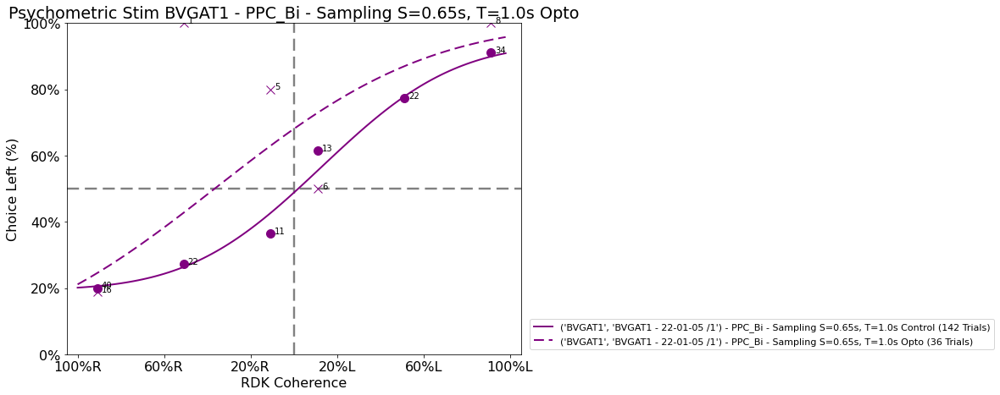

brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.35)
nfits for len: 109 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.5125823525719064 - β: 0.5087804381222507 - λ1: 8.717092624137176e-08 - λ2: 0.14459217746496889
nfits for len: 186 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.09748768973345542 - β: 0.9270772070592156 - λ1: 0.1421098610339504 - λ2: 0.06702026076423157
nfits for len: 207 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.1124435714641881 - β: 1.4934291395558095 - λ1: 0.0174145013427722 - λ2: 1.290756105607429e-08
nfits for len: 262 = 190


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.12708536797205375 - β: 0.6328441489584712 - λ1: 0.1970935036490889 - λ2: 0.017840154914205823
nfits for len: 23 = 200
α: -0.0715148008341582 - β: 0.9089419146957015 - λ1: 0.08509401310944359 - λ2: 0.050447508195933966
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}
nfits for len: 7 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.38357749000111085 - β: 0.05602026861222341 - λ1: 1.9102181444807338e-08 - λ2: 2.4433544093206294e-09
nfits for len: 24 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.07563378434320601 - β: 0.022839901029962376 - λ1: 0.374999998992072 - λ2: 0.1249999982444143
nfits for len: 35 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.9367541884350319 - β: 0.021810914921805088 - λ1: 0.32143432411407163 - λ2: 0.42854776940482375
nfits for len: 40 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.6174909956654088 - β: 0.1856132219265712 - λ1: 0.20833321781059994 - λ2: 0.36287228655280673
nfits for len: 3 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.5861235810099941 - β: 0.08773197330884334 - λ1: 0.2678574590444752 - λ2: 0.36363771312671894
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}


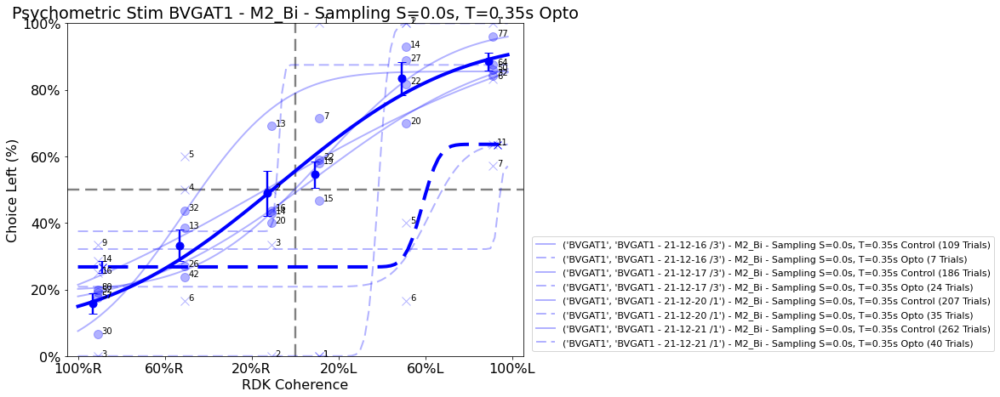

brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0, -1)
No valid sessions found for M2_Bi - . Returning
brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.65, 1.0)
No valid sessions found for M2_Bi - . Returning
brain_region: M2_Bi - Opto config: (<MatrixState.CenterPortRewardDelivery: 11>, 0, -1)
nfits for len: 266 = 187


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.08807522574287621 - β: 0.8221405417025494 - λ1: 0.20127366479316033 - λ2: 0.15416333162888352
nfits for len: 135 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.8018938935568685 - β: 0.6967666190792094 - λ1: 9.870051083183458e-07 - λ2: 0.2150460711209864
nfits for len: 10 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.026750134528942128 - β: 1.7095941386219118 - λ1: 0.038790595523728565 - λ2: 2.817407972733006e-10
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}
nfits for len: 22 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.956014491815061 - β: 0.08119011000636564 - λ1: 0.49024916415606734 - λ2: 0.9166672733955847
nfits for len: 25 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.8987351895135713 - β: 0.38116294823481356 - λ1: 0.21354800516581207 - λ2: 0.08035663933571383
nfits for len: 2 = 200
α: -0.12286859535955555 - β: 90.23169577904108 - λ1: 0.1297390065624795 - λ2: 0.5119261696186685
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}


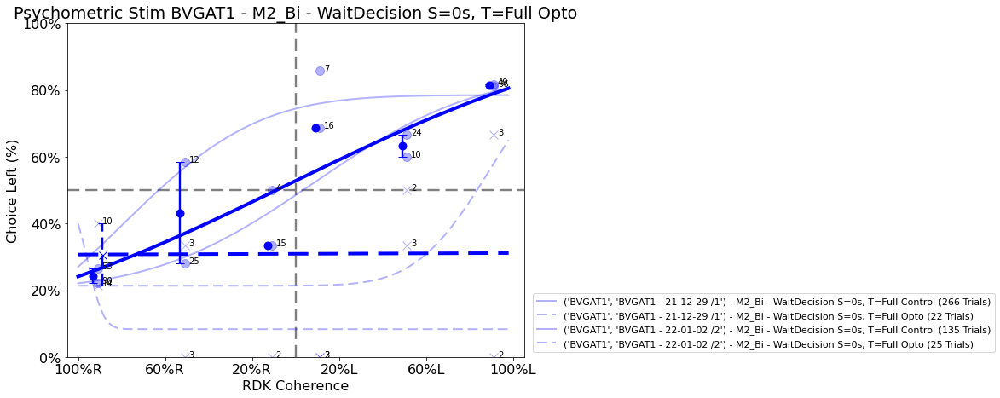

brain_region: S1_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0, -1)
nfits for len: 188 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.09188840403367393 - β: 0.5003832917543507 - λ1: 0.2755911227532135 - λ2: 0.12555917004280964
nfits for len: 272 = 183


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.10441715774031488 - β: 0.018176713908499887 - λ1: 0.40764331489823546 - λ2: 0.26086956448625875
nfits for len: 10 = 200
α: -0.004548287177335773 - β: 0.13580307437389716 - λ1: 0.38266263043888743 - λ2: 0.17899961348265112
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'gray', 'marker': None, 'markersize': 5}
nfits for len: 31 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.7963536283232816 - β: 0.19281264688815913 - λ1: 0.17633541405175207 - λ2: 0.47370287844330194
nfits for len: 26 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.7029188999093414 - β: 0.436137324675302 - λ1: 0.292208748945857 - λ2: 2.7909225460995548e-08
nfits for len: 3 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.997387956979207 - β: 2.9912340978587437 - λ1: 0.09698104766780084 - λ2: 0.06951059263772055
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'gray', 'marker': None, 'markersize': 5}


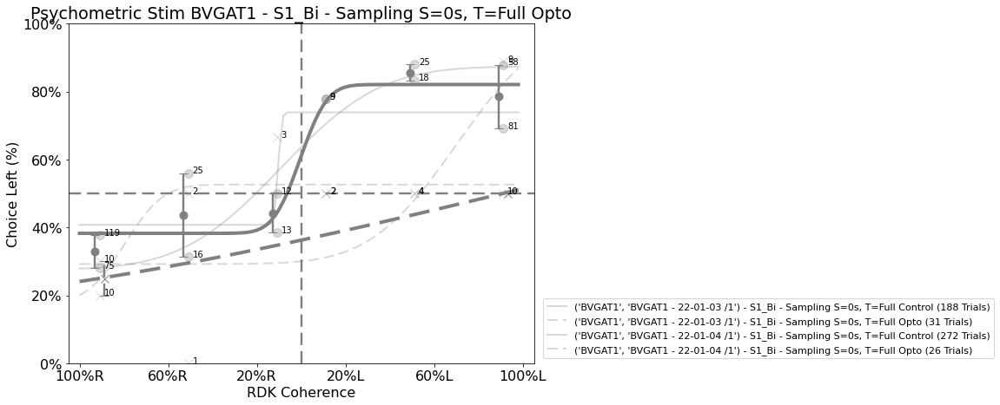

brain_region: S1_Bi - Opto config: (<MatrixState.CenterPortRewardDelivery: 11>, 0, -1)
No valid sessions found for S1_Bi - . Returning
brain_region: V1_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.35)
No valid sessions found for V1_Bi - . Returning
brain_region: V1_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0, -1)
nfits for len: 216 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.3420453566058592 - β: 1.2201451110161163 - λ1: 0.1834862116456877 - λ2: 3.042181506339602e-08
nfits for len: 231 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.03547411894252496 - β: 1.69432874134091 - λ1: 0.11628176815565944 - λ2: 3.840569474852072e-08
nfits for len: 11 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.289893459471804 - β: 1.15322823293193 - λ1: 0.2261189038043749 - λ2: 3.297081193733088e-08
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'green', 'marker': None, 'markersize': 5}
nfits for len: 41 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.25823544161953305 - β: 0.06812093565518372 - λ1: 0.29412030982715054 - λ2: 0.2857190102642659
nfits for len: 54 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.5844290848486345 - β: 0.6671809387136879 - λ1: 0.27190464894239647 - λ2: 9.039215767115291e-07
nfits for len: 4 = 200
α: 0.08449067445792735 - β: 1.561840785308036 - λ1: 0.12839965058047226 - λ2: 0.02391460109589472
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'green', 'marker': None, 'markersize': 5}


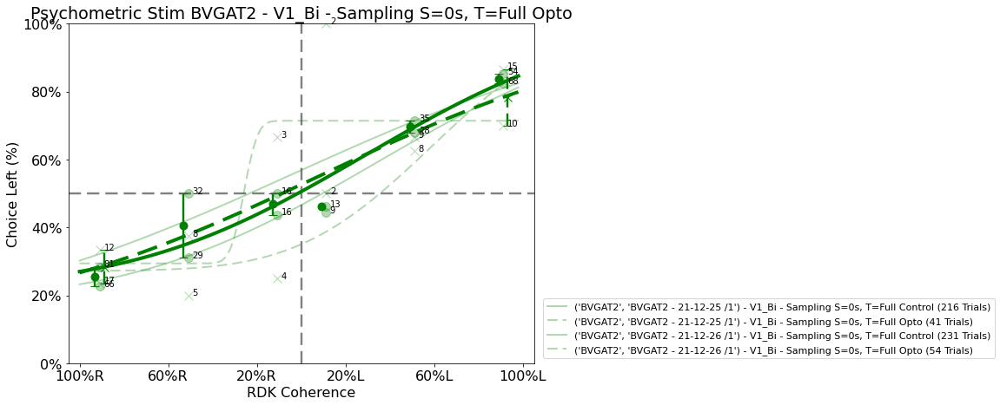

brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.35)
nfits for len: 176 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.06339782480309299 - β: 0.02567842996538108 - λ1: 0.21505376075291316 - λ2: 0.21686747319546598
nfits for len: 237 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.15181737223374947 - β: 1.7611188383840015 - λ1: 1.3187237114722513e-06 - λ2: 4.2446720414832093e-07
nfits for len: 209 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.03659141148087703 - β: 1.3753810560876927 - λ1: 0.06375707558134214 - λ2: 1.5160005009877625e-08
nfits for len: 16 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.07718018371746681 - β: 1.4631483487836383 - λ1: 0.08173316653836235 - λ2: 8.565239053364247e-08
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}
nfits for len: 22 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.31882658947035636 - β: 0.027920022583315975 - λ1: 0.3333307300673019 - λ2: 0.15384683561040552
nfits for len: 33 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.833120819659656 - β: 0.26853655359495304 - λ1: 0.09836863477353804 - λ2: 0.36880639778564145
nfits for len: 36 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.12319431531004699 - β: 0.02120942226420855 - λ1: 0.2500000040965477 - λ2: 0.4999999996113919
nfits for len: 3 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.025769506641312133 - β: 0.429721080620954 - λ1: 0.2659967244761263 - λ2: 0.36325221223421733
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}


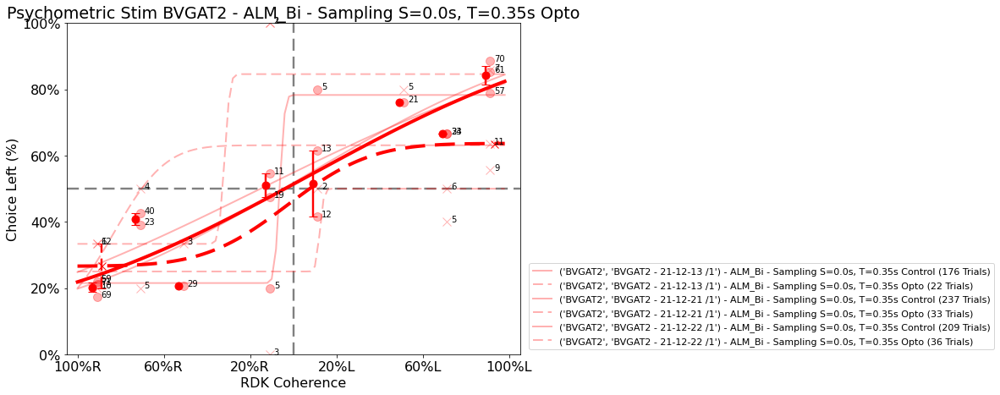

brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0, -1)
nfits for len: 246 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.12806812556710212 - β: 0.06341783383979335 - λ1: 0.2627118626798164 - λ2: 0.3140495923410521
nfits for len: 204 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.17446706656255895 - β: 1.6899155219169817 - λ1: 2.1861395140875206e-07 - λ2: 0.047030178738875064
nfits for len: 9 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.34214400449338556 - β: 0.3482594641650887 - λ1: 0.2300188508243053 - λ2: 0.2853393957370983
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}
nfits for len: 13 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.7923319028341055 - β: 0.03476075019912894 - λ1: 0.8571428583712413 - λ2: 0.3333333348407198
nfits for len: 9 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.6432195232407067 - β: 0.13524111755581208 - λ1: 0.9999999968440692 - λ2: 0.7464469402756252


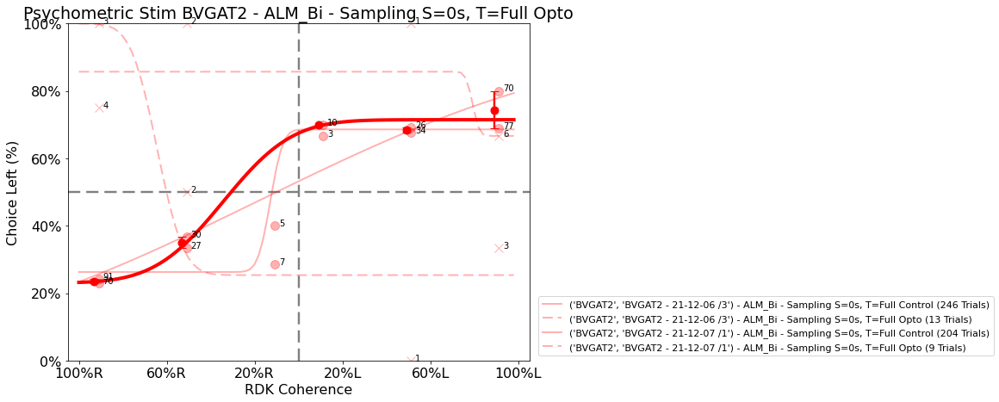

brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.65, 1.0)
nfits for len: 130 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.034884052577647914 - β: 0.030370859720541668 - λ1: 0.3733333344524554 - λ2: 0.1454545486043826
nfits for len: 241 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.03749765957849686 - β: 0.2217558514385844 - λ1: 0.28702695370122094 - λ2: 0.20210938941671802
nfits for len: 10 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.015241944850980592 - β: 0.11622209831271671 - λ1: 0.33217113621353594 - λ2: 0.17381276323770883
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}
nfits for len: 34 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.349178115840287 - β: 0.10580019503587762 - λ1: 0.4786300520772001 - λ2: 0.11106923508772873
nfits for len: 32 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.09693579286595852 - β: 0.02497864232288763 - λ1: 0.6111133631849095 - λ2: 0.14285461461781368
nfits for len: 2 = 200
α: 0.3562357706364969 - β: 32.64255436891158 - λ1: 0.11152475141966704 - λ2: 0.006262179630222223
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'red', 'marker': None, 'markersize': 5}


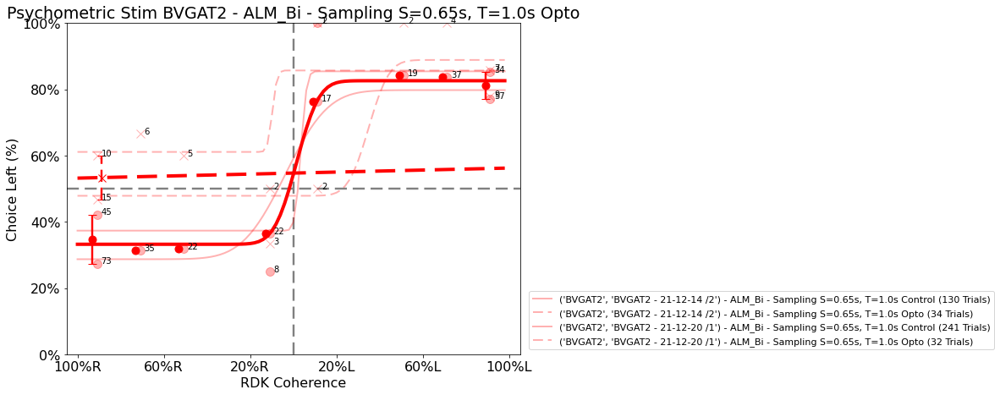

brain_region: ALM_Bi - Opto config: (<MatrixState.CenterPortRewardDelivery: 11>, 0, -1)
No valid sessions found for ALM_Bi - . Returning
brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.35)
nfits for len: 166 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.6916782363832095 - β: 0.6120809721613121 - λ1: 0.06545173270911273 - λ2: 0.3328573969254478
nfits for len: 186 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.2763986906712643 - β: 0.30206477292020806 - λ1: 0.1564298437833462 - λ2: 0.2510904409933583
nfits for len: 12 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.11034793546927643 - β: 0.0016388861465322152 - λ1: 0.22844526769573126 - λ2: 0.30102855455942323
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}
nfits for len: 27 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.544431596954314 - β: 0.018840551064811948 - λ1: 0.7058884243267063 - λ2: 0.09999631916076782
nfits for len: 74 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.9397822599664462 - β: 0.10160233603420914 - λ1: 0.07176943246091333 - λ2: 0.4591733942770909
nfits for len: 2 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.860858672847733 - β: 0.6833363774835215 - λ1: 0.16657401213645978 - λ2: 0.08439333014463685
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}


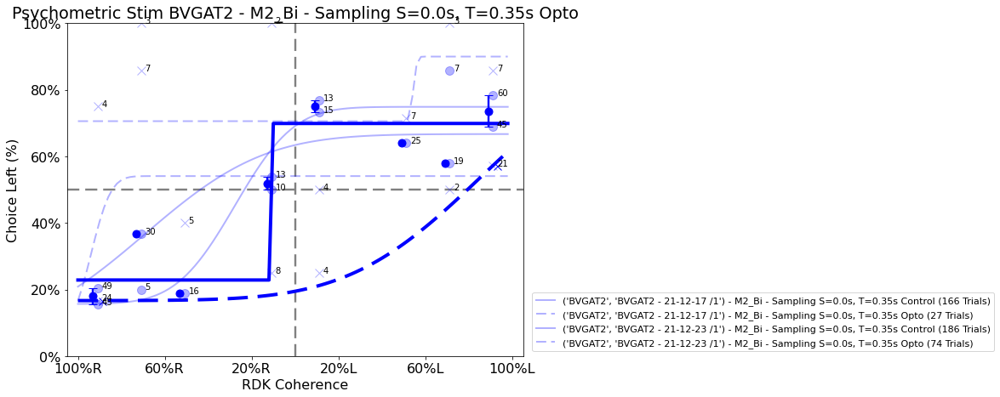

brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0, -1)
nfits for len: 151 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.18490487732346406 - β: 2.472167291818624 - λ1: 0.00015829180474153471 - λ2: 2.8386215599532187e-05
nfits for len: 125 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.41804691602645005 - β: 0.41497128645800235 - λ1: 0.2271532362543777 - λ2: 0.28841298083168243
nfits for len: 9 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.466130080577309 - β: 1.6504343296172972 - λ1: 0.1258089709348853 - λ2: 2.7961404728654615e-06
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}
nfits for len: 9 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.4709417571904604 - β: 0.02302939019406616 - λ1: 0.9999999999999999 - λ2: 0.500000002720829
nfits for len: 9 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.2417805718726832 - β: 0.00034208090782528416 - λ1: 1.0717415886690187e-07 - λ2: 0.6250840595981138


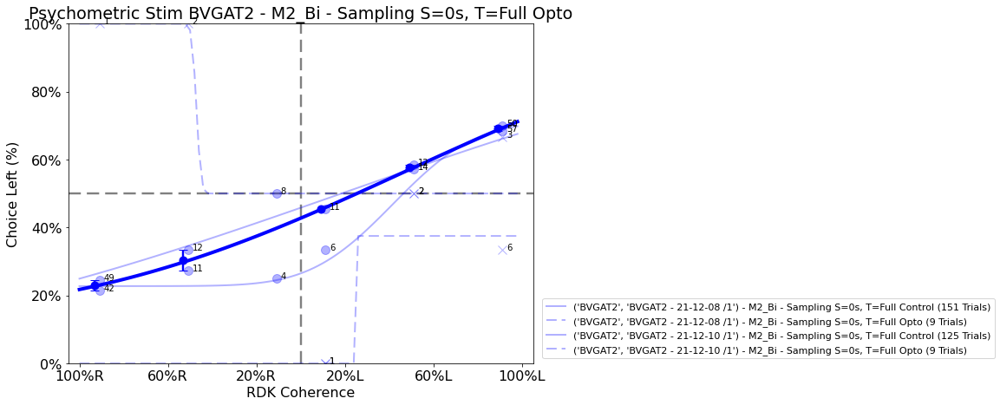

brain_region: M2_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.65, 1.0)
nfits for len: 140 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.26070573308020994 - β: 0.30981301352586 - λ1: 0.33317684856082636 - λ2: 0.11735648838538651
nfits for len: 116 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.36506271678541546 - β: 0.03513466803853913 - λ1: 0.18518562119618395 - λ2: 0.29031977614037235
nfits for len: 7 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: -0.48975429994575004 - β: 0.04062358738462018 - λ1: 0.23015873001726866 - λ2: 0.2021593031315368
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}
nfits for len: 31 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.20081964730739188 - β: 0.07306212882128249 - λ1: 0.3124999964496528 - λ2: 0.3076923046507617
nfits for len: 21 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.10303761809105699 - β: 0.025816755933815997 - λ1: 0.7692307684066098 - λ2: 0.5000000002394162
nfits for len: 2 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.4082336504282202 - β: 0.0467438924997991 - λ1: 0.30769237327228594 - λ2: 0.30000010808561844
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}


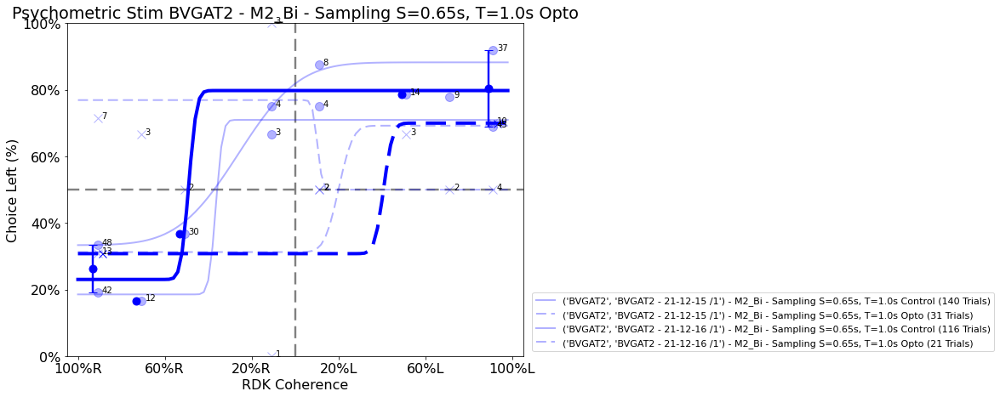

brain_region: M2_Bi - Opto config: (<MatrixState.CenterPortRewardDelivery: 11>, 0, -1)
nfits for len: 210 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.5142779095575138 - β: 0.8495317517208669 - λ1: 0.4353447353237905 - λ2: 3.12597776233665e-08
nfits for len: 324 = 154


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.1576810307468252 - β: 1.416440265823939 - λ1: 3.0323361943020295e-08 - λ2: 0.00022354945158988563
nfits for len: 12 = 200
α: 0.4402512050247763 - β: 0.9456616233253228 - λ1: 0.3053116976389366 - λ2: 4.529300589263183e-09
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}
nfits for len: 28 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.34309111221444427 - β: 0.04197410917546375 - λ1: 1.912886046868687e-08 - λ2: 0.7333226586569423
nfits for len: 50 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.6950719233480109 - β: 0.017493029659928893 - λ1: 0.10526315896266772 - λ2: 0.7419354862308607
nfits for len: 3 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.2530011358993805 - β: 12.22132824616488 - λ1: 7.210057507452288e-05 - λ2: 0.8822062201866736
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'blue', 'marker': None, 'markersize': 5}


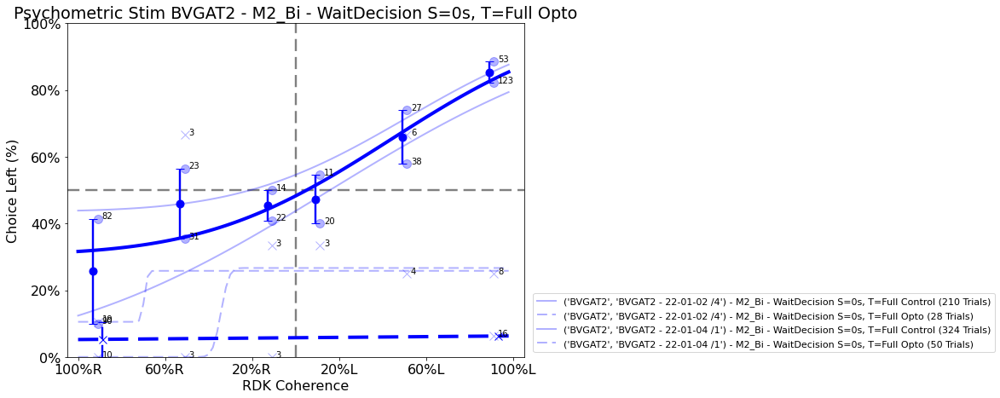

brain_region: V1_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0, -1)
nfits for len: 208 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.3145554776285644 - β: 0.34978880053040917 - λ1: 0.07368083844875024 - λ2: 0.2985780660270442
nfits for len: 251 = 199


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.09771849083183887 - β: 0.704667190268376 - λ1: 0.1942344158327412 - λ2: 3.552580424544074e-09
nfits for len: 12 = 200
α: -0.10412651647667417 - β: 0.864211171488831 - λ1: 0.04517069361868346 - λ2: 0.10414308304343843
_plot_kargs: {'linestyle': '-', 'linewidth': 4, 'color': 'green', 'marker': None, 'markersize': 5}
nfits for len: 47 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: -0.9999904119699012 - β: 0.6006658550874586 - λ1: 0.15440830422549795 - λ2: 0.14323369994740387
nfits for len: 62 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


α: 0.10874340306911695 - β: 1.3151305376730356 - λ1: 0.19323093445767797 - λ2: 2.4972018771736383e-08
nfits for len: 5 = 200


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


α: 0.39515565866128055 - β: 0.7250332098154902 - λ1: 0.3857231254730975 - λ2: 0.034027867822573596
_plot_kargs: {'linestyle': '--', 'linewidth': 4, 'color': 'green', 'marker': None, 'markersize': 5}


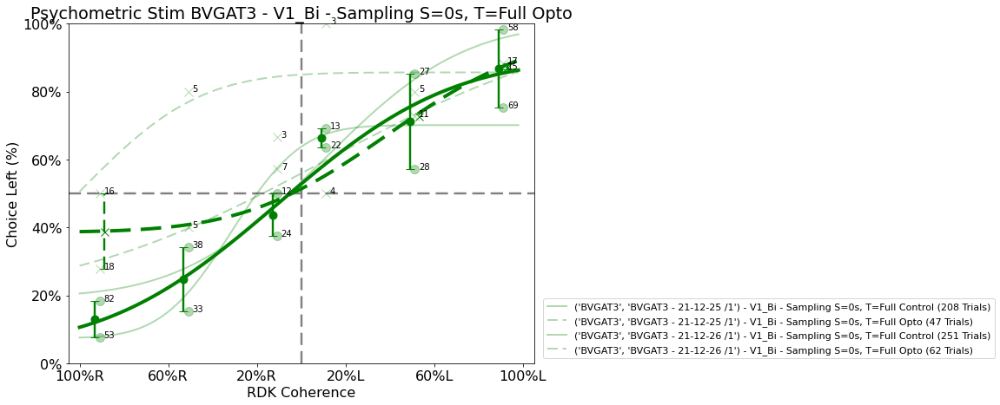

brain_region: ALM_Bi - Opto config: (<MatrixState.stimulus_delivery: 8>, 0.0, 0.35)
nfits for len: 226 = 200


c:\Users\hatem\OneDrive\Documents\BpodUser\Protocols\Mouse2AFC\report\analysis.py:932: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  markerSize=markersize*linewidth*SCALE_X, alpha=alpha)


In [4]:
from opto import optopsych, optoutil
from definitions import BrainRegion

def process(df, *, save_figs, combine_sides):
  from os import environ
  onedrive_fp = environ["ONEDRIVE"]
  save_prefix= onedrive_fp + r"/Documents/py_matlab/analysis_run/proto/optogenetics/"
  # save_prefix = "proto/optogenetics/"
  # df = df[df.Name.str.startswith("Avgat")]
  optopsych.optoPsychByAnimal("All Animals", df, by_animal=True, by_session=False, combine_sides=combine_sides,
                              incld_grp_info_lgnd=False, save_figs=save_figs, save_prefix=save_prefix)
  for animal_name, animal_df in df.groupby(df.Name): # Use unique() rather than group to reuse code when forc# ing
    optopsych.optoPsychByAnimal(animal_name, animal_df, by_animal=True, by_session=True, incld_grp_info_lgnd=True,
                                combine_sides=combine_sides, save_figs=save_figs, save_prefix=save_prefix)
process(opto_df, save_figs=False, combine_sides=False)
# process(opto_df, save_figs=True, combine_sides=True)

# Optometrics

In [16]:
display(opto_df.columns)

Index(['BlockId', 'BlockNum', 'BlocksInfo', 'CatchTrial',
       'CenterPortRewAmount', 'ChoiceCorrect', 'ChoiceLeft', 'DV',
       'DVsAlreadyGenerated', 'DotsCoherence', 'EarlyWithdrawal', 'Feedback',
       'FeedbackDelay', 'FeedbackTime', 'FixBroke', 'FixDur', 'ForcedLEDTrial',
       'GratingOrientation', 'IsHomeCage', 'LastSuccessCatchTial',
       'LeftClickTrain', 'LeftRewarded', 'LightIntensityLeft',
       'LightIntensityRight', 'MT', 'MinSample', 'MissedChoice', 'OptoEnabled',
       'PreStimCntrReward', 'ReactionTime', 'RewardAfterMinSampling',
       'RewardReceivedTotal', 'Rewarded', 'Rig', 'RightClickTrain', 'ST',
       'SecDV', 'SoundIntensityLeft', 'SoundIntensityRight', 'StimDelay',
       'StimulusOmega', 'TrialNumber', 'TrialStartSysTime', 'Trials',
       'TrialStartTimestamp', 'GUI_CalcLeftBias', 'GUI_CatchError',
       'GUI_ExperimentType', 'GUI_FeedbackDelayMax',
       'GUI_FeedbackDelaySelection', 'GUI_FeedbackDelayTau', 'GUI_MinSample',
       'GUI_MinSampl

Save prefix: C:\Users\hatem\OneDrive/Documents/py_matlab/analysis_run/proto/optogenetics/
TTTest Early bailout Overall Performance V1_L - Sampling None
Overall Performance V1_Bi Sampling None - Len: 6
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 6) - p-value: 0.0037196909107978333
TTTest Early bailout Overall Performance V1_Bi - Sampling None
Overall Performance M2_Bi Sampling None - Len: 5
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 5) - p-value: 0.26760805739643534

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


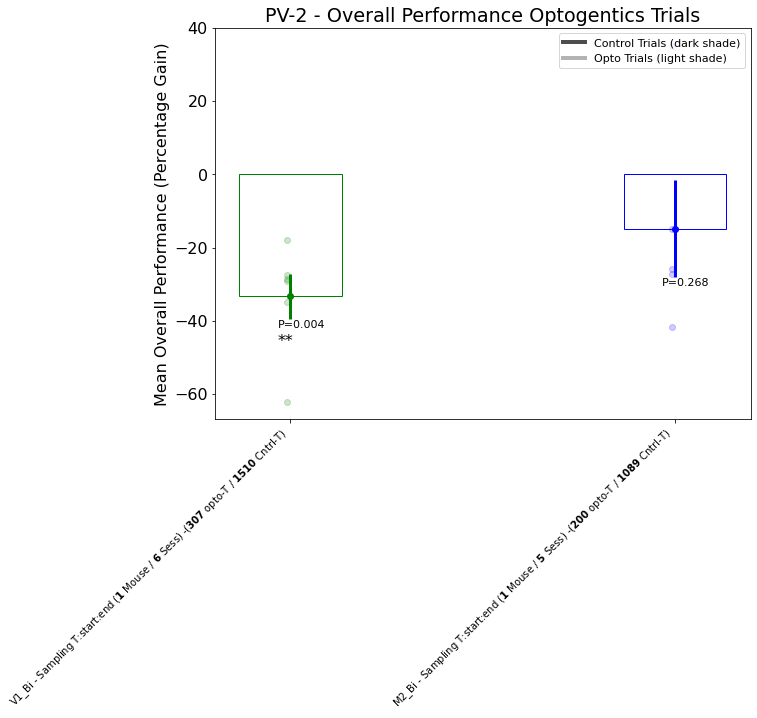

TTTest Early bailout Decision Time V1_L - Sampling None


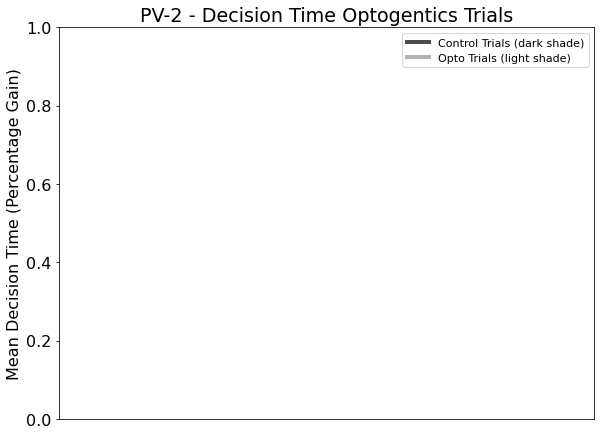

TTTest Early bailout Reaction Time V1_L - Sampling None
Reaction Time V1_Bi Sampling None - Len: 6
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 6) - p-value: 0.34276903700836964
TTTest Early bailout Reaction Time V1_Bi - Sampling None
Reaction Time M2_Bi Sampling None - Len: 5
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 5) - p-value: 0.6578903864160176


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


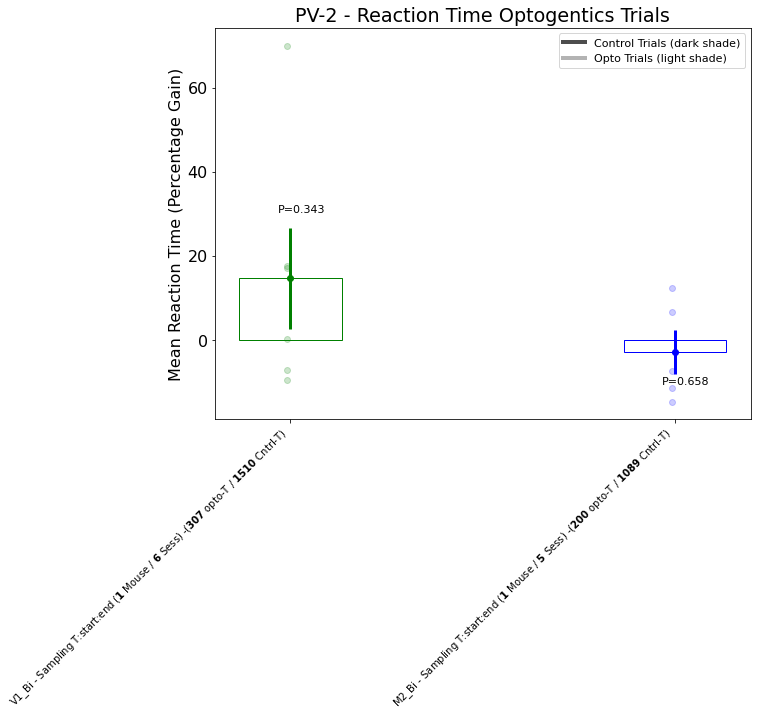

TTTest Early bailout Early-Withdrawal V1_L - Sampling None
Early-Withdrawal V1_Bi Sampling None - Len: 6
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 6) - p-value: 0.6364866348318488
TTTest Early bailout Early-Withdrawal V1_Bi - Sampling None
Early-Withdrawal M2_Bi Sampling None - Len: 5
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 5) - p-value: 0.18830410933692707


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


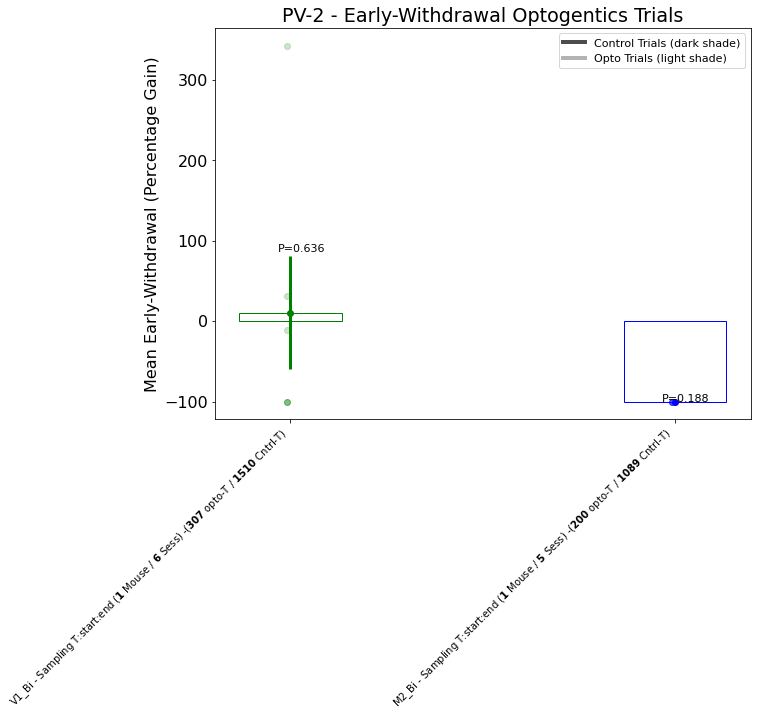

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\lib\nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\lib\nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
posx and posy should be finite values


TTTest Early bailout Movement Time V1_L - Sampling None
TTTest Early bailout Movement Time V1_Bi - Sampling None
TTTest Early bailout Movement Time V1_Bi - Sampling None
TTTest Early bailout Movement Time M2_Bi - Sampling None


posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


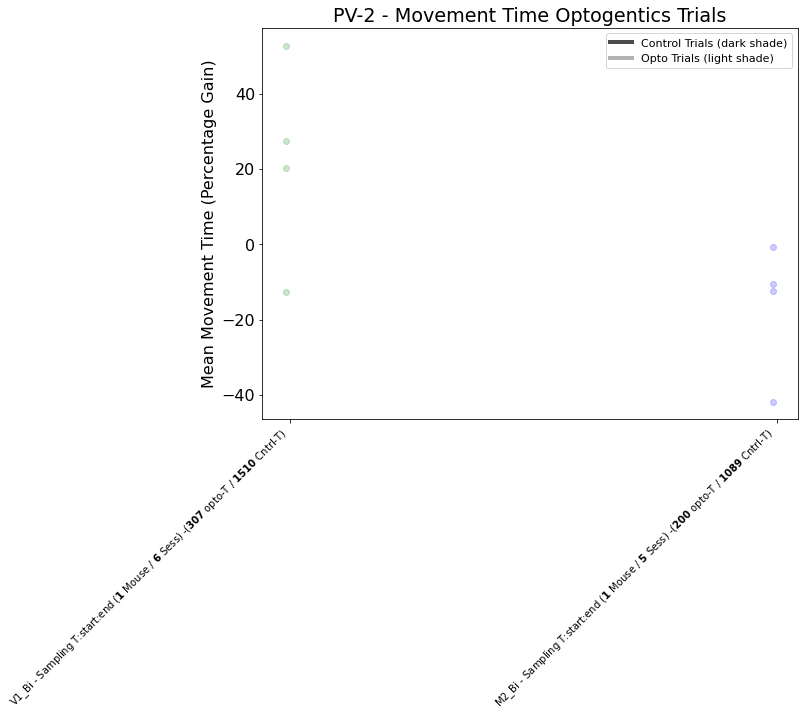

TTTest Early bailout Overall Performance V1_Bi - Sampling None
TTTest Skipping test for Overall Performance V1_Bi Sampling Avgat3
Overall Performance V1_Bi Sampling None - Len: 5
	Across Animals (Sample size: 2) - p-value: 0.7139381247473939
	Across Sessions (Sample size: 5) - p-value: 0.9899706210699838
TTTest Skipping test for Overall Performance V1_Bi Sampling Avgat2
TTTest Skipping test for Overall Performance V1_Bi Sampling Avgat4
TTTest Skipping test for Overall Performance V1_Bi Sampling BVAGT4
Overall Performance V1_Bi Sampling None - Len: 16
	Across Animals (Sample size: 7) - p-value: 0.09963964203929358
	Across Sessions (Sample size: 16) - p-value: 0.026033164052985905
TTTest Skipping test for Overall Performance V1_Bi Sampling Avgat2
TTTest Skipping test for Overall Performance V1_Bi Sampling Avgat3
Overall Performance V1_Bi Sampling None - Len: 5
	Across Animals (Sample size: 2) - p-value: 0.2459314556548213
	Across Sessions (Sample size: 5) - p-value: 0.27498962717524483
T

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Overall Performance ALM_Bi Sampling None - Len: 24
	Across Animals (Sample size: 8) - p-value: 0.003369194367683223
	Across Sessions (Sample size: 24) - p-value: 1.9572996833184588e-05
TTTest Skipping test for Overall Performance ALM_Bi WaitDecision BVGAT2
Overall Performance ALM_Bi WaitDecision None - Len: 13
	Across Animals (Sample size: 6) - p-value: 0.0014389214741793803
	Across Sessions (Sample size: 13) - p-value: 0.0001564330484888835
TTTest Skipping test for Overall Performance PPC_Bi Sampling Avgat1
TTTest Skipping test for Overall Performance PPC_Bi Sampling BVGAT1
TTTest Skipping test for Overall Performance PPC_Bi Sampling vgat2.4
Overall Performance PPC_Bi Sampling None - Len: 9
	Across Animals (Sample size: 3) - p-value: 0.022054107626695164
	Across Sessions (Sample size: 9) - p-value: 0.14234364682024434
TTTest Skipping test for Overall Performance PPC_Bi Sampling Avgat2
TTTest Skipping test for Overall Performance PPC_Bi Sampling BVGAT3
Overall Performance PPC_Bi Sampli

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Overall Performance M2_Bi Sampling None - Len: 21
	Across Animals (Sample size: 8) - p-value: 5.745092630281083e-06
	Across Sessions (Sample size: 21) - p-value: 1.11545970817799e-07
TTTest Skipping test for Overall Performance M2_Bi Sampling Avgat1
TTTest Skipping test for Overall Performance M2_Bi Sampling Avgat2
TTTest Skipping test for Overall Performance M2_Bi Sampling Avgat3
Overall Performance M2_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Skipping test for Overall Performance M2_Bi Sampling BVGAT1
TTTest Skipping test for Overall Performance M2_Bi Sampling BVGAT2
TTTest Skipping test for Overall Performance M2_Bi Sampling BVGAT3


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Overall Performance M2_Bi Sampling None - Len: 14
	Across Animals (Sample size: 5) - p-value: 0.0027864233594430783
	Across Sessions (Sample size: 14) - p-value: 3.056724520700056e-05
TTTest Skipping test for Overall Performance M2_Bi Sampling Avgat4
Overall Performance M2_Bi Sampling None - Len: 7
	Across Animals (Sample size: 3) - p-value: 0.4717934012591195
	Across Sessions (Sample size: 7) - p-value: 0.21024181897916266
Skipping partial sampling: (<MatrixState.stimulus_delivery: 8>, 0.35, 1.0) with: 259 trials.
TTTest Early bailout Overall Performance M2_Bi - Sampling None
TTTest Skipping test for Overall Performance M2_Bi Sampling Avgat2
TTTest Skipping test for Overall Performance M2_Bi Sampling Avgat4
Overall Performance M2_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Skipping test for Overall Performance M2_Bi Sampling BVGAT1
Overall Performance M2_Bi Sampling None - Len: 21
	Across Animals (Sample size: 6) - p-value: 0.009133271381139816
	A

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


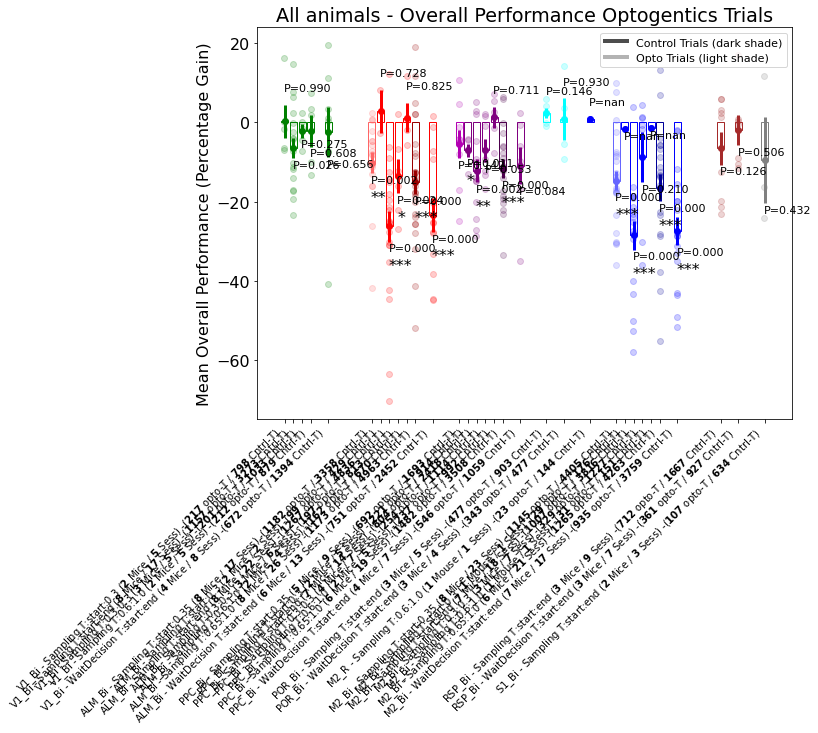

TTTest Early bailout Decision Time V1_Bi - Sampling None
TTTest Skipping test for Decision Time V1_Bi Sampling Avgat3
Decision Time V1_Bi Sampling None - Len: 5
	Across Animals (Sample size: 2) - p-value: 0.6138748448930138
	Across Sessions (Sample size: 5) - p-value: 0.8002288623210778
TTTest Skipping test for Decision Time V1_Bi Sampling BVAGT4
Decision Time V1_Bi Sampling None - Len: 10
	Across Animals (Sample size: 5) - p-value: 0.27163869443731264
	Across Sessions (Sample size: 10) - p-value: 0.3054240988490929
TTTest Early bailout Decision Time V1_Bi - Sampling None
TTTest Skipping test for Decision Time V1_Bi Sampling Avgat2
Decision Time V1_Bi Sampling None - Len: 5
	Across Animals (Sample size: 2) - p-value: 0.6071582202395813
	Across Sessions (Sample size: 5) - p-value: 0.37037292309146586
Decision Time V1_Bi WaitDecision None - Len: 4
	Across Animals (Sample size: 2) - p-value: 0.08888596394924783
	Across Sessions (Sample size: 4) - p-value: 0.31846912470412053
TTTest Early 

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Decision Time ALM_Bi Sampling None - Len: 19
	Across Animals (Sample size: 8) - p-value: 0.004972885656697759
	Across Sessions (Sample size: 19) - p-value: 0.0006809439412530861
TTTest Skipping test for Decision Time ALM_Bi WaitDecision BVGAT2
Decision Time ALM_Bi WaitDecision None - Len: 8
	Across Animals (Sample size: 4) - p-value: 0.17025480957760245
	Across Sessions (Sample size: 8) - p-value: 0.03214573355331658
TTTest Skipping test for Decision Time PPC_Bi Sampling Avgat1
TTTest Skipping test for Decision Time PPC_Bi Sampling BVGAT1
TTTest Skipping test for Decision Time PPC_Bi Sampling vgat2.4
TTTest Skipping test for Decision Time PPC_Bi Sampling vgat2.5
Decision Time PPC_Bi Sampling None - Len: 6
	Across Animals (Sample size: 2) - p-value: 0.3956825923754647
	Across Sessions (Sample size: 6) - p-value: 0.2361621337560969
TTTest Skipping test for Decision Time PPC_Bi Sampling Avgat2
TTTest Skipping test for Decision Time PPC_Bi Sampling BVGAT3
Decision Time PPC_Bi Sampling None

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Decision Time POR_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 2) - p-value: 0.33775553487028004
	Across Sessions (Sample size: 2) - p-value: 0.33775553487028004
TTTest Early bailout Decision Time M2_R - Sampling None
TTTest Skipping test for Decision Time M2_R Sampling Avgat4
Decision Time M2_R Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Decision Time M2_Bi - Sampling None
TTTest Skipping test for Decision Time M2_Bi Sampling BVGAT3
Decision Time M2_Bi Sampling None - Len: 16
	Across Animals (Sample size: 7) - p-value: 0.8522025439521219
	Across Sessions (Sample size: 16) - p-value: 0.7120340458710577
TTTest Skipping test for Decision Time M2_Bi Sampling Avgat1
TTTest Skipping test for Decision Time M2_Bi Sampling Avgat2
TTTest Skipping test for Decision Time M2_Bi Sampling Avgat3
Decision Time M2_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


TTTest Skipping test for Decision Time M2_Bi Sampling BVGAT1
TTTest Skipping test for Decision Time M2_Bi Sampling BVGAT2
TTTest Skipping test for Decision Time M2_Bi Sampling BVGAT3
Decision Time M2_Bi Sampling None - Len: 11
	Across Animals (Sample size: 3) - p-value: 0.3091396305484766
	Across Sessions (Sample size: 11) - p-value: 0.06627808397916309
Skipping partial sampling: (<MatrixState.stimulus_delivery: 8>, 0.35, 1.0) with: 259 trials.
TTTest Early bailout Decision Time M2_Bi - Sampling None
TTTest Skipping test for Decision Time M2_Bi Sampling Avgat2
TTTest Skipping test for Decision Time M2_Bi Sampling Avgat4
Decision Time M2_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Skipping test for Decision Time M2_Bi Sampling BVGAT1
TTTest Skipping test for Decision Time M2_Bi Sampling BVGAT3
Decision Time M2_Bi Sampling None - Len: 13
	Across Animals (Sample size: 5) - p-value: 0.04280283250738231
	Across Sessions (Sample size: 13) - p-value: 0.00

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


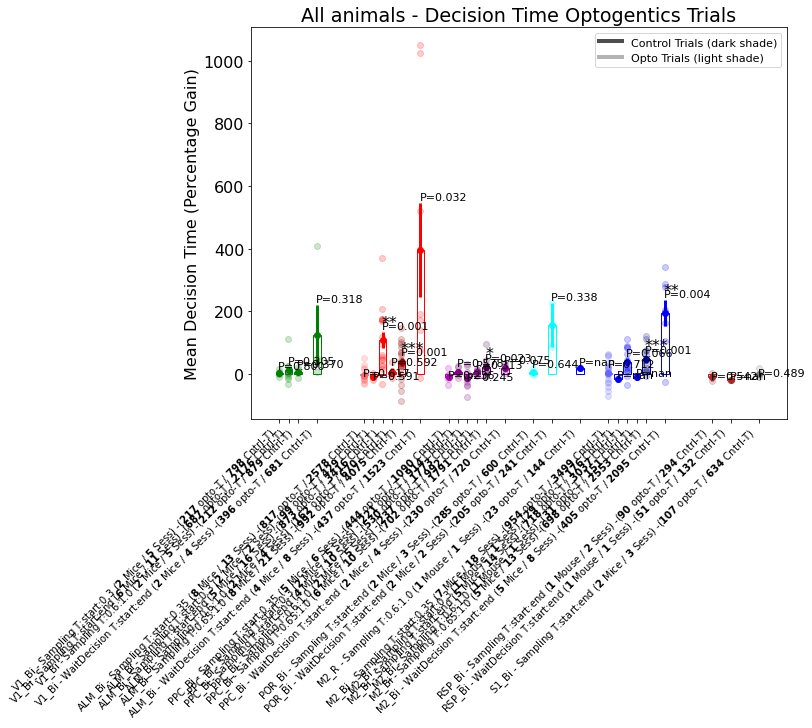

TTTest Early bailout Reaction Time V1_Bi - Sampling None
TTTest Skipping test for Reaction Time V1_Bi Sampling Avgat2
TTTest Skipping test for Reaction Time V1_Bi Sampling Avgat4
Reaction Time V1_Bi Sampling None - Len: 6
	Across Animals (Sample size: 2) - p-value: nan
	Across Sessions (Sample size: 6) - p-value: nan
TTTest Skipping test for Reaction Time V1_Bi Sampling Avgat2
TTTest Skipping test for Reaction Time V1_Bi Sampling Avgat3
Reaction Time V1_Bi Sampling None - Len: 5
	Across Animals (Sample size: 2) - p-value: 0.32520973744280124
	Across Sessions (Sample size: 5) - p-value: 0.012549574624690314
TTTest Skipping test for Reaction Time V1_Bi WaitDecision vgat2.1
Reaction Time V1_Bi WaitDecision None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: nan
TTTest Early bailout Reaction Time ALM_R - Sampling None
TTTest Skipping test for Reaction Time ALM_Bi Sampling BVGAT3
Reaction Time ALM_Bi Sampling None - Len: 4
	Across Anima

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


TTTest Skipping test for Reaction Time ALM_Bi Sampling BVGAT1
Reaction Time ALM_Bi Sampling None - Len: 5
	Across Animals (Sample size: 2) - p-value: nan
	Across Sessions (Sample size: 5) - p-value: 0.37390096630005853
TTTest Skipping test for Reaction Time ALM_Bi Sampling Avgat2
Reaction Time ALM_Bi Sampling None - Len: 6
	Across Animals (Sample size: 2) - p-value: 0.3001725536666986
	Across Sessions (Sample size: 6) - p-value: 0.19369000618724194
TTTest Skipping test for Reaction Time ALM_Bi Sampling BVGAT1
Reaction Time ALM_Bi Sampling None - Len: 4
	Across Animals (Sample size: 2) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: nan
Reaction Time ALM_Bi WaitDecision None - Len: 5
	Across Animals (Sample size: 2) - p-value: nan
	Across Sessions (Sample size: 5) - p-value: nan
Reaction Time PPC_Bi Sampling None - Len: 3
	Across Animals (Sample size: 2) - p-value: 0.49999999999999956
	Across Sessions (Sample size: 3) - p-value: 0.42264973081037427
TTTest Skipping test for R

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Reaction Time POR_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: nan
TTTest Skipping test for Reaction Time M2_Bi Sampling vgat2.6
Reaction Time M2_Bi Sampling None - Len: 5
	Across Animals (Sample size: 2) - p-value: 0.49999999999999956
	Across Sessions (Sample size: 5) - p-value: 0.373900966300059
TTTest Skipping test for Reaction Time M2_Bi Sampling BVGAT3
TTTest Skipping test for Reaction Time M2_Bi Sampling vgat2.6
Reaction Time M2_Bi Sampling None - Len: 3
	Across Animals (Sample size: 2) - p-value: 0.49999999999999956
	Across Sessions (Sample size: 3) - p-value: 0.42264973081037427
TTTest Skipping test for Reaction Time M2_Bi Sampling Avgat4
Reaction Time M2_Bi Sampling None - Len: 7
	Across Animals (Sample size: 3) - p-value: 0.2853296501364723
	Across Sessions (Sample size: 7) - p-value: 0.156040025361837
TTTest Skipping test for Reaction Time M2_Bi Sampling BVGAT3
Reaction Time M2_Bi Sampling None - L

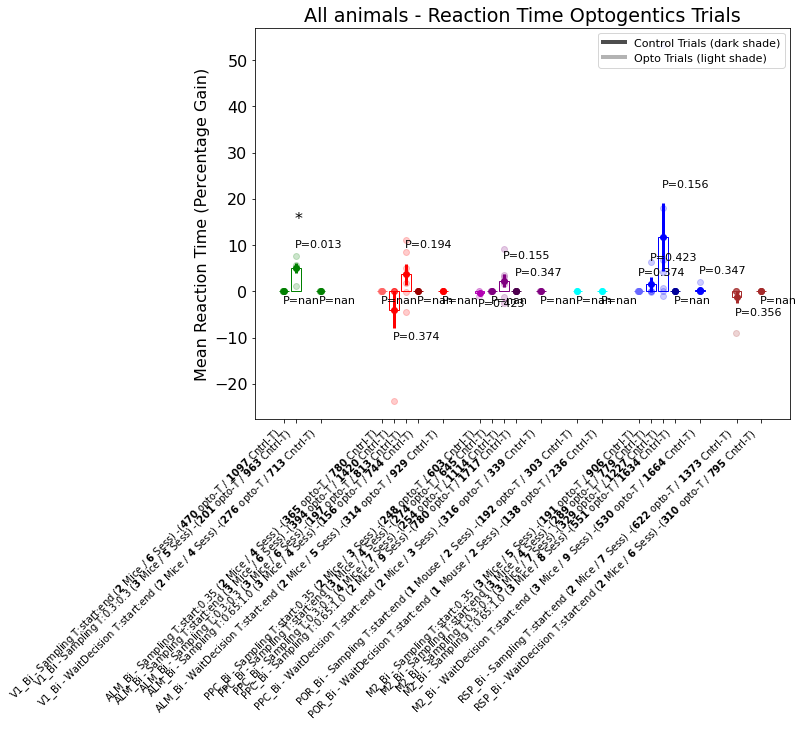

TTTest Early bailout Early-Withdrawal V1_Bi - Sampling None
TTTest Skipping test for Early-Withdrawal V1_Bi Sampling Avgat3
Early-Withdrawal V1_Bi Sampling None - Len: 5
	Across Animals (Sample size: 2) - p-value: 0.12219183770723037
	Across Sessions (Sample size: 5) - p-value: 0.6942460991290408
TTTest Skipping test for Early-Withdrawal V1_Bi Sampling Avgat2
TTTest Skipping test for Early-Withdrawal V1_Bi Sampling Avgat4
TTTest Skipping test for Early-Withdrawal V1_Bi Sampling BVAGT4
Early-Withdrawal V1_Bi Sampling None - Len: 17
	Across Animals (Sample size: 7) - p-value: 0.4616121463270856
	Across Sessions (Sample size: 17) - p-value: 0.8825598616683697
TTTest Skipping test for Early-Withdrawal V1_Bi Sampling Avgat2
TTTest Skipping test for Early-Withdrawal V1_Bi Sampling Avgat3
Early-Withdrawal V1_Bi Sampling None - Len: 5
	Across Animals (Sample size: 2) - p-value: 0.4609809945621473
	Across Sessions (Sample size: 5) - p-value: 0.49108166272409015
TTTest Skipping test for Early-Wi

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Early-Withdrawal ALM_Bi Sampling None - Len: 26
	Across Animals (Sample size: 8) - p-value: 0.9099514680278842
	Across Sessions (Sample size: 26) - p-value: 0.4492810204652514
TTTest Skipping test for Early-Withdrawal ALM_Bi WaitDecision BVGAT2
Early-Withdrawal ALM_Bi WaitDecision None - Len: 13
	Across Animals (Sample size: 6) - p-value: 0.7124112367139037
	Across Sessions (Sample size: 13) - p-value: 0.24088443989746017
TTTest Skipping test for Early-Withdrawal PPC_Bi Sampling Avgat1
TTTest Skipping test for Early-Withdrawal PPC_Bi Sampling BVGAT1
Early-Withdrawal PPC_Bi Sampling None - Len: 9
	Across Animals (Sample size: 4) - p-value: 0.18711829580396352
	Across Sessions (Sample size: 9) - p-value: 0.16259342293416829
TTTest Skipping test for Early-Withdrawal PPC_Bi Sampling Avgat2
TTTest Skipping test for Early-Withdrawal PPC_Bi Sampling BVGAT3
Early-Withdrawal PPC_Bi Sampling None - Len: 5
	Across Animals (Sample size: 2) - p-value: 0.9308282096066227
	Across Sessions (Sample siz

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Early-Withdrawal M2_Bi Sampling None - Len: 23
	Across Animals (Sample size: 8) - p-value: 0.023150080957402213
	Across Sessions (Sample size: 23) - p-value: 0.0008221214998817449
TTTest Skipping test for Early-Withdrawal M2_Bi Sampling Avgat1
TTTest Skipping test for Early-Withdrawal M2_Bi Sampling Avgat2
TTTest Skipping test for Early-Withdrawal M2_Bi Sampling Avgat3
Early-Withdrawal M2_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Skipping test for Early-Withdrawal M2_Bi Sampling BVGAT1
Early-Withdrawal M2_Bi Sampling None - Len: 18
	Across Animals (Sample size: 7) - p-value: 0.06203809322182187
	Across Sessions (Sample size: 18) - p-value: 0.0005957682574494203


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


TTTest Skipping test for Early-Withdrawal M2_Bi Sampling Avgat4
Early-Withdrawal M2_Bi Sampling None - Len: 7
	Across Animals (Sample size: 3) - p-value: 0.8334227293976009
	Across Sessions (Sample size: 7) - p-value: 0.8285069362021908
Skipping partial sampling: (<MatrixState.stimulus_delivery: 8>, 0.35, 1.0) with: 259 trials.
TTTest Early bailout Early-Withdrawal M2_Bi - Sampling None
TTTest Skipping test for Early-Withdrawal M2_Bi Sampling Avgat2
TTTest Skipping test for Early-Withdrawal M2_Bi Sampling Avgat4
Early-Withdrawal M2_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Skipping test for Early-Withdrawal M2_Bi Sampling BVGAT1
Early-Withdrawal M2_Bi Sampling None - Len: 21
	Across Animals (Sample size: 6) - p-value: 0.013803330465549348
	Across Sessions (Sample size: 21) - p-value: 0.0026402207848696194
Skipping partial sampling: (<MatrixState.stimulus_delivery: 8>, 0.85, 1.0) with: 720 trials.
Early-Withdrawal M2_Bi WaitDecision None - Len: 17

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


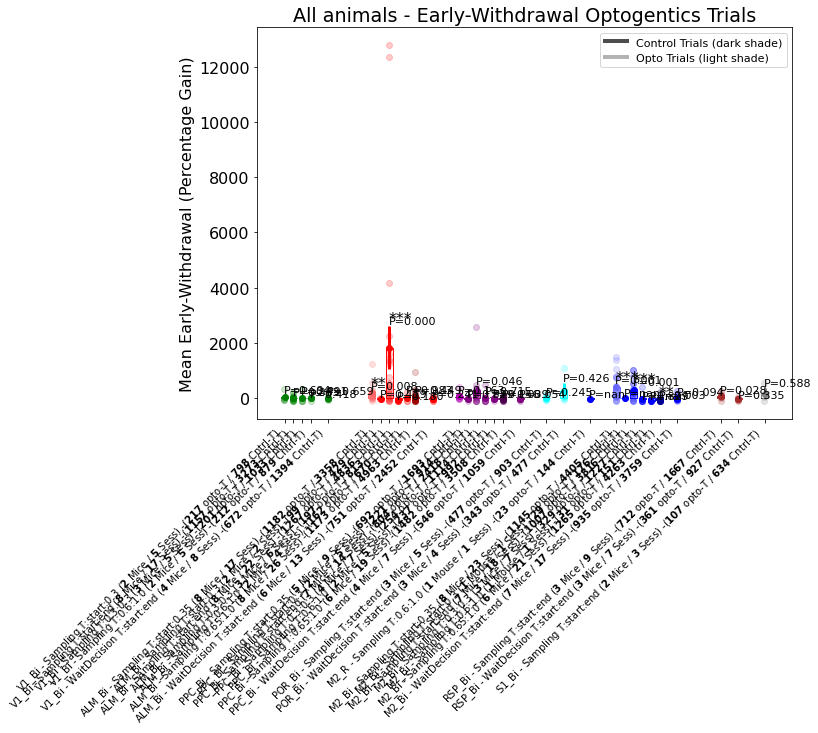

TTTest Early bailout Movement Time V1_Bi - Sampling None
TTTest Skipping test for Movement Time V1_Bi Sampling Avgat3
Movement Time V1_Bi Sampling None - Len: 5
	Across Animals (Sample size: 2) - p-value: 0.6232635890173446
	Across Sessions (Sample size: 5) - p-value: 0.08916527113147298
TTTest Skipping test for Movement Time V1_Bi Sampling BVAGT4
Movement Time V1_Bi Sampling None - Len: 16
	Across Animals (Sample size: 7) - p-value: 0.4157767991353177
	Across Sessions (Sample size: 16) - p-value: 0.07688044287692698
TTTest Early bailout Movement Time V1_Bi - Sampling None


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\lib\nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


TTTest Skipping test for Movement Time V1_Bi Sampling Avgat2
Movement Time V1_Bi Sampling None - Len: 5
	Across Animals (Sample size: 2) - p-value: 0.6411064943288458
	Across Sessions (Sample size: 5) - p-value: 0.7704316006172311
TTTest Skipping test for Movement Time V1_Bi WaitDecision vgat2.1
Movement Time V1_Bi WaitDecision None - Len: 8
	Across Animals (Sample size: 3) - p-value: 0.44476575740519664
	Across Sessions (Sample size: 8) - p-value: 0.5381163605594133
TTTest Early bailout Movement Time ALM_R - Sampling None
TTTest Early bailout Movement Time ALM_R - Sampling None
TTTest Skipping test for Movement Time ALM_Bi Sampling Avgat1
TTTest Skipping test for Movement Time ALM_Bi Sampling BVGAT1
TTTest Skipping test for Movement Time ALM_Bi Sampling BVGAT3
TTTest Skipping test for Movement Time ALM_Bi Sampling vgat2.1
Movement Time ALM_Bi Sampling None - Len: 17
	Across Animals (Sample size: 5) - p-value: 0.4036345381998116
	Across Sessions (Sample size: 17) - p-value: 0.194131366

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\lib\nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Skipping partial sampling: (<MatrixState.stimulus_delivery: 8>, 0.35, 1.0) with: 181 trials.
TTTest Skipping test for Movement Time ALM_Bi Sampling Avgat1
TTTest Skipping test for Movement Time ALM_Bi Sampling Avgat2
Movement Time ALM_Bi Sampling None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: 0.7228229223584886
Movement Time ALM_Bi Sampling None - Len: 23
	Across Animals (Sample size: 8) - p-value: 0.20091480066409034
	Across Sessions (Sample size: 23) - p-value: 0.21198217706585895
TTTest Skipping test for Movement Time ALM_Bi WaitDecision BVGAT2
Movement Time ALM_Bi WaitDecision None - Len: 13
	Across Animals (Sample size: 6) - p-value: 0.014212816326079866
	Across Sessions (Sample size: 13) - p-value: 0.0007848408331416313
TTTest Skipping test for Movement Time PPC_Bi Sampling Avgat1
TTTest Skipping test for Movement Time PPC_Bi Sampling BVGAT1
TTTest Skipping test for Movement Time PPC_Bi Sampling vgat2.4
Movement Time PPC

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\lib\nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


TTTest Skipping test for Movement Time PPC_Bi Sampling vgat2.5
Movement Time PPC_Bi Sampling None - Len: 5
	Across Animals (Sample size: 2) - p-value: 0.3345671677919628
	Across Sessions (Sample size: 5) - p-value: 0.2338966291938483
TTTest Skipping test for Movement Time PPC_Bi Sampling BVGAT1
TTTest Skipping test for Movement Time PPC_Bi Sampling BVGAT3
Movement Time PPC_Bi Sampling None - Len: 19
	Across Animals (Sample size: 4) - p-value: 0.3206761475494376
	Across Sessions (Sample size: 19) - p-value: 0.12106437308954694
TTTest Skipping test for Movement Time PPC_Bi WaitDecision vgat2.6
Movement Time PPC_Bi WaitDecision None - Len: 6
	Across Animals (Sample size: 3) - p-value: 0.29847149614185786
	Across Sessions (Sample size: 6) - p-value: 0.16585854408768153
Movement Time POR_Bi Sampling None - Len: 5
	Across Animals (Sample size: 3) - p-value: 0.20497715448302237
	Across Sessions (Sample size: 5) - p-value: 0.05860931208922458
Movement Time POR_Bi WaitDecision None - Len: 4
	Ac

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Movement Time M2_Bi Sampling None - Len: 14
	Across Animals (Sample size: 5) - p-value: 0.007983073419201125
	Across Sessions (Sample size: 14) - p-value: 3.1658777472434625e-05
TTTest Early bailout Movement Time M2_Bi - Sampling None
Skipping partial sampling: (<MatrixState.stimulus_delivery: 8>, 0.35, 1.0) with: 259 trials.


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\lib\nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


TTTest Early bailout Movement Time M2_Bi - Sampling None
TTTest Skipping test for Movement Time M2_Bi Sampling Avgat2
TTTest Skipping test for Movement Time M2_Bi Sampling Avgat4
Movement Time M2_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Skipping test for Movement Time M2_Bi Sampling BVGAT1
Movement Time M2_Bi Sampling None - Len: 21
	Across Animals (Sample size: 6) - p-value: 0.02111170241695638
	Across Sessions (Sample size: 21) - p-value: 0.9063946961239299
Skipping partial sampling: (<MatrixState.stimulus_delivery: 8>, 0.85, 1.0) with: 720 trials.
TTTest Skipping test for Movement Time M2_Bi WaitDecision BVGAT1
Movement Time M2_Bi WaitDecision None - Len: 16
	Across Animals (Sample size: 6) - p-value: 0.022136999603055978
	Across Sessions (Sample size: 16) - p-value: 0.0002027136315323438
TTTest Early bailout Movement Time RSP_L - Sampling None
Movement Time RSP_Bi Sampling None - Len: 8
	Across Animals (Sample size: 3) - p-value: 0.599676536

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


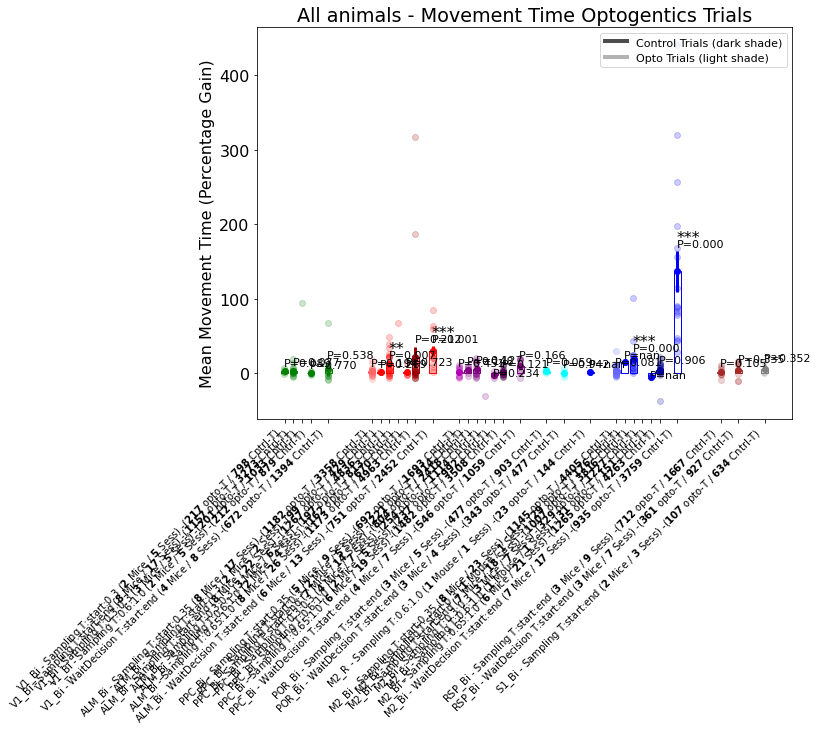

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Overall Performance V1_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.7416759252495833
Overall Performance V1_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.765332952674201
Overall Performance V1_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.11943412125788473
TTTest Skipping test for Overall Performance ALM_Bi Sampling Avgat1
Overall Performance ALM_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Overall Performance ALM_Bi - Sampling None
Overall Performance ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.13171394795401567


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


TTTest Skipping test for Overall Performance ALM_Bi Sampling Avgat1
Overall Performance ALM_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Overall Performance ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.2189868356294268
TTTest Early bailout Overall Performance PPC_Bi - Sampling None
Overall Performance PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.13507794875635082
TTTest Skipping test for Overall Performance PPC_Bi Sampling Avgat1
Overall Performance PPC_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Overall Performance PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.6130069169636444
Overall Performance PPC_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions 

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


TTTest Early bailout Overall Performance M2_R - Sampling None
Overall Performance M2_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Overall Performance M2_Bi - Sampling None
Overall Performance M2_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.49295382025211243


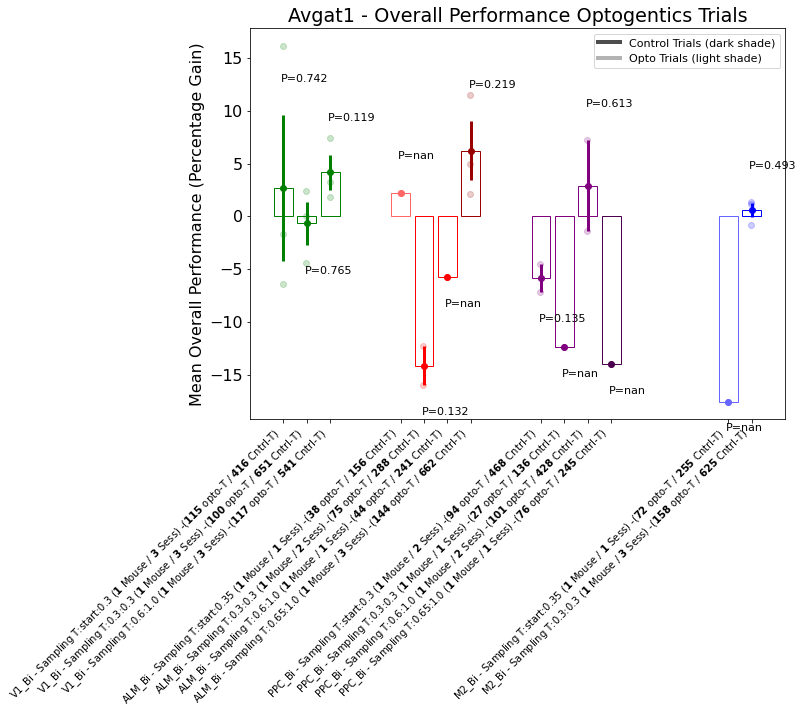

Decision Time V1_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.8860890526382245
TTTest Early bailout Decision Time V1_Bi - Sampling None
Decision Time V1_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.6750225189963014
TTTest Skipping test for Decision Time ALM_Bi Sampling Avgat1
Decision Time ALM_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Decision Time ALM_Bi - Sampling None
TTTest Skipping test for Decision Time ALM_Bi Sampling Avgat1
Decision Time ALM_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Decision Time ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.7569812319923848
TTTest Early bailout Decision Time PPC_Bi - Sampling None


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Decision Time PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.9422841232473869
Decision Time PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.9300248953789048
Decision Time PPC_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Decision Time M2_R - Sampling None
Decision Time M2_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Decision Time M2_Bi - Sampling None


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


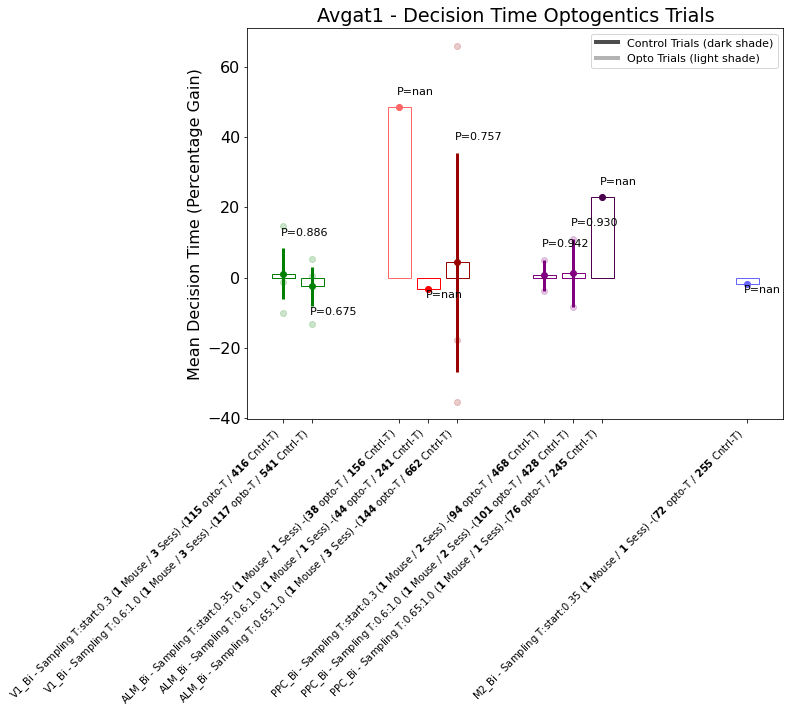

Reaction Time V1_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.1547370549668388
Reaction Time ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.24317546685192606
TTTest Skipping test for Reaction Time PPC_Bi Sampling Avgat1
Reaction Time PPC_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Reaction Time M2_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.4662468693549954


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C

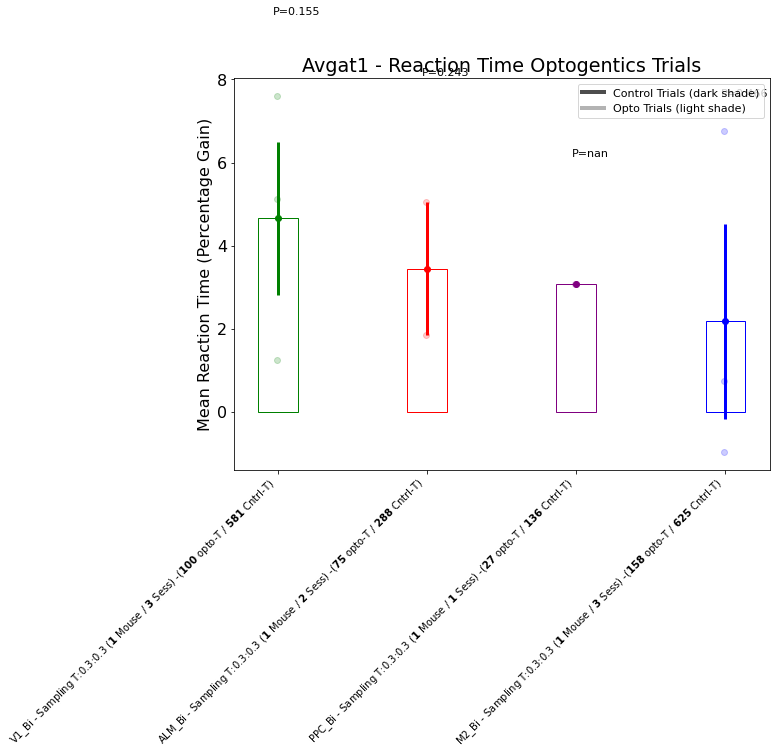

Early-Withdrawal V1_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.9271525711260606
Early-Withdrawal V1_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.43987542347528064
Early-Withdrawal V1_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.4382337507639149
TTTest Skipping test for Early-Withdrawal ALM_Bi Sampling Avgat1
Early-Withdrawal ALM_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Early-Withdrawal ALM_Bi - Sampling None
Early-Withdrawal ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.49999999999999956


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


TTTest Skipping test for Early-Withdrawal ALM_Bi Sampling Avgat1
Early-Withdrawal ALM_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Early-Withdrawal ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.7590186192337567
TTTest Early bailout Early-Withdrawal PPC_Bi - Sampling None
Early-Withdrawal PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.6269020697222143
TTTest Skipping test for Early-Withdrawal PPC_Bi Sampling Avgat1
Early-Withdrawal PPC_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Early-Withdrawal PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.201396222973042
Early-Withdrawal PPC_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: n

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


TTTest Early bailout Early-Withdrawal M2_R - Sampling None
Early-Withdrawal M2_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Early-Withdrawal M2_Bi - Sampling None
Early-Withdrawal M2_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.13663386847664738


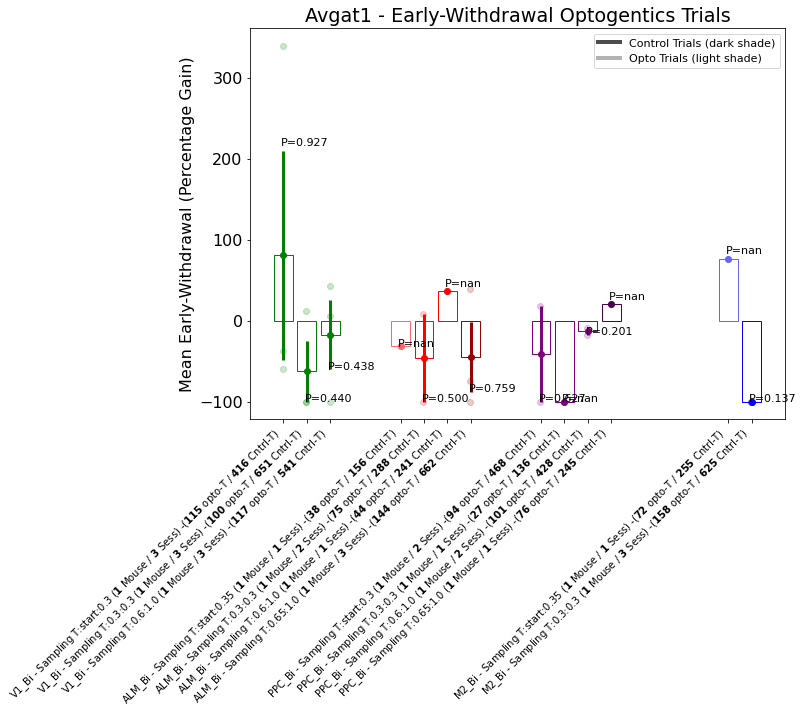

Movement Time V1_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.1217439797811749
TTTest Early bailout Movement Time V1_Bi - Sampling None
Movement Time V1_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.5078252090520143
TTTest Skipping test for Movement Time ALM_Bi Sampling Avgat1
Movement Time ALM_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Movement Time ALM_Bi - Sampling None
TTTest Early bailout Movement Time ALM_Bi - Sampling None
TTTest Skipping test for Movement Time ALM_Bi Sampling Avgat1
Movement Time ALM_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Movement Time ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.8738521611006193


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\lib\nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\lib\nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis

TTTest Early bailout Movement Time PPC_Bi - Sampling None
Movement Time PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.13225346816743486
TTTest Early bailout Movement Time PPC_Bi - Sampling None
Movement Time PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.12425538743275612
Movement Time PPC_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Movement Time M2_R - Sampling None
Movement Time M2_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Movement Time M2_Bi - Sampling None


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\lib\nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\lib\nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis

TTTest Early bailout Movement Time M2_Bi - Sampling None


posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


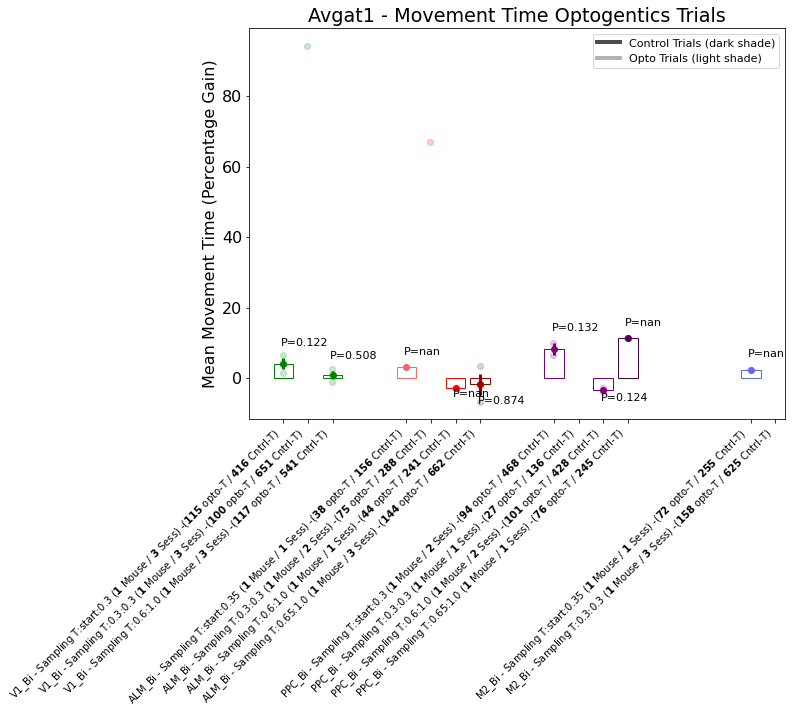

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


TTTest Early bailout Overall Performance V1_Bi - Sampling None
TTTest Skipping test for Overall Performance V1_Bi Sampling Avgat2
Overall Performance V1_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Overall Performance V1_Bi - Sampling None
Overall Performance ALM_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Skipping test for Overall Performance ALM_Bi Sampling Avgat2
Overall Performance ALM_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Overall Performance ALM_Bi - Sampling None
TTTest Early bailout Overall Performance PPC_Bi - Sampling None
Overall Performance PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.5755542982264084
TTTest Skipping test for Overall Performance M2_Bi Sampling Avgat2


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Overall Performance M2_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Overall Performance M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.0634651046826227
TTTest Early bailout Overall Performance M2_Bi - Sampling None


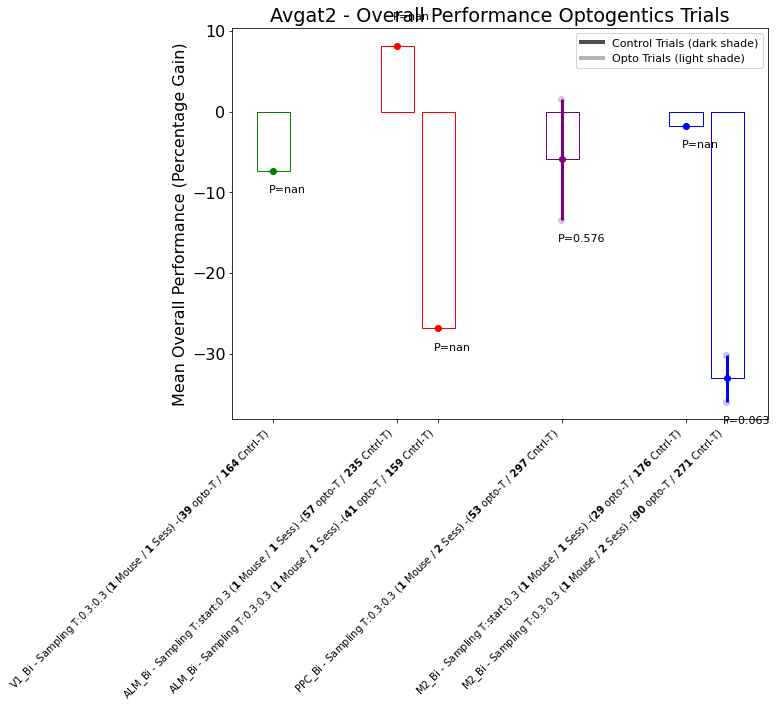

TTTest Early bailout Decision Time V1_Bi - Sampling None
TTTest Early bailout Decision Time V1_Bi - Sampling None
Decision Time ALM_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Decision Time ALM_Bi - Sampling None
TTTest Early bailout Decision Time PPC_Bi - Sampling None
TTTest Skipping test for Decision Time M2_Bi Sampling Avgat2
Decision Time M2_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Decision Time M2_Bi - Sampling None


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


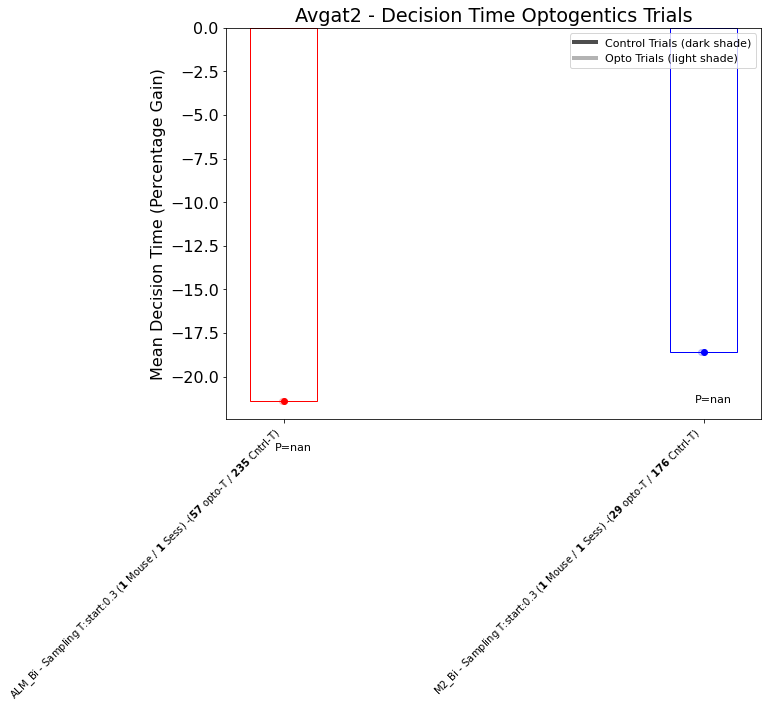

TTTest Early bailout Reaction Time V1_Bi - Sampling None
TTTest Skipping test for Reaction Time V1_Bi Sampling Avgat2
Reaction Time V1_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Skipping test for Reaction Time ALM_Bi Sampling Avgat2
Reaction Time ALM_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Reaction Time PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.932963855486649
Reaction Time M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.271631545271422


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C

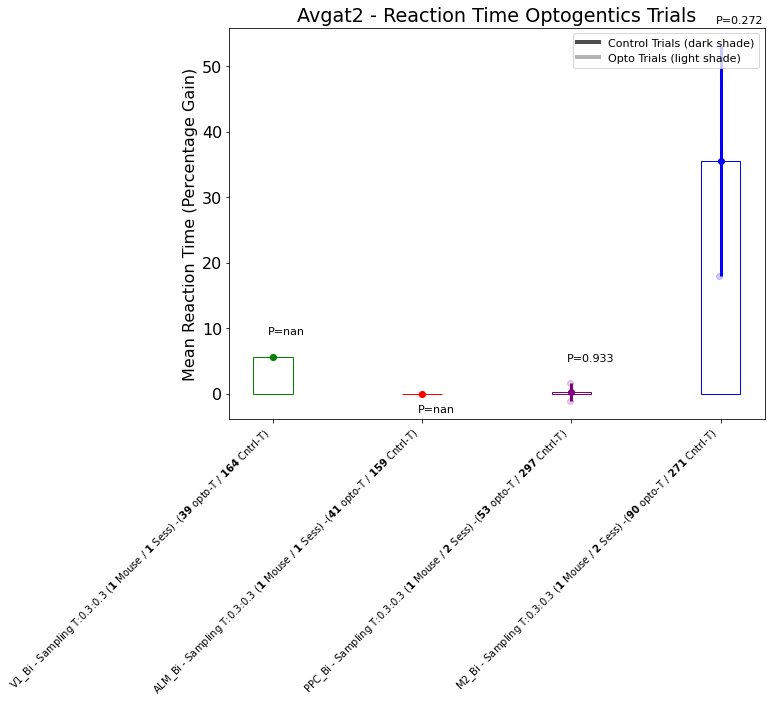

TTTest Early bailout Early-Withdrawal V1_Bi - Sampling None
TTTest Skipping test for Early-Withdrawal V1_Bi Sampling Avgat2
Early-Withdrawal V1_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Early-Withdrawal V1_Bi - Sampling None
Early-Withdrawal ALM_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Skipping test for Early-Withdrawal ALM_Bi Sampling Avgat2
Early-Withdrawal ALM_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Early-Withdrawal ALM_Bi - Sampling None
TTTest Early bailout Early-Withdrawal PPC_Bi - Sampling None
Early-Withdrawal PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.8814941267930952
TTTest Skipping test for Early-Withdrawal M2_Bi Sampling Avgat2
Early-Withdrawal M2_Bi Sampling None - Len: 1
	Across Sessions (Sample 

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C

Early-Withdrawal M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: nan
TTTest Early bailout Early-Withdrawal M2_Bi - Sampling None


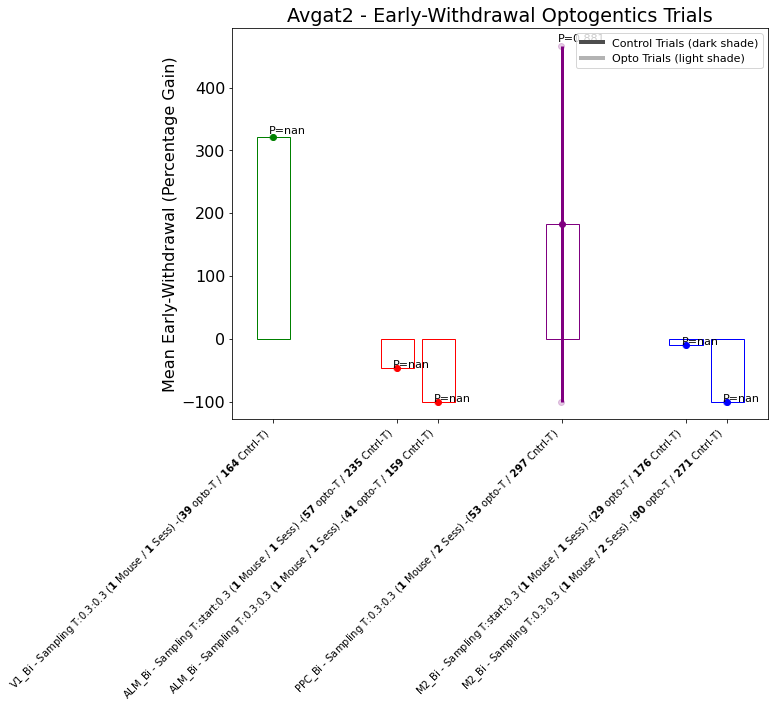

TTTest Early bailout Movement Time V1_Bi - Sampling None
TTTest Early bailout Movement Time V1_Bi - Sampling None
TTTest Early bailout Movement Time V1_Bi - Sampling None
Movement Time ALM_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Movement Time ALM_Bi - Sampling None
TTTest Early bailout Movement Time ALM_Bi - Sampling None
TTTest Early bailout Movement Time PPC_Bi - Sampling None
TTTest Early bailout Movement Time PPC_Bi - Sampling None
TTTest Skipping test for Movement Time M2_Bi Sampling Avgat2
Movement Time M2_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Movement Time M2_Bi - Sampling None
TTTest Early bailout Movement Time M2_Bi - Sampling None


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\lib\nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\lib\nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\lib\nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freed

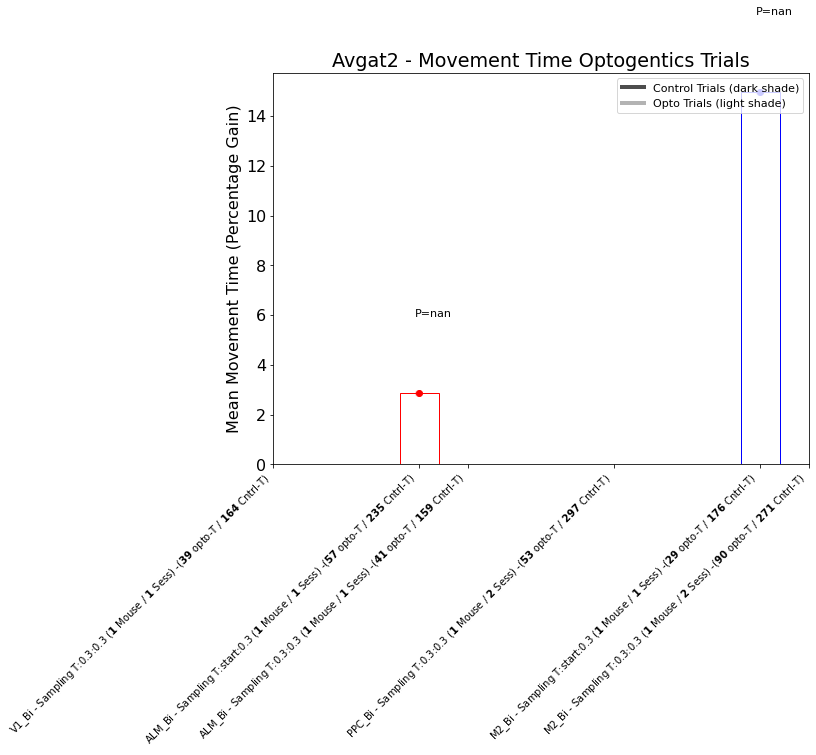

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


TTTest Early bailout Overall Performance V1_Bi - Sampling None
TTTest Early bailout Overall Performance V1_Bi - Sampling None
Overall Performance PPC_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Overall Performance M2_Bi - Sampling None
TTTest Early bailout Overall Performance M2_Bi - Sampling None
Overall Performance M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.7521867768022078


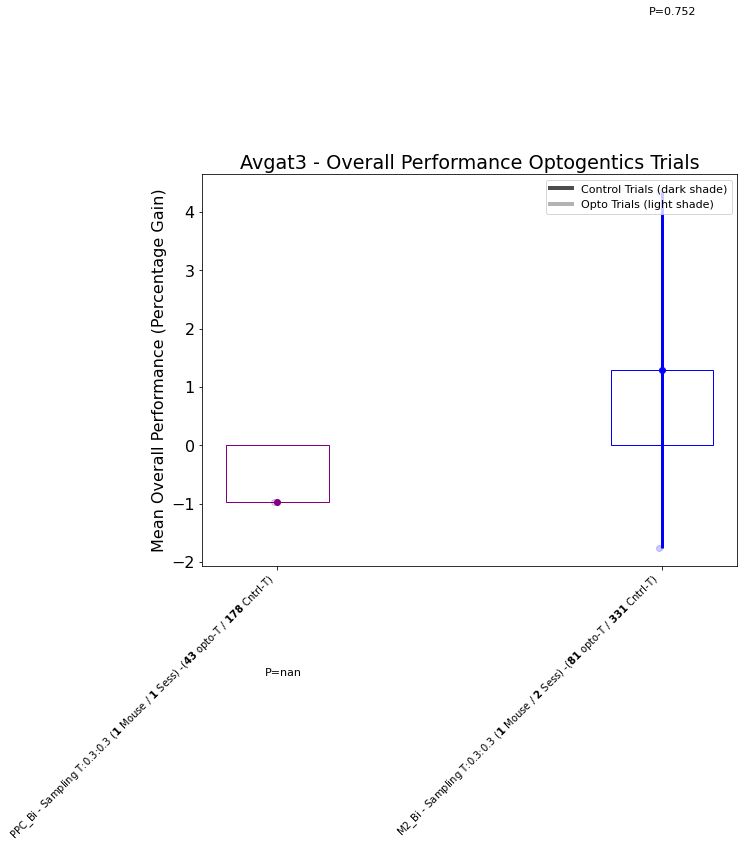

TTTest Early bailout Decision Time V1_Bi - Sampling None
TTTest Early bailout Decision Time PPC_Bi - Sampling None
TTTest Early bailout Decision Time M2_Bi - Sampling None
TTTest Early bailout Decision Time M2_Bi - Sampling None


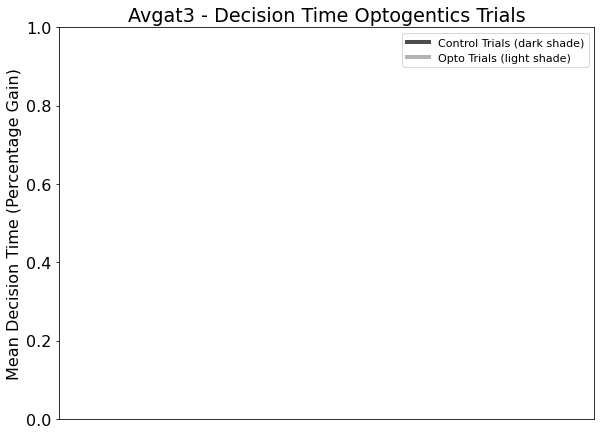

TTTest Early bailout Reaction Time V1_Bi - Sampling None
TTTest Early bailout Reaction Time V1_Bi - Sampling None
Reaction Time PPC_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Reaction Time M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.4984967683844432


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


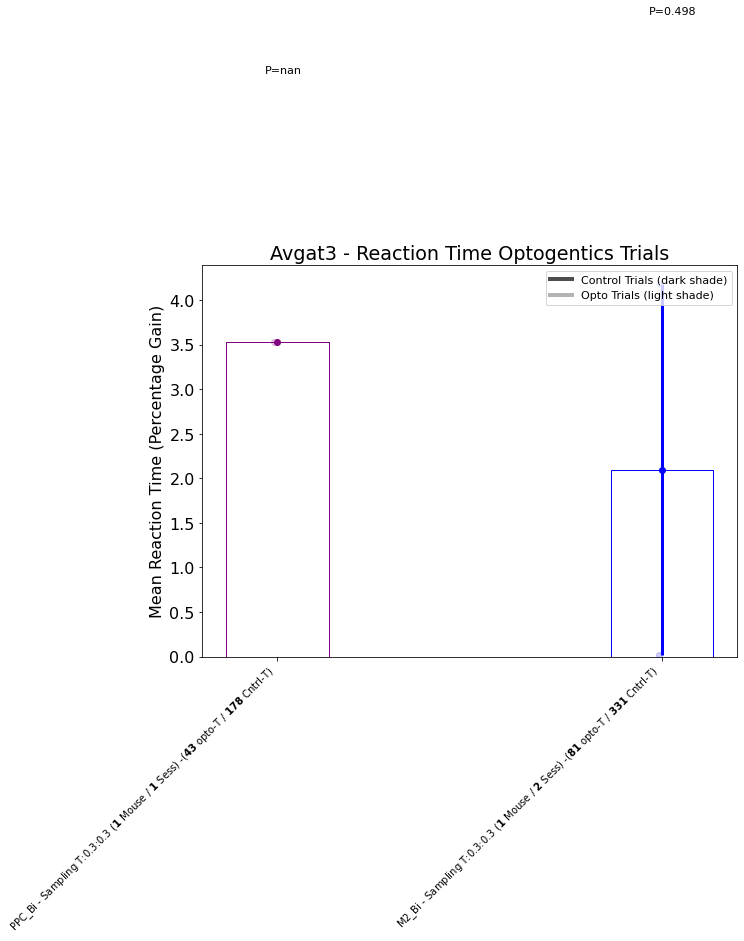

TTTest Early bailout Early-Withdrawal V1_Bi - Sampling None
TTTest Early bailout Early-Withdrawal V1_Bi - Sampling None
Early-Withdrawal PPC_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Early-Withdrawal M2_Bi - Sampling None
TTTest Early bailout Early-Withdrawal M2_Bi - Sampling None
Early-Withdrawal M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.49999999999999956


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


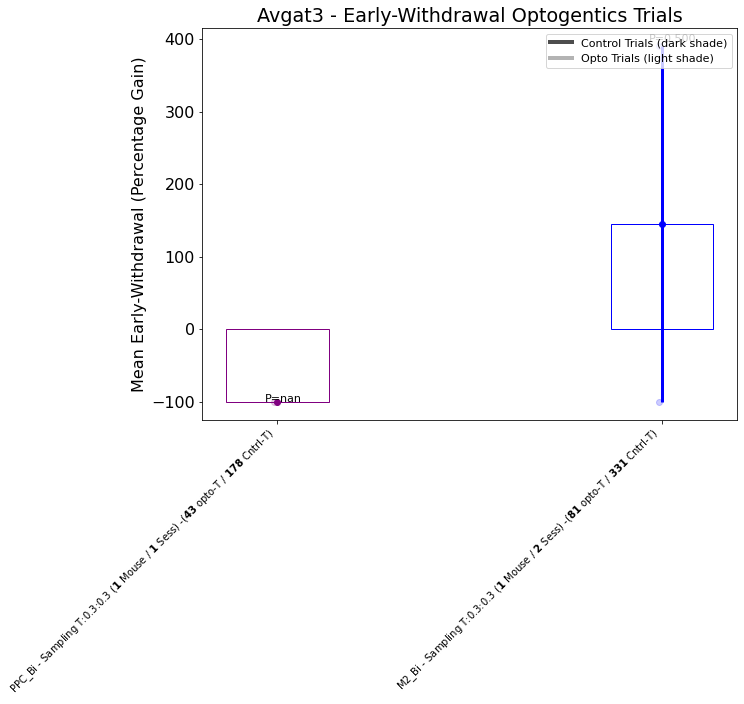

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\lib\nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\lib\nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
posx and posy should be finite values
posx and posy should be finite values


TTTest Early bailout Movement Time V1_Bi - Sampling None
TTTest Early bailout Movement Time V1_Bi - Sampling None
TTTest Early bailout Movement Time PPC_Bi - Sampling None
TTTest Early bailout Movement Time M2_Bi - Sampling None
TTTest Early bailout Movement Time M2_Bi - Sampling None
TTTest Early bailout Movement Time M2_Bi - Sampling None


posx and posy should be finite values
posx and posy should be finite values


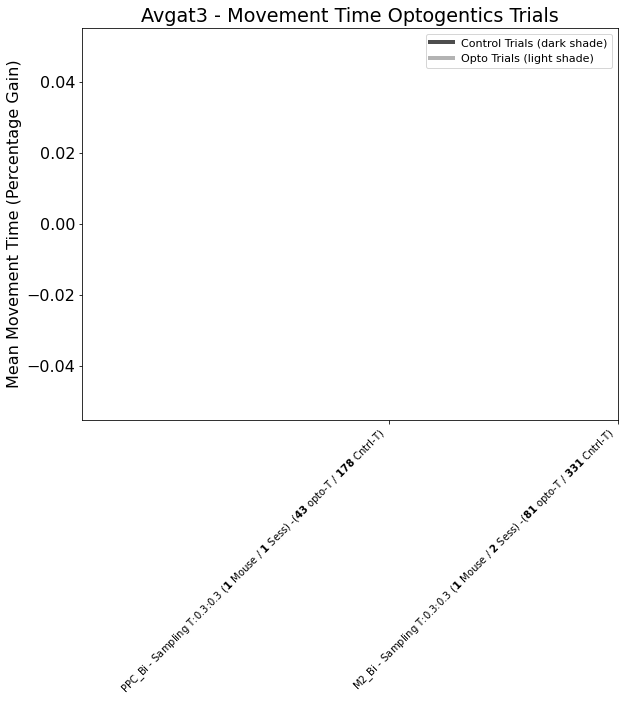

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Overall Performance V1_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.5035419420602403
TTTest Early bailout Overall Performance V1_Bi - Sampling None
Overall Performance V1_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Overall Performance V1_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.0862849009019883
TTTest Early bailout Overall Performance ALM_R - Sampling None
Overall Performance ALM_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Overall Performance ALM_Bi - Sampling None
Overall Performance ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.3382012308929614


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Overall Performance ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.49096078752853234
Overall Performance PPC_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.10473462191786256
Overall Performance PPC_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.27128581952580766
Overall Performance PPC_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.963572889499851
TTTest Skipping test for Overall Performance M2_R Sampling Avgat4


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Overall Performance M2_R Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Overall Performance M2_Bi - Sampling None
TTTest Skipping test for Overall Performance M2_Bi Sampling Avgat4
Overall Performance M2_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Overall Performance RSP_L - Sampling None


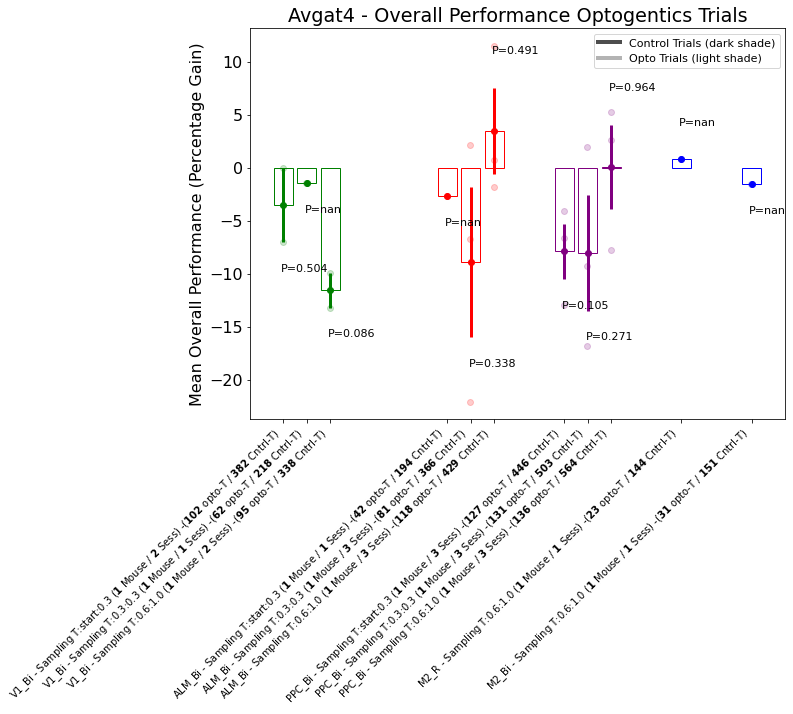

Decision Time V1_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.812525289932444
Decision Time V1_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.14494821439660305
Decision Time ALM_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Decision Time ALM_Bi - Sampling None
Decision Time ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.5841901808748174
Decision Time PPC_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.6332698362534354


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Decision Time PPC_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.3134671492490655
TTTest Skipping test for Decision Time M2_R Sampling Avgat4
Decision Time M2_R Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Skipping test for Decision Time M2_Bi Sampling Avgat4
Decision Time M2_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Decision Time RSP_L - Sampling None


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


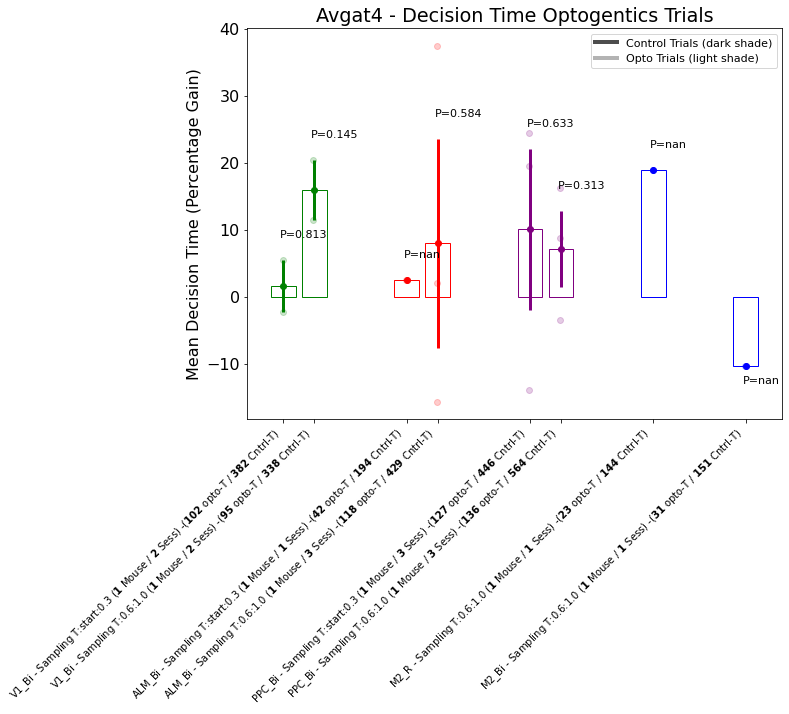

TTTest Early bailout Reaction Time V1_Bi - Sampling None
Reaction Time V1_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Reaction Time ALM_R - Sampling None
Reaction Time ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.3789005635764007
Reaction Time PPC_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.4445489656745608
TTTest Early bailout Reaction Time M2_Bi - Sampling None


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


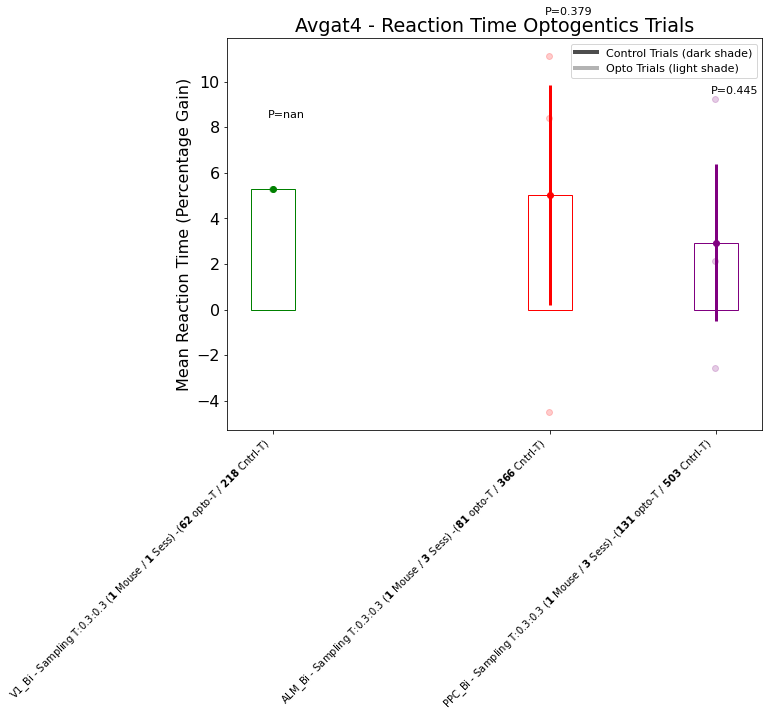

Early-Withdrawal V1_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.5249192993776575
TTTest Early bailout Early-Withdrawal V1_Bi - Sampling None
Early-Withdrawal V1_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Early-Withdrawal V1_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.6628184238077774
TTTest Early bailout Early-Withdrawal ALM_R - Sampling None
Early-Withdrawal ALM_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Early-Withdrawal ALM_Bi - Sampling None
Early-Withdrawal ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.31384100232730083


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Early-Withdrawal ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.7229946919304203
Early-Withdrawal PPC_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.6741244653633909
Early-Withdrawal PPC_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.5871631033561293
Early-Withdrawal PPC_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.37016252793739157
TTTest Skipping test for Early-Withdrawal M2_R Sampling Avgat4


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Early-Withdrawal M2_R Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Early-Withdrawal M2_Bi - Sampling None
TTTest Skipping test for Early-Withdrawal M2_Bi Sampling Avgat4
Early-Withdrawal M2_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Early-Withdrawal RSP_L - Sampling None


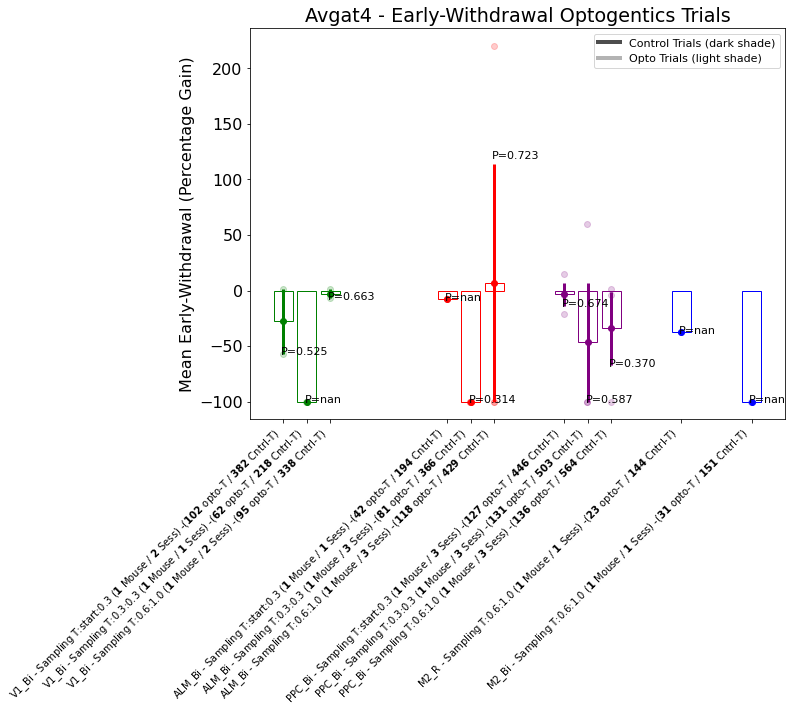

Movement Time V1_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.6488055305972353
TTTest Early bailout Movement Time V1_Bi - Sampling None
TTTest Early bailout Movement Time V1_Bi - Sampling None
Movement Time V1_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.6218652464740276
TTTest Early bailout Movement Time ALM_R - Sampling None
Movement Time ALM_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Movement Time ALM_Bi - Sampling None
TTTest Early bailout Movement Time ALM_Bi - Sampling None
Movement Time ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.6222625418571968


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\lib\nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\lib\nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis

Movement Time PPC_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.6384763377167122
TTTest Early bailout Movement Time PPC_Bi - Sampling None
Movement Time PPC_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.6525334047386175
TTTest Early bailout Movement Time M2_R - Sampling None
TTTest Early bailout Movement Time M2_Bi - Sampling None
TTTest Skipping test for Movement Time M2_Bi Sampling Avgat4
Movement Time M2_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Movement Time RSP_L - Sampling None


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\lib\nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return a

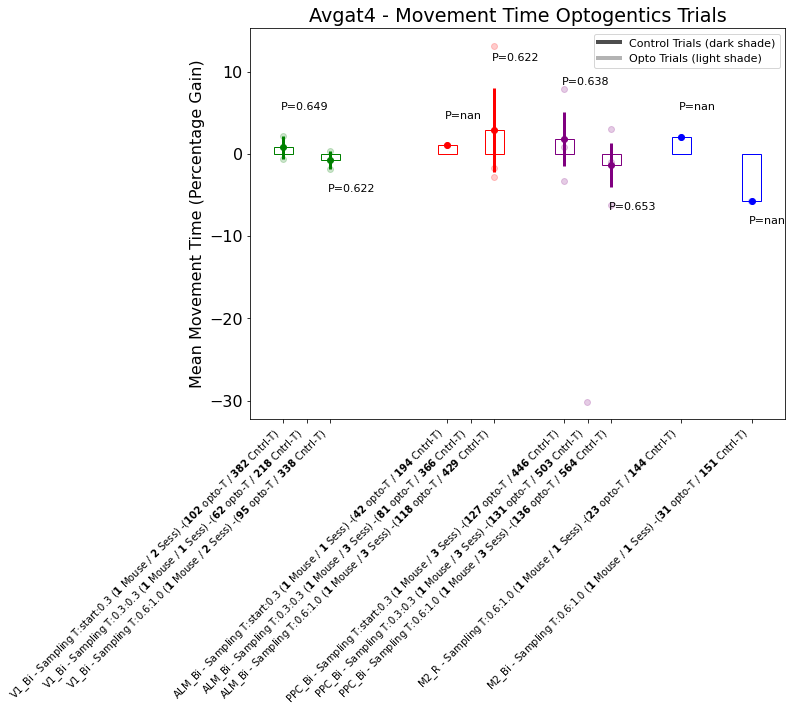

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


TTTest Skipping test for Overall Performance V1_Bi Sampling BVAGT4
Overall Performance V1_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Overall Performance ALM_R - Sampling None
Overall Performance ALM_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Overall Performance ALM_Bi Sampling None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: 0.005457748755885428
Overall Performance ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.04338530961083819
Overall Performance PPC_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Overall Performance M2_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.0814815

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Overall Performance M2_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.30239295044249803


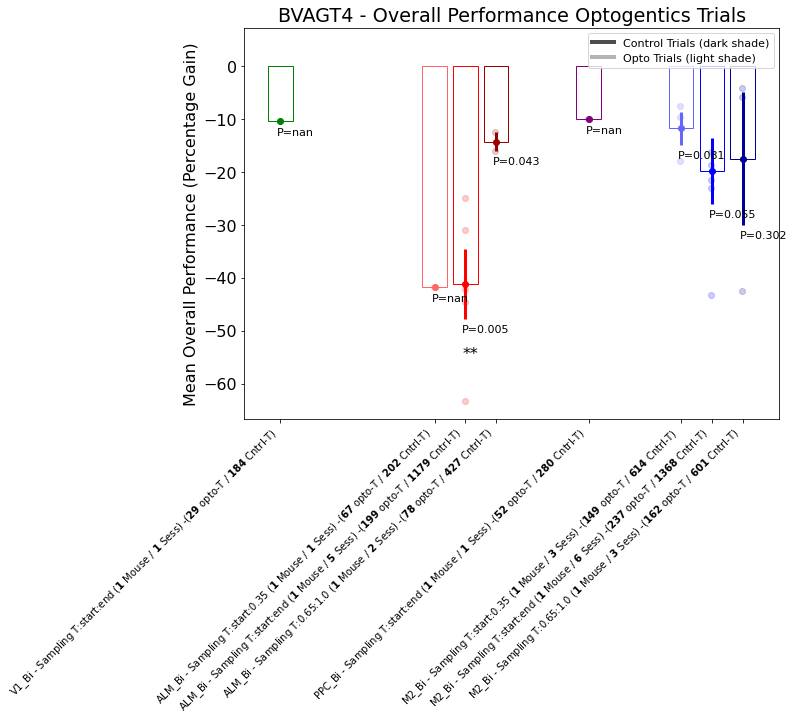

TTTest Skipping test for Decision Time V1_Bi Sampling BVAGT4
Decision Time V1_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Decision Time ALM_R - Sampling None
Decision Time ALM_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Decision Time ALM_Bi Sampling None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: 0.07166040053165672
Decision Time ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.28457089867283547


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Decision Time PPC_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Decision Time M2_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.17291330871350113
Decision Time M2_Bi Sampling None - Len: 5
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 5) - p-value: 0.032465156238497564
Decision Time M2_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.03405122357038419


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


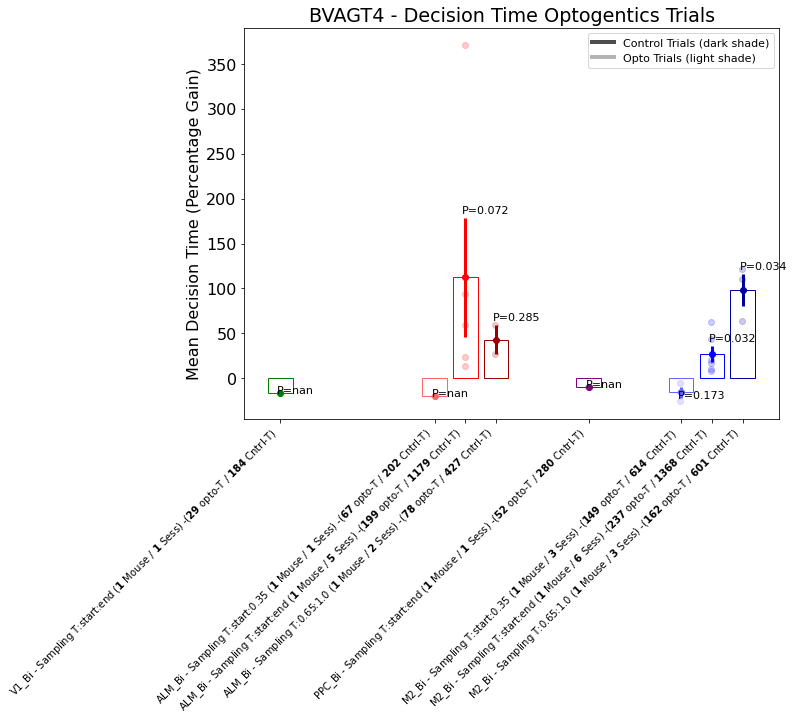

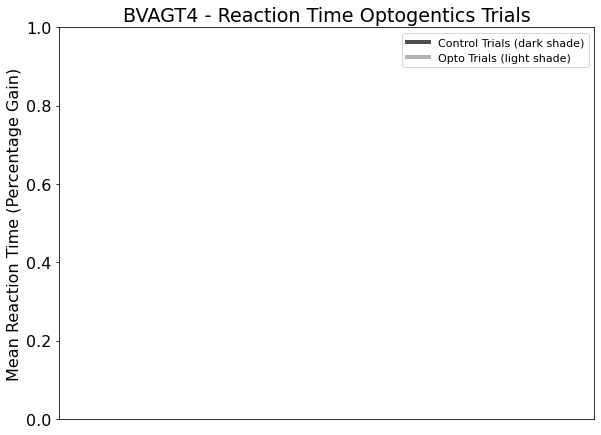

TTTest Skipping test for Early-Withdrawal V1_Bi Sampling BVAGT4
Early-Withdrawal V1_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Early-Withdrawal ALM_R - Sampling None
Early-Withdrawal ALM_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Early-Withdrawal ALM_Bi Sampling None - Len: 5
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 5) - p-value: 0.08721476043724609


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Early-Withdrawal ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.7079144449530728
Early-Withdrawal PPC_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Early-Withdrawal M2_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.7750355380039022
Early-Withdrawal M2_Bi Sampling None - Len: 6
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 6) - p-value: 0.07617895396139424


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Early-Withdrawal M2_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.2031994769890341


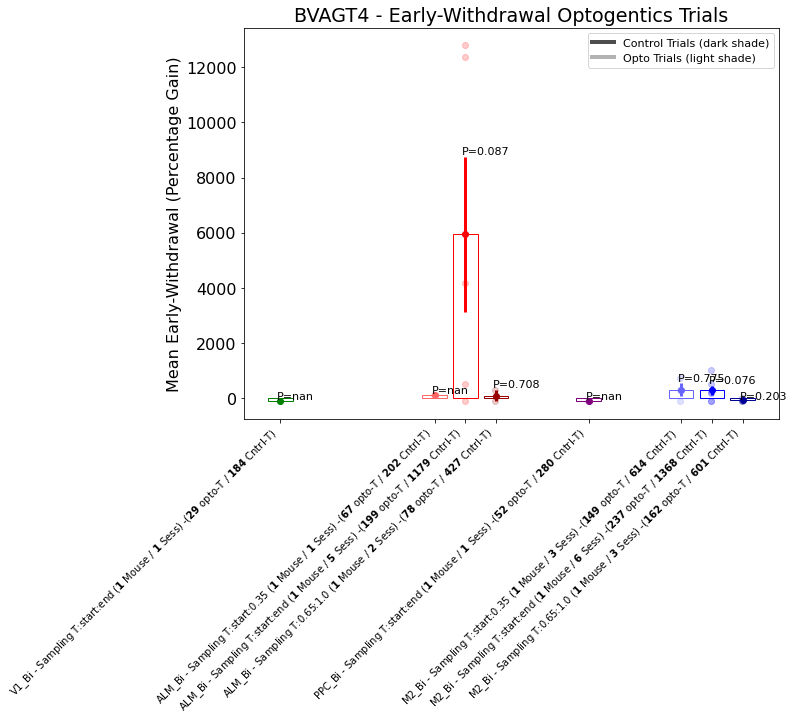

TTTest Skipping test for Movement Time V1_Bi Sampling BVAGT4
Movement Time V1_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Movement Time ALM_R - Sampling None
Movement Time ALM_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Movement Time ALM_Bi Sampling None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: 0.22404580627339157


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Movement Time ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.7445790240654895
Movement Time PPC_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Movement Time M2_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.1309359105882429
Movement Time M2_Bi Sampling None - Len: 5
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 5) - p-value: 0.010692048630876526


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Movement Time M2_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.1628800360344833


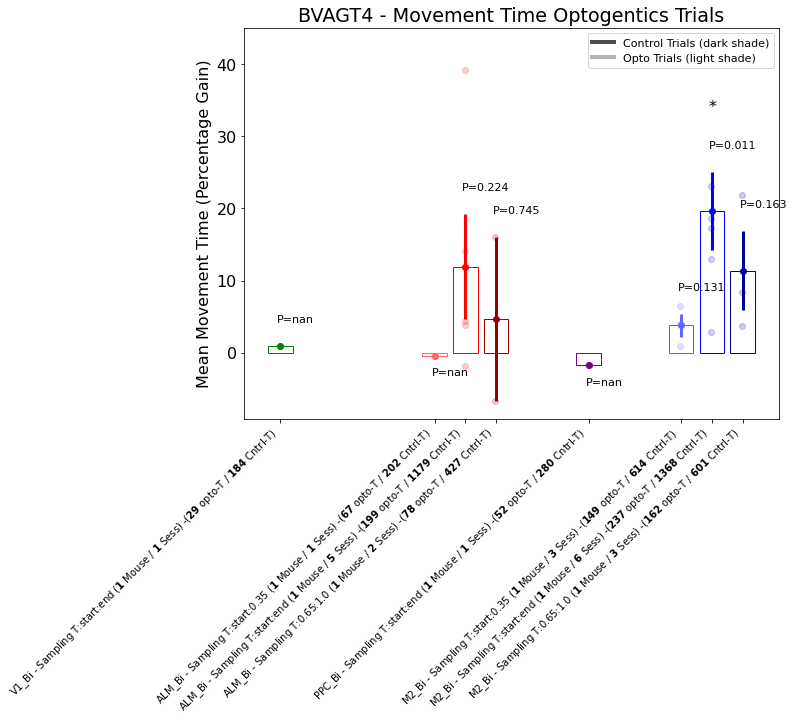

TTTest Early bailout Overall Performance V1_Bi - Sampling None
Overall Performance V1_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Skipping test for Overall Performance ALM_Bi Sampling BVGAT1
Overall Performance ALM_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Overall Performance ALM_Bi - Sampling None
Overall Performance ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.022590797606830554


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Overall Performance ALM_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.1054473774747249
TTTest Skipping test for Overall Performance PPC_Bi Sampling BVGAT1
Overall Performance PPC_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Overall Performance PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.13221791995012222
TTTest Skipping test for Overall Performance PPC_Bi Sampling BVGAT1
Overall Performance PPC_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Overall Performance M2_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.10621862815139343
TTTest Early bailout Overall Performance M2_Bi - Sampling None
TTTest Early bailout Overall Performance M2_Bi - Sampling None
TTTest Skipping test for Overall Performance M2_B

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Overall Performance M2_Bi WaitDecision None - Len: 2
	Across Sessions (Sample size: 2) - p-value: 0.26068012870725504
Overall Performance S1_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.7488220910385559
TTTest Early bailout Overall Performance S1_Bi - WaitDecision None


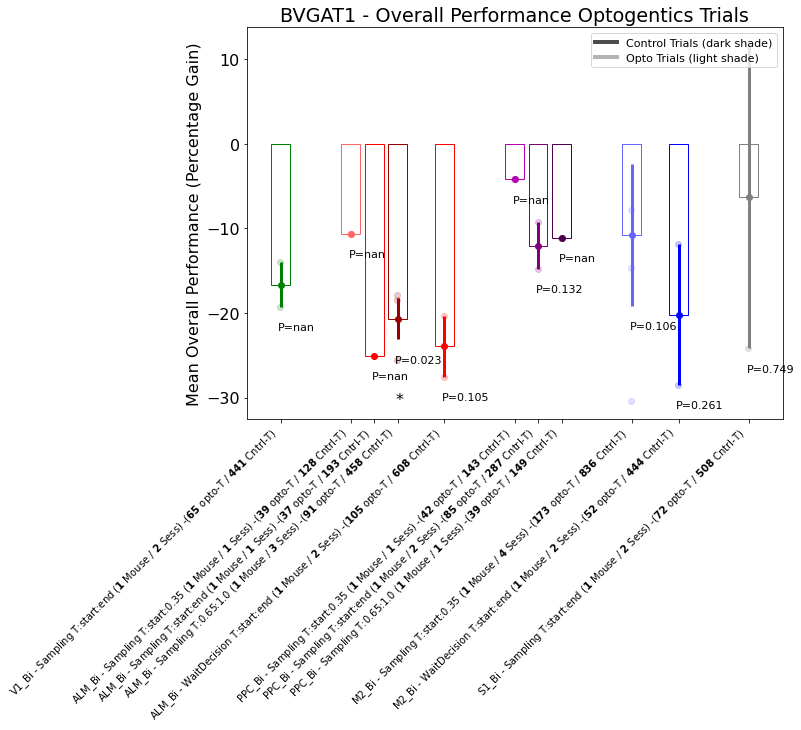

TTTest Early bailout Decision Time V1_Bi - Sampling None
Decision Time V1_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Skipping test for Decision Time ALM_Bi Sampling BVGAT1
Decision Time ALM_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Decision Time ALM_Bi - Sampling None


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Decision Time ALM_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Decision Time ALM_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.6737257670210938
TTTest Skipping test for Decision Time PPC_Bi Sampling BVGAT1
Decision Time PPC_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Decision Time PPC_Bi - Sampling None
TTTest Skipping test for Decision Time PPC_Bi Sampling BVGAT1
Decision Time PPC_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Decision Time M2_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.9984264608599405
TTTest Early bailout Decision Time M2_Bi - Sampling None


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


TTTest Early bailout Decision Time M2_Bi - Sampling None
TTTest Skipping test for Decision Time M2_Bi WaitDecision BVGAT1
Decision Time M2_Bi WaitDecision None - Len: 2
	Across Sessions (Sample size: 2) - p-value: 0.57839125258147
Decision Time S1_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.14005342179608196
TTTest Early bailout Decision Time S1_Bi - WaitDecision None


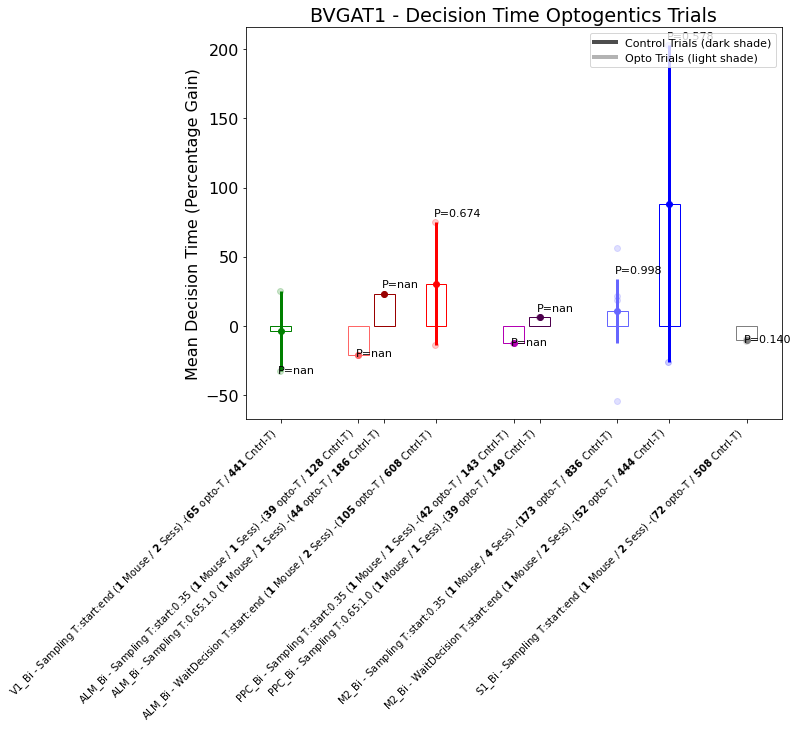

TTTest Early bailout Reaction Time ALM_Bi - Sampling None
TTTest Skipping test for Reaction Time ALM_Bi Sampling BVGAT1
Reaction Time ALM_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Reaction Time PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: nan
TTTest Early bailout Reaction Time PPC_Bi - Sampling None


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


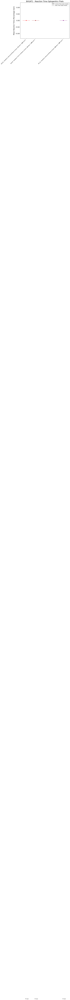

TTTest Early bailout Early-Withdrawal V1_Bi - Sampling None
Early-Withdrawal V1_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.9432609307665045
TTTest Skipping test for Early-Withdrawal ALM_Bi Sampling BVGAT1
Early-Withdrawal ALM_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Skipping test for Early-Withdrawal ALM_Bi Sampling BVGAT1
Early-Withdrawal ALM_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Early-Withdrawal ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.6505605577898135


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Early-Withdrawal ALM_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.1871897639408602
TTTest Skipping test for Early-Withdrawal PPC_Bi Sampling BVGAT1
Early-Withdrawal PPC_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Early-Withdrawal PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.24575332554886975
TTTest Skipping test for Early-Withdrawal PPC_Bi Sampling BVGAT1
Early-Withdrawal PPC_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Early-Withdrawal M2_Bi Sampling None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: 0.024936507288729676
TTTest Early bailout Early-Withdrawal M2_Bi - Sampling None
TTTest Early bailout Early-Withdrawal M2_Bi - Sampling None


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Early-Withdrawal M2_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.974278829460757
Early-Withdrawal S1_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.21705240341429158
TTTest Early bailout Early-Withdrawal S1_Bi - WaitDecision None


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


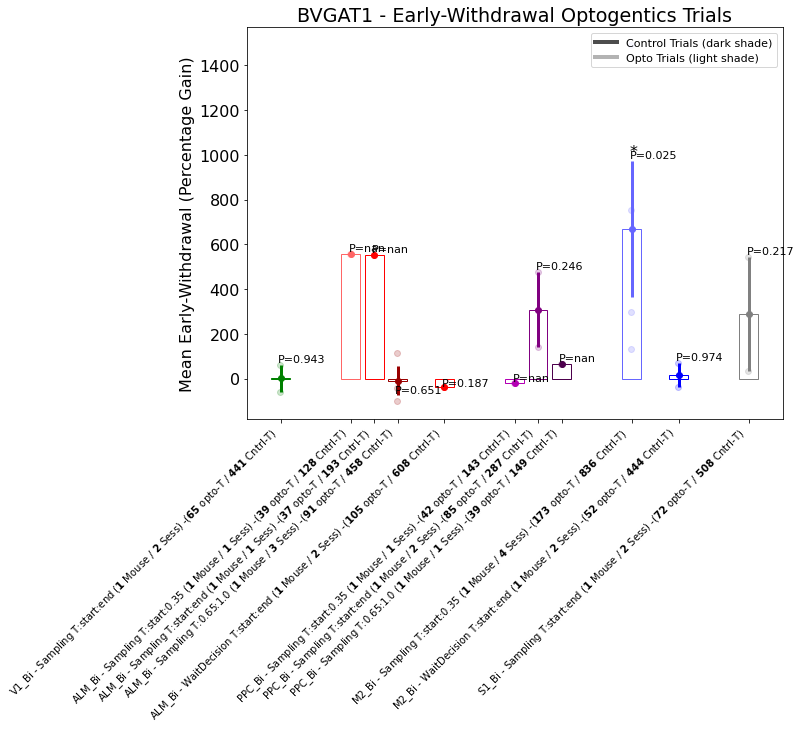

TTTest Early bailout Movement Time V1_Bi - Sampling None
Movement Time V1_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Skipping test for Movement Time ALM_Bi Sampling BVGAT1
Movement Time ALM_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Movement Time ALM_Bi - Sampling None
Movement Time ALM_Bi Sampling None - Len: 2


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.6126901870314312
Movement Time ALM_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.10048930382966481
TTTest Skipping test for Movement Time PPC_Bi Sampling BVGAT1
Movement Time PPC_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Movement Time PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.5506379891079385
TTTest Skipping test for Movement Time PPC_Bi Sampling BVGAT1
Movement Time PPC_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Movement Time M2_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.0473144495807121
TTTest Early bailout Movement Time M2_Bi - Sampling None
TTTest Early bailout Movement Time M2_Bi - Sampling None
TTTest Skipping test for Movement Time M2_Bi WaitDecision BVGAT1
Movement Time M2_Bi WaitDecision None - Len: 2
	Across Sessions (Sample size: 2) - p-value: 0.007234571148627178
Movement Time S1_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.48500387912849824
TTTest Early bailout Movement Time S1_Bi - WaitDecision None


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


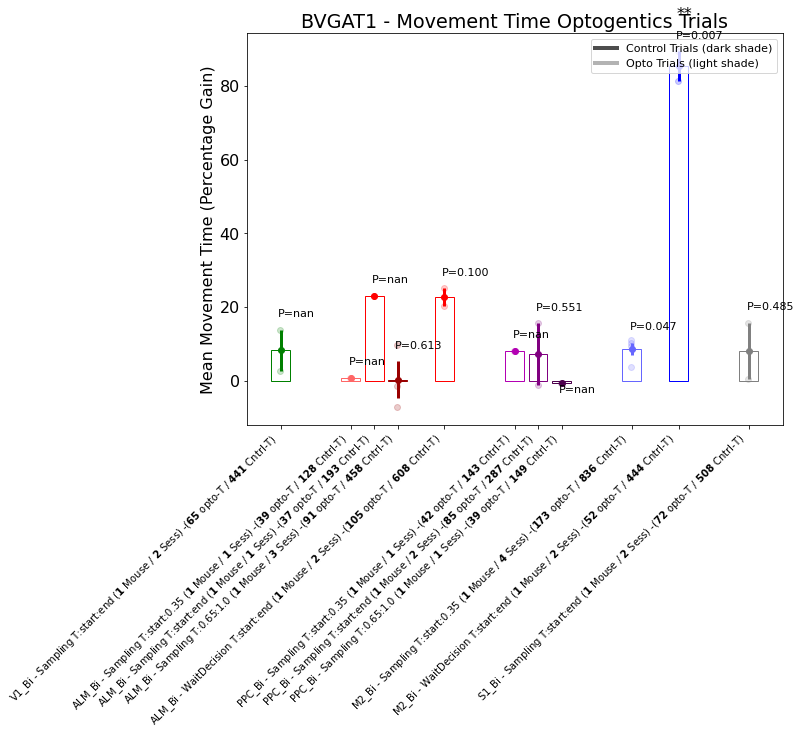

TTTest Early bailout Overall Performance V1_Bi - Sampling None
Overall Performance V1_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.9954476791602915
Overall Performance ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.041793267834354685
TTTest Early bailout Overall Performance ALM_Bi - Sampling None
Overall Performance ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.10794839847391165
TTTest Early bailout Overall Performance ALM_Bi - WaitDecision None


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Overall Performance M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.2653746572555532
TTTest Early bailout Overall Performance M2_Bi - Sampling None
Overall Performance M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.3987680960486865
Overall Performance M2_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.45799026576338386


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


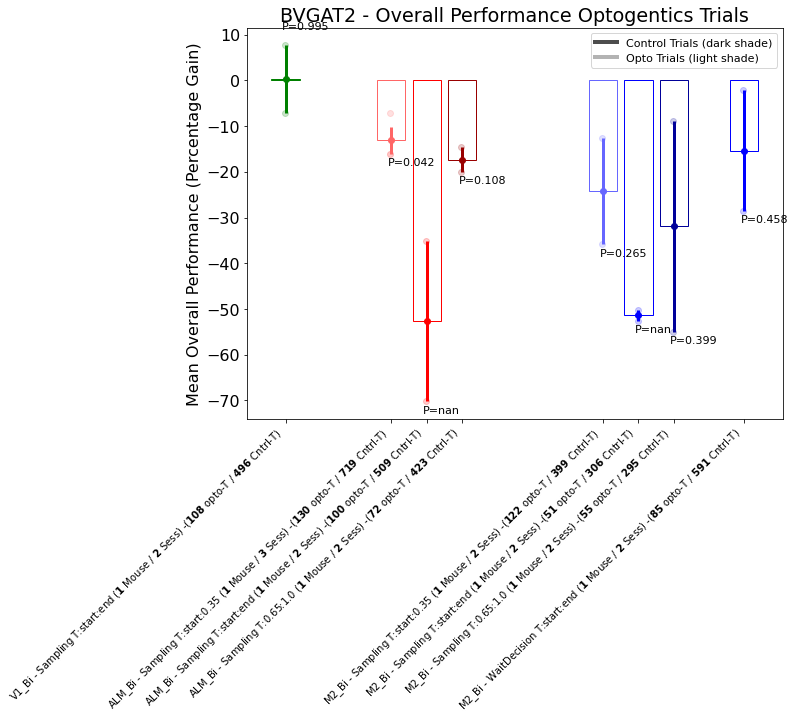

TTTest Early bailout Decision Time V1_Bi - Sampling None
Decision Time V1_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.8690201855654669
Decision Time ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.046371650597831715
TTTest Early bailout Decision Time ALM_Bi - Sampling None
Decision Time ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.5227453766894956


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


TTTest Early bailout Decision Time ALM_Bi - WaitDecision None
Decision Time M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.0874098659490483
TTTest Early bailout Decision Time M2_Bi - Sampling None
Decision Time M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.3251244284727836
Decision Time M2_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.18246309813949893


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


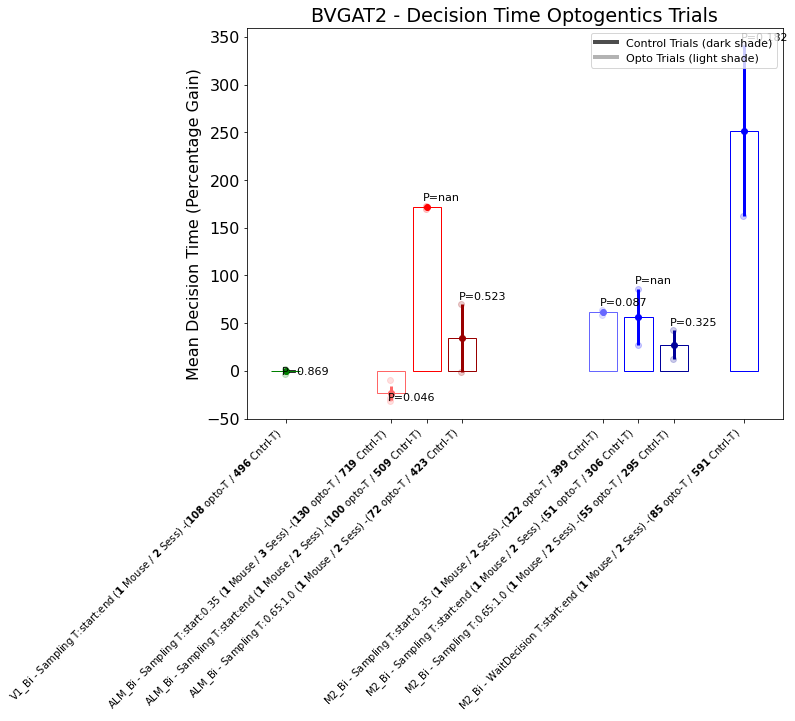

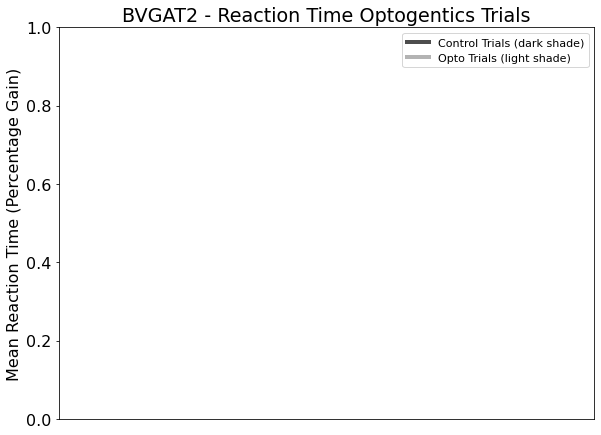

TTTest Early bailout Early-Withdrawal V1_Bi - Sampling None
Early-Withdrawal V1_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.19412296065349138
Early-Withdrawal ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.19287891126775544
Early-Withdrawal ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.03716615440278476
Early-Withdrawal ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.006453804877173356
TTTest Early bailout Early-Withdrawal ALM_Bi - WaitDecision None


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Early-Withdrawal M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.6480445508283064
Early-Withdrawal M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.023541629128120255
Early-Withdrawal M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.3737501298156298
Early-Withdrawal M2_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.8721763793601802


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


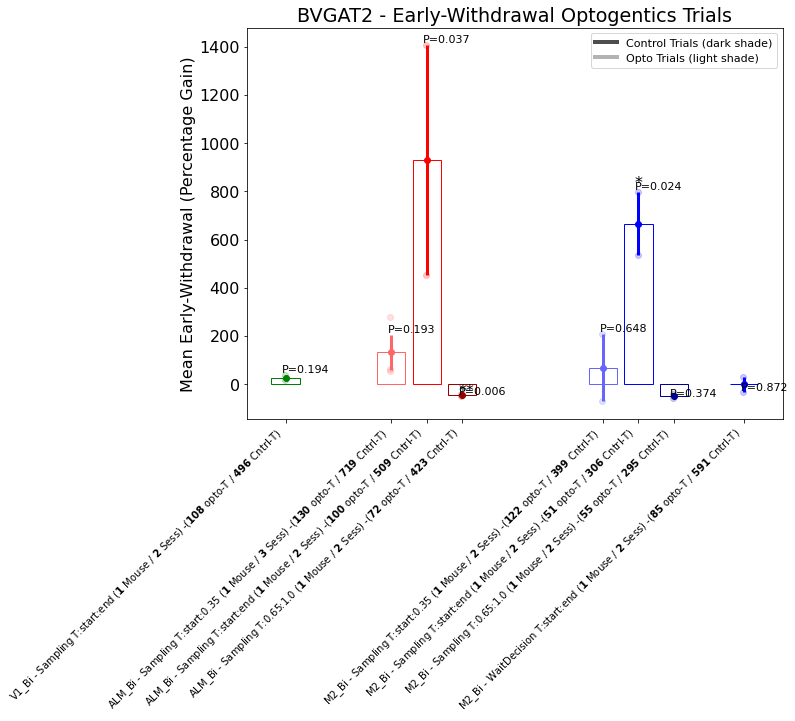

TTTest Early bailout Movement Time V1_Bi - Sampling None
Movement Time V1_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.4642437635133901
Movement Time ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.0732453274959736
TTTest Early bailout Movement Time ALM_Bi - Sampling None
Movement Time ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.5228987855115484
TTTest Early bailout Movement Time ALM_Bi - WaitDecision None


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Movement Time M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.653478580595612
TTTest Early bailout Movement Time M2_Bi - Sampling None
Movement Time M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.11999991240182163
Movement Time M2_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.3086566944618621


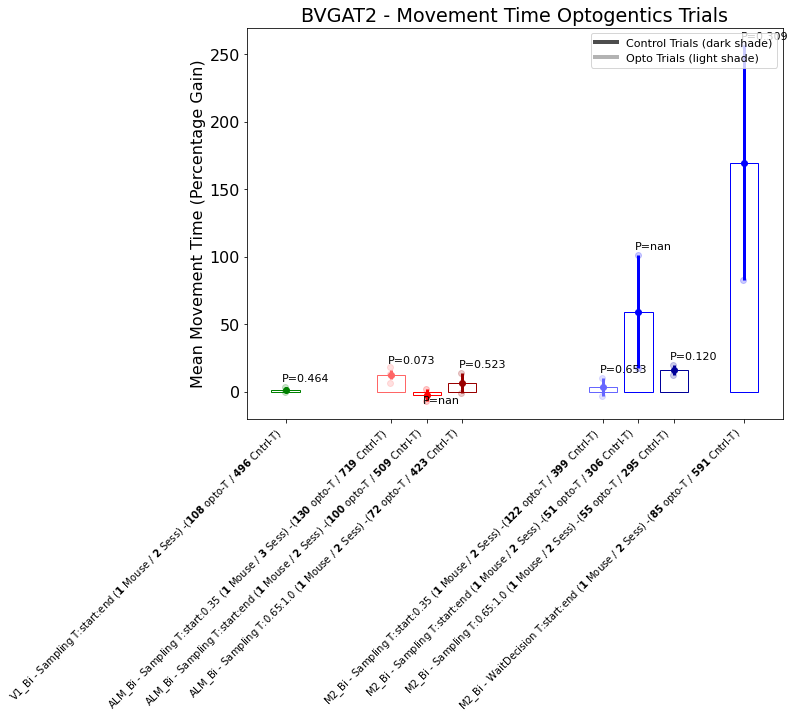

Overall Performance V1_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.112944473255821
TTTest Skipping test for Overall Performance ALM_Bi Sampling BVGAT3
Overall Performance ALM_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
---- Control trials: 2 - before: 4
---- Opto trials: 2 - before: 3
---- Control trials: 0 - before: 0
---- Opto trials: 0 - before: 1
Overall Performance ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.03735232233064125
---- Control trials: 0 - before: 0
---- Opto trials: 0 - before: 1
Overall Performance ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.08258829839096041


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Overall Performance ALM_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.14327665592566532
Overall Performance PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.03687905209288746
TTTest Early bailout Overall Performance PPC_Bi - Sampling None
Overall Performance PPC_Bi Sampling None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: 0.16980724987596824
Skipping partial sampling: (<MatrixState.stimulus_delivery: 8>, 0.35, 1.0) with: 1 trials.
TTTest Skipping test for Overall Performance PPC_Bi Sampling BVGAT3
Overall Performance PPC_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Overall Performance M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.5087467187818533


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


TTTest Skipping test for Overall Performance M2_Bi Sampling BVGAT3
Overall Performance M2_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Overall Performance M2_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Overall Performance M2_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.13010724643745902
TTTest Skipping test for Overall Performance S1_Bi Sampling BVGAT3
Overall Performance S1_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Overall Performance S1_Bi - WaitDecision None


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


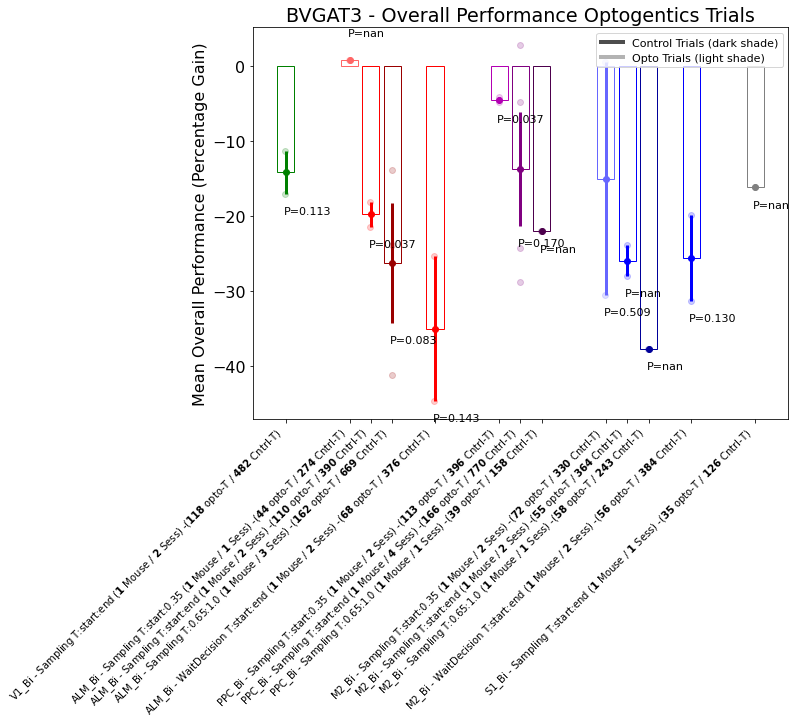

Decision Time V1_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.3535718457613687
TTTest Skipping test for Decision Time ALM_Bi Sampling BVGAT3
Decision Time ALM_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
---- Control trials: 2 - before: 4
---- Opto trials: 2 - before: 3
---- Control trials: 0 - before: 0
---- Opto trials: 0 - before: 1
Decision Time ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.41666931681943703
---- Control trials: 0 - before: 0
---- Opto trials: 0 - before: 1
Decision Time ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.10997356546947586
Decision Time ALM_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.116311196699898


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Decision Time PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.3063410795538654
TTTest Early bailout Decision Time PPC_Bi - Sampling None
Decision Time PPC_Bi Sampling None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: 0.3578864732439784
Skipping partial sampling: (<MatrixState.stimulus_delivery: 8>, 0.35, 1.0) with: 1 trials.
TTTest Skipping test for Decision Time PPC_Bi Sampling BVGAT3
Decision Time PPC_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Decision Time M2_Bi - Sampling None
TTTest Skipping test for Decision Time M2_Bi Sampling BVGAT3
Decision Time M2_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Decision Time M2_Bi - Sampling None
Decision Time M2_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Samp

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


TTTest Skipping test for Decision Time S1_Bi Sampling BVGAT3
Decision Time S1_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Decision Time S1_Bi - WaitDecision None


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


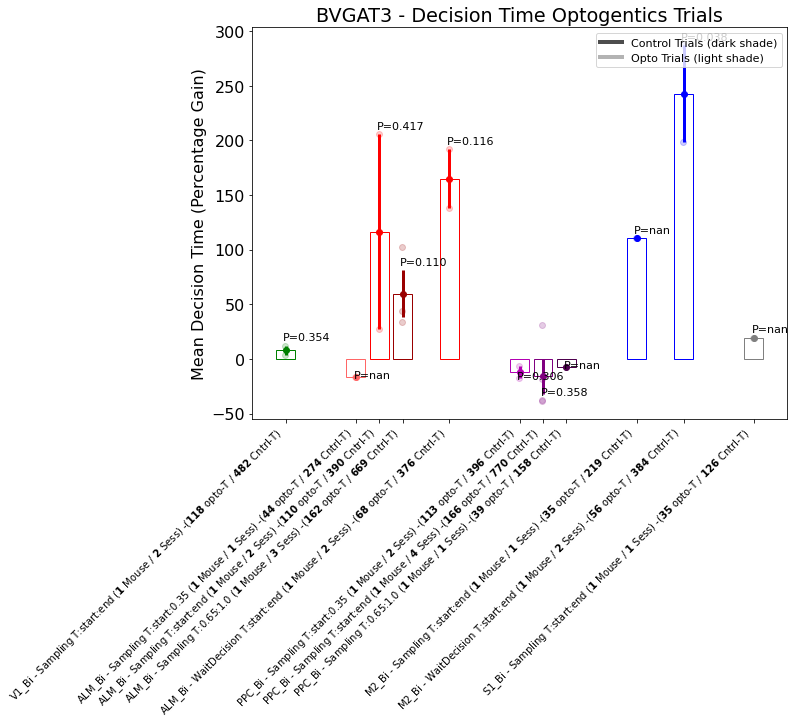

TTTest Early bailout Reaction Time ALM_Bi - Sampling None
TTTest Early bailout Reaction Time PPC_Bi - Sampling None
Reaction Time M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.49999999999999956
TTTest Early bailout Reaction Time M2_Bi - Sampling None
TTTest Skipping test for Reaction Time M2_Bi Sampling BVGAT3
Reaction Time M2_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


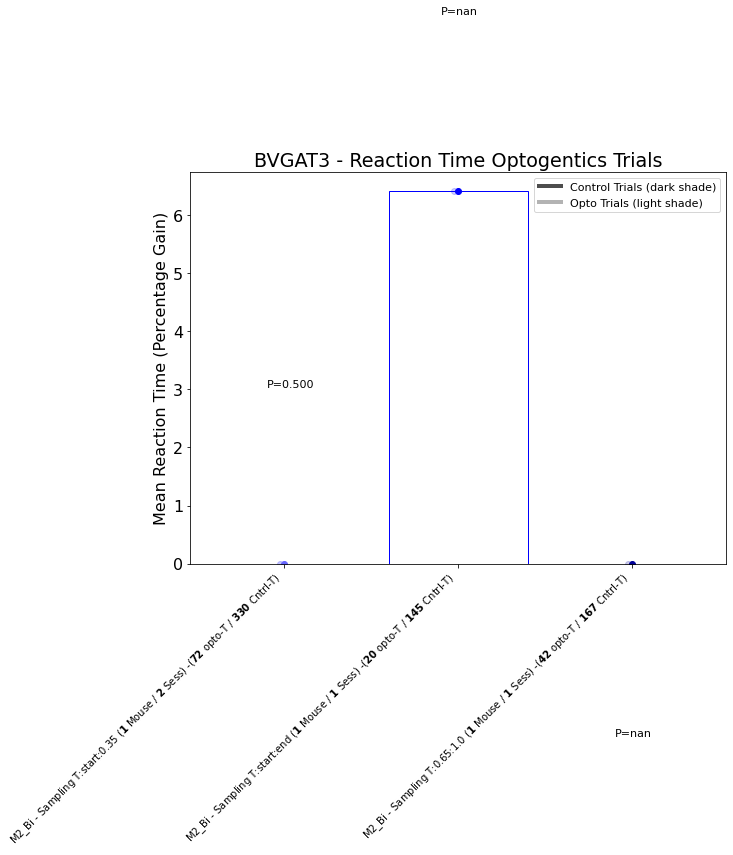

Early-Withdrawal V1_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.4112401866240406
Early-Withdrawal ALM_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
---- Control trials: 2 - before: 4
---- Opto trials: 2 - before: 3
---- Control trials: 0 - before: 0
---- Opto trials: 0 - before: 1
Early-Withdrawal ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.5150672286434692
---- Control trials: 0 - before: 0
---- Opto trials: 0 - before: 1
Early-Withdrawal ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.3655126110488659


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Early-Withdrawal ALM_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.6834410954023221
Early-Withdrawal PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.10930863582196682
TTTest Early bailout Early-Withdrawal PPC_Bi - Sampling None
Early-Withdrawal PPC_Bi Sampling None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: 0.5273181744029953
Skipping partial sampling: (<MatrixState.stimulus_delivery: 8>, 0.35, 1.0) with: 1 trials.
TTTest Skipping test for Early-Withdrawal PPC_Bi Sampling BVGAT3
Early-Withdrawal PPC_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Early-Withdrawal M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.030980612550383285
Early-Withdrawal M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.24305054001563967
Early-Withdrawal M2_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Early-Withdrawal M2_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.9225436530593168
TTTest Skipping test for Early-Withdrawal S1_Bi Sampling BVGAT3
Early-Withdrawal S1_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Early-Withdrawal S1_Bi - WaitDecision None


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


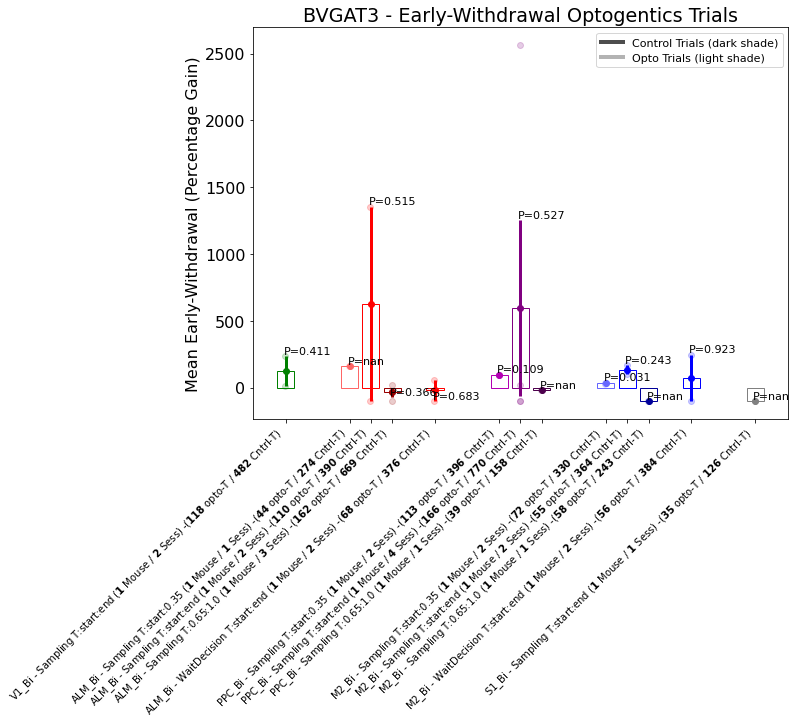

Movement Time V1_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.5129904369767584
TTTest Skipping test for Movement Time ALM_Bi Sampling BVGAT3
Movement Time ALM_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
---- Control trials: 2 - before: 4
---- Opto trials: 2 - before: 3
---- Control trials: 0 - before: 0
---- Opto trials: 0 - before: 1
Movement Time ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.33453018590445577
---- Control trials: 0 - before: 0
---- Opto trials: 0 - before: 1
Movement Time ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.01717029389715226


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Movement Time ALM_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.3541128975920978
Movement Time PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.9633842966476033
TTTest Early bailout Movement Time PPC_Bi - Sampling None
Movement Time PPC_Bi Sampling None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: 0.3031662367973899
Skipping partial sampling: (<MatrixState.stimulus_delivery: 8>, 0.35, 1.0) with: 1 trials.
TTTest Skipping test for Movement Time PPC_Bi Sampling BVGAT3
Movement Time PPC_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Movement Time M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.7267272768453127


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


TTTest Skipping test for Movement Time M2_Bi Sampling BVGAT3
Movement Time M2_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Movement Time M2_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Movement Time M2_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.22026763461497895
TTTest Skipping test for Movement Time S1_Bi Sampling BVGAT3
Movement Time S1_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Movement Time S1_Bi - WaitDecision None


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


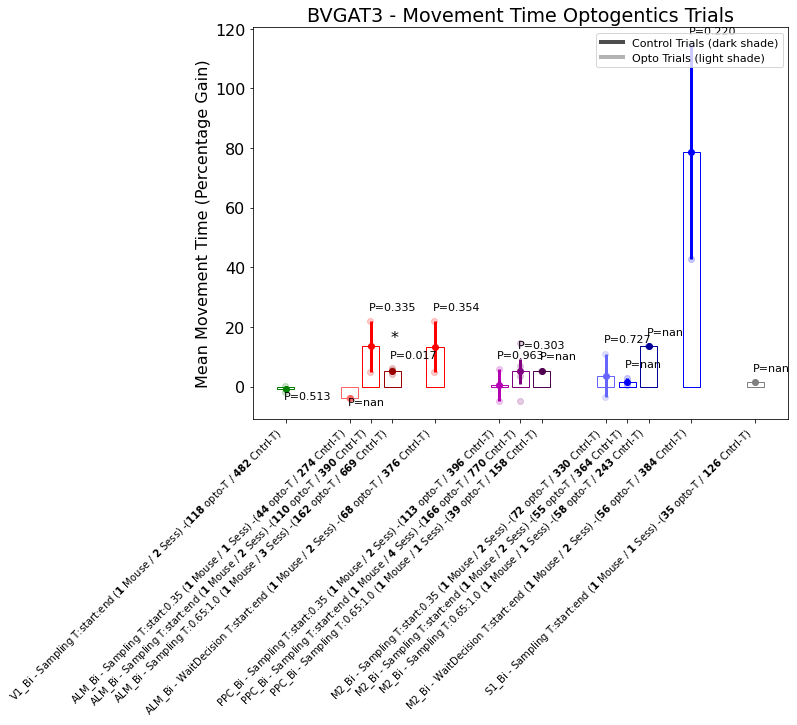

Overall Performance V1_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.7563914007751552
TTTest Skipping test for Overall Performance V1_Bi WaitDecision vgat2.1
Overall Performance V1_Bi WaitDecision None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Overall Performance ALM_Bi - Sampling None
Overall Performance ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.24867355738006597
Overall Performance ALM_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.08757381004140741


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Overall Performance PPC_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Overall Performance PPC_Bi WaitDecision None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Overall Performance M2_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Overall Performance M2_Bi WaitDecision None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.21204382656035836
Overall Performance RSP_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.5405911628599682


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Overall Performance RSP_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.4805593768396114


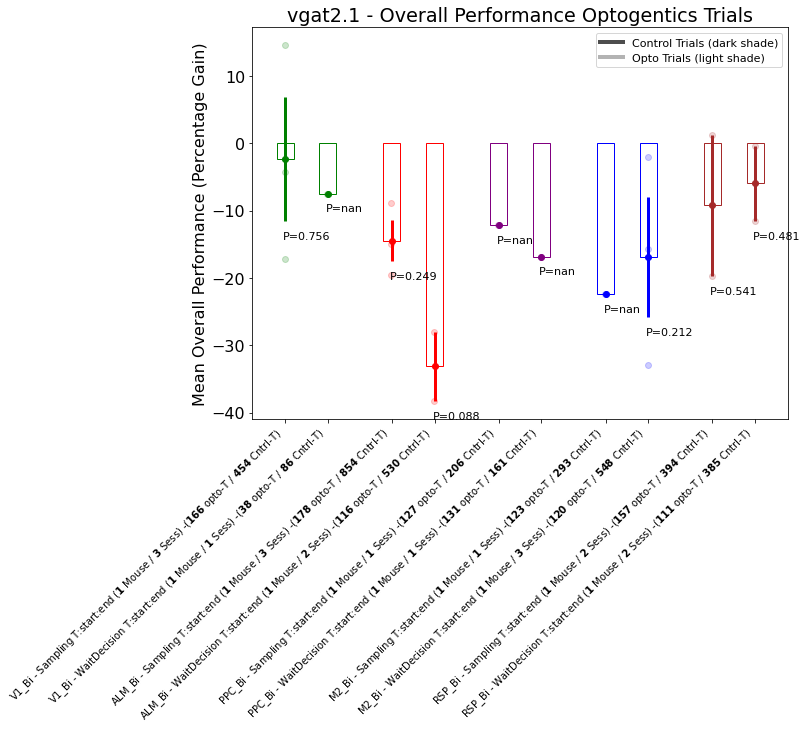

TTTest Early bailout Decision Time ALM_Bi - Sampling None
TTTest Early bailout Decision Time ALM_Bi - Sampling None
TTTest Early bailout Decision Time RSP_Bi - Sampling None


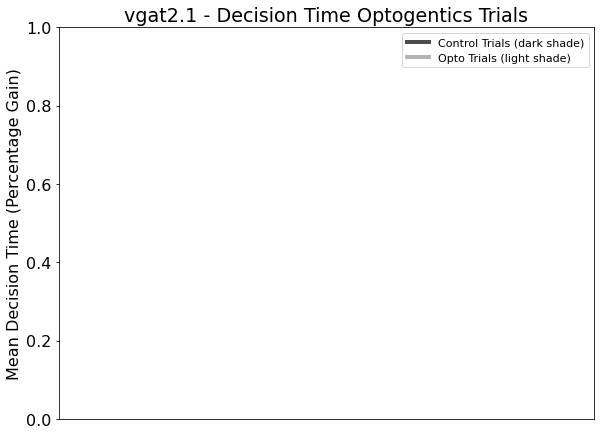

Reaction Time V1_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: nan
TTTest Skipping test for Reaction Time V1_Bi WaitDecision vgat2.1
Reaction Time V1_Bi WaitDecision None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Reaction Time ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.42264973081037427
Reaction Time ALM_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: nan
Reaction Time PPC_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Reaction Time PPC_Bi WaitDecision None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Reaction Time M2_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Reaction Time M2_Bi WaitDecision None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: nan
Reaction Time RSP_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: nan
Reaction Time RSP_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: nan


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


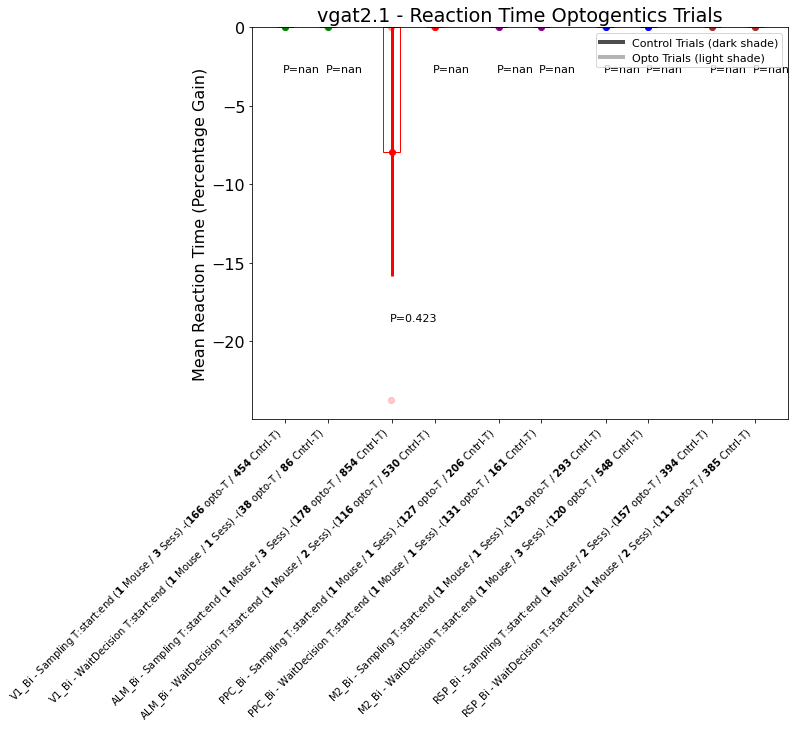

Early-Withdrawal V1_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.5322443659986849
TTTest Skipping test for Early-Withdrawal V1_Bi WaitDecision vgat2.1
Early-Withdrawal V1_Bi WaitDecision None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Early-Withdrawal ALM_Bi - Sampling None
Early-Withdrawal ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.3039422026687988
Early-Withdrawal ALM_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.08190866350733096
Early-Withdrawal PPC_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Early-Withdrawal PPC_Bi WaitDecision None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Early-Withdrawal M2_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Early-Withdrawal M2_Bi WaitDecision None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.02688290660878867
Early-Withdrawal RSP_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.5502732496499484
Early-Withdrawal RSP_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.3225947028247182


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


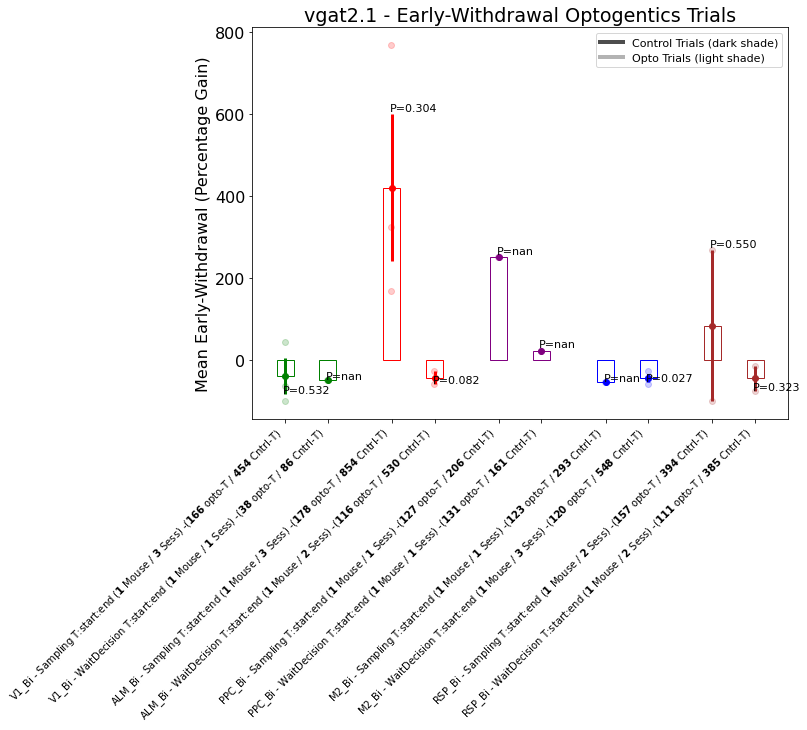

Movement Time V1_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.1830433007775072
TTTest Skipping test for Movement Time V1_Bi WaitDecision vgat2.1
Movement Time V1_Bi WaitDecision None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Movement Time ALM_Bi - Sampling None
Movement Time ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.34477061337994125
Movement Time ALM_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.1362231552540121


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Movement Time PPC_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Movement Time PPC_Bi WaitDecision None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Movement Time M2_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Movement Time M2_Bi WaitDecision None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.0817138808335501
Movement Time RSP_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.13956939332571716


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Movement Time RSP_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.0328445859490951


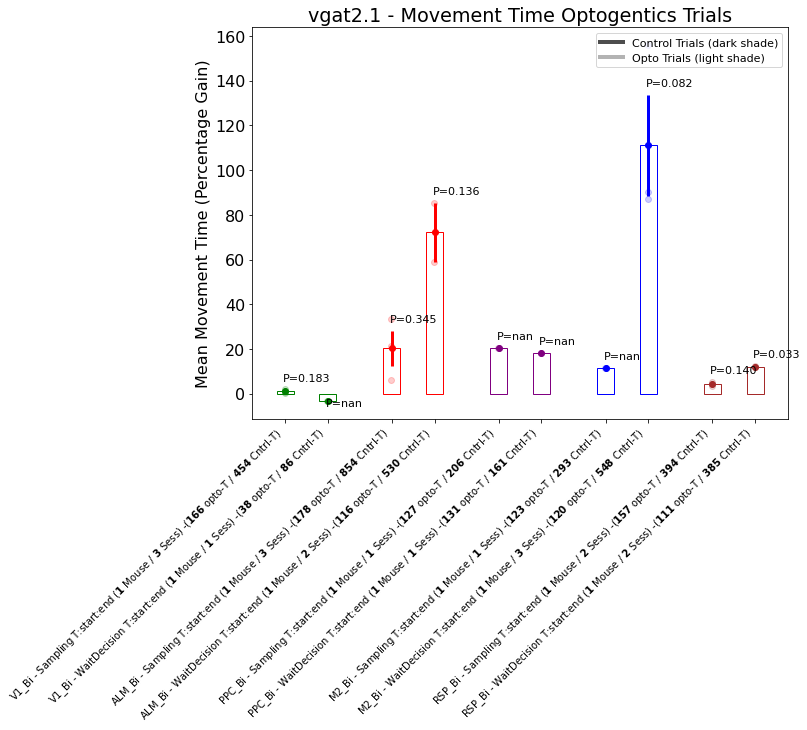

Overall Performance V1_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.4856328245968198
Overall Performance V1_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.3076753704740264
Overall Performance ALM_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Overall Performance ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.06976265081885742
Skipping partial sampling: (<MatrixState.stimulus_delivery: 8>, 0.35, 1.0) with: 181 trials.
Overall Performance ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.030926557976381285
Overall Performance ALM_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Acro

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


TTTest Skipping test for Overall Performance PPC_Bi Sampling vgat2.4
Overall Performance PPC_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Overall Performance PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.05788002901284385
TTTest Early bailout Overall Performance PPC_Bi - Sampling None
Overall Performance PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.6685071782069456
Overall Performance PPC_Bi WaitDecision None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.3232149522615364
Overall Performance POR_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.7285562009974114


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Overall Performance POR_Bi WaitDecision None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Overall Performance M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.44162332892971845
Overall Performance M2_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Skipping partial sampling: (<MatrixState.stimulus_delivery: 8>, 0.35, 1.0) with: 259 trials.
TTTest Early bailout Overall Performance M2_Bi - Sampling None
Overall Performance M2_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.87863737836518
Overall Performance M2_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.09622902467419309


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


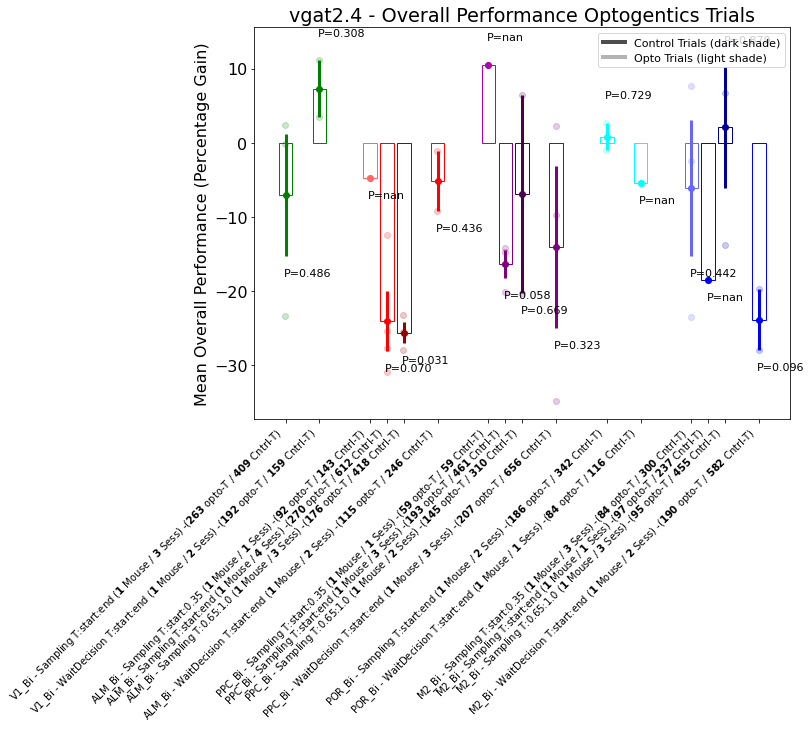

Decision Time V1_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.4129666857082086
Decision Time V1_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.4185069022064799
Decision Time ALM_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Decision Time ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.04343439838463792
Skipping partial sampling: (<MatrixState.stimulus_delivery: 8>, 0.35, 1.0) with: 181 trials.
Decision Time ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.8084990793282891
Decision Time ALM_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


TTTest Skipping test for Decision Time PPC_Bi Sampling vgat2.4
Decision Time PPC_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Decision Time PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.47096436163506306
TTTest Early bailout Decision Time PPC_Bi - Sampling None
Decision Time PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.705159180551072
Decision Time PPC_Bi WaitDecision None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.07532643344376587
Decision Time POR_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.625811829685641


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Decision Time POR_Bi WaitDecision None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Decision Time M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.07616863789820726
Decision Time M2_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Skipping partial sampling: (<MatrixState.stimulus_delivery: 8>, 0.35, 1.0) with: 259 trials.
TTTest Early bailout Decision Time M2_Bi - Sampling None
Decision Time M2_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.17781918015344148
Decision Time M2_Bi WaitDecision None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


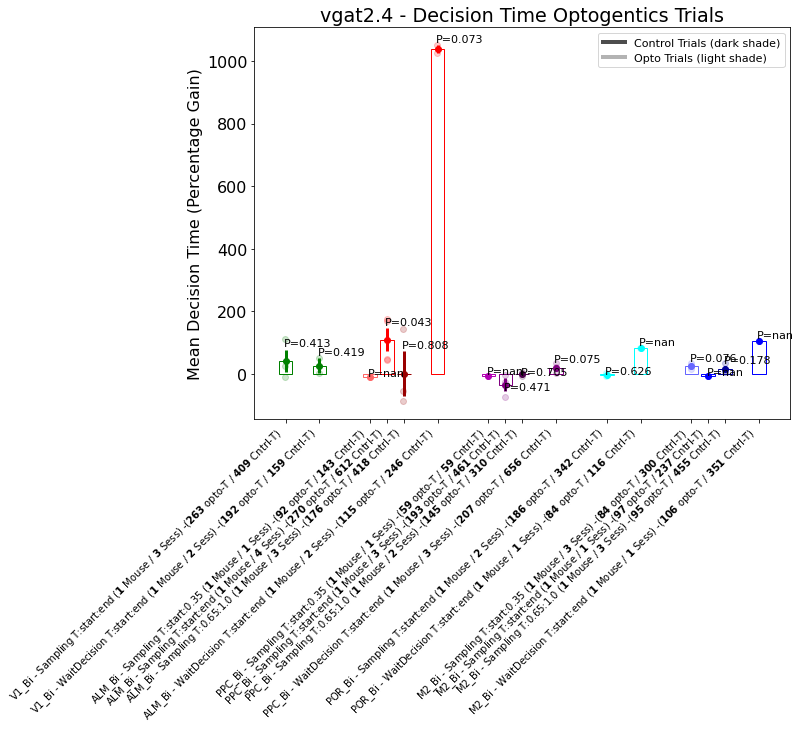

Reaction Time M2_Bi WaitDecision None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


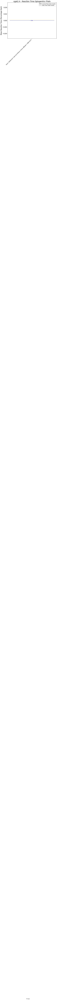

Early-Withdrawal V1_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.3157634995729398
Early-Withdrawal V1_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.7750531128782507
Early-Withdrawal ALM_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Early-Withdrawal ALM_Bi Sampling None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: 0.1433268447739329
Skipping partial sampling: (<MatrixState.stimulus_delivery: 8>, 0.35, 1.0) with: 181 trials.
Early-Withdrawal ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.30483384186722917


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Early-Withdrawal ALM_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.3751080619414071
Early-Withdrawal PPC_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Early-Withdrawal PPC_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.12901545153301397
TTTest Early bailout Early-Withdrawal PPC_Bi - Sampling None
Early-Withdrawal PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.07208838551890885
Early-Withdrawal PPC_Bi WaitDecision None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.23189453728694986


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Early-Withdrawal POR_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.4434432096100876
Early-Withdrawal POR_Bi WaitDecision None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Early-Withdrawal M2_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.37023599610046
Early-Withdrawal M2_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Skipping partial sampling: (<MatrixState.stimulus_delivery: 8>, 0.35, 1.0) with: 259 trials.
TTTest Early bailout Early-Withdrawal M2_Bi - Sampling None
Early-Withdrawal M2_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.8786139925140823


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Early-Withdrawal M2_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.3211650317305608


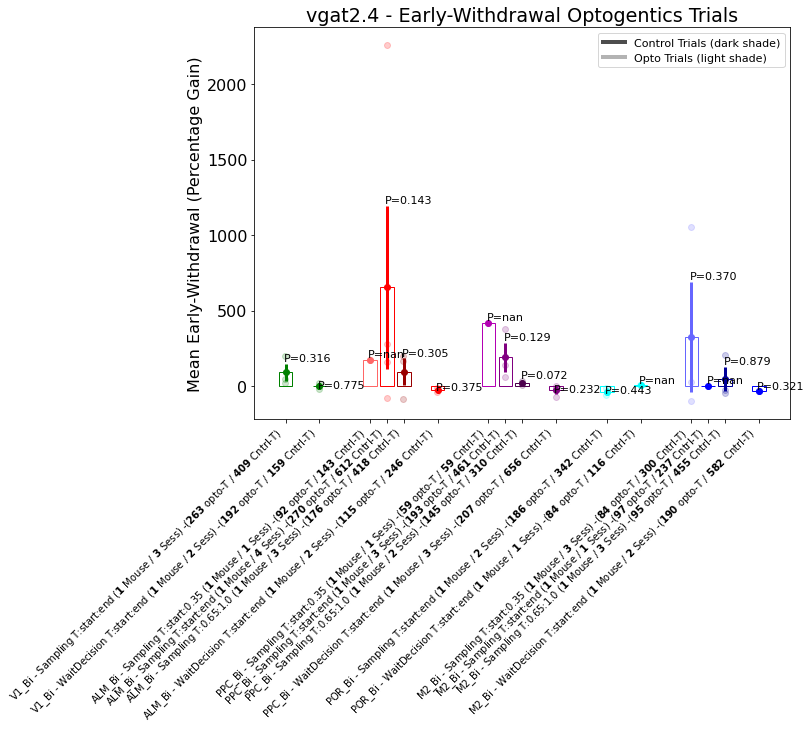

Movement Time V1_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.42384190389429066
Movement Time V1_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.7272560186886974
Movement Time ALM_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Movement Time ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.25114314611251143
Skipping partial sampling: (<MatrixState.stimulus_delivery: 8>, 0.35, 1.0) with: 181 trials.
Movement Time ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.4992762322899123


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Movement Time ALM_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.32274400650348284
TTTest Skipping test for Movement Time PPC_Bi Sampling vgat2.4
Movement Time PPC_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Movement Time PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.20523265143822392
TTTest Early bailout Movement Time PPC_Bi - Sampling None
Movement Time PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.9066590829297815
Movement Time PPC_Bi WaitDecision None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.17019203959166798
Movement Time POR_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.112496351726

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Movement Time POR_Bi WaitDecision None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Movement Time M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.5969264515742382
Movement Time M2_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Skipping partial sampling: (<MatrixState.stimulus_delivery: 8>, 0.35, 1.0) with: 259 trials.
TTTest Early bailout Movement Time M2_Bi - Sampling None
Movement Time M2_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.31225574686814084


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Movement Time M2_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.08251751948262566


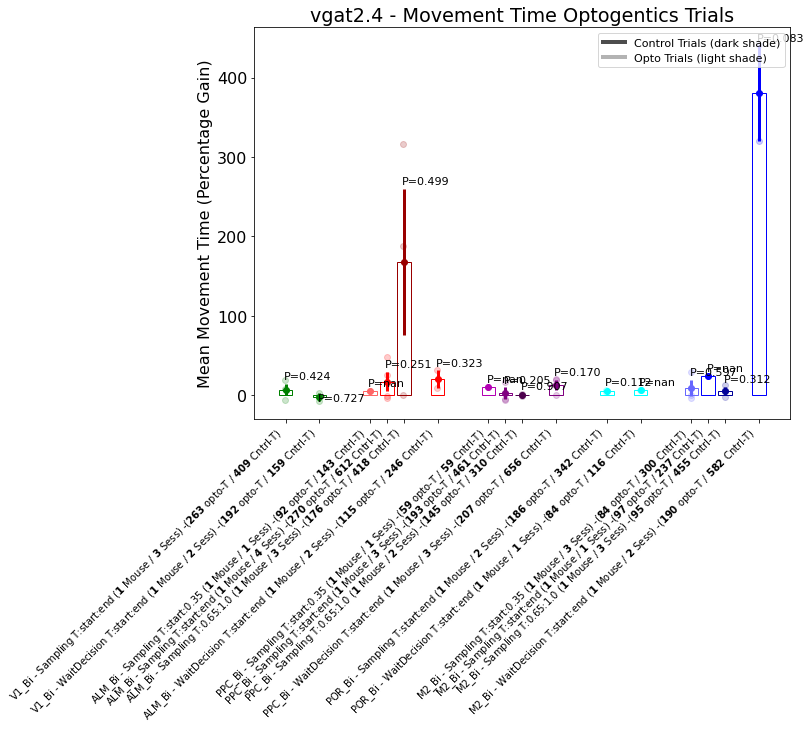

Overall Performance V1_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.6298441558548842
Overall Performance V1_Bi WaitDecision None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.6616813581134284
Overall Performance ALM_Bi Sampling None - Len: 6
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 6) - p-value: 0.016999630221175253
Overall Performance ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.36974497506714804


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Overall Performance ALM_Bi Sampling None - Len: 5
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 5) - p-value: 0.10163958993927619
Overall Performance ALM_Bi WaitDecision None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.21146749867600284
Overall Performance PPC_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.2891154296809451
Overall Performance PPC_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Overall Performance PPC_Bi - Sampling None
Overall Performance PPC_Bi Sampling None - Len: 7
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 7) - p-value: 0.03138035673317112
Overall Performance PPC_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.4598146979357949
Overall Performance POR_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.5212128048110694
Overall Performance POR_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.33840461233412084
Overall Performance M2_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.004647164125675314
Overall Performance M2_Bi Sampling None - Len: 2
	Across Animals (

C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 7) - p-value: 0.0010879505299151919
Overall Performance M2_Bi WaitDecision None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: 0.0015184675230041555
Overall Performance RSP_Bi Sampling None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: 0.9976741821045804


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Overall Performance RSP_Bi WaitDecision None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: 0.22235384175698214


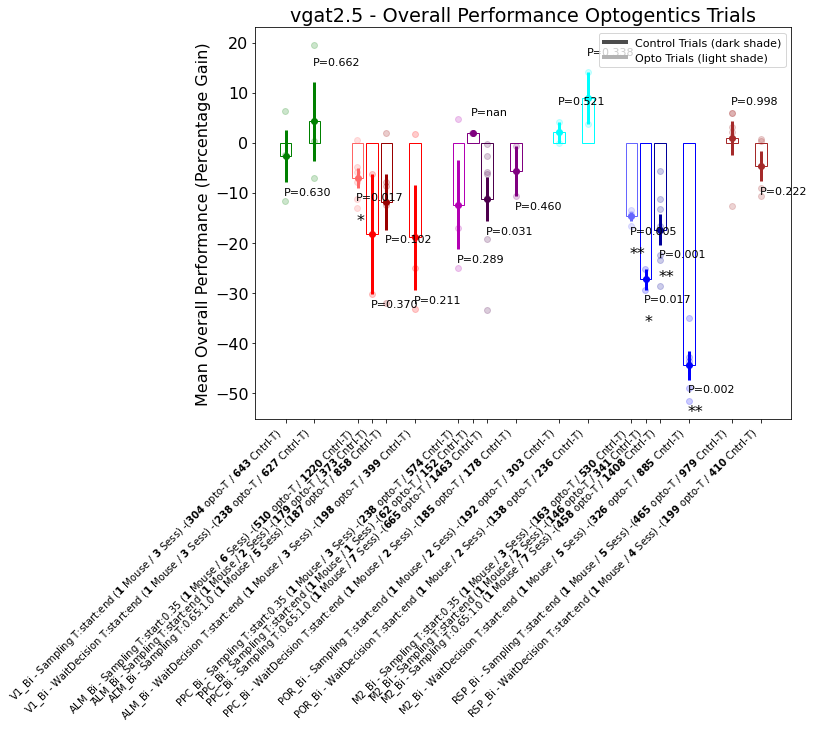

Decision Time ALM_Bi Sampling None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: 0.7722553220747266
Decision Time ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.03993037519437779
TTTest Skipping test for Decision Time PPC_Bi Sampling vgat2.5
Decision Time PPC_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Decision Time PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.08085683770858076
Decision Time M2_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Decision Time M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.6880181621437553


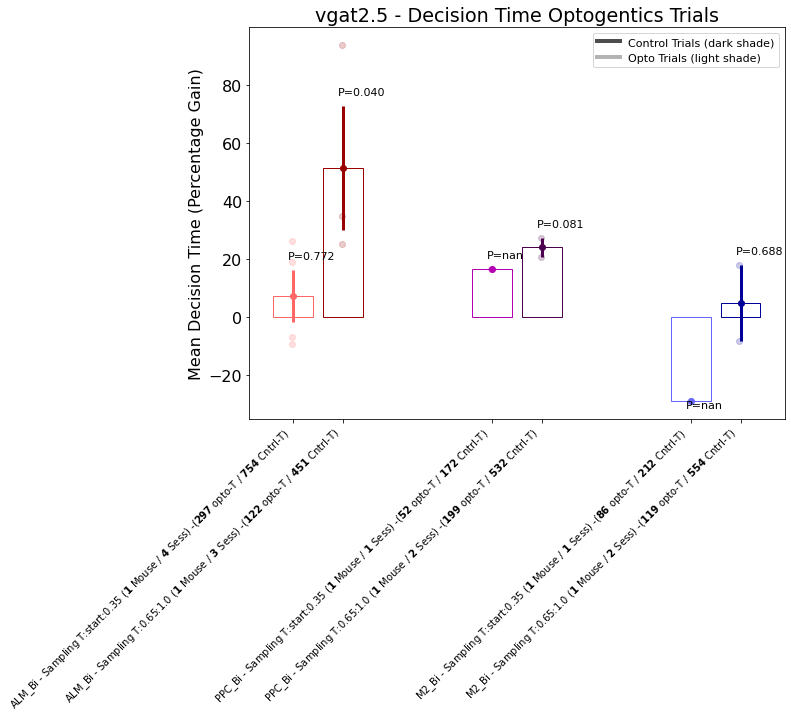

Reaction Time V1_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: nan
Reaction Time V1_Bi WaitDecision None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: nan
Reaction Time ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: nan
Reaction Time ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.49999999999999956
Reaction Time ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: nan
Reaction Time ALM_Bi WaitDecision None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: nan


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Reaction Time PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.49999999999999956
Reaction Time PPC_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Reaction Time PPC_Bi - Sampling None
Reaction Time PPC_Bi Sampling None - Len: 5
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 5) - p-value: 0.373900966300059
Reaction Time PPC_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: nan
Reaction Time POR_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: nan
Reaction Time POR_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: nan


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Reaction Time M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: nan
Reaction Time M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.49999999999999956
Reaction Time M2_Bi Sampling None - Len: 5
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 5) - p-value: nan
Reaction Time M2_Bi WaitDecision None - Len: 5
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 5) - p-value: 0.3739009663000648


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Reaction Time RSP_Bi Sampling None - Len: 5
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 5) - p-value: 0.3739009663000596
Reaction Time RSP_Bi WaitDecision None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: nan


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


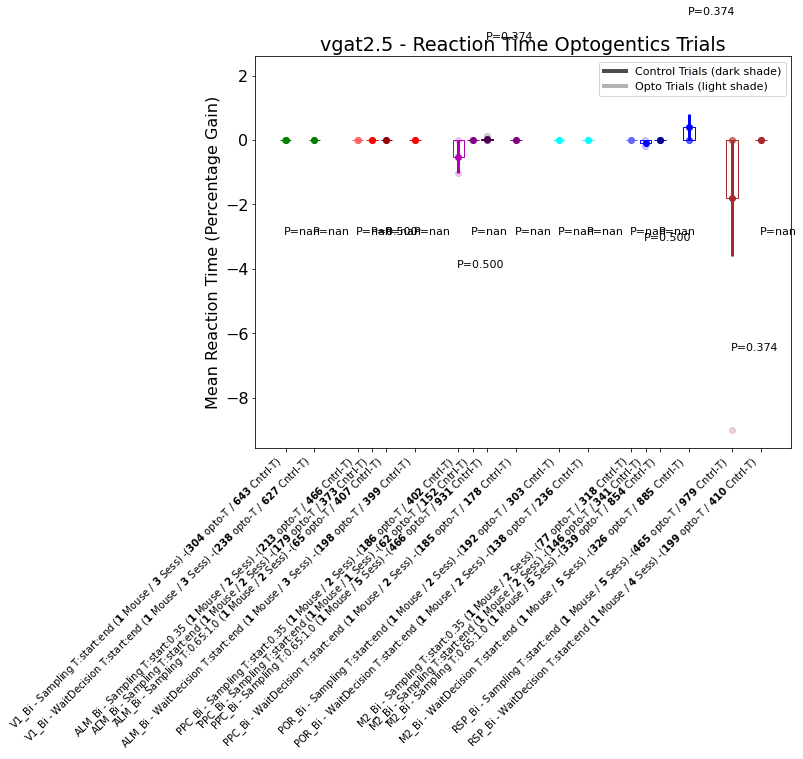

Early-Withdrawal V1_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.13109951332187117
Early-Withdrawal V1_Bi WaitDecision None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.3021374235178198
Early-Withdrawal ALM_Bi Sampling None - Len: 6
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 6) - p-value: 0.1372712567048547
Early-Withdrawal ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.29780474973680027


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Early-Withdrawal ALM_Bi Sampling None - Len: 5
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 5) - p-value: 0.5079948588628247
Early-Withdrawal ALM_Bi WaitDecision None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.9038615442461067
Early-Withdrawal PPC_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.6672135237940203
Early-Withdrawal PPC_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Early-Withdrawal PPC_Bi - Sampling None


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Early-Withdrawal PPC_Bi Sampling None - Len: 7
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 7) - p-value: 0.20856715728664021
Early-Withdrawal PPC_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.49999999999999956
Early-Withdrawal POR_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.05925500863860169
Early-Withdrawal POR_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.5878912291044923
Early-Withdrawal M2_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.1003308913811854


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Early-Withdrawal M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.21062779066238582
Early-Withdrawal M2_Bi Sampling None - Len: 7
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 7) - p-value: 0.21362219051067197
Early-Withdrawal M2_Bi WaitDecision None - Len: 5
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 5) - p-value: 0.6598830563573623
Early-Withdrawal RSP_Bi Sampling None - Len: 5
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 5) - p-value: 0.08430064348679284
Early-Withdrawal RSP_Bi WaitDecision None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: 0.8349170712244699


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


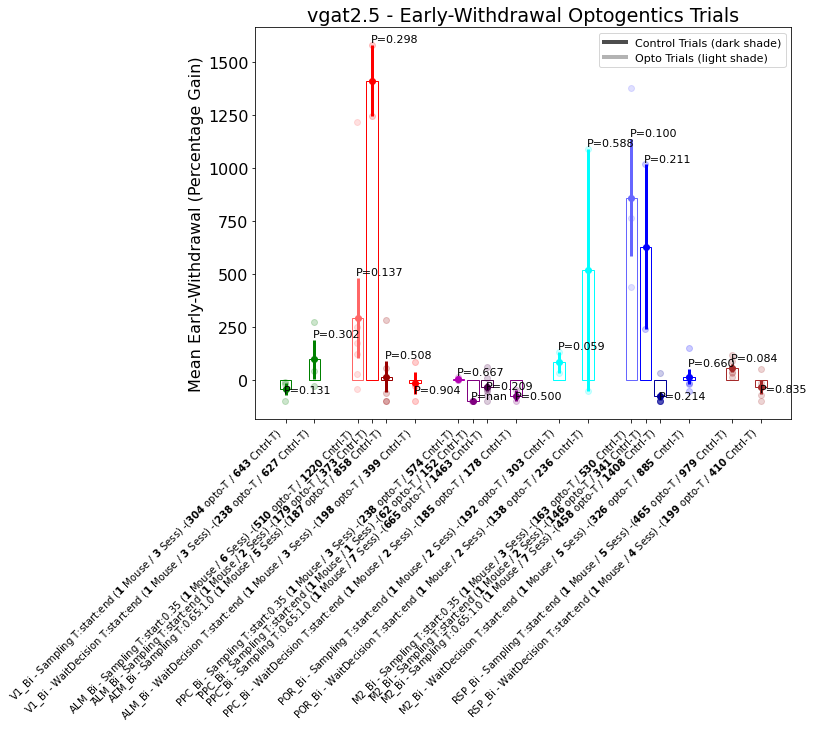

Movement Time V1_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.8704370807837776
Movement Time V1_Bi WaitDecision None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.100935471905603
Movement Time ALM_Bi Sampling None - Len: 6
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 6) - p-value: 0.804319591933493
Movement Time ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.4938788446753267


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Movement Time ALM_Bi Sampling None - Len: 5
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 5) - p-value: 0.310507779163045
Movement Time ALM_Bi WaitDecision None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.20922673776504108
Movement Time PPC_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.5919705343775415
Movement Time PPC_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Movement Time PPC_Bi - Sampling None


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Movement Time PPC_Bi Sampling None - Len: 7
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 7) - p-value: 0.2518953598953913
Movement Time PPC_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.5976619292116933
Movement Time POR_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.7048327646991126
Movement Time POR_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.19781619762844352
Movement Time M2_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.5953589957689209


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Movement Time M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.3031510421766429
Movement Time M2_Bi Sampling None - Len: 7
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 7) - p-value: 0.39418580788507707
Movement Time M2_Bi WaitDecision None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: 0.11274785492344115
Movement Time RSP_Bi Sampling None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: 0.7061969460999306
Movement Time RSP_Bi WaitDecision None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: 0.7887573872900742


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


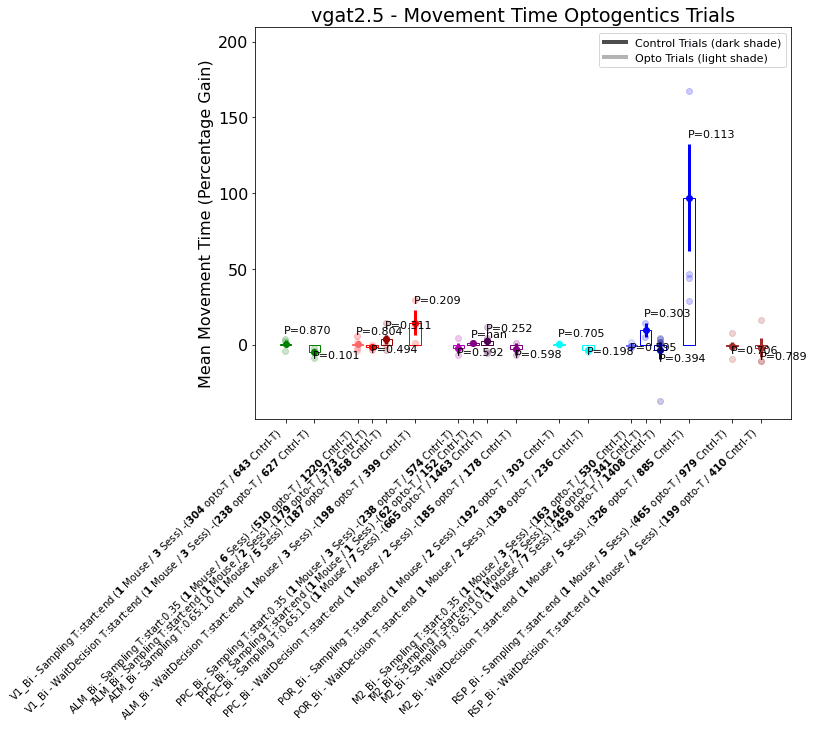

Overall Performance V1_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Overall Performance V1_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.5151805926914326
Overall Performance ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.2367210219907092
Overall Performance ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.47536773214696404
Overall Performance ALM_Bi Sampling None - Len: 5
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 5) - p-value: 0.267952708781461


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Overall Performance ALM_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.41527226612273277
Overall Performance PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.3899231199453303
Overall Performance PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.6088457727530947
Overall Performance PPC_Bi Sampling None - Len: 7
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 7) - p-value: 0.014544202949776422
TTTest Early bailout Overall Performance PPC_Bi - WaitDecision None


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Overall Performance POR_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Overall Performance POR_Bi WaitDecision None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Overall Performance M2_Bi Sampling None - Len: 5
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 5) - p-value: 0.00875892295736005
Overall Performance M2_Bi Sampling None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: 0.034571418126745634


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Overall Performance M2_Bi Sampling None - Len: 5
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 5) - p-value: 0.01283587882529502
Skipping partial sampling: (<MatrixState.stimulus_delivery: 8>, 0.85, 1.0) with: 720 trials.
Overall Performance M2_Bi WaitDecision None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Overall Performance RSP_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.007077400445111995
TTTest Skipping test for Overall Performance RSP_Bi WaitDecision vgat2.6
Overall Performance RSP_Bi WaitDecision None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


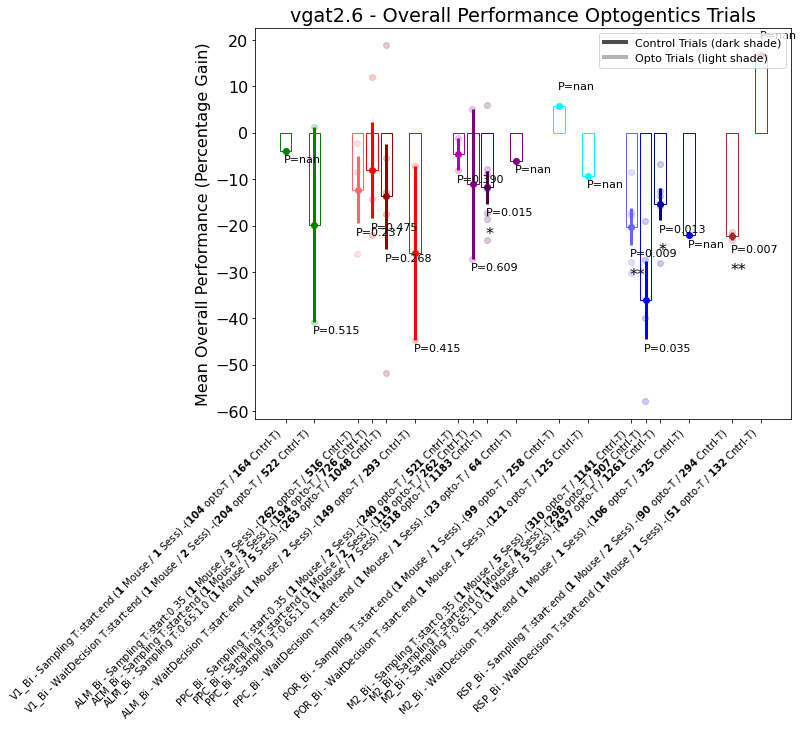

Decision Time V1_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Decision Time V1_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.4650206416848999
Decision Time ALM_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Decision Time ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.35794394844957533
Decision Time ALM_Bi Sampling None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: 0.04096277533231548


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Decision Time ALM_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.17296648232310752
Decision Time PPC_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Decision Time PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.39100535171295886
Decision Time PPC_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.14369849809161697
TTTest Early bailout Decision Time PPC_Bi - WaitDecision None


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Decision Time POR_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Decision Time POR_Bi WaitDecision None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Decision Time M2_Bi Sampling None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: 0.2966342128420512
Decision Time M2_Bi Sampling None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: 0.5524898039128505


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Decision Time M2_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.00020559988779959864
Skipping partial sampling: (<MatrixState.stimulus_delivery: 8>, 0.85, 1.0) with: 720 trials.
Decision Time M2_Bi WaitDecision None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Decision Time RSP_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.5417246948114295
TTTest Skipping test for Decision Time RSP_Bi WaitDecision vgat2.6
Decision Time RSP_Bi WaitDecision None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan


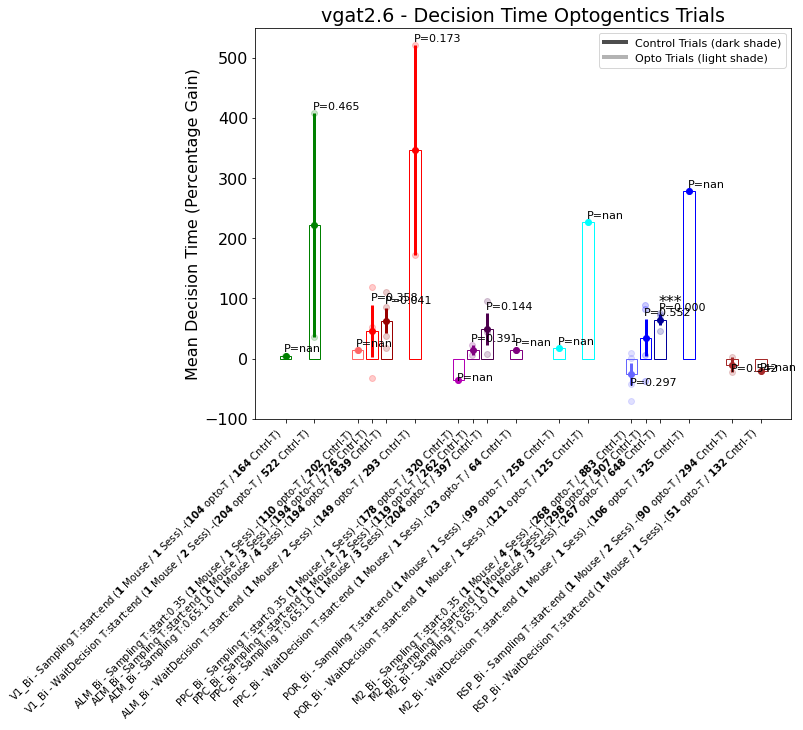

Reaction Time ALM_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: nan
Reaction Time ALM_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Reaction Time PPC_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Reaction Time PPC_Bi Sampling None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: nan
TTTest Skipping test for Reaction Time M2_Bi Sampling vgat2.6
Reaction Time M2_Bi Sampling None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
TTTest Early bailout Reaction Time M2_Bi - Sampling None
Reaction Time M2_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: nan


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


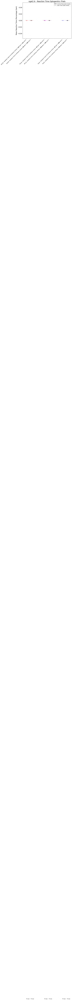

Early-Withdrawal V1_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Early-Withdrawal V1_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.20537680811278872
Early-Withdrawal ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.9923627240432435
Early-Withdrawal ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.8413943530442648
Early-Withdrawal ALM_Bi Sampling None - Len: 5
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 5) - p-value: 0.7247269881683979


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Early-Withdrawal ALM_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.03924756408142771
Early-Withdrawal PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.7268642915038561
Early-Withdrawal PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.3268863921766026
Early-Withdrawal PPC_Bi Sampling None - Len: 7
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 7) - p-value: 0.07219613758641755
TTTest Skipping test for Early-Withdrawal PPC_Bi WaitDecision vgat2.6


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Early-Withdrawal PPC_Bi WaitDecision None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan
Early-Withdrawal POR_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Early-Withdrawal POR_Bi WaitDecision None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Early-Withdrawal M2_Bi Sampling None - Len: 5
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 5) - p-value: 0.17666329322891583
Early-Withdrawal M2_Bi Sampling None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: 0.03142232076820758


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Early-Withdrawal M2_Bi Sampling None - Len: 5
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 5) - p-value: 0.056856238908630084
Skipping partial sampling: (<MatrixState.stimulus_delivery: 8>, 0.85, 1.0) with: 720 trials.
Early-Withdrawal M2_Bi WaitDecision None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Early-Withdrawal RSP_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.46893179595785545
Early-Withdrawal RSP_Bi WaitDecision None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


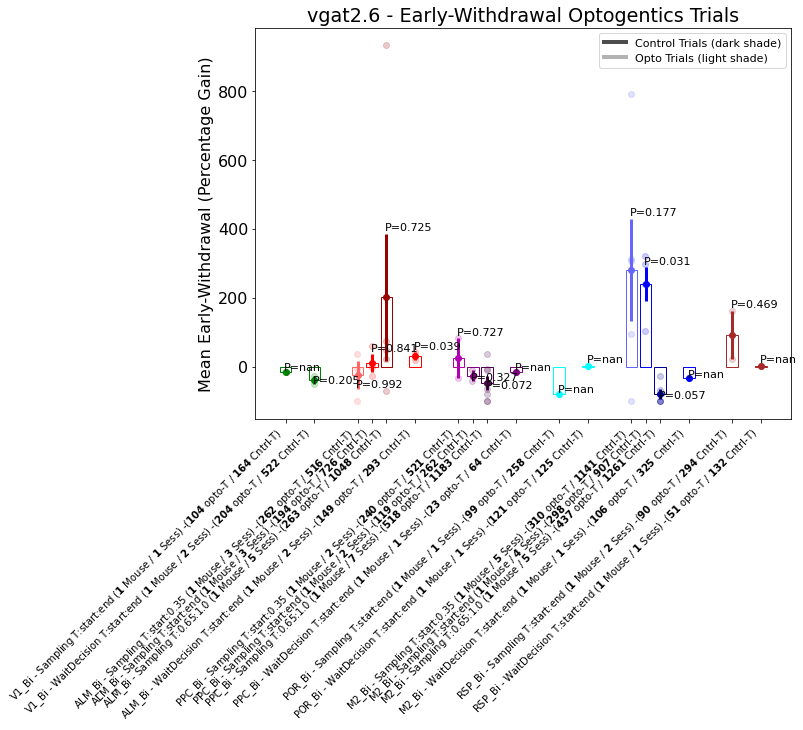

Movement Time V1_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Movement Time V1_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.5005576555794842
Movement Time ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.44704419716022237
Movement Time ALM_Bi Sampling None - Len: 3
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 3) - p-value: 0.26130502957346174
Movement Time ALM_Bi Sampling None - Len: 5
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 5) - p-value: 0.32887331806032083


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Movement Time ALM_Bi WaitDecision None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.313647262808958
Movement Time PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.7673038827779124
Movement Time PPC_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.5838402749709115
Movement Time PPC_Bi Sampling None - Len: 7
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 7) - p-value: 0.9099307030390194


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


TTTest Early bailout Movement Time PPC_Bi - WaitDecision None
Movement Time POR_Bi Sampling None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Movement Time POR_Bi WaitDecision None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Movement Time M2_Bi Sampling None - Len: 5
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 5) - p-value: 0.9682579748168798
Movement Time M2_Bi Sampling None - Len: 4
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 4) - p-value: 0.049339380014754325


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Movement Time M2_Bi Sampling None - Len: 5
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 5) - p-value: 0.02218455067276343
Skipping partial sampling: (<MatrixState.stimulus_delivery: 8>, 0.85, 1.0) with: 720 trials.
Movement Time M2_Bi WaitDecision None - Len: 1
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 1) - p-value: nan
Movement Time RSP_Bi Sampling None - Len: 2
	Across Animals (Sample size: 1) - p-value: nan
	Across Sessions (Sample size: 2) - p-value: 0.3896586227187143
TTTest Skipping test for Movement Time RSP_Bi WaitDecision vgat2.6
Movement Time RSP_Bi WaitDecision None - Len: 1
	Across Sessions (Sample size: 1) - p-value: nan


C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\fromnumeric.py:3622: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
C:\Users\hatem\Anaconda3\envs\analysis\lib\site-packages\numpy\core\_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


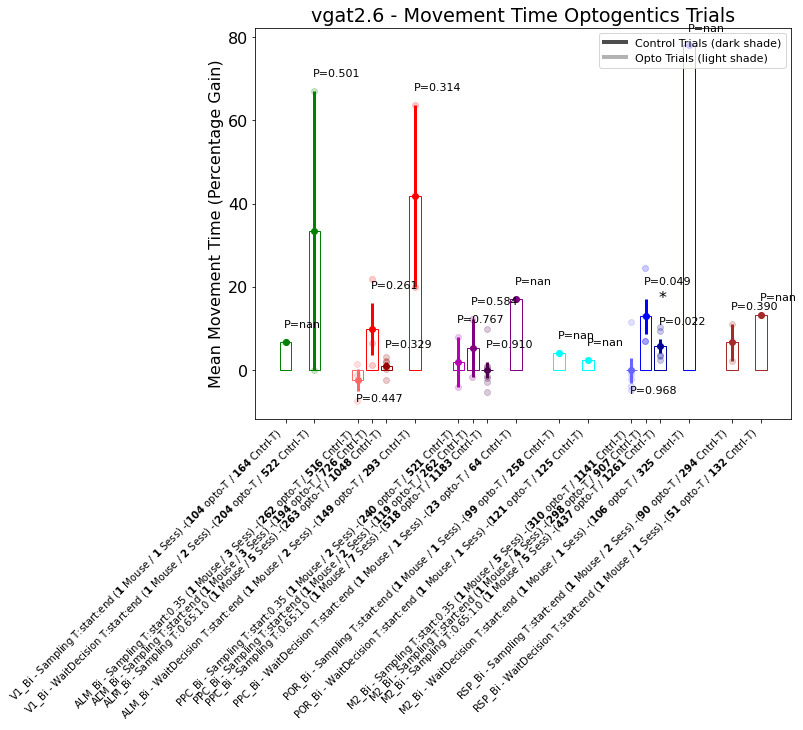

Used sess: {(<ExperimentType.RDK: 4>, 'All animals', 'Avgat1', 'Avgat1', '21-08-20 /3', 'Early-Withdrawal', 'ALM_Bi', <MatrixState.stimulus_delivery: 8>), (<ExperimentType.RDK: 4>, 'All animals', 'BVGAT2', 'BVGAT2', '22-01-04 /1', 'Decision Time', 'M2_Bi', <MatrixState.CenterPortRewardDelivery: 11>), (<ExperimentType.RDK: 4>, 'All animals', 'Avgat4', 'Avgat4', '21-07-07 /1', 'Movement Time', 'ALM_Bi', <MatrixState.stimulus_delivery: 8>), (<ExperimentType.RDK: 4>, 'Avgat3', 'Avgat3', 'Avgat3', '21-06-22 /1', 'Movement Time', 'M2_Bi', <MatrixState.stimulus_delivery: 8>), (<ExperimentType.RDK: 4>, 'BVGAT2', 'BVGAT2', 'BVGAT2', '21-12-07 /1', 'Movement Time', 'ALM_Bi', <MatrixState.stimulus_delivery: 8>), (<ExperimentType.RDK: 4>, 'vgat2.5', 'vgat2.5', 'vgat2.5', '20-11-06 /1', 'Overall Performance', 'PPC_Bi', <MatrixState.stimulus_delivery: 8>), (<ExperimentType.RDK: 4>, 'BVGAT3', 'BVGAT3', 'BVGAT3', '21-12-27 /1', 'Early-Withdrawal', 'ALM_Bi', <MatrixState.CenterPortRewardDelivery: 11>),

In [3]:
def process(df, *, save_figs):
  from os import environ
  onedrive_fp = environ["ONEDRIVE"]
  save_prefix= onedrive_fp + r"/Documents/py_matlab/analysis_run/proto/optogenetics/"
  print("Save prefix:", save_prefix)
  # TODO: For seconds data, fix SEM to be equal box-plot or something 
  from report import analysis
  analysis.setMatplotlibParams(silent=True)
  from opto.optometrics import optoMetrics, MetricMode
  used_sess, sess_df_li = optoMetrics(df, mode=MetricMode.Gain, save_figs=save_figs, save_prefix=save_prefix)
  all_used_df = pd.concat(sess_df_li)
  all_used_df.to_csv()
  print("Used sess:", used_sess)
  return used_sess
  # optooverview.optogenetics(df, o pto_by_state=True,
  #                          save_figs=save_figs,)
used_sess = process(opto_df, save_figs=False)

In [45]:
def printUsedSess(sess):
    #sess = set([(*s[:1], *s[2:]) for s in  sess])
    sess = set([tuple(s) for (_, *s) in  sess])
    # print(sess)
    from definitions import MatrixState
    import pandas as pd
    df = pd.DataFrame(sess, 
        columns=["ExpType", #"Name", 
                 "SubName", "Date", "SessNum", "Metric", "BR", "State"])
    df.loc[df[df.ExpType == 4].index, "ExpType"] = "RDK"
    df.loc[df[df.ExpType == 2].index, "ExpType"] = "LC"
    df.State = df.State.astype(str)
    for (name, date, num), sub_df in df.groupby(["SubName", "Date", "SessNum"]):
        states = [str(MatrixState(int(st))) for st in sub_df.State.unique()]
        print(f"{name} - {date} - Sess:{num} - " +
              f"Region:", "- ".join(sub_df.BR.unique()) +
              f" - State:", "- ".join(states)
              )
    
printUsedSess(used_sess)

Avgat1 - Avgat1 - Sess:21-06-22 /1 - Region: ALM_Bi- PPC_Bi - State: stimulus_delivery


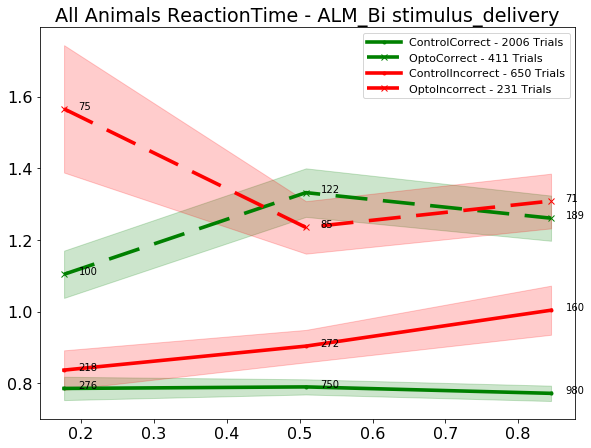

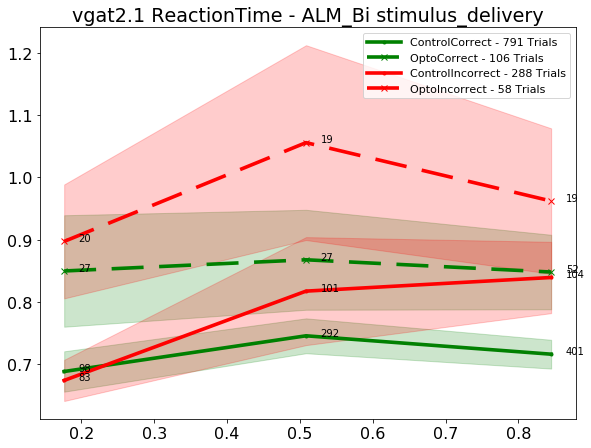

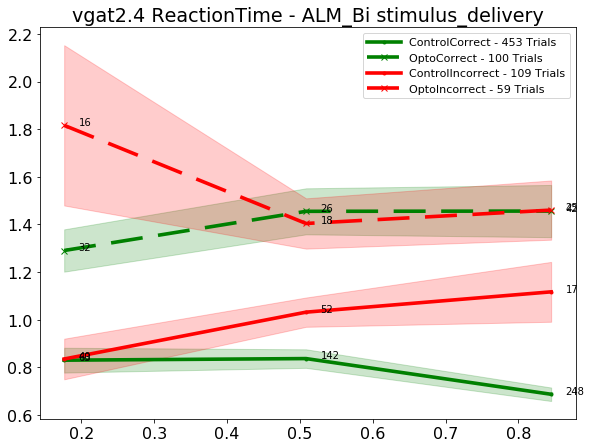

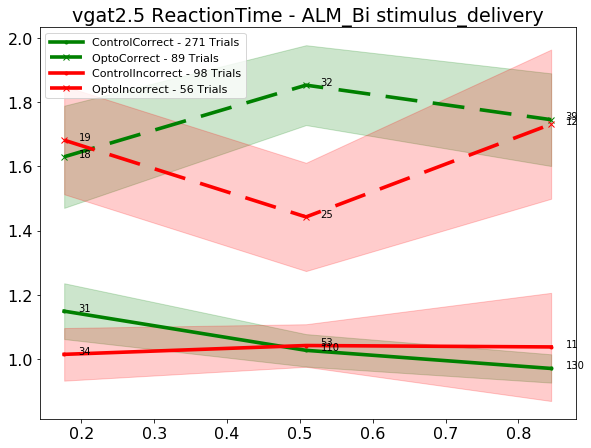

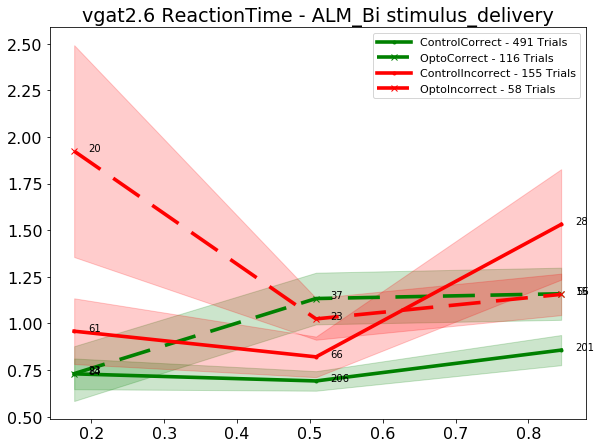

...

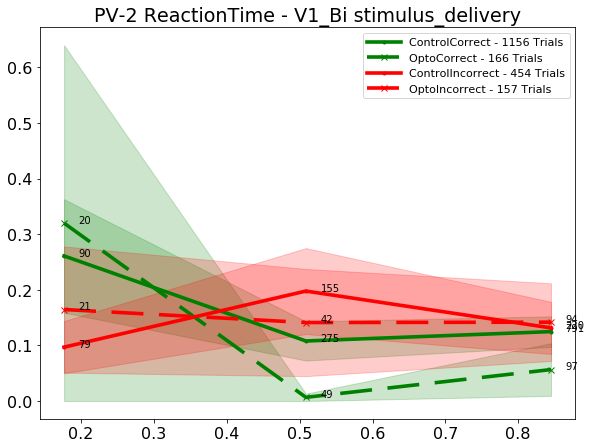

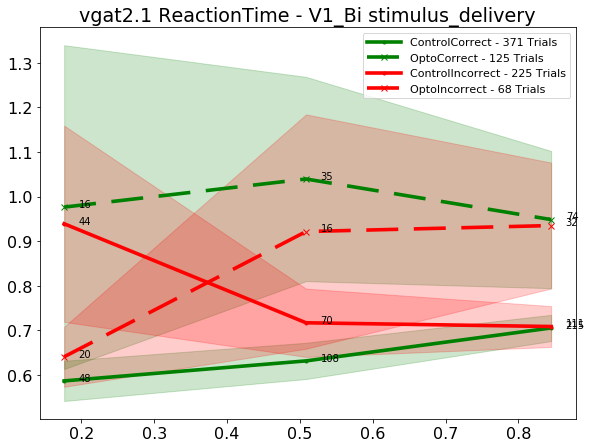

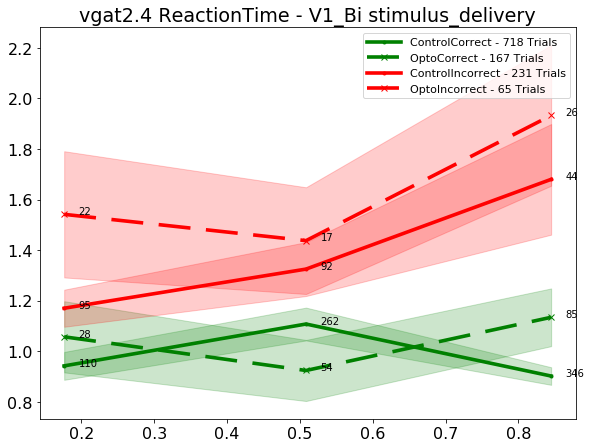

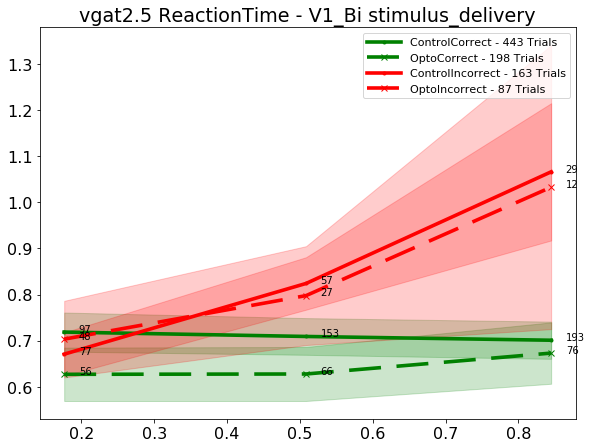

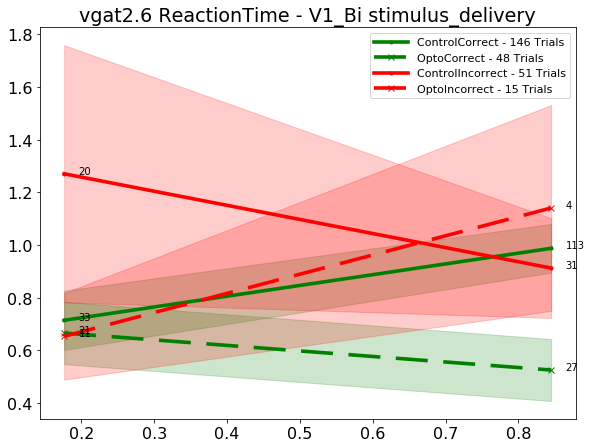

In [22]:

def mainOptoReactTime(df):
  from opto.optoutil import splitByBinarySamplingTime
  df_full_sampling, df_partial_sampling = splitByBinarySamplingTime(df)
  from opto.optoreactiontime import metricByOpto
  metricByOpto(df_full_sampling, trim_start=20, trim_end=25, min_count_per_animal_group=30,
               save_figs=False, save_prefix="proto/optogenetics/")

mainOptoReactTime(opto_df)